In [347]:

import pandas as pd
import matplotlib.pyplot as plt


In [4]:
import seaborn as sns
import pandas as pd 

In [5]:
df = pd.read_csv("SAMPLE_CHURN (1).csv")
df_2=pd.read_csv("MONTHLY_AGGREGATION_SAMPLE (2).csv")
df_3=pd.read_csv("data_bundle_purchase_july2024_jan2025.csv")


C:\Users\Client\AppData\Local\Temp\ipykernel_24284\1896024804.py:1: DtypeWarning: Columns (13,15) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv("SAMPLE_CHURN (1).csv")


In [6]:
import re
import pandas as pd

# Étape 1 : Nettoyage des lignes mal formées
with open("socio-demographic_sample_churn.csv", "r", encoding="utf-8") as infile, open("cleaned_churn.csv", "w", encoding="utf-8") as outfile:
    for line in infile:
        line = line.strip().rstrip(';')            # Supprimer le point-virgule de fin
        line = line.replace('""', '"')             # Convertir les guillemets doubles en simples
        line = re.sub(r'^"|"$', '', line)          # Supprimer les guillemets de début/fin de ligne
        outfile.write(line + "\n")

# Étape 2 : Lecture avec pandas
df_4 = pd.read_csv("cleaned_churn.csv", sep=",", engine="python", quotechar='"', on_bad_lines='skip')




In [7]:
df_4 = df_4.dropna(subset=['subscriber_id'])


### Data cleaning 

In [10]:
# Convert the 'date_activation' and 'first_call_date' to datetime objects
df['date_activation'] = pd.to_datetime(df['date_activation'], format='%d%b%Y:%H:%M:%S.%f')
df['first_call_date'] = pd.to_datetime(df['first_call_date'], format='%d%b%Y:%H:%M:%S.%f')
data_frame=df.copy()
# Create a condition to check if date_activation is after first_call_date
data_frame['is_date_activation_after_first_call'] = data_frame['date_activation'] > data_frame['first_call_date']

# Count the number of subscribers where date_activation is after first_call_date
count_after_first_call = data_frame['is_date_activation_after_first_call'].sum()

# Show the count
print(f"Number of subscribers with date_activation after first_call_date: {count_after_first_call}")


Number of subscribers with date_activation after first_call_date: 34003


In [14]:
# Fill NaN values in 'first_call_date' with the values from 'date_activation'
df['first_call_date'] = df['first_call_date'].fillna(df['date_activation'])

In [16]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 423766 entries, 0 to 423765
Data columns (total 18 columns):
 #   Column                        Non-Null Count   Dtype         
---  ------                        --------------   -----         
 0   churn                         423766 non-null  object        
 1   classe_anciennete             423766 non-null  object        
 2   subscriber_id                 423766 non-null  int64         
 3   msisdn                        423766 non-null  object        
 4   sales_channel_description     0 non-null       float64       
 5   date_activation               423766 non-null  datetime64[ns]
 6   churn_date                    110937 non-null  object        
 7   first_call_date               423766 non-null  datetime64[ns]
 8   last_call_date                398414 non-null  object        
 9   first_recharge_date           365567 non-null  object        
 10  first_recharge_amount         365567 non-null  float64       
 11  last_internat

In [17]:
# Nombre total de clients uniques
total_clients = len(df['subscriber_id'].unique())

# Nombre de clients churn et non churn
churn_clients = df[df['churn'] == 'Yes']['subscriber_id'].nunique()
non_churn_clients = df[df['churn'] == 'No']['subscriber_id'].nunique()

# Affichage des résultats
print(f"Total clients : {total_clients}")
print(f"Clients churn : {churn_clients}")
print(f"Clients non churn : {non_churn_clients}")


Total clients : 423766
Clients churn : 36256
Clients non churn : 387510


In [19]:
df = df.drop(columns=['sales_channel_description','first_recharge_amount'])

In [21]:
# Drop the 'first_recharge_date' column
df.drop(columns=['first_recharge_date'], inplace=True)

# Verify the changes
print(df.columns)


Index(['churn', 'classe_anciennete', 'subscriber_id', 'msisdn',
       'date_activation', 'churn_date', 'first_call_date', 'last_call_date',
       'last_international_call_date', 'original_operator',
       'dat_remb_kridi_net', 'ported_in_request_date', 'SelectionProb',
       'SamplingWeight'],
      dtype='object')


In [22]:
# List of date columns
date_columns = [
    'date_activation', 'churn_date', 'first_call_date', 'last_call_date', 
    'last_international_call_date', 'ported_in_request_date'
]

# Convert to datetime and remove time part
for col in date_columns:
    df[col] = pd.to_datetime(df[col], format="%d%b%Y:%H:%M:%S.%f", errors='coerce').dt.date

# Check result
df.head()


,churn,classe_anciennete,subscriber_id,msisdn,date_activation,churn_date,first_call_date,last_call_date,last_international_call_date,original_operator,dat_remb_kridi_net,ported_in_request_date,SelectionProb,SamplingWeight
0,No,0 to 3 Months,2180780653,dc77fad2110cc23f31bbe0166de8c377,2025-01-10,NaT,2025-01-10,NaT,NaT,Ooredoo,NaN,NaT,0.050002,19.999201
1,No,0 to 3 Months,2180606151,9d13a3fcf7f20203914c49c32ca6a0ea,2025-02-19,NaT,2024-12-30,2025-03-19,NaT,Ooredoo,NaN,NaT,0.050002,19.999201
2,No,0 to 3 Months,2180583701,9b6c47edad2f25ffac743b6849b6bf26,2024-12-23,NaT,2024-12-23,2024-12-29,NaT,Ooredoo,NaN,NaT,0.050002,19.999201
3,No,0 to 3 Months,2180725273,a467b76595494a4b88f2a39fa99b9d15,2025-01-06,NaT,2025-01-07,2025-01-07,NaT,Ooredoo,NaN,NaT,0.050002,19.999201
4,No,0 to 3 Months,2180582384,931925bcd539b754a0fa5201e4e027a6,2024-12-23,NaT,2024-12-23,2025-03-19,NaT,Ooredoo,NaN,NaT,0.050002,19.999201


In [26]:
# Replace the 'dat_remb_kridi_net' column with 0 for NaN values and 1 for non-NaN values
df['dat_remb_kridi_net'] = df['dat_remb_kridi_net'].notna().astype(int)

# Verify the changes
print(df['dat_remb_kridi_net'].value_counts())


dat_remb_kridi_net
0    278343
1    145423
Name: count, dtype: int64


In [27]:
import pandas as pd

# Define cutoff date
cutoff_date = pd.to_datetime("2025-01-30")

# Ensure correct datetime types
df['date_activation'] = pd.to_datetime(df['date_activation'])
df['churn_date'] = pd.to_datetime(df['churn_date'])

# Replace future activation dates (optional)
df.loc[df['date_activation'] > cutoff_date, 'date_activation'] = cutoff_date

# Compute tenure_days based on churn status
df['tenure_days'] = df.apply(
    lambda row: (row['churn_date'] - row['date_activation']).days
    if row['churn'] == 'Yes' else
    (cutoff_date - row['date_activation']).days,
    axis=1
)

# Assertion to check all tenure_days are positive
assert (df['tenure_days'] >= 0).all(), "Some tenure_days are still negative!"

# Preview result
print(df[['churn', 'date_activation', 'churn_date', 'tenure_days']].head())


  churn date_activation churn_date  tenure_days
0    No      2025-01-10        NaT           20
1    No      2025-01-30        NaT            0
2    No      2024-12-23        NaT           38
3    No      2025-01-06        NaT           24
4    No      2024-12-23        NaT           38


In [28]:
df = df.drop(columns='churn_date')

In [29]:
df.head()

,churn,classe_anciennete,subscriber_id,msisdn,date_activation,first_call_date,last_call_date,last_international_call_date,original_operator,dat_remb_kridi_net,ported_in_request_date,SelectionProb,SamplingWeight,tenure_days
0,No,0 to 3 Months,2180780653,dc77fad2110cc23f31bbe0166de8c377,2025-01-10,2025-01-10,NaT,NaT,Ooredoo,0,NaT,0.050002,19.999201,20
1,No,0 to 3 Months,2180606151,9d13a3fcf7f20203914c49c32ca6a0ea,2025-01-30,2024-12-30,2025-03-19,NaT,Ooredoo,0,NaT,0.050002,19.999201,0
2,No,0 to 3 Months,2180583701,9b6c47edad2f25ffac743b6849b6bf26,2024-12-23,2024-12-23,2024-12-29,NaT,Ooredoo,0,NaT,0.050002,19.999201,38
3,No,0 to 3 Months,2180725273,a467b76595494a4b88f2a39fa99b9d15,2025-01-06,2025-01-07,2025-01-07,NaT,Ooredoo,0,NaT,0.050002,19.999201,24
4,No,0 to 3 Months,2180582384,931925bcd539b754a0fa5201e4e027a6,2024-12-23,2024-12-23,2025-03-19,NaT,Ooredoo,0,NaT,0.050002,19.999201,38


In [30]:
print(df[[ 'last_call_date', 'first_call_date', 
          'date_activation',
          'ported_in_request_date']].dtypes)


last_call_date                    object
first_call_date                   object
date_activation           datetime64[ns]
ported_in_request_date            object
dtype: object


In [31]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 423766 entries, 0 to 423765
Data columns (total 14 columns):
 #   Column                        Non-Null Count   Dtype         
---  ------                        --------------   -----         
 0   churn                         423766 non-null  object        
 1   classe_anciennete             423766 non-null  object        
 2   subscriber_id                 423766 non-null  int64         
 3   msisdn                        423766 non-null  object        
 4   date_activation               423766 non-null  datetime64[ns]
 5   first_call_date               423766 non-null  object        
 6   last_call_date                398414 non-null  object        
 7   last_international_call_date  5439 non-null    object        
 8   original_operator             423766 non-null  object        
 9   dat_remb_kridi_net            423766 non-null  int64         
 10  ported_in_request_date        5016 non-null    object        
 11  SelectionProb

In [32]:
df.isnull().sum()

churn                                0
classe_anciennete                    0
subscriber_id                        0
msisdn                               0
date_activation                      0
first_call_date                      0
last_call_date                   25352
last_international_call_date    418327
original_operator                    0
dat_remb_kridi_net                   0
ported_in_request_date          418750
SelectionProb                        0
SamplingWeight                       0
tenure_days                          0
dtype: int64

In [33]:
df = df.drop(columns=['SamplingWeight','SelectionProb'])

In [34]:
# Create the 'has_international_call' column
df['has_international_call'] = df['last_international_call_date'].notna().astype(int)

# Drop the 'last_international_call_date' column
df.drop('last_international_call_date', axis=1, inplace=True)

# Verify the changes
df.head()


,churn,classe_anciennete,subscriber_id,msisdn,date_activation,first_call_date,last_call_date,original_operator,dat_remb_kridi_net,ported_in_request_date,tenure_days,has_international_call
0,No,0 to 3 Months,2180780653,dc77fad2110cc23f31bbe0166de8c377,2025-01-10,2025-01-10,NaT,Ooredoo,0,NaT,20,0
1,No,0 to 3 Months,2180606151,9d13a3fcf7f20203914c49c32ca6a0ea,2025-01-30,2024-12-30,2025-03-19,Ooredoo,0,NaT,0,0
2,No,0 to 3 Months,2180583701,9b6c47edad2f25ffac743b6849b6bf26,2024-12-23,2024-12-23,2024-12-29,Ooredoo,0,NaT,38,0
3,No,0 to 3 Months,2180725273,a467b76595494a4b88f2a39fa99b9d15,2025-01-06,2025-01-07,2025-01-07,Ooredoo,0,NaT,24,0
4,No,0 to 3 Months,2180582384,931925bcd539b754a0fa5201e4e027a6,2024-12-23,2024-12-23,2025-03-19,Ooredoo,0,NaT,38,0


In [35]:
df.columns

Index(['churn', 'classe_anciennete', 'subscriber_id', 'msisdn',
       'date_activation', 'first_call_date', 'last_call_date',
       'original_operator', 'dat_remb_kridi_net', 'ported_in_request_date',
       'tenure_days', 'has_international_call'],
      dtype='object')

In [36]:
# Drop the 'ported_in_request_date' column
df.drop(columns=['ported_in_request_date'], inplace=True)

# Verify the column is dropped
print(df.columns)


Index(['churn', 'classe_anciennete', 'subscriber_id', 'msisdn',
       'date_activation', 'first_call_date', 'last_call_date',
       'original_operator', 'dat_remb_kridi_net', 'tenure_days',
       'has_international_call'],
      dtype='object')


In [37]:
df.isnull().sum()

churn                         0
classe_anciennete             0
subscriber_id                 0
msisdn                        0
date_activation               0
first_call_date               0
last_call_date            25352
original_operator             0
dat_remb_kridi_net            0
tenure_days                   0
has_international_call        0
dtype: int64

In [38]:
# Drop rows where 'last_call_date' is NaN from the original DataFrame
df.dropna(subset=['last_call_date'], inplace=True)

# Verify the result
print(df.isnull().sum())


churn                     0
classe_anciennete         0
subscriber_id             0
msisdn                    0
date_activation           0
first_call_date           0
last_call_date            0
original_operator         0
dat_remb_kridi_net        0
tenure_days               0
has_international_call    0
dtype: int64


In [39]:
df['original_operator'] = df['original_operator'].replace({'Non Ooredoo': 0, 'Ooredoo': 1})


C:\Users\Client\AppData\Local\Temp\ipykernel_24284\1458918022.py:1: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df['original_operator'] = df['original_operator'].replace({'Non Ooredoo': 0, 'Ooredoo': 1})


In [40]:
df.head()

,churn,classe_anciennete,subscriber_id,msisdn,date_activation,first_call_date,last_call_date,original_operator,dat_remb_kridi_net,tenure_days,has_international_call
1,No,0 to 3 Months,2180606151,9d13a3fcf7f20203914c49c32ca6a0ea,2025-01-30,2024-12-30,2025-03-19,1,0,0,0
2,No,0 to 3 Months,2180583701,9b6c47edad2f25ffac743b6849b6bf26,2024-12-23,2024-12-23,2024-12-29,1,0,38,0
3,No,0 to 3 Months,2180725273,a467b76595494a4b88f2a39fa99b9d15,2025-01-06,2025-01-07,2025-01-07,1,0,24,0
4,No,0 to 3 Months,2180582384,931925bcd539b754a0fa5201e4e027a6,2024-12-23,2024-12-23,2025-03-19,1,0,38,0
5,No,0 to 3 Months,2180594051,6ebab52b9b0c7653d4a991df1f6e9c65,2024-12-24,2024-12-24,2025-03-19,1,0,37,0


In [41]:
# Ensure date columns are in datetime format
df['last_call_date'] = pd.to_datetime(df['last_call_date'], errors='coerce')
df['first_call_date'] = pd.to_datetime(df['first_call_date'], errors='coerce')

# Define the cutoff date as a Timestamp
cutoff_date = pd.Timestamp('2025-01-31')

# Check for future last_call_date
future_last_calls = df[df['last_call_date'] > cutoff_date]
print("🔍 Rows with future last_call_date:")
print(future_last_calls[['subscriber_id', 'last_call_date']])

# Check for future first_call_date
future_first_calls = df[df['first_call_date'] > cutoff_date]
print("\n🔍 Rows with future first_call_date:")
print(future_first_calls[['subscriber_id', 'first_call_date', 'date_activation']])


🔍 Rows with future last_call_date:
        subscriber_id last_call_date
1          2180606151     2025-03-19
4          2180582384     2025-03-19
5          2180594051     2025-03-19
7          2180950307     2025-03-07
9          2180872344     2025-03-19
...               ...            ...
423610       13881166     2025-03-19
423672     2153295559     2025-03-17
423699     2159316767     2025-03-19
423729        6651167     2025-03-08
423749     2155395866     2025-03-19

[267567 rows x 2 columns]

🔍 Rows with future first_call_date:
        subscriber_id first_call_date date_activation
12         2180977068      2025-02-13      2025-01-30
19         2180977463      2025-02-02      2025-01-30
127        2180988369      2025-02-03      2025-01-30
148        2180983762      2025-02-03      2025-01-30
230        2180943778      2025-03-14      2025-01-27
...               ...             ...             ...
404872     2179473586      2025-02-17      2024-09-09
405783     2179421052    

In [42]:
cutoff_date = pd.Timestamp('2025-01-31')
# Fix last_call_date if it's in the future
df.loc[df['last_call_date'] > cutoff_date, 'last_call_date'] = cutoff_date

# Fix first_call_date if it's in the future → use date_activation instead
df.loc[df['first_call_date'] > cutoff_date, 'first_call_date'] = df['date_activation']


In [43]:
df.head()

,churn,classe_anciennete,subscriber_id,msisdn,date_activation,first_call_date,last_call_date,original_operator,dat_remb_kridi_net,tenure_days,has_international_call
1,No,0 to 3 Months,2180606151,9d13a3fcf7f20203914c49c32ca6a0ea,2025-01-30,2024-12-30,2025-01-31,1,0,0,0
2,No,0 to 3 Months,2180583701,9b6c47edad2f25ffac743b6849b6bf26,2024-12-23,2024-12-23,2024-12-29,1,0,38,0
3,No,0 to 3 Months,2180725273,a467b76595494a4b88f2a39fa99b9d15,2025-01-06,2025-01-07,2025-01-07,1,0,24,0
4,No,0 to 3 Months,2180582384,931925bcd539b754a0fa5201e4e027a6,2024-12-23,2024-12-23,2025-01-31,1,0,38,0
5,No,0 to 3 Months,2180594051,6ebab52b9b0c7653d4a991df1f6e9c65,2024-12-24,2024-12-24,2025-01-31,1,0,37,0


In [44]:
# Define the target date (31-01-2025)
target_date = pd.to_datetime('2025-01-31')

# Calculate the difference (time to churn)
df['time_to_churn'] = (target_date - df['last_call_date']).dt.days

In [45]:
df.head()

,churn,classe_anciennete,subscriber_id,msisdn,date_activation,first_call_date,last_call_date,original_operator,dat_remb_kridi_net,tenure_days,has_international_call,time_to_churn
1,No,0 to 3 Months,2180606151,9d13a3fcf7f20203914c49c32ca6a0ea,2025-01-30,2024-12-30,2025-01-31,1,0,0,0,0
2,No,0 to 3 Months,2180583701,9b6c47edad2f25ffac743b6849b6bf26,2024-12-23,2024-12-23,2024-12-29,1,0,38,0,33
3,No,0 to 3 Months,2180725273,a467b76595494a4b88f2a39fa99b9d15,2025-01-06,2025-01-07,2025-01-07,1,0,24,0,24
4,No,0 to 3 Months,2180582384,931925bcd539b754a0fa5201e4e027a6,2024-12-23,2024-12-23,2025-01-31,1,0,38,0,0
5,No,0 to 3 Months,2180594051,6ebab52b9b0c7653d4a991df1f6e9c65,2024-12-24,2024-12-24,2025-01-31,1,0,37,0,0


In [46]:
df.isnull().sum()

churn                     0
classe_anciennete         0
subscriber_id             0
msisdn                    0
date_activation           0
first_call_date           0
last_call_date            0
original_operator         0
dat_remb_kridi_net        0
tenure_days               0
has_international_call    0
time_to_churn             0
dtype: int64

In [47]:
partner = df["original_operator"] == 1
no_partner = df["original_operator"] == 0

print(partner.sum())  # nombre de vrais
print(no_partner.sum())


390877
7537


In [48]:
df.shape

(398414, 12)

In [49]:
# Nombre total de clients uniques
total_clients = len(df['subscriber_id'].unique())

# Nombre de clients churn et non churn
churn_clients = df[df['churn'] == 'Yes']['subscriber_id'].nunique()
non_churn_clients = df[df['churn'] == 'No']['subscriber_id'].nunique()

# Affichage des résultats
print(f"Total clients : {total_clients}")
print(f"Clients churn : {churn_clients}")
print(f"Clients non churn : {non_churn_clients}")


Total clients : 398414
Clients churn : 31794
Clients non churn : 366620


### DF2


In [50]:
df_2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2668258 entries, 0 to 2668257
Data columns (total 24 columns):
 #   Column                         Dtype  
---  ------                         -----  
 0   period_id                      int64  
 1   subscriber_id                  int64  
 2   msisdn                         object 
 3   recharge_amount                float64
 4   number_of_recharges            int64  
 5   number_of_sms_onnet            int64  
 6   number_of_sms_offnet           int64  
 7   number_of_sms_international    int64  
 8   mou_onnet                      float64
 9   mou_offnet_mobile              float64
 10  mou_offnet_fix                 float64
 11  mou_international              float64
 12  bonus_on_consumption_revenue   float64
 13  bonus_on_refill_revenue        float64
 14  bonus_on_refill_flash_revenue  float64
 15  number_of_reactivations        float64
 16  consumption_revenue            float64
 17  arpu_out_without_bonus         float64
 18  in

In [51]:
df_2.isnull().sum()

period_id                              0
subscriber_id                          0
msisdn                                 0
recharge_amount                        0
number_of_recharges                    0
number_of_sms_onnet                    0
number_of_sms_offnet                   0
number_of_sms_international            0
mou_onnet                              0
mou_offnet_mobile                      0
mou_offnet_fix                         0
mou_international                      0
bonus_on_consumption_revenue           0
bonus_on_refill_revenue                0
bonus_on_refill_flash_revenue          0
number_of_reactivations                1
consumption_revenue                    0
arpu_out_without_bonus                 0
incoming_revenue                       0
data_trafic_volume                876611
total_voice_revenu_amount         863851
total_data_revenu_amount         1059457
device_type                        24166
flag_smartphone                    24166
dtype: int64

In [52]:
df_2['number_of_reactivations'].fillna(0,inplace=True)

C:\Users\Client\AppData\Local\Temp\ipykernel_24284\1647432956.py:1: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df_2['number_of_reactivations'].fillna(0,inplace=True)


In [53]:
import numpy as np
# Identify columns with missing values
missing_cols = df_2.columns[df_2.isnull().any()]
categorical_cols = df_2.select_dtypes(include='object').columns
numerical_cols = df_2.select_dtypes(include=[np.number]).columns

def fill_missing_values(df):
    filled_df = df.copy()
    
    for col in missing_cols:
        is_categorical = col in categorical_cols
        
        # Global fallback: most frequent or median
        if is_categorical:
            global_value = df[col].mode(dropna=True)
            global_fill = global_value[0] if not global_value.empty else np.nan
        else:
            global_fill = df[col].median()
        
        def fill_group(group):
            # Get only non-NaN values
            non_nan = group[col].dropna()
            if non_nan.empty:
                # Case 1: All NaN for this subscriber → fill with global
                return group[col].fillna(global_fill)
            elif non_nan.nunique() == 1:
                # Case 2: Only one unique non-NaN → fill with that
                return group[col].fillna(non_nan.iloc[0])
            else:
                # Case 3: Use most frequent or median within the group
                if is_categorical:
                    fill_value = non_nan.mode()[0]
                else:
                    fill_value = non_nan.median()
                return group[col].fillna(fill_value)
        
        filled_df[col] = filled_df.groupby("subscriber_id", group_keys=False).apply(fill_group)
        
    return filled_df

# Apply the function
df_2 = fill_missing_values(df_2)

C:\Users\Client\AppData\Local\Temp\ipykernel_24284\1650987378.py:37: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  filled_df[col] = filled_df.groupby("subscriber_id", group_keys=False).apply(fill_group)
C:\Users\Client\AppData\Local\Temp\ipykernel_24284\1650987378.py:37: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  filled_df[col] = filled_df.groupby("subscriber_id", group_keys=False).apply(fill_group)
C:\U

In [54]:
df_2.isnull().sum()

period_id                        0
subscriber_id                    0
msisdn                           0
recharge_amount                  0
number_of_recharges              0
number_of_sms_onnet              0
number_of_sms_offnet             0
number_of_sms_international      0
mou_onnet                        0
mou_offnet_mobile                0
mou_offnet_fix                   0
mou_international                0
bonus_on_consumption_revenue     0
bonus_on_refill_revenue          0
bonus_on_refill_flash_revenue    0
number_of_reactivations          0
consumption_revenue              0
arpu_out_without_bonus           0
incoming_revenue                 0
data_trafic_volume               0
total_voice_revenu_amount        0
total_data_revenu_amount         0
device_type                      0
flag_smartphone                  0
dtype: int64

In [55]:
df_2.info() 

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2668258 entries, 0 to 2668257
Data columns (total 24 columns):
 #   Column                         Dtype  
---  ------                         -----  
 0   period_id                      int64  
 1   subscriber_id                  int64  
 2   msisdn                         object 
 3   recharge_amount                float64
 4   number_of_recharges            int64  
 5   number_of_sms_onnet            int64  
 6   number_of_sms_offnet           int64  
 7   number_of_sms_international    int64  
 8   mou_onnet                      float64
 9   mou_offnet_mobile              float64
 10  mou_offnet_fix                 float64
 11  mou_international              float64
 12  bonus_on_consumption_revenue   float64
 13  bonus_on_refill_revenue        float64
 14  bonus_on_refill_flash_revenue  float64
 15  number_of_reactivations        float64
 16  consumption_revenue            float64
 17  arpu_out_without_bonus         float64
 18  in

In [56]:
print(df_2.head())

   period_id  subscriber_id                            msisdn  \
0     202407     2178984450  ce6672f53b0ea54782d24a792161fa7f   
1     202407     2178617545  c28f825e14b3c23be6c8048b55fc057d   
2     202407       13887273  f3d47134ed2db94d3b25a56a561c5794   
3     202407     2153229831  f1b948fea63047e738935730a9ea5451   
4     202407     2135934870  01cb9dec808df5e0dc90eda6ef3fd9f9   

   recharge_amount  number_of_recharges  number_of_sms_onnet  \
0              0.0                    0                    0   
1              0.0                    0                    1   
2              0.0                    0                    0   
3              0.0                    0                    0   
4              0.0                    0                    0   

   number_of_sms_offnet  number_of_sms_international  mou_onnet  \
0                     0                            0        0.0   
1                     0                            0        0.0   
2                     0

In [57]:
df['subscriber_id'] = df['subscriber_id'].astype('int64')

In [58]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 398414 entries, 1 to 423765
Data columns (total 12 columns):
 #   Column                  Non-Null Count   Dtype         
---  ------                  --------------   -----         
 0   churn                   398414 non-null  object        
 1   classe_anciennete       398414 non-null  object        
 2   subscriber_id           398414 non-null  int64         
 3   msisdn                  398414 non-null  object        
 4   date_activation         398414 non-null  datetime64[ns]
 5   first_call_date         398414 non-null  datetime64[ns]
 6   last_call_date          398414 non-null  datetime64[ns]
 7   original_operator       398414 non-null  int64         
 8   dat_remb_kridi_net      398414 non-null  int64         
 9   tenure_days             398414 non-null  int64         
 10  has_international_call  398414 non-null  int64         
 11  time_to_churn           398414 non-null  int64         
dtypes: datetime64[ns](3), int64(6), obj

### df3


In [59]:
df_3.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 785499 entries, 0 to 785498
Data columns (total 3 columns):
 #   Column                     Non-Null Count   Dtype  
---  ------                     --------------   -----  
 0   periode                    785499 non-null  object 
 1   subscriber_id              785499 non-null  int64  
 2   revenu_furfait_data_dinar  785499 non-null  float64
dtypes: float64(1), int64(1), object(1)
memory usage: 18.0+ MB


In [60]:
df_3.isnull().sum()

periode                      0
subscriber_id                0
revenu_furfait_data_dinar    0
dtype: int64

In [61]:
# 1. Colonnes fixes (ne changent pas par période)
fixed_cols = ['subscriber_id', 'device_type', 'flag_smartphone','msisdn']

# 2. Colonnes à pivoter = toutes sauf les fixes + 'period_id'
cols_to_pivot = [col for col in df_2.columns if col not in fixed_cols + ['period_id']]

# 3. Pivot = une ligne par subscriber_id, colonnes multiples selon la période
df_pivot = df_2.pivot_table(
    index='subscriber_id',
    columns='period_id',
    values=cols_to_pivot,
    aggfunc='sum'  
)

# 4. Aplatir les noms de colonnes (multi-index → colonnes simples)
df_pivot.columns = [f'{col}_{period}' for col, period in df_pivot.columns]
df_pivot.reset_index(inplace=True)

# 5. Extraire les colonnes fixes (une seule fois par abonné)
fixed_cols_no_id = [col for col in fixed_cols if col != 'subscriber_id']
df_fixed = df_2.sort_values('period_id').groupby('subscriber_id')[fixed_cols_no_id].first().reset_index()

# 6. Fusionner les infos fixes avec les colonnes pivotées
df2_final = pd.merge(df_fixed, df_pivot, on='subscriber_id', how='left')

# Résultat
print(df2_final.shape)
print(df2_final.head())

(423755, 137)
   subscriber_id device_type flag_smartphone  \
0              8     Phablet               Y   
1            242     Phablet               Y   
2            296     Phablet               Y   
3            609     Phablet               Y   
4            619     Phablet               Y   

                             msisdn  arpu_out_without_bonus_202407  \
0  8889c575c7697e489c381044c0156edd                         3200.0   
1  a25c2bbe3e31df5d87e22743f353b1a8                        14776.0   
2  1366013801de3d91d8abe5724f592690                        33700.0   
3  fff854cc560f85cf7931e98cd4c73647                         6585.0   
4  c238e248ce07f121c028f4288744283b                        29280.0   

   arpu_out_without_bonus_202408  arpu_out_without_bonus_202409  \
0                        11308.0                        19544.0   
1                         9148.0                         6510.0   
2                        10995.0                        13530.0   
3       

In [62]:
# First, merge df_2 (main churn data) with df_3 (revenu_furfait_data_dinar) on subscriber_id and period_id
df_1_merged = df.merge(df2_final, on='subscriber_id', how='inner')


In [63]:
df_1_merged.shape

(398408, 148)

In [64]:
df_1_merged.isnull().sum()

churn                                   0
classe_anciennete                       0
subscriber_id                           0
msisdn_x                                0
date_activation                         0
                                    ...  
total_voice_revenu_amount_202409    42358
total_voice_revenu_amount_202410    31276
total_voice_revenu_amount_202411    20965
total_voice_revenu_amount_202412     9862
total_voice_revenu_amount_202501        0
Length: 148, dtype: int64

In [65]:
df_1_merged.fillna(0,inplace=True)

In [66]:
# 1. Colonnes fixes (ne changent pas par période)
fixed_cols = ['subscriber_id']

# 2. Colonnes à pivoter = toutes sauf les fixes + 'periode'
cols_to_pivot = [col for col in df_3.columns if col not in fixed_cols + ['periode']]

# 3. Pivot = une ligne par subscriber_id, colonnes multiples selon la période
df_pivot = df_3.pivot_table(
    index='subscriber_id',
    columns='periode',  
    values=cols_to_pivot,
    aggfunc='sum'  
)

# 4. Aplatir les noms de colonnes (multi-index → colonnes simples)
df_pivot.columns = [f'{col}_{period}' for col, period in df_pivot.columns]
df_pivot.reset_index(inplace=True)

# 5. Extraire les colonnes fixes (une seule fois par abonné)
fixed_cols_no_id = [col for col in fixed_cols if col != 'subscriber_id']
df_fixed = df_3.sort_values('periode').groupby('subscriber_id')[fixed_cols_no_id].first().reset_index()

# 6. Fusionner les infos fixes avec les colonnes pivotées
df3_final = pd.merge(df_fixed, df_pivot, on='subscriber_id', how='inner')

# Résultat
print(df3_final.shape)

(224223, 8)


In [67]:
# Filtrer df3 pour ne garder que les subscriber_id présents dans merged_df1
df3_filtered = df3_final[df3_final['subscriber_id'].isin(df_1_merged['subscriber_id'])]

# Fusionner merged_df1 avec le df3 filtré
final_df = df_1_merged.merge(df3_filtered, on='subscriber_id', how='left')

In [68]:
final_df.shape

(398408, 155)

In [69]:
final_df.isnull().sum()

churn                                     0
classe_anciennete                         0
subscriber_id                             0
msisdn_x                                  0
date_activation                           0
                                      ...  
revenu_furfait_data_dinar_2024/09    270941
revenu_furfait_data_dinar_2024/10    275169
revenu_furfait_data_dinar_2024/11    279112
revenu_furfait_data_dinar_2024/12    274607
revenu_furfait_data_dinar_2025/01    370436
Length: 155, dtype: int64

In [70]:
for col in final_df.columns:
    print(col)  

churn
classe_anciennete
subscriber_id
msisdn_x
date_activation
first_call_date
last_call_date
original_operator
dat_remb_kridi_net
tenure_days
has_international_call
time_to_churn
device_type
flag_smartphone
msisdn_y
arpu_out_without_bonus_202407
arpu_out_without_bonus_202408
arpu_out_without_bonus_202409
arpu_out_without_bonus_202410
arpu_out_without_bonus_202411
arpu_out_without_bonus_202412
arpu_out_without_bonus_202501
bonus_on_consumption_revenue_202407
bonus_on_consumption_revenue_202408
bonus_on_consumption_revenue_202409
bonus_on_consumption_revenue_202410
bonus_on_consumption_revenue_202411
bonus_on_consumption_revenue_202412
bonus_on_consumption_revenue_202501
bonus_on_refill_flash_revenue_202407
bonus_on_refill_flash_revenue_202408
bonus_on_refill_flash_revenue_202409
bonus_on_refill_flash_revenue_202410
bonus_on_refill_flash_revenue_202411
bonus_on_refill_flash_revenue_202412
bonus_on_refill_flash_revenue_202501
bonus_on_refill_revenue_202407
bonus_on_refill_revenue_202408


In [71]:
final_df.drop(columns=['msisdn_y','msisdn_x'], inplace=True)


In [72]:
final_df.fillna(0,inplace=True)

In [73]:
df_4=df_4.drop(columns=['msisdn'])

In [74]:
final_df = pd.merge(final_df, df_4, on='subscriber_id', how='inner')


In [75]:
final_df.isnull().sum()

churn                    0
classe_anciennete        0
subscriber_id            0
date_activation          0
first_call_date          0
                     ...  
age                  19283
marital_status       86752
gender               66076
customer_language    46426
contact_city          6485
Length: 158, dtype: int64

In [76]:
import pandas as pd

# Pour la colonne numérique 'age', remplissage par la médiane
final_df['age'] = final_df['age'].fillna(final_df['age'].median())

# Pour les colonnes catégorielles, remplissage par la modalité la plus fréquente (mode)
final_df['marital_status'] = final_df['marital_status'].fillna(final_df['marital_status'].mode()[0])
final_df['gender'] = final_df['gender'].fillna(final_df['gender'].mode()[0])
final_df['customer_language'] = final_df['customer_language'].fillna(final_df['customer_language'].mode()[0])

# Suppression de la colonne 'contact_city' si elle existe
if 'contact_city' in final_df.columns:
    final_df = final_df.drop(columns=['contact_city'])


In [77]:
for col in final_df.columns:
    print(col)

churn
classe_anciennete
subscriber_id
date_activation
first_call_date
last_call_date
original_operator
dat_remb_kridi_net
tenure_days
has_international_call
time_to_churn
device_type
flag_smartphone
arpu_out_without_bonus_202407
arpu_out_without_bonus_202408
arpu_out_without_bonus_202409
arpu_out_without_bonus_202410
arpu_out_without_bonus_202411
arpu_out_without_bonus_202412
arpu_out_without_bonus_202501
bonus_on_consumption_revenue_202407
bonus_on_consumption_revenue_202408
bonus_on_consumption_revenue_202409
bonus_on_consumption_revenue_202410
bonus_on_consumption_revenue_202411
bonus_on_consumption_revenue_202412
bonus_on_consumption_revenue_202501
bonus_on_refill_flash_revenue_202407
bonus_on_refill_flash_revenue_202408
bonus_on_refill_flash_revenue_202409
bonus_on_refill_flash_revenue_202410
bonus_on_refill_flash_revenue_202411
bonus_on_refill_flash_revenue_202412
bonus_on_refill_flash_revenue_202501
bonus_on_refill_revenue_202407
bonus_on_refill_revenue_202408
bonus_on_refill_re

In [78]:
total_clients = final_df['subscriber_id'].nunique()
churn_clients = final_df[final_df['churn'] == 'Yes']['subscriber_id'].nunique()
non_churn_clients = final_df[final_df['churn'] == 'No']['subscriber_id'].nunique()

print(f"Total clients : {total_clients}")
print(f"Clients churn : {churn_clients}")
print(f"Clients non churn : {non_churn_clients}")


Total clients : 398406
Clients churn : 31794
Clients non churn : 366612


In [79]:
total_clients = final_df['subscriber_id'].nunique()
Male_clients = final_df[final_df['gender'] == 'M']['subscriber_id'].nunique()
Female_clients = final_df[final_df['gender'] == 'F']['subscriber_id'].nunique()
Unknown_clients = final_df[final_df['gender'] == 'U']['subscriber_id'].nunique()

print(f"Total clients : {total_clients}")
print(f"Clients Male : {Male_clients}")
print(f"Clients Female: {Female_clients}")
print(f"Clients unknown: {Unknown_clients}")


Total clients : 398406
Clients Male : 306555
Clients Female: 91842
Clients unknown: 9


In [80]:
# Remplacer les 'U' par 'F' dans la colonne 'gender'
final_df['gender'] = final_df['gender'].replace('U', 'F')

# (Re)calculer les effectifs après correction
total_clients = final_df['subscriber_id'].nunique()
Male_clients = final_df[final_df['gender'] == 'M']['subscriber_id'].nunique()
Female_clients = final_df[final_df['gender'] == 'F']['subscriber_id'].nunique()

print(f"Total clients : {total_clients}")
print(f"Clients Male : {Male_clients}")
print(f"Clients Female: {Female_clients}")


Total clients : 398406
Clients Male : 306555
Clients Female: 91851


In [81]:
partner = final_df["original_operator"] == 1
no_partner = final_df["original_operator"] == 0

print(partner.sum())  # nombre de vrais
print(no_partner.sum())


390870
7536


In [82]:
final_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 398406 entries, 0 to 398405
Columns: 157 entries, churn to customer_language
dtypes: datetime64[ns](3), float64(141), int64(6), object(7)
memory usage: 477.2+ MB


In [83]:

# Assuming your DataFrame is called df
# Show unique period_id values
print(final_df['classe_anciennete'].unique())

# Or, if you want to see them sorted:
print(sorted(final_df['classe_anciennete'].unique()))


['0 to 3 Months' '12 to 36 Months' '3 to 6 Months' '6 to 12 Months'
 'More than 36 Months']
['0 to 3 Months', '12 to 36 Months', '3 to 6 Months', '6 to 12 Months', 'More than 36 Months']


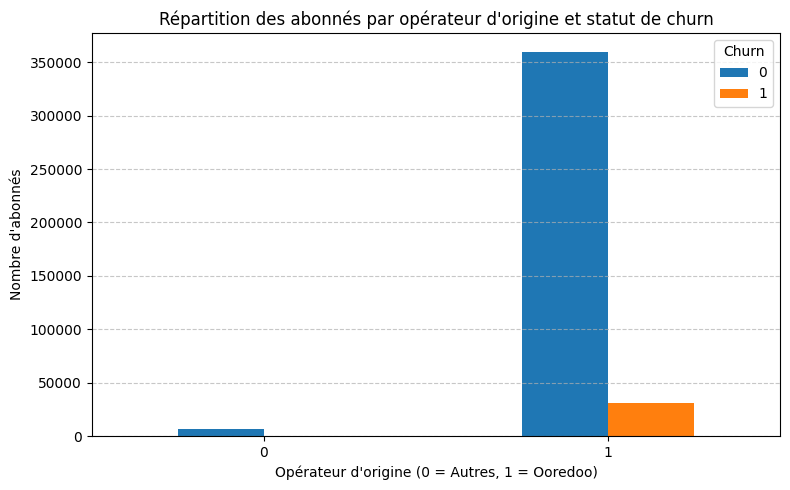

In [262]:
# Re-import after reset
import pandas as pd
import matplotlib.pyplot as plt

# Données simulées à partir des valeurs données
df_simulated = data_per_period.copy()

# Création d'un tableau croisé
churn_counts = df_simulated.groupby(['original_operator', 'churn']).size().unstack(fill_value=0)

# Tracer l'histogramme groupé
churn_counts.plot(kind='bar', figsize=(8, 5))

# Ajout de titres et labels
plt.title("Répartition des abonnés par opérateur d'origine et statut de churn")
plt.xlabel("Opérateur d'origine (0 = Autres, 1 = Ooredoo)")
plt.ylabel("Nombre d'abonnés")
plt.xticks(rotation=0)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.legend(title="Churn")
plt.tight_layout()
plt.show()


C:\Users\Client\AppData\Local\Temp\ipykernel_24284\3527193220.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=final_df, x='churn', palette='coolwarm')


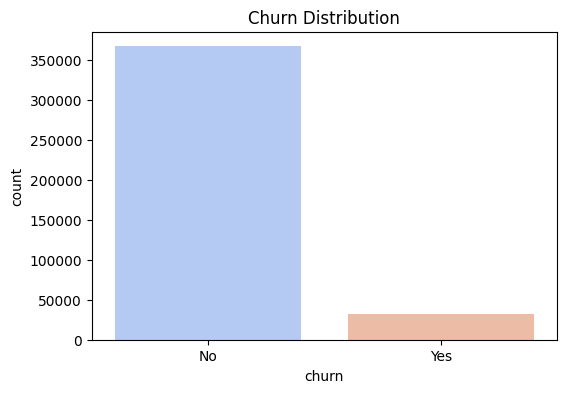

In [84]:
import matplotlib.pyplot as plt
import seaborn as sns
plt.figure(figsize=(6, 4))
sns.countplot(data=final_df, x='churn', palette='coolwarm')
plt.title('Churn Distribution')
plt.show()


C:\Users\Client\AppData\Local\Temp\ipykernel_24284\898705303.py:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.countplot(data=final_df, x='churn', palette='coolwarm')


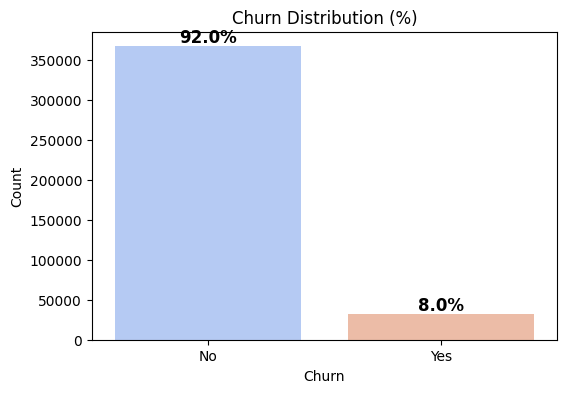

In [85]:
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(6, 4))
ax = sns.countplot(data=final_df, x='churn', palette='coolwarm')
total = len(final_df)
for p in ax.patches:
    count = int(p.get_height())
    percentage = 100 * count / total
    ax.annotate(f'{percentage:.1f}%', (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='bottom', fontsize=12, color='black', fontweight='bold')
plt.title('Churn Distribution (%)')
plt.ylabel('Count')
plt.xlabel('Churn')
plt.show()


C:\Users\Client\AppData\Local\Temp\ipykernel_24284\1810089435.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=final_df, x='gender', palette='coolwarm')


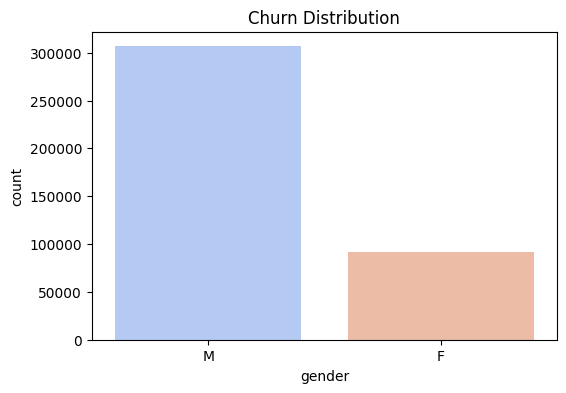

In [86]:
import matplotlib.pyplot as plt
import seaborn as sns
plt.figure(figsize=(6, 4))
sns.countplot(data=final_df, x='gender', palette='coolwarm')
plt.title('Churn Distribution')
plt.show()


In [87]:
print(final_df['gender'].unique())


['M' 'F']


In [88]:
print(final_df['flag_smartphone'].unique())


['Y' 'N' '-']


In [89]:
final_df['flag_smartphone'] = final_df['flag_smartphone'].replace({'Y': 1, 'N': 0, '-': 0}).astype(int)


C:\Users\Client\AppData\Local\Temp\ipykernel_24284\2163205522.py:1: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  final_df['flag_smartphone'] = final_df['flag_smartphone'].replace({'Y': 1, 'N': 0, '-': 0}).astype(int)


In [90]:
final_df

,churn,classe_anciennete,subscriber_id,date_activation,first_call_date,last_call_date,original_operator,dat_remb_kridi_net,tenure_days,has_international_call,...,revenu_furfait_data_dinar_2024/08,revenu_furfait_data_dinar_2024/09,revenu_furfait_data_dinar_2024/10,revenu_furfait_data_dinar_2024/11,revenu_furfait_data_dinar_2024/12,revenu_furfait_data_dinar_2025/01,age,marital_status,gender,customer_language
0,No,0 to 3 Months,2180606151,2025-01-30,2024-12-30,2025-01-31,1,0,0,0,...,0.0,0.0,0.0,0.0,0.0,25.0,42.0,Celibataire,M,Français
1,No,0 to 3 Months,2180583701,2024-12-23,2024-12-23,2024-12-29,1,0,38,0,...,0.0,0.0,0.0,0.0,3.7,0.0,50.0,Celibataire,M,Anglais
2,No,0 to 3 Months,2180725273,2025-01-06,2025-01-07,2025-01-07,1,0,24,0,...,0.0,0.0,0.0,0.0,0.0,0.0,42.0,Celibataire,M,Arabe
3,No,0 to 3 Months,2180582384,2024-12-23,2024-12-23,2025-01-31,1,0,38,0,...,0.0,0.0,0.0,0.0,1.5,0.5,30.0,Celibataire,F,Arabe
4,No,0 to 3 Months,2180594051,2024-12-24,2024-12-24,2025-01-31,1,0,37,0,...,0.0,0.0,0.0,0.0,0.0,0.0,25.0,Celibataire,M,Anglais
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
398401,Yes,More than 36 Months,2147371881,2018-07-29,2018-07-18,2023-06-01,1,1,2364,0,...,0.0,0.0,0.0,0.0,0.0,0.0,28.0,Celibataire,F,Anglais
398402,Yes,More than 36 Months,2148535710,2019-02-12,2019-02-12,2024-04-10,1,1,2136,0,...,0.0,0.0,0.0,0.0,0.0,0.0,45.0,Celibataire,F,Anglais
398403,Yes,More than 36 Months,19403279,2013-01-16,2015-11-30,2024-05-29,1,0,4365,0,...,0.0,0.0,0.0,0.0,0.0,0.0,48.0,Celibataire,M,Français
398404,Yes,More than 36 Months,11868071,2010-06-16,2015-11-30,2024-10-25,1,1,5343,0,...,0.0,0.0,0.0,0.0,0.0,0.0,36.0,Celibataire,M,Anglais


In [91]:
final_df['churn'] = final_df['churn'].replace({'No': 0, 'Yes': 1}).astype(int)


C:\Users\Client\AppData\Local\Temp\ipykernel_24284\95679680.py:1: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  final_df['churn'] = final_df['churn'].replace({'No': 0, 'Yes': 1}).astype(int)


In [92]:
final_df

,churn,classe_anciennete,subscriber_id,date_activation,first_call_date,last_call_date,original_operator,dat_remb_kridi_net,tenure_days,has_international_call,...,revenu_furfait_data_dinar_2024/08,revenu_furfait_data_dinar_2024/09,revenu_furfait_data_dinar_2024/10,revenu_furfait_data_dinar_2024/11,revenu_furfait_data_dinar_2024/12,revenu_furfait_data_dinar_2025/01,age,marital_status,gender,customer_language
0,0,0 to 3 Months,2180606151,2025-01-30,2024-12-30,2025-01-31,1,0,0,0,...,0.0,0.0,0.0,0.0,0.0,25.0,42.0,Celibataire,M,Français
1,0,0 to 3 Months,2180583701,2024-12-23,2024-12-23,2024-12-29,1,0,38,0,...,0.0,0.0,0.0,0.0,3.7,0.0,50.0,Celibataire,M,Anglais
2,0,0 to 3 Months,2180725273,2025-01-06,2025-01-07,2025-01-07,1,0,24,0,...,0.0,0.0,0.0,0.0,0.0,0.0,42.0,Celibataire,M,Arabe
3,0,0 to 3 Months,2180582384,2024-12-23,2024-12-23,2025-01-31,1,0,38,0,...,0.0,0.0,0.0,0.0,1.5,0.5,30.0,Celibataire,F,Arabe
4,0,0 to 3 Months,2180594051,2024-12-24,2024-12-24,2025-01-31,1,0,37,0,...,0.0,0.0,0.0,0.0,0.0,0.0,25.0,Celibataire,M,Anglais
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
398401,1,More than 36 Months,2147371881,2018-07-29,2018-07-18,2023-06-01,1,1,2364,0,...,0.0,0.0,0.0,0.0,0.0,0.0,28.0,Celibataire,F,Anglais
398402,1,More than 36 Months,2148535710,2019-02-12,2019-02-12,2024-04-10,1,1,2136,0,...,0.0,0.0,0.0,0.0,0.0,0.0,45.0,Celibataire,F,Anglais
398403,1,More than 36 Months,19403279,2013-01-16,2015-11-30,2024-05-29,1,0,4365,0,...,0.0,0.0,0.0,0.0,0.0,0.0,48.0,Celibataire,M,Français
398404,1,More than 36 Months,11868071,2010-06-16,2015-11-30,2024-10-25,1,1,5343,0,...,0.0,0.0,0.0,0.0,0.0,0.0,36.0,Celibataire,M,Anglais


In [93]:
# 1. On liste toutes les familles de variables mensuelles
familles = [
    'arpu_out_without_bonus',
    'bonus_on_consumption_revenue',
    'bonus_on_refill_flash_revenue',
    'bonus_on_refill_revenue',
    'consumption_revenue',
    'data_trafic_volume',
    'incoming_revenue',
    'mou_international',
    'mou_offnet_fix',
    'mou_offnet_mobile',
    'mou_onnet',
    'number_of_reactivations',
    'number_of_recharges',
    'number_of_sms_international',
    'number_of_sms_offnet',
    'number_of_sms_onnet',
    'recharge_amount',
    'total_data_revenu_amount',
    'total_voice_revenu_amount',
    'revenu_furfait_data_dinar'
]
final_df_per_period=final_df.copy()
# 2. Pour chaque famille, créer une nouvelle colonne "moyenne"
for famille in familles:
    colonnes_famille = [col for col in final_df.columns if col.startswith(famille)]
    
    # Calcul de la moyenne ligne par ligne
    final_df[f'{famille}_moyenne'] = final_df[colonnes_famille].mean(axis=1)
    
    # (Optionnel) Supprimer les anciennes colonnes mensuelles après calcul
    final_df = final_df.drop(columns=colonnes_famille)

# 3. Vérification rapide
final_df.head()

,churn,classe_anciennete,subscriber_id,date_activation,first_call_date,last_call_date,original_operator,dat_remb_kridi_net,tenure_days,has_international_call,...,mou_onnet_moyenne,number_of_reactivations_moyenne,number_of_recharges_moyenne,number_of_sms_international_moyenne,number_of_sms_offnet_moyenne,number_of_sms_onnet_moyenne,recharge_amount_moyenne,total_data_revenu_amount_moyenne,total_voice_revenu_amount_moyenne,revenu_furfait_data_dinar_moyenne
0,0,0 to 3 Months,2180606151,2025-01-30,2024-12-30,2025-01-31,1,0,0,0,...,411.428571,0.0,0.000000,0.142857,0.000000,0.285714,0.000000,3571.428571,47.984286,3.571429
1,0,0 to 3 Months,2180583701,2024-12-23,2024-12-23,2024-12-29,1,0,38,0,...,68.571429,0.0,0.571429,0.000000,0.000000,0.571429,571.428571,1057.142857,103.700000,0.528571
2,0,0 to 3 Months,2180725273,2025-01-06,2025-01-07,2025-01-07,1,0,24,0,...,0.000000,0.0,0.000000,0.000000,0.000000,1.571429,0.000000,0.000000,408.599714,0.000000
3,0,0 to 3 Months,2180582384,2024-12-23,2024-12-23,2025-01-31,1,0,38,0,...,1868.571429,0.0,0.571429,0.000000,0.142857,1.428571,2285.714286,607.142857,1605.219286,0.285714
4,0,0 to 3 Months,2180594051,2024-12-24,2024-12-24,2025-01-31,1,0,37,0,...,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,817.199429,0.000000


In [326]:
for col in final_df.columns:
    print(col)

churn
classe_anciennete
subscriber_id
original_operator
dat_remb_kridi_net
tenure_days
has_international_call
time_to_churn
device_type
flag_smartphone
age
marital_status
gender
customer_language
bonus_on_refill_revenue_moyenne
incoming_revenue_moyenne
number_of_recharges_moyenne
total_data_revenu_amount_moyenne
revenu_furfait_data_dinar_moyenne


In [327]:
final_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 398406 entries, 0 to 398405
Data columns (total 19 columns):
 #   Column                             Non-Null Count   Dtype  
---  ------                             --------------   -----  
 0   churn                              398406 non-null  int64  
 1   classe_anciennete                  398406 non-null  object 
 2   subscriber_id                      398406 non-null  int64  
 3   original_operator                  398406 non-null  int64  
 4   dat_remb_kridi_net                 398406 non-null  int64  
 5   tenure_days                        398406 non-null  int64  
 6   has_international_call             398406 non-null  int64  
 7   time_to_churn                      398406 non-null  int64  
 8   device_type                        398406 non-null  object 
 9   flag_smartphone                    398406 non-null  int64  
 10  age                                397796 non-null  object 
 11  marital_status                     3984

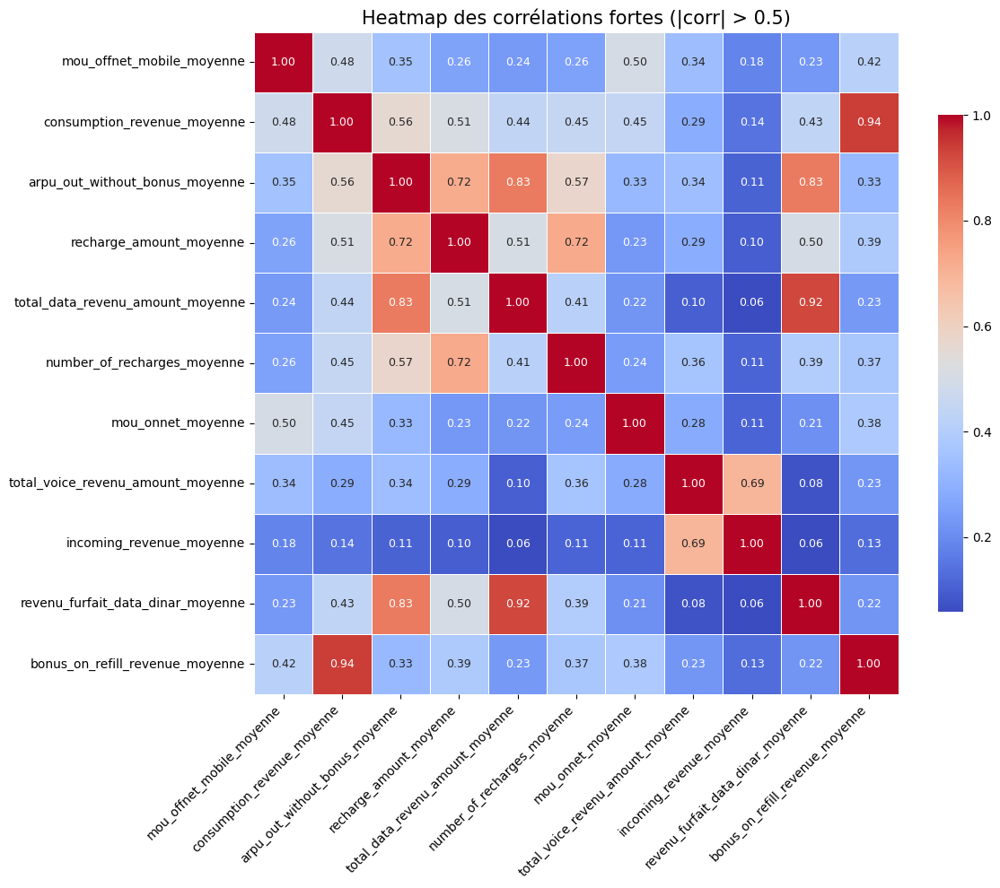

In [94]:
import seaborn as sns
import matplotlib.pyplot as plt

# 1. Sélectionner les colonnes numériques sans subscriber_id
numeric_cols = final_df.select_dtypes(include='number').columns.drop('subscriber_id', errors='ignore')

# 2. Calcul de la matrice de corrélation
correlation_matrix = final_df[numeric_cols].corr()

# 3. Filtrage des corrélations fortes
corr_pairs = correlation_matrix.unstack()
strong_pairs = corr_pairs[(abs(corr_pairs) > 0.5) & (abs(corr_pairs) < 1.0)].drop_duplicates().sort_values(ascending=False)

# 4. Affichage si au moins une paire est trouvée
if not strong_pairs.empty:
    top_vars = list(set([i for i, j in strong_pairs.index] + [j for i, j in strong_pairs.index]))
    filtered_matrix = correlation_matrix.loc[top_vars, top_vars]

    plt.figure(figsize=(12, 10))
    sns.heatmap(filtered_matrix, annot=True, fmt=".2f", cmap='coolwarm',
                linewidths=0.5, cbar_kws={'shrink': 0.75}, annot_kws={"size": 9})
    plt.title("Heatmap des corrélations fortes (|corr| > 0.5)", fontsize=15)
    plt.xticks(rotation=45, ha='right')
    plt.yticks(rotation=0)
    plt.tight_layout()
    plt.show()
else:
    print("Aucune paire fortement corrélée (|corr| > 0.5) n'a été trouvée.")


In [95]:
# Count of 0 values
zero_counts = {
    "consumption_revenue_moyenne": (final_df["consumption_revenue_moyenne"] == 0).sum(),
    "bonus_on_refill_revenue_moyenne": (final_df["bonus_on_refill_revenue_moyenne"] == 0).sum()
}

print(zero_counts)

{'consumption_revenue_moyenne': np.int64(74617), 'bonus_on_refill_revenue_moyenne': np.int64(263117)}


In [96]:
final_df.drop(columns=['bonus_on_refill_revenue_moyenne'], inplace=True)


In [97]:
# Count of 0 values
zero_counts = {
    "total_data_revenu_amount_moyenne": (final_df["total_data_revenu_amount_moyenne"] == 0).sum(),
    "arpu_out_without_bonus_moyenne": (final_df["arpu_out_without_bonus_moyenne"] == 0).sum()
}

print(zero_counts)

{'total_data_revenu_amount_moyenne': np.int64(89018), 'arpu_out_without_bonus_moyenne': np.int64(77385)}


In [98]:
final_df.drop(columns=['total_data_revenu_amount_moyenne'], inplace=True)


In [99]:
# Count of 0 values
zero_counts = {
    "arpu_out_without_bonus_moyenne": (final_df["arpu_out_without_bonus_moyenne"] == 0).sum(),
    "revenu_furfait_data_dinar_moyenne": (final_df["revenu_furfait_data_dinar_moyenne"] == 0).sum()
}

print(zero_counts)

{'arpu_out_without_bonus_moyenne': np.int64(77385), 'revenu_furfait_data_dinar_moyenne': np.int64(197713)}


In [100]:
final_df.drop(columns=['revenu_furfait_data_dinar_moyenne'], inplace=True)


In [101]:
# Count of 0 values
zero_counts = {
    "total_voice_revenu_amount_moyenne": (final_df["total_voice_revenu_amount_moyenne"] == 0).sum(),
    "incoming_revenue_moyenne": (final_df["incoming_revenue_moyenne"] == 0).sum()
}

print(zero_counts)

{'total_voice_revenu_amount_moyenne': np.int64(1658), 'incoming_revenue_moyenne': np.int64(78182)}


In [102]:
final_df.drop(columns=['incoming_revenue_moyenne'], inplace=True)


In [103]:
# Count of 0 values
zero_counts = {
    "number_of_recharges_moyenne": (final_df["number_of_recharges_moyenne"] == 0).sum(),
    "recharge_amount_moyenne": (final_df["recharge_amount_moyenne"] == 0).sum()
}

print(zero_counts)

{'number_of_recharges_moyenne': np.int64(93246), 'recharge_amount_moyenne': np.int64(93246)}


In [104]:
final_df.drop(columns=['number_of_recharges_moyenne'], inplace=True)


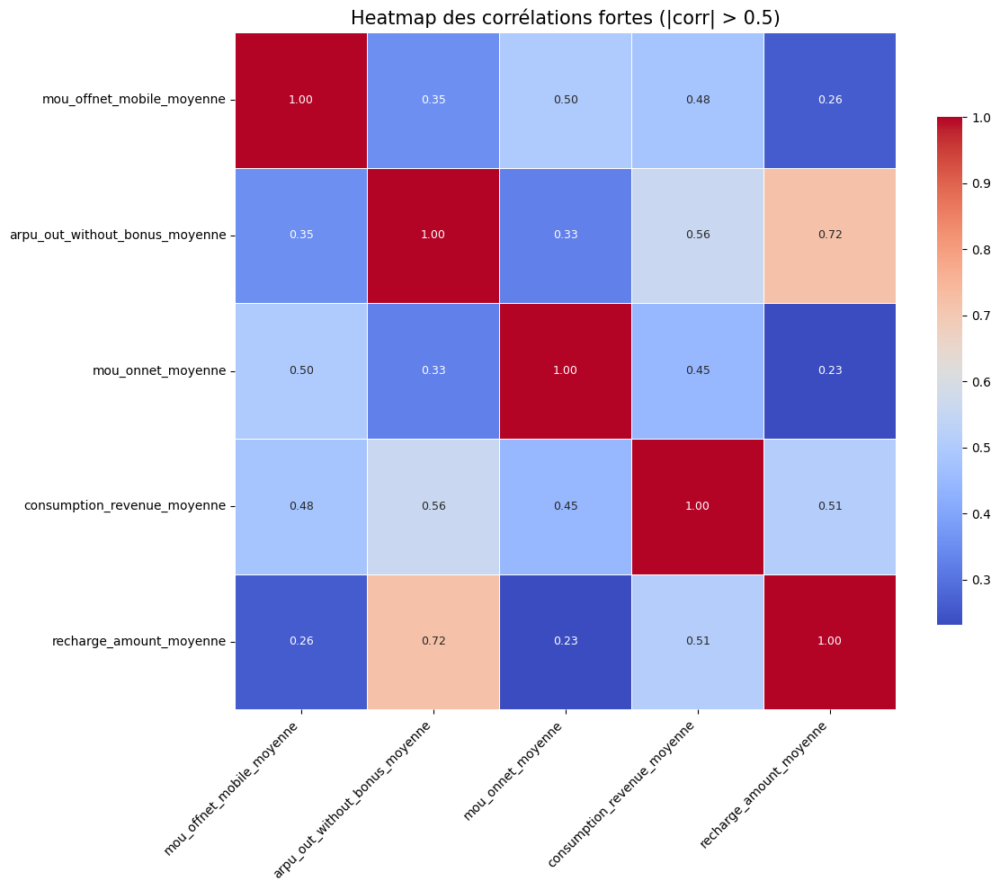

In [288]:
import seaborn as sns
import matplotlib.pyplot as plt

# 1. Sélectionner les colonnes numériques sans subscriber_id
numeric_cols = final_df.select_dtypes(include='number').columns.drop('subscriber_id', errors='ignore')

# 2. Calcul de la matrice de corrélation
correlation_matrix = final_df[numeric_cols].corr()

# 3. Filtrage des corrélations fortes
corr_pairs = correlation_matrix.unstack()
strong_pairs = corr_pairs[(abs(corr_pairs) > 0.5) & (abs(corr_pairs) < 1.0)].drop_duplicates().sort_values(ascending=False)

# 4. Affichage si au moins une paire est trouvée
if not strong_pairs.empty:
    top_vars = list(set([i for i, j in strong_pairs.index] + [j for i, j in strong_pairs.index]))
    filtered_matrix = correlation_matrix.loc[top_vars, top_vars]

    plt.figure(figsize=(12, 10))
    sns.heatmap(filtered_matrix, annot=True, fmt=".2f", cmap='coolwarm',
                linewidths=0.5, cbar_kws={'shrink': 0.75}, annot_kws={"size": 9})
    plt.title("Heatmap des corrélations fortes (|corr| > 0.5)", fontsize=15)
    plt.xticks(rotation=45, ha='right')
    plt.yticks(rotation=0)
    plt.tight_layout()
    plt.show()
else:
    print("Aucune paire fortement corrélée (|corr| > 0.5) n'a été trouvée.")

In [289]:
for col in final_df:
    print(col)

churn
classe_anciennete
subscriber_id
date_activation
first_call_date
last_call_date
original_operator
dat_remb_kridi_net
tenure_days
has_international_call
time_to_churn
device_type
flag_smartphone
age
marital_status
gender
customer_language
arpu_out_without_bonus_moyenne
bonus_on_consumption_revenue_moyenne
bonus_on_refill_flash_revenue_moyenne
consumption_revenue_moyenne
data_trafic_volume_moyenne
mou_international_moyenne
mou_offnet_fix_moyenne
mou_offnet_mobile_moyenne
mou_onnet_moyenne
number_of_reactivations_moyenne
number_of_sms_international_moyenne
number_of_sms_offnet_moyenne
number_of_sms_onnet_moyenne
recharge_amount_moyenne
total_voice_revenu_amount_moyenne


In [105]:
print(sorted(final_df['age'].unique()))


[np.float64(0.0), np.float64(1.0), np.float64(3.0), np.float64(5.0), np.float64(6.0), np.float64(7.0), np.float64(8.0), np.float64(9.0), np.float64(10.0), np.float64(11.0), np.float64(12.0), np.float64(13.0), np.float64(14.0), np.float64(15.0), np.float64(16.0), np.float64(17.0), np.float64(18.0), np.float64(19.0), np.float64(20.0), np.float64(21.0), np.float64(22.0), np.float64(23.0), np.float64(24.0), np.float64(25.0), np.float64(26.0), np.float64(27.0), np.float64(28.0), np.float64(29.0), np.float64(30.0), np.float64(31.0), np.float64(32.0), np.float64(33.0), np.float64(34.0), np.float64(35.0), np.float64(36.0), np.float64(37.0), np.float64(38.0), np.float64(39.0), np.float64(40.0), np.float64(41.0), np.float64(42.0), np.float64(43.0), np.float64(44.0), np.float64(45.0), np.float64(46.0), np.float64(47.0), np.float64(48.0), np.float64(49.0), np.float64(50.0), np.float64(51.0), np.float64(52.0), np.float64(53.0), np.float64(54.0), np.float64(55.0), np.float64(56.0), np.float64(57.0),

In [106]:
import numpy as np

# Step 1: Cap ages at 100 (everyone above 100 becomes 100)
final_df['age_capped'] = np.where(final_df['age'] > 100, 100, final_df['age'])

# Step 2: Define the bins and labels
age_bins = [0, 18, 50, np.inf]           # np.inf means "anything bigger than 50"
age_labels = ['<18', '18-50', '>50']

# Step 3: Create the age group column as categorical/object (NO ROWS DROPPED)
final_df['age_group'] = pd.cut(
    final_df['age_capped'],
    bins=age_bins,
    labels=age_labels,
    right=False,          # so 18 is in "18-50"
    include_lowest=True   # so 0 is included
)

# If you want, you can keep both 'age' and 'age_group' for analysis:
print(final_df[['age', 'age_group']].head(10))
print(final_df['age_group'].value_counts())

# If you don't need 'age_capped' anymore, you can remove that column,
# but again, this doesn't drop any subscriber:
final_df.drop('age_capped', axis=1, inplace=True)


    age age_group
0  42.0     18-50
1  50.0       >50
2  42.0     18-50
3  30.0     18-50
4  25.0     18-50
5  43.0     18-50
6  58.0       >50
7  62.0       >50
8  52.0       >50
9  24.0     18-50
age_group
18-50    273989
>50      124124
<18         293
Name: count, dtype: int64


In [107]:
import re

# 1) Build a regex that matches all the “illegal” Excel characters:
illegal_chars_re = re.compile(r'[\x00-\x1F\x7F-\x9F]')

def strip_illegal(s):
    """If s is a string, remove all control characters; else leave it alone."""
    if isinstance(s, str):
        return illegal_chars_re.sub('', s)
    return s

# 2) Apply it to all object (string) columns:
for col in final_df.select_dtypes(include="object"):
    final_df[col] = final_df[col].map(strip_illegal)

# 3) (Optional) verify that no more illegal characters remain:
#    this will print 0 if you've cleaned all of them
cnt_bad = final_df.select_dtypes(include="object")\
    .apply(lambda col: col.str.contains(illegal_chars_re).sum())\
    .sum()
print(f"Total remaining illegal chars in text columns: {cnt_bad}")


Total remaining illegal chars in text columns: 0


In [ ]:
partner = data["original_operator"] == 1
no_partner = data["original_operator"] == 0

print(partner.sum())  # nombre de vrais
print(no_partner.sum())


390870
7536


In [109]:
final_df['device_type'].unique()

array(['Smartphone', 'Phablet', 'Feature Phone', 'Tablet', 'Basic Phone',
       'Router', 'Mobile broadband PCI card', 'Wearable', 'IoT Device',
       'USB Modem', '-', 'POS'], dtype=object)

In [110]:
# Find the mode (most frequent value), **excluding** '-'
mode_device_type = final_df.loc[final_df['device_type'] != '-', 'device_type'].mode()[0]

# Replace all '-' with the mode
final_df['device_type'] = final_df['device_type'].replace('-', mode_device_type)

# Check result
print(final_df['device_type'].unique())
print(final_df['device_type'].value_counts())


['Smartphone' 'Phablet' 'Feature Phone' 'Tablet' 'Basic Phone' 'Router'
 'Mobile broadband PCI card' 'Wearable' 'IoT Device' 'USB Modem' 'POS']
device_type
Phablet                      237965
Basic Phone                   56461
Smartphone                    55464
Feature Phone                 23748
Router                        17266
Mobile broadband PCI card      2830
Tablet                         1887
IoT Device                     1295
USB Modem                       859
Wearable                        398
POS                             233
Name: count, dtype: int64


In [111]:
final_df=final_df.drop(columns=['age_group'])

In [112]:
for col in final_df_per_period.columns:
    print(col)

churn
classe_anciennete
subscriber_id
date_activation
first_call_date
last_call_date
original_operator
dat_remb_kridi_net
tenure_days
has_international_call
time_to_churn
device_type
flag_smartphone
arpu_out_without_bonus_202407
arpu_out_without_bonus_202408
arpu_out_without_bonus_202409
arpu_out_without_bonus_202410
arpu_out_without_bonus_202411
arpu_out_without_bonus_202412
arpu_out_without_bonus_202501
bonus_on_consumption_revenue_202407
bonus_on_consumption_revenue_202408
bonus_on_consumption_revenue_202409
bonus_on_consumption_revenue_202410
bonus_on_consumption_revenue_202411
bonus_on_consumption_revenue_202412
bonus_on_consumption_revenue_202501
bonus_on_refill_flash_revenue_202407
bonus_on_refill_flash_revenue_202408
bonus_on_refill_flash_revenue_202409
bonus_on_refill_flash_revenue_202410
bonus_on_refill_flash_revenue_202411
bonus_on_refill_flash_revenue_202412
bonus_on_refill_flash_revenue_202501
bonus_on_refill_revenue_202407
bonus_on_refill_revenue_202408
bonus_on_refill_re

Taux de churn (%) par type d'appareil :

device_type
Wearable                     17.84
IoT Device                   17.76
Tablet                       12.98
Router                       10.66
Mobile broadband PCI card     9.82
Feature Phone                 9.03
Basic Phone                   8.80
Smartphone                    7.84
Phablet                       7.41
USB Modem                     3.84
POS                           0.86
Name: churn, dtype: float64


C:\Users\Client\AppData\Local\Temp\ipykernel_24284\3574771836.py:14: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=churn_rate_by_device.values, y=churn_rate_by_device.index, palette='coolwarm')


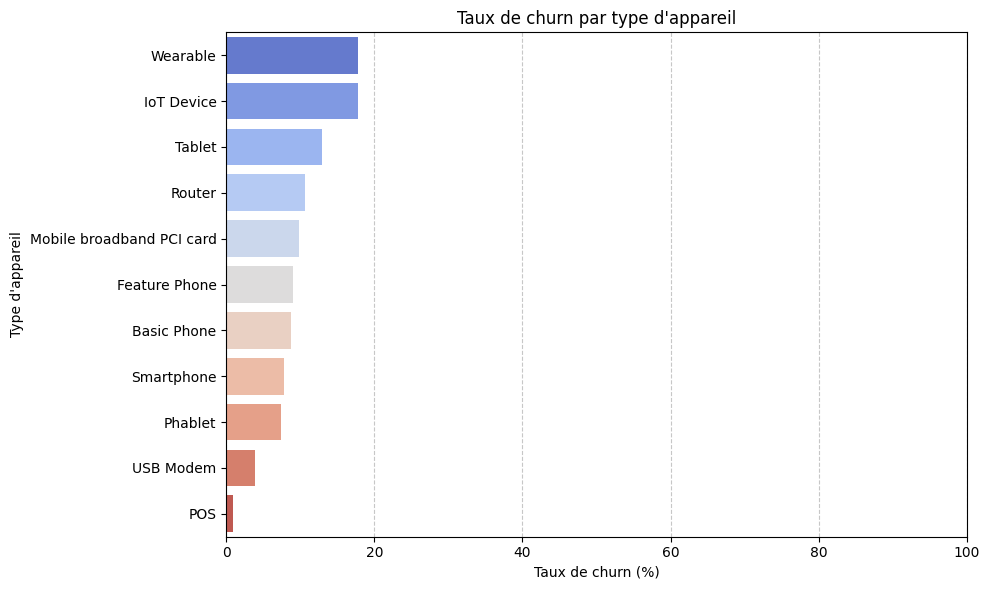

In [113]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# 1. Calculer le taux de churn (%) par device_type
churn_rate_by_device = final_df.groupby('device_type')['churn'].mean().sort_values(ascending=False) * 100

# 2. Afficher le tableau des taux
print("Taux de churn (%) par type d'appareil :\n")
print(churn_rate_by_device.round(2))

# 3. Tracer un barplot trié
plt.figure(figsize=(10, 6))
sns.barplot(x=churn_rate_by_device.values, y=churn_rate_by_device.index, palette='coolwarm')

plt.title("Taux de churn par type d'appareil")
plt.xlabel("Taux de churn (%)")
plt.ylabel("Type d'appareil")
plt.xlim(0, 100)
plt.grid(axis='x', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()


In [299]:
for col in final_df.columns:
    print(col)

churn
classe_anciennete
subscriber_id
date_activation
first_call_date
last_call_date
original_operator
dat_remb_kridi_net
tenure_days
has_international_call
time_to_churn
device_type
flag_smartphone
age
marital_status
gender
customer_language
arpu_out_without_bonus_moyenne
bonus_on_consumption_revenue_moyenne
bonus_on_refill_flash_revenue_moyenne
consumption_revenue_moyenne
data_trafic_volume_moyenne
mou_international_moyenne
mou_offnet_fix_moyenne
mou_offnet_mobile_moyenne
mou_onnet_moyenne
number_of_reactivations_moyenne
number_of_sms_international_moyenne
number_of_sms_offnet_moyenne
number_of_sms_onnet_moyenne
recharge_amount_moyenne
total_voice_revenu_amount_moyenne


### Survival analysis

In [114]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import norm
import statsmodels.api as st
from sklearn.preprocessing import LabelEncoder
labelencoder = LabelEncoder()

#Lifelines is a survival analysis package
from lifelines import KaplanMeierFitter
from lifelines.statistics import multivariate_logrank_test   
from lifelines.statistics import logrank_test
from lifelines import CoxPHFitter

In [115]:
eventvar = final_df['churn']
timevar = final_df['tenure_days']

In [116]:
import numpy as np
import pandas as pd

# Cap impossible ages for data quality
final_df['age'] = np.where(final_df['age'] > 120, 120, final_df['age'])
final_df['age'] = np.where(final_df['age'] < 0, 0, final_df['age'])

# Define bins and labels
bins = [0, 18, 50, 120]
labels = ['<18', '18-50', '>50']

# Bin and overwrite 'age' column (convert to object/categorical)
final_df['age'] = pd.cut(final_df['age'], bins=bins, labels=labels, right=False, include_lowest=True)
final_df['age'] = final_df['age'].astype('object')

print(final_df['age'].value_counts())
print(final_df['age'].dtype)


age
18-50    273989
>50      123514
<18         293
Name: count, dtype: int64
object


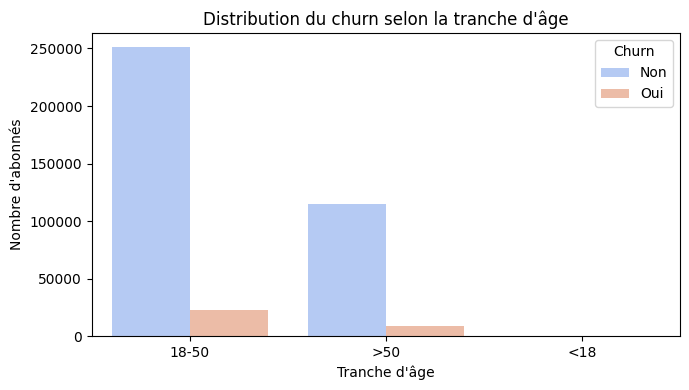


Taux de churn (%) par tranche d'âge :

age
18-50     8.38
<18      10.92
>50       7.13
Name: churn, dtype: float64


C:\Users\Client\AppData\Local\Temp\ipykernel_24284\2307512431.py:20: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=churn_rate_by_age.index, y=churn_rate_by_age.values, palette='coolwarm')


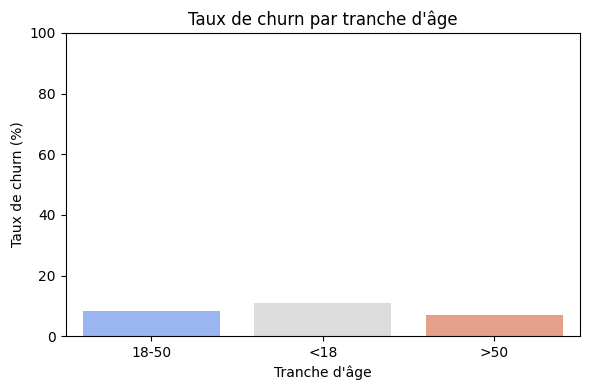

In [117]:
# 2. Distribution absolue selon churn
plt.figure(figsize=(7, 4))
sns.countplot(x=final_df['age'], hue=final_df['churn'], palette='coolwarm')
plt.title("Distribution du churn selon la tranche d'âge")
plt.xlabel("Tranche d'âge")
plt.ylabel("Nombre d'abonnés")
plt.legend(title="Churn", labels=["Non", "Oui"])
plt.tight_layout()
plt.show()

# 3. Taux de churn (%) par tranche d'âge
churn_rate_by_age = final_df.groupby('age')['churn'].mean() * 100

# Afficher les taux
print("\nTaux de churn (%) par tranche d'âge :\n")
print(churn_rate_by_age.round(2))

# 4. Barplot des taux de churn
plt.figure(figsize=(6, 4))
sns.barplot(x=churn_rate_by_age.index, y=churn_rate_by_age.values, palette='coolwarm')
plt.title("Taux de churn par tranche d'âge")
plt.xlabel("Tranche d'âge")
plt.ylabel("Taux de churn (%)")
plt.ylim(0, 100)
plt.tight_layout()
plt.show()

In [118]:
import numpy as np
import pandas as pd

# Cap impossible ages for data quality
final_df_per_period['age'] = np.where(final_df_per_period['age'] > 120, 120, final_df_per_period['age'])
final_df_per_period['age'] = np.where(final_df_per_period['age'] < 0, 0, final_df_per_period['age'])

# Define bins and labels
bins = [0, 18, 50, 120]
labels = ['<18', '18-50', '>50']

# Bin and overwrite 'age' column (convert to object/categorical)
final_df_per_period['age'] = pd.cut(final_df_per_period['age'], bins=bins, labels=labels, right=False, include_lowest=True)
final_df_per_period['age'] = final_df_per_period['age'].astype('object')

print(final_df_per_period['age'].value_counts())
print(final_df_per_period['age'].dtype)


age
18-50    273989
>50      123514
<18         293
Name: count, dtype: int64
object


In [119]:
# List all object (string/categorical) columns in the DataFrame
object_columns = final_df.select_dtypes(include='object').columns
print("Object columns in your DataFrame:")
print(object_columns)


Object columns in your DataFrame:
Index(['classe_anciennete', 'device_type', 'age', 'marital_status', 'gender',
       'customer_language'],
      dtype='object')


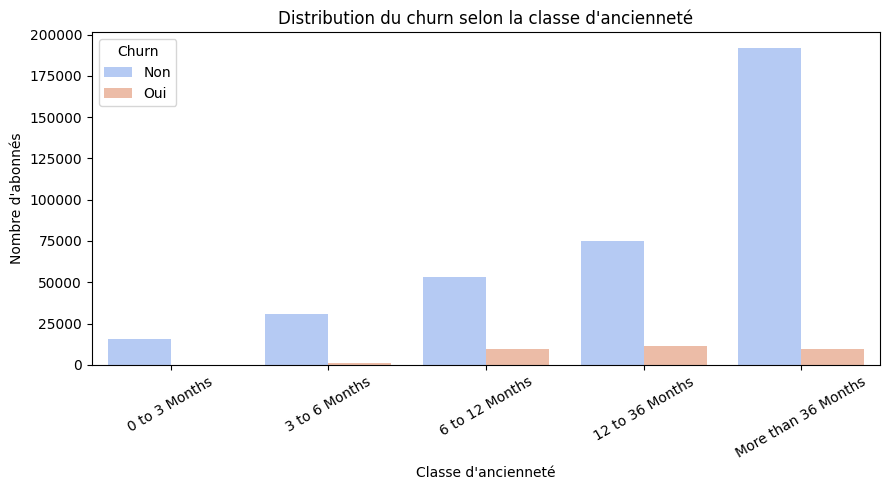

In [120]:
# 1. Définir l'ordre des classes d'ancienneté (même si certaines valeurs sont nulles)
anciennete_order = [
    '0 to 3 Months',
    '3 to 6 Months',
    '6 to 12 Months',
    '12 to 36 Months',
    'More than 36 Months'
]

# 2. Countplot avec toutes les classes affichées, y compris celles sans churners
plt.figure(figsize=(9, 5))
sns.countplot(data=final_df, x='classe_anciennete', hue='churn',
              palette='coolwarm', order=anciennete_order)
plt.title("Distribution du churn selon la classe d'ancienneté")
plt.xlabel("Classe d'ancienneté")
plt.ylabel("Nombre d'abonnés")
plt.legend(title="Churn", labels=["Non", "Oui"])
plt.xticks(rotation=30)
plt.tight_layout()
plt.show()



Taux de churn (%) par classe d'ancienneté :

classe_anciennete
0 to 3 Months           0.03
12 to 36 Months        13.23
3 to 6 Months           3.63
6 to 12 Months         15.57
More than 36 Months     4.63
Name: churn, dtype: float64


C:\Users\Client\AppData\Local\Temp\ipykernel_24284\227135733.py:13: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=churn_rate_by_tenure.index, y=churn_rate_by_tenure.values, palette='coolwarm')


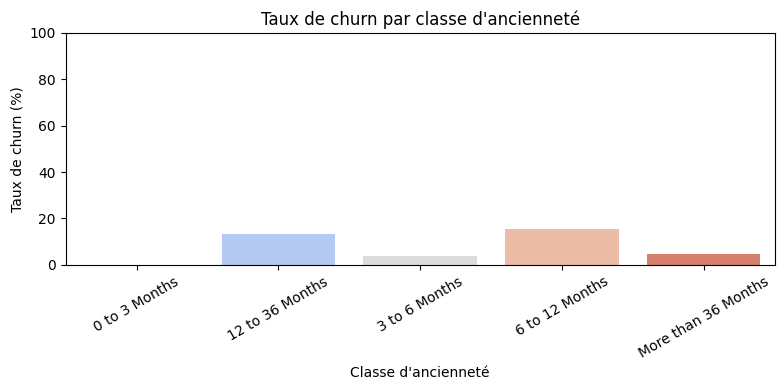

In [121]:
import matplotlib.pyplot as plt
import seaborn as sns

# 1. Calcul du taux de churn (%) par classe d'ancienneté
churn_rate_by_tenure = final_df.groupby('classe_anciennete')['churn'].mean().sort_index() * 100

# 2. Affichage dans la console
print("\nTaux de churn (%) par classe d'ancienneté :\n")
print(churn_rate_by_tenure.round(2))

# 3. Barplot
plt.figure(figsize=(8, 4))
sns.barplot(x=churn_rate_by_tenure.index, y=churn_rate_by_tenure.values, palette='coolwarm')
plt.title("Taux de churn par classe d'ancienneté")
plt.xlabel("Classe d'ancienneté")
plt.ylabel("Taux de churn (%)")
plt.ylim(0, 100)
plt.xticks(rotation=30)
plt.tight_layout()
plt.show()


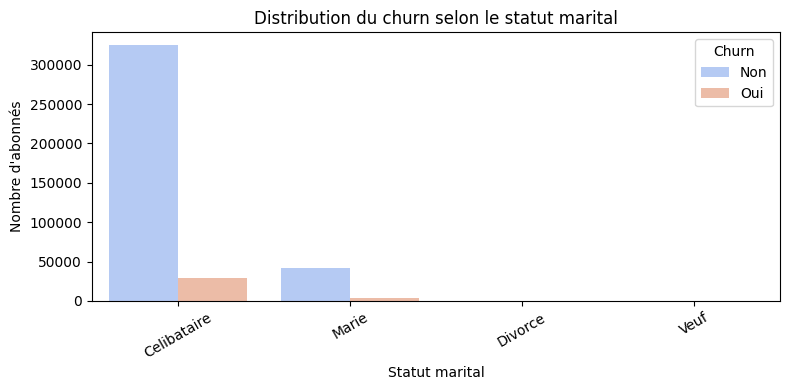


Taux de churn (%) par statut marital :

marital_status
Celibataire    8.05
Divorce        3.33
Marie          7.45
Veuf           6.90
Name: churn, dtype: float64


C:\Users\Client\AppData\Local\Temp\ipykernel_15500\3333080237.py:23: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=churn_rate_by_marital.index, y=churn_rate_by_marital.values, palette='coolwarm')


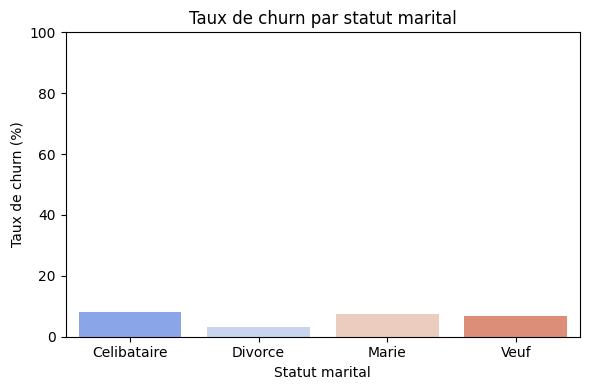

In [311]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# 1. Countplot : distribution du churn selon le statut marital
plt.figure(figsize=(8, 4))
sns.countplot(data=final_df, x='marital_status', hue='churn', palette='coolwarm')
plt.title("Distribution du churn selon le statut marital")
plt.xlabel("Statut marital")
plt.ylabel("Nombre d'abonnés")
plt.legend(title="Churn", labels=["Non", "Oui"])
plt.xticks(rotation=30)
plt.tight_layout()
plt.show()

# 2. Taux de churn (%) par statut marital
churn_rate_by_marital = final_df.groupby('marital_status')['churn'].mean() * 100
print("\nTaux de churn (%) par statut marital :\n")
print(churn_rate_by_marital.round(2))

# 3. Barplot du taux
plt.figure(figsize=(6, 4))
sns.barplot(x=churn_rate_by_marital.index, y=churn_rate_by_marital.values, palette='coolwarm')
plt.title("Taux de churn par statut marital")
plt.xlabel("Statut marital")
plt.ylabel("Taux de churn (%)")
plt.ylim(0, 100)
plt.tight_layout()
plt.show()


In [122]:
# Nettoyage des valeurs incohérentes dans customer_language
final_df['customer_language'] = final_df['customer_language'].replace({
    'Francais': 'Français',  # harmoniser
    'Anglais': 'Anglais',    # si tu veux normaliser la casse : .str.lower() ou .str.capitalize()
    'Arabe': 'Arabe',
    'Italien': 'Italien'
})

# Vérifier les valeurs distinctes après regroupement
print("Valeurs uniques après regroupement :", final_df['customer_language'].unique())


Valeurs uniques après regroupement : ['Français' 'Anglais' 'Arabe' 'Italien']


In [123]:
# Nettoyage des valeurs incohérentes dans customer_language
final_df_per_period['customer_language'] = final_df_per_period['customer_language'].replace({
    'Francais': 'Français',  # harmoniser
    'Anglais': 'Anglais',    # si tu veux normaliser la casse : .str.lower() ou .str.capitalize()
    'Arabe': 'Arabe',
    'Italien': 'Italien'
})

# Vérifier les valeurs distinctes après regroupement
print("Valeurs uniques après regroupement :", final_df_per_period['customer_language'].unique())


Valeurs uniques après regroupement : ['Français' 'Anglais' 'Arabe' 'Italien']


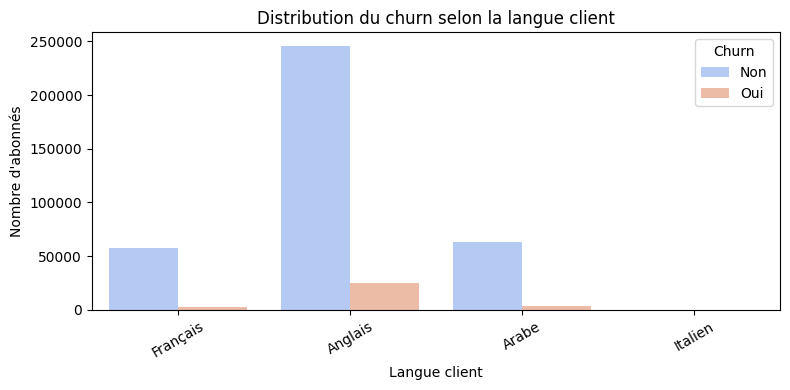


Taux de churn (%) par langue client :

customer_language
Anglais     9.21
Arabe       5.66
Français    5.03
Italien     2.17
Name: churn, dtype: float64


C:\Users\Client\AppData\Local\Temp\ipykernel_24284\3599146944.py:22: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=churn_rate_by_lang.index, y=churn_rate_by_lang.values, palette='coolwarm')


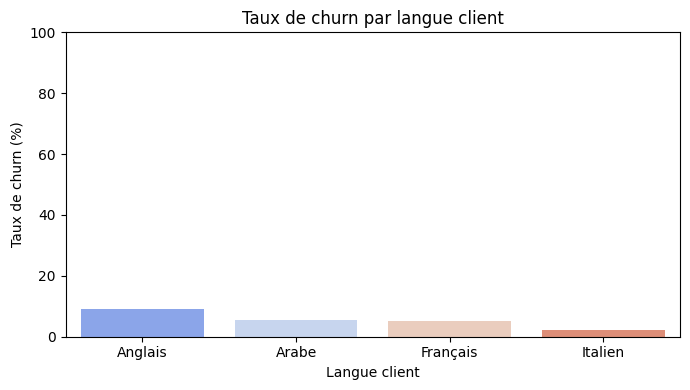

In [124]:
import matplotlib.pyplot as plt
import seaborn as sns

# 1. Countplot : distribution churn selon la langue client
plt.figure(figsize=(8, 4))
sns.countplot(data=final_df, x='customer_language', hue='churn', palette='coolwarm')
plt.title("Distribution du churn selon la langue client")
plt.xlabel("Langue client")
plt.ylabel("Nombre d'abonnés")
plt.legend(title="Churn", labels=["Non", "Oui"])
plt.xticks(rotation=30)
plt.tight_layout()
plt.show()

# 2. Taux de churn (%) par langue
churn_rate_by_lang = final_df.groupby('customer_language')['churn'].mean() * 100
print("\nTaux de churn (%) par langue client :\n")
print(churn_rate_by_lang.round(2))

# 3. Barplot du taux
plt.figure(figsize=(7, 4))
sns.barplot(x=churn_rate_by_lang.index, y=churn_rate_by_lang.values, palette='coolwarm')
plt.title("Taux de churn par langue client")
plt.xlabel("Langue client")
plt.ylabel("Taux de churn (%)")
plt.ylim(0, 100)
plt.tight_layout()
plt.show()


In [125]:
categorical = ['classe_anciennete', 'device_type', 'age', 'marital_status', 'gender','customer_language']

survivaldata = pd.get_dummies(final_df, columns = categorical, drop_first= True)
survivaldata.head()

,churn,subscriber_id,date_activation,first_call_date,last_call_date,original_operator,dat_remb_kridi_net,tenure_days,has_international_call,time_to_churn,...,device_type_Wearable,age_<18,age_>50,marital_status_Divorce,marital_status_Marie,marital_status_Veuf,gender_M,customer_language_Arabe,customer_language_Français,customer_language_Italien
0,0,2180606151,2025-01-30,2024-12-30,2025-01-31,1,0,0,0,0,...,False,False,False,False,False,False,True,False,True,False
1,0,2180583701,2024-12-23,2024-12-23,2024-12-29,1,0,38,0,33,...,False,False,True,False,False,False,True,False,False,False
2,0,2180725273,2025-01-06,2025-01-07,2025-01-07,1,0,24,0,24,...,False,False,False,False,False,False,True,True,False,False
3,0,2180582384,2024-12-23,2024-12-23,2025-01-31,1,0,38,0,0,...,False,False,False,False,False,False,False,True,False,False
4,0,2180594051,2024-12-24,2024-12-24,2025-01-31,1,0,37,0,0,...,False,False,False,False,False,False,True,False,False,False


In [126]:
dummy_cols = [col for col in survivaldata.columns if 'gender_' in col or 'device_type_' in col or 'age_' in col or 'marital_status_' in col or 'customer_language_' in col]
survivaldata[dummy_cols] = survivaldata[dummy_cols].astype(int)
survivaldata.head()

,churn,subscriber_id,date_activation,first_call_date,last_call_date,original_operator,dat_remb_kridi_net,tenure_days,has_international_call,time_to_churn,...,device_type_Wearable,age_<18,age_>50,marital_status_Divorce,marital_status_Marie,marital_status_Veuf,gender_M,customer_language_Arabe,customer_language_Français,customer_language_Italien
0,0,2180606151,2025-01-30,2024-12-30,2025-01-31,1,0,0,0,0,...,0,0,0,0,0,0,1,0,1,0
1,0,2180583701,2024-12-23,2024-12-23,2024-12-29,1,0,38,0,33,...,0,0,1,0,0,0,1,0,0,0
2,0,2180725273,2025-01-06,2025-01-07,2025-01-07,1,0,24,0,24,...,0,0,0,0,0,0,1,1,0,0
3,0,2180582384,2024-12-23,2024-12-23,2025-01-31,1,0,38,0,0,...,0,0,0,0,0,0,0,1,0,0
4,0,2180594051,2024-12-24,2024-12-24,2025-01-31,1,0,37,0,0,...,0,0,0,0,0,0,1,0,0,0


In [127]:
survivaldata.drop(['subscriber_id', 'tenure_days', 'churn'], axis = 1, inplace= True)
survivaldata = st.add_constant(survivaldata, prepend=False)
survivaldata.head()

,date_activation,first_call_date,last_call_date,original_operator,dat_remb_kridi_net,has_international_call,time_to_churn,flag_smartphone,arpu_out_without_bonus_moyenne,bonus_on_consumption_revenue_moyenne,...,age_<18,age_>50,marital_status_Divorce,marital_status_Marie,marital_status_Veuf,gender_M,customer_language_Arabe,customer_language_Français,customer_language_Italien,const
0,2025-01-30,2024-12-30,2025-01-31,1,0,0,0,1,3614.285714,0.0,...,0,0,0,0,0,1,0,1,0,1.0
1,2024-12-23,2024-12-23,2024-12-29,1,0,0,33,1,568.571429,0.0,...,0,1,0,0,0,1,0,0,0,1.0
2,2025-01-06,2025-01-07,2025-01-07,1,0,0,24,0,71.428571,0.0,...,0,0,0,0,0,1,1,0,0,1.0
3,2024-12-23,2024-12-23,2025-01-31,1,0,0,0,1,2233.571429,0.0,...,0,0,0,0,0,0,1,0,0,1.0
4,2024-12-24,2024-12-24,2025-01-31,1,0,0,0,1,0.000000,0.0,...,0,0,0,0,0,1,0,0,0,1.0


### Kaplan-Meier Curve


Text(0.5, 1.0, 'Kaplan-Meier Curve')

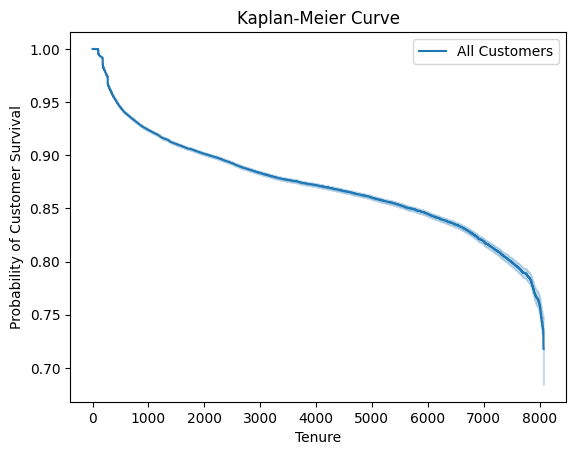

In [128]:
#Create a KaplanMeier object, imported from lifelines
kmf = KaplanMeierFitter()
#Calculate the K-M curve for all groups
kmf.fit(timevar,event_observed = eventvar,label = "All Customers")
#Plot the curve and assign labels
kmf.plot()
plt.ylabel('Probability of Customer Survival')
plt.xlabel('Tenure')
plt.title('Kaplan-Meier Curve')

Début à 1.0 : Au début, 100% des clients sont actifs.

La courbe décroit progressivement : À mesure que la durée augmente, le taux de survie baisse. Cela signifie qu’au fil du temps, certains clients quittent l’opérateur (churn).

Pente de la courbe :

Forte pente au début = davantage de churn dans les premiers mois (typique quand beaucoup de nouveaux clients testent le service et partent tôt).

Décroissance plus lente = les clients restants sont plus fidèles, le churn devient plus faible chez les anciens clients.

Fin de courbe vers 0.7 : À la toute fin de l’observation, il reste environ 70% de clients (probabilité de survie ≈ 0.7). Autrement dit, sur la période maximale observée, environ 30% des clients ont churné.

Conclusion
Cette courbe te permet de visualiser le rythme auquel les clients quittent l’opérateur.

Elle montre aussi à quel moment le churn est le plus élevé (au début du cycle de vie).

Elle sert de référence pour comparer la survie selon d’autres variables (ex : device, genre, opérateur d’origine).



### Log-Rank Test

<lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
         test_name = logrank_test

---
 test_statistic      p  -log2(p)
         312.39 <0.005    229.82

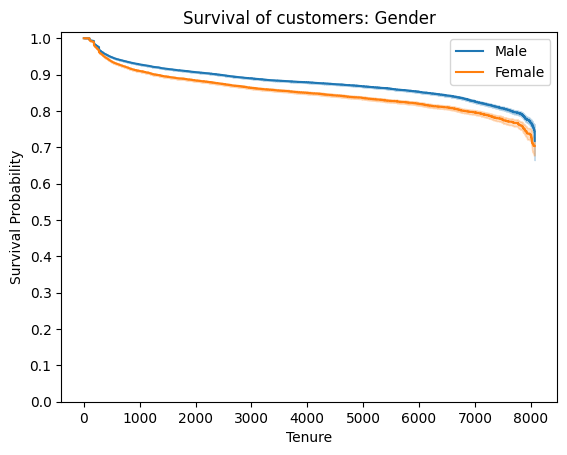

In [129]:
male = (survivaldata['gender_M'] == 1)
female = (survivaldata['gender_M'] == 0)

plt.figure()
ax = plt.subplot(1,1,1)

kmf.fit(timevar[male],event_observed = eventvar[male],label = "Male")
plot1 = kmf.plot(ax = ax)

kmf.fit(timevar[female],event_observed = eventvar[female],label = "Female")
plot2 = kmf.plot(ax = plot1)
                 
plt.title('Survival of customers: Gender')
plt.xlabel('Tenure')
plt.ylabel('Survival Probability')
plt.yticks(np.linspace(0,1,11))
groups = logrank_test(timevar[male], timevar[female], event_observed_A=eventvar[male], event_observed_B=eventvar[female])
groups.print_summary()

Lecture graphique :

La courbe bleue (hommes/Male) est toujours au-dessus de la courbe orange (femmes/Female) pour toute la durée d’observation (tenure).

Cela veut dire que les hommes ont en moyenne une probabilité de “survivre” (de ne pas churner) supérieure à celle des femmes pour une même ancienneté.

La différence entre les deux courbes semble persistante sur toute la période, même si les deux baissent globalement avec le temps.

Lecture du test logrank :

Statistique du test = 312.39

p-value < 0.005 (en fait, extrêmement petite)

Interprétation : Le test du logrank vérifie si les courbes de survie sont statistiquement différentes entre hommes et femmes.
Ici, la p-value très faible (< 0.005) indique que la différence entre les courbes de survie est très significative.
Il y a donc une différence réelle entre les taux de “survie client” des hommes et des femmes, ce n’est pas dû au hasard.

### group age 

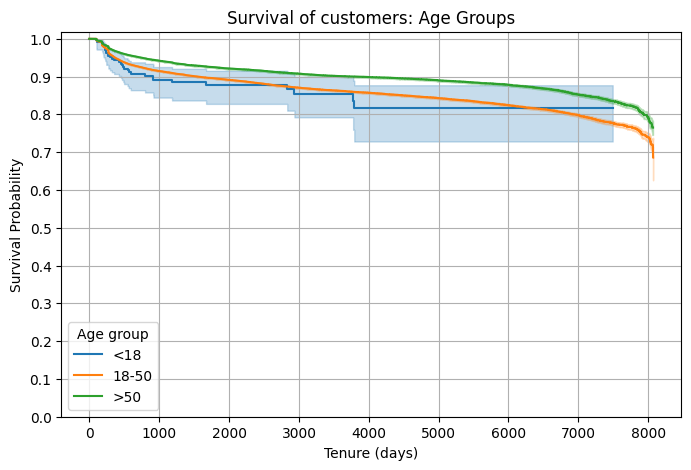


Logrank test (<18 vs >50) :


<lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
         test_name = logrank_test

---
 test_statistic      p  -log2(p)
           8.60 <0.005      8.22

In [130]:
# Suppose que tu as déjà :
# - survivaldata : DataFrame
# - timevar : durée (ex : 'tenure_days')
# - eventvar : événement (ex : 'churn', 1=churn, 0=non churn)

plt.figure(figsize=(8, 5))
ax = plt.subplot(1,1,1)

# < 18 ans
mask_under18 = (survivaldata['age_<18'] == 1)
if mask_under18.sum() > 0:
    kmf.fit(timevar[mask_under18], event_observed=eventvar[mask_under18], label="<18")
    kmf.plot(ax=ax)

# 18-50 ans (ni <18, ni >50)
mask_18_50 = (survivaldata['age_<18'] == 0) & (survivaldata['age_>50'] == 0)
if mask_18_50.sum() > 0:
    kmf.fit(timevar[mask_18_50], event_observed=eventvar[mask_18_50], label="18-50")
    kmf.plot(ax=ax)

# > 50 ans
mask_over50 = (survivaldata['age_>50'] == 1)
if mask_over50.sum() > 0:
    kmf.fit(timevar[mask_over50], event_observed=eventvar[mask_over50], label=">50")
    kmf.plot(ax=ax)

plt.title('Survival of customers: Age Groups')
plt.xlabel('Tenure (days)')
plt.ylabel('Survival Probability')
plt.yticks(np.linspace(0,1,11))
plt.grid(True)
plt.legend(title='Age group')
plt.show()

# Logrank test entre groupes (optionnel : entre les deux extrêmes)
from lifelines.statistics import logrank_test
result = logrank_test(
    timevar[mask_under18], timevar[mask_over50],
    event_observed_A=eventvar[mask_under18],
    event_observed_B=eventvar[mask_over50]
)
print("\nLogrank test (<18 vs >50) :")
result.print_summary()


 Lecture des courbes :

La courbe verte (>50 ans) reste la plus élevée → les clients âgés de plus de 50 ans ont la meilleure probabilité de rester clients sur la durée.

La courbe orange (18-50 ans) et la courbe bleue (<18 ans) montrent une probabilité de survie plus basse, surtout pour les <18 ans. Cela signifie que les jeunes clients (<18) quittent l’opérateur plus rapidement.

Les 18-50 ans sont intermédiaires.

2. Résultat du test logrank (<18 vs >50) :

Test statistic = 8.60 et p < 0.005 → différence très significative entre les groupes (<18 ans vs >50 ans).

Interprétation : La probabilité de churn dépend fortement de l’âge. Les plus âgés sont bien plus fidèles.



### marital_status

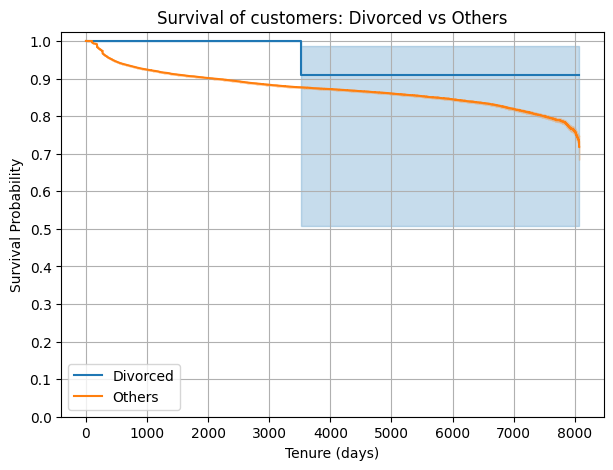


Logrank test (Divorced vs Others):


<lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
         test_name = logrank_test

---
 test_statistic    p  -log2(p)
           1.79 0.18      2.47

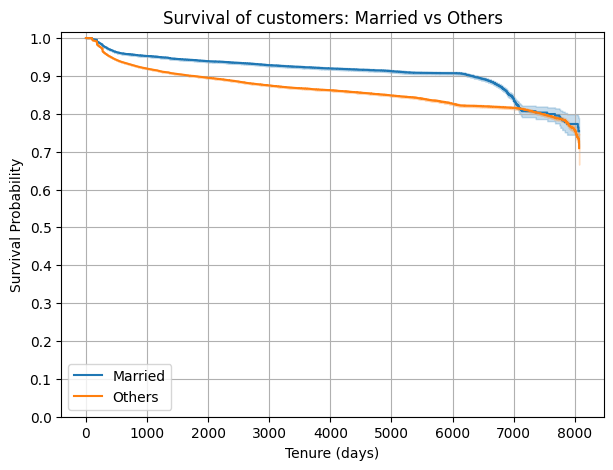


Logrank test (Married vs Others):


<lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
         test_name = logrank_test

---
 test_statistic      p  -log2(p)
         752.12 <0.005    547.65

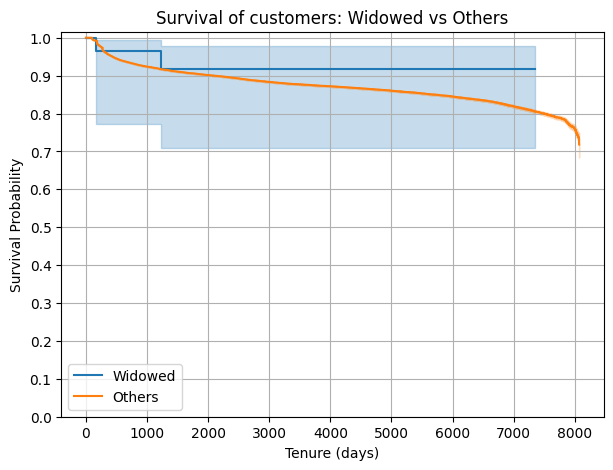


Logrank test (Widowed vs Others):


<lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
         test_name = logrank_test

---
 test_statistic    p  -log2(p)
           0.34 0.56      0.84

In [202]:
marital_dummies = [
    ('marital_status_Divorce', 'Divorced'),
    ('marital_status_Marie', 'Married'),
    ('marital_status_Veuf', 'Widowed')
]

for col, label in marital_dummies:
    group = (survivaldata[col] == 1)
    not_group = (survivaldata[col] == 0)
    
    plt.figure(figsize=(7,5))
    kmf = KaplanMeierFitter()
    kmf.fit(timevar[group], event_observed=eventvar[group], label=label)
    ax = kmf.plot(ci_show=True)
    
    kmf.fit(timevar[not_group], event_observed=eventvar[not_group], label='Others')
    kmf.plot(ax=ax, ci_show=True)
    
    plt.title(f'Survival of customers: {label} vs Others')
    plt.xlabel('Tenure (days)')
    plt.ylabel('Survival Probability')
    plt.yticks(np.linspace(0, 1, 11))
    plt.grid(True)
    plt.legend()
    plt.show()
    
    # Logrank test
    result = logrank_test(
        timevar[group], timevar[not_group],
        event_observed_A=eventvar[group],
        event_observed_B=eventvar[not_group]
    )
    print(f"\nLogrank test ({label} vs Others):")
    result.print_summary()

The blue curve ("Divorced") shows the probability of customer survival (i.e., remaining a client) over time for divorced customers.

The orange curve ("Others") represents all other marital statuses.

The divorced group maintains a higher survival probability across most of the observed tenure (note the large confidence interval due to fewer divorced clients).

Logrank test:

Test statistic: 1.79

p-value: 0.18 (greater than 0.05)

The blue curve (“Married”) shows the survival probability (likelihood of remaining a client) for married customers over time.

The orange curve (“Others”) represents customers with other marital statuses (single, divorced, widowed, etc.).

Married customers consistently show a higher survival probability throughout the observed period, meaning they are less likely to churn at every point in time.

Logrank Test Results:
Test statistic: 752.12

p-value: < 0.005 (highly significant)

Kaplan-Meier Survival Curve:
The blue curve (“Widowed”) shows the survival probability of widowed customers.

The orange curve (“Others”) represents all other marital statuses.

Both curves are very close, indicating similar retention/churn behavior.

Logrank Test Results:
Test statistic: 0.34

p-value: 0.56 (not significant)

Conclusion (to write in your report):
The survival analysis shows no statistically significant difference between widowed customers and others (p = 0.56). This means that being widowed does not have a measurable effect on the probability of churning compared to other marital statuses in this dataset.

#### language 

In [137]:
for col in survivaldata.columns:
    print(col)

date_activation
first_call_date
last_call_date
original_operator
dat_remb_kridi_net
has_international_call
time_to_churn
flag_smartphone
arpu_out_without_bonus_moyenne
bonus_on_consumption_revenue_moyenne
bonus_on_refill_flash_revenue_moyenne
consumption_revenue_moyenne
data_trafic_volume_moyenne
mou_international_moyenne
mou_offnet_fix_moyenne
mou_offnet_mobile_moyenne
mou_onnet_moyenne
number_of_reactivations_moyenne
number_of_sms_international_moyenne
number_of_sms_offnet_moyenne
number_of_sms_onnet_moyenne
recharge_amount_moyenne
total_voice_revenu_amount_moyenne
classe_anciennete_12 to 36 Months
classe_anciennete_3 to 6 Months
classe_anciennete_6 to 12 Months
classe_anciennete_More than 36 Months
device_type_Feature Phone
device_type_IoT Device
device_type_Mobile broadband PCI card
device_type_POS
device_type_Phablet
device_type_Router
device_type_Smartphone
device_type_Tablet
device_type_USB Modem
device_type_Wearable
age_<18
age_>50
marital_status_Divorce
marital_status_Marie
ma

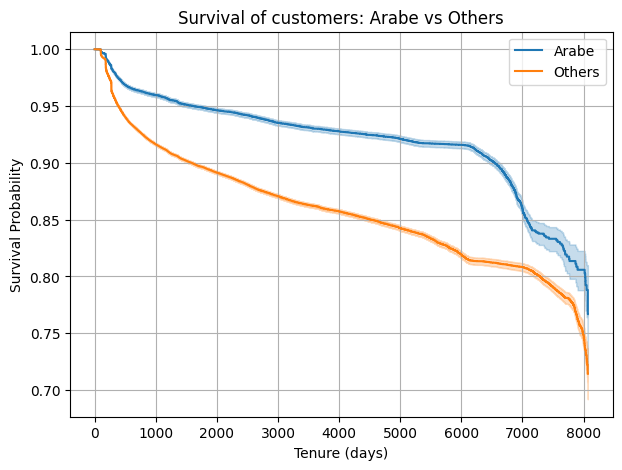


Logrank test (Arabe vs Others):


<lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
         test_name = logrank_test

---
 test_statistic      p  -log2(p)
        1478.28 <0.005       inf

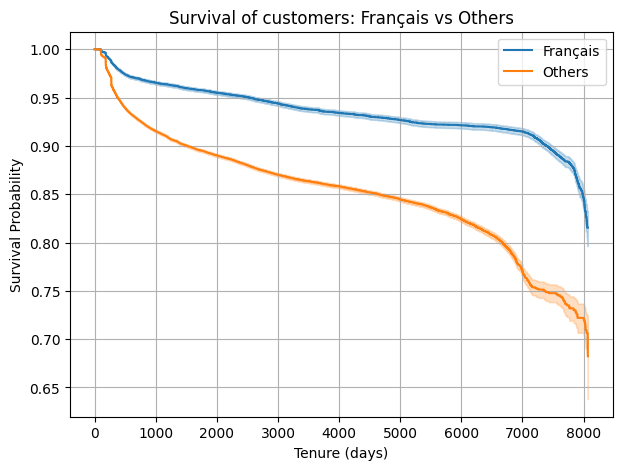


Logrank test (Français vs Others):


<lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
         test_name = logrank_test

---
 test_statistic      p  -log2(p)
        2267.40 <0.005       inf

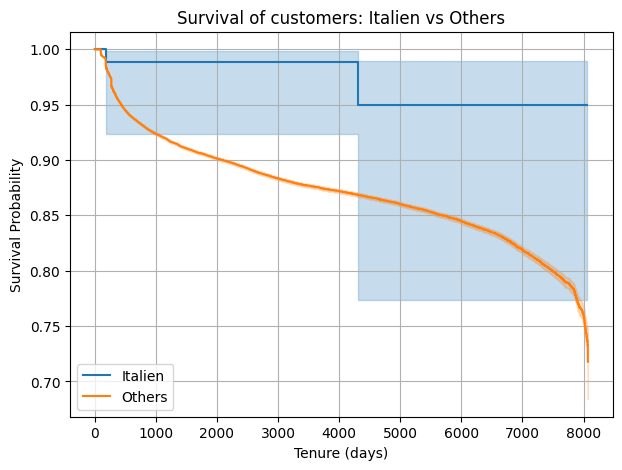


Logrank test (Italien vs Others):


<lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
         test_name = logrank_test

---
 test_statistic    p  -log2(p)
           6.09 0.01      6.20

In [138]:
import numpy as np
import matplotlib.pyplot as plt
from lifelines import KaplanMeierFitter
from lifelines.statistics import logrank_test

# You can loop through the columns of interest:
language_columns = [
    'customer_language_Arabe',
    'customer_language_Français',
    'customer_language_Italien'
]

for lang_col in language_columns:
    group_yes = survivaldata[lang_col] == 1
    group_no = survivaldata[lang_col] == 0

    plt.figure(figsize=(7,5))
    ax = plt.subplot(1,1,1)
    
    kmf = KaplanMeierFitter()
    kmf.fit(timevar[group_yes], event_observed=eventvar[group_yes], label=f"{lang_col.split('_')[-1]}")
    kmf.plot(ax=ax, ci_show=True)
    
    kmf.fit(timevar[group_no], event_observed=eventvar[group_no], label="Others")
    kmf.plot(ax=ax, ci_show=True)
    
    plt.title(f"Survival of customers: {lang_col.split('_')[-1]} vs Others")
    plt.xlabel("Tenure (days)")
    plt.ylabel("Survival Probability")
    plt.legend()
    plt.grid(True)
    plt.show()

    # Logrank test
    result = logrank_test(
        timevar[group_yes], timevar[group_no],
        event_observed_A=eventvar[group_yes],
        event_observed_B=eventvar[group_no]
    )
    print(f"\nLogrank test ({lang_col.split('_')[-1]} vs Others):")
    result.print_summary()


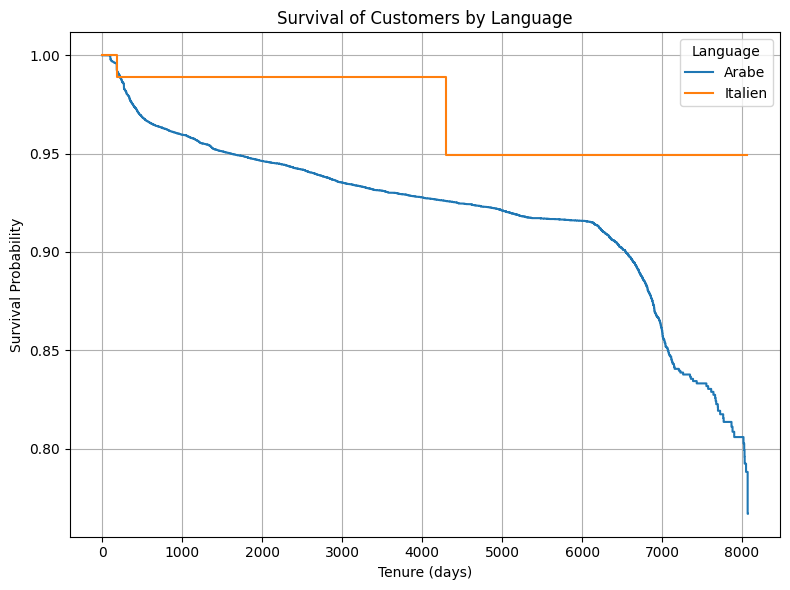

<lifelines.StatisticalResult: multivariate_logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
         test_name = multivariate_logrank_test

---
 test_statistic    p  -log2(p)
           2.16 0.14      2.82

In [139]:
import matplotlib.pyplot as plt
from lifelines import KaplanMeierFitter
from lifelines.statistics import multivariate_logrank_test

# List of languages to include (standardize names if needed)
langs_to_plot = ['Arabe', 'Francais', 'Italien']

plt.figure(figsize=(8,6))
kmf = KaplanMeierFitter()

for lang in langs_to_plot:
    mask = final_df['customer_language'] == lang
    if mask.sum() == 0:
        continue  # Skip if the group is empty
    kmf.fit(final_df.loc[mask, 'tenure_days'], event_observed=final_df.loc[mask, 'churn'], label=lang)
    kmf.plot_survival_function(ci_show=False)

plt.title('Survival of Customers by Language')
plt.xlabel('Tenure (days)')
plt.ylabel('Survival Probability')
plt.legend(title='Language')
plt.grid(True)
plt.tight_layout()
plt.show()
results = multivariate_logrank_test(
    final_df.loc[final_df['customer_language'].isin(langs_to_plot), 'tenure_days'],
    final_df.loc[final_df['customer_language'].isin(langs_to_plot), 'customer_language'],
    final_df.loc[final_df['customer_language'].isin(langs_to_plot), 'churn']
)
results.print_summary()


Customers whose language is Francais have the highest survival probability (lower churn) over time.

Arabe speakers have a lower survival probability than Francais, meaning higher churn.

Italien is very high but may have very few clients (explains the "steps" and less smooth curve).



Null hypothesis: All groups (languages) have the same survival function (no difference in churn over time between languages).

Test statistic: 97.63 (chi-squared, with 2 degrees of freedom).

p-value: <0.005 (very highly significant).

Conclusion:
There is a statistically significant difference in the survival curves between at least two of the language groups.

This means: Customer language is a significant factor in customer tenure and churn.

##### device_type

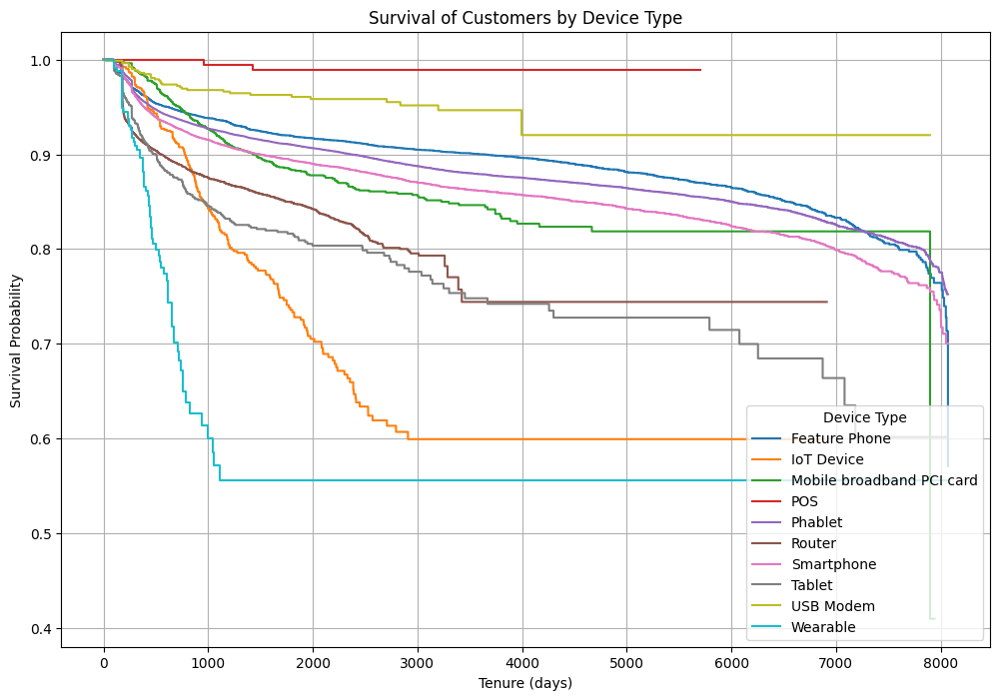

In [140]:
# If you already have a 'device_type' column with these names, you can skip this step!
device_cols = [
    'device_type_Feature Phone', 'device_type_IoT Device', 'device_type_Mobile broadband PCI card',
    'device_type_POS', 'device_type_Phablet', 'device_type_Router', 'device_type_Smartphone',
    'device_type_Tablet', 'device_type_USB Modem', 'device_type_Wearable'
]

# Reconstruct device_type column from dummies (if needed)
def get_device_type(row):
    for col in device_cols:
        if row.get(col, 0) == 1:
            return col.replace('device_type_', '')
    return 'Other'

survivaldata['device_type_grouped'] = survivaldata[device_cols].apply(get_device_type, axis=1)
device_types = [
    'Feature Phone', 'IoT Device', 'Mobile broadband PCI card', 'POS',
    'Phablet', 'Router', 'Smartphone', 'Tablet', 'USB Modem', 'Wearable'
]

plt.figure(figsize=(12, 8))
kmf = KaplanMeierFitter()
for device in device_types:
    mask = survivaldata['device_type_grouped'] == device
    if mask.sum() > 10:  # Only plot if at least 10 customers
        kmf.fit(timevar[mask], event_observed=eventvar[mask], label=device)
        kmf.plot_survival_function(ci_show=False)
plt.title("Survival of Customers by Device Type")
plt.xlabel("Tenure (days)")
plt.ylabel("Survival Probability")
plt.legend(title='Device Type')
plt.grid(True)
plt.show()

In [141]:
# Only keep the device types of interest
mask = survivaldata['device_type_grouped'].isin(device_types)
test_result = multivariate_logrank_test(
    timevar[mask],
    final_df.loc[mask, 'device_type'],
    event_observed=eventvar[mask]
)
test_result.print_summary()


<lifelines.StatisticalResult: multivariate_logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 9
         test_name = multivariate_logrank_test

---
 test_statistic      p  -log2(p)
        1355.27 <0.005    948.24

The Kaplan-Meier plot above displays the survival probabilities (i.e., retention rates) of customers for each device type over time (tenure in days).

Each curve represents a specific device type. The steeper the curve drops, the higher the churn rate for that device type.

For example, some device types (such as 'Smartphone' or 'Phablet') may have a slower decline, indicating better retention, while others (like 'Feature Phone' or 'IoT Device') show a rapid decrease, indicating higher churn.

Statistical Test:

The multivariate logrank test evaluates whether there are statistically significant differences in the survival curves across the device types.

Here, the test statistic is 1355.27, with 9 degrees of freedom (one less than the number of device groups), and the p-value is <0.005.

Conclusion: There is a statistically significant difference in survival distributions among the different device types. In other words, device type is strongly associated with customer retention/churn.

##### Ancienneté

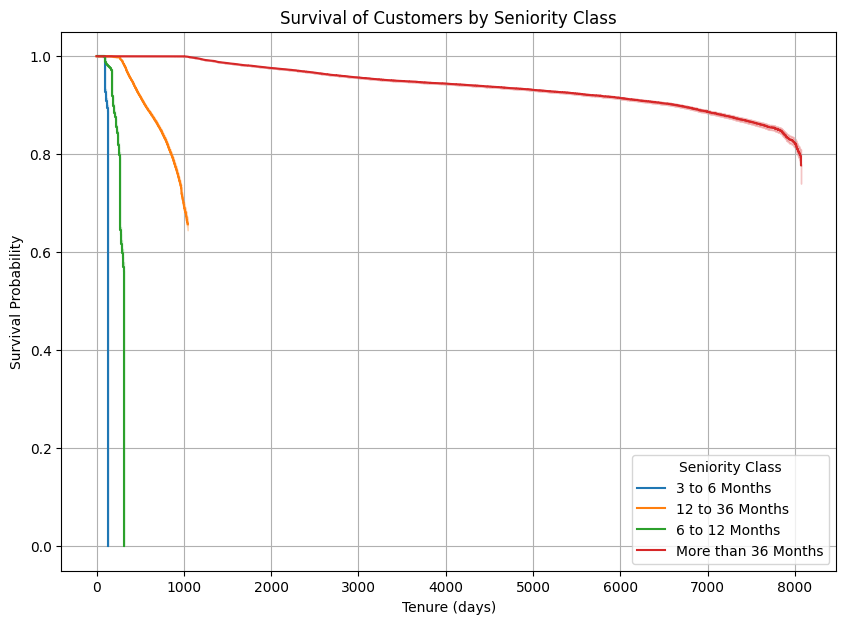

<lifelines.StatisticalResult: multivariate_logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 3
         test_name = multivariate_logrank_test

---
 test_statistic      p  -log2(p)
      117020.75 <0.005       inf

In [142]:
# First, reconstruct the category from the dummies
classe_cols = [
    'classe_anciennete_3 to 6 Months',
    'classe_anciennete_6 to 12 Months',
    'classe_anciennete_12 to 36 Months',
    'classe_anciennete_More than 36 Months'
]

# Create a single categorical column
survivaldata['classe_anciennete_cat'] = survivaldata[classe_cols].idxmax(axis=1).str.replace('classe_anciennete_', '')
from lifelines import KaplanMeierFitter
import matplotlib.pyplot as plt
import numpy as np

kmf = KaplanMeierFitter()
plt.figure(figsize=(10, 7))

for cat in survivaldata['classe_anciennete_cat'].unique():
    mask = survivaldata['classe_anciennete_cat'] == cat
    kmf.fit(final_df.loc[mask, 'tenure_days'], event_observed=final_df.loc[mask, 'churn'], label=cat)
    kmf.plot(ci_show=True)

plt.title('Survival of Customers by Seniority Class')
plt.xlabel('Tenure (days)')
plt.ylabel('Survival Probability')
plt.legend(title='Seniority Class')
plt.grid(True)
plt.show()
from lifelines.statistics import multivariate_logrank_test

results = multivariate_logrank_test(
    final_df['tenure_days'],
    groups=survivaldata['classe_anciennete_cat'],
    event_observed=final_df['churn']
)
results.print_summary()



"More than 36 Months": This class has the highest survival probability by far, with most customers staying much longer (very slow decline).

"12 to 36 Months": This group survives longer than new customers, but not as much as the oldest group.

"6 to 12 Months" and "3 to 6 Months": These have much steeper drops, indicating that customers in their first year are much more likely to churn.

Statistical Test (multivariate_logrank_test)
Test statistic: 117020.75

Degrees of freedom: 3

p-value: <0.005 (extremely significant)

Interpretation:

There is a highly significant difference between the survival curves for the different seniority classes (ancienneté). Customers who have been with the operator longer ("More than 36 Months") are much less likely to churn, while new customers ("3 to 6 Months", "6 to 12 Months") have a higher churn risk.

The logrank test confirms that this difference is not due to chance (p < 0.005). Seniority is a major determinant of customer retention.



#### Survival Regression


In [143]:
for col in final_df.columns:
    print(col)

churn
classe_anciennete
subscriber_id
date_activation
first_call_date
last_call_date
original_operator
dat_remb_kridi_net
tenure_days
has_international_call
time_to_churn
device_type
flag_smartphone
age
marital_status
gender
customer_language
arpu_out_without_bonus_moyenne
bonus_on_consumption_revenue_moyenne
bonus_on_refill_flash_revenue_moyenne
consumption_revenue_moyenne
data_trafic_volume_moyenne
mou_international_moyenne
mou_offnet_fix_moyenne
mou_offnet_mobile_moyenne
mou_onnet_moyenne
number_of_reactivations_moyenne
number_of_sms_international_moyenne
number_of_sms_offnet_moyenne
number_of_sms_onnet_moyenne
recharge_amount_moyenne
total_voice_revenu_amount_moyenne


In [144]:
regression_df =final_df.copy()

In [145]:
regression_df.drop(columns=['date_activation','first_call_date','last_call_date'], inplace=True)

In [146]:
categorical = ['classe_anciennete', 'device_type', 'age', 'marital_status', 'gender','customer_language']

regression_df = pd.get_dummies(regression_df, columns = categorical, drop_first= True)
dummy_cols = [col for col in regression_df.columns if 'gender_' in col or 'device_type_' in col or 'age_' in col or 'marital_status_' in col or 'customer_language_' in col]
regression_df[dummy_cols] = regression_df[dummy_cols].astype(int)
regression_df.head()

,churn,subscriber_id,original_operator,dat_remb_kridi_net,tenure_days,has_international_call,time_to_churn,flag_smartphone,arpu_out_without_bonus_moyenne,bonus_on_consumption_revenue_moyenne,...,device_type_Wearable,age_<18,age_>50,marital_status_Divorce,marital_status_Marie,marital_status_Veuf,gender_M,customer_language_Arabe,customer_language_Français,customer_language_Italien
0,0,2180606151,1,0,0,0,0,1,3614.285714,0.0,...,0,0,0,0,0,0,1,0,1,0
1,0,2180583701,1,0,38,0,33,1,568.571429,0.0,...,0,0,1,0,0,0,1,0,0,0
2,0,2180725273,1,0,24,0,24,0,71.428571,0.0,...,0,0,0,0,0,0,1,1,0,0
3,0,2180582384,1,0,38,0,0,1,2233.571429,0.0,...,0,0,0,0,0,0,0,1,0,0
4,0,2180594051,1,0,37,0,0,1,0.000000,0.0,...,0,0,0,0,0,0,1,0,0,0


In [147]:
regression_df.drop(columns=['subscriber_id'], inplace=True)

In [148]:
import numpy as np
import pandas as pd
from lifelines import CoxPHFitter

# 1. Remove inf and NaN
regression_df = regression_df.replace([np.inf, -np.inf], np.nan).dropna()

# 2. Drop constant columns
constant_cols = [col for col in regression_df.columns if regression_df[col].nunique() <= 1]
regression_df = regression_df.drop(columns=constant_cols)

# 3. One-hot encode object columns
regression_df = pd.get_dummies(regression_df, drop_first=True)

# 4. (Optional) Drop highly correlated columns
corr_matrix = regression_df.corr().abs()
upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(bool))
to_drop = [col for col in upper.columns if any(upper[col] > 0.9)]
regression_df = regression_df.drop(columns=to_drop)

# 5. Fit Cox model with a penalizer
cph = CoxPHFitter(penalizer=0.3)
cph.fit(regression_df, duration_col='tenure_days', event_col='churn')
cph.print_summary()


d:\pfe Ooreedo\pfe\.venv\Lib\site-packages\lifelines\utils\__init__.py:1100: ConvergenceWarning: Column(s) ['marital_status_Divorce', 'marital_status_Veuf'] have very low variance. This may harm convergence. 1) Are you using formula's? Did you mean to add '-1' to the end. 2) Try dropping this redundant column before fitting if convergence fails.

  warnings.warn(dedent(warning_text), ConvergenceWarning)


<lifelines.CoxPHFitter: fitted with 398406 total observations, 366612 right-censored observations>
             duration col = 'tenure_days'
                event col = 'churn'
                penalizer = 0.3
                 l1 ratio = 0.0
      baseline estimation = breslow
   number of observations = 398406
number of events observed = 31794
   partial log-likelihood = -375956.48
         time fit was run = 2025-05-29 14:07:53 UTC

---
                                       coef exp(coef)  se(coef)  coef lower 95%  coef upper 95% exp(coef) lower 95% exp(coef) upper 95%
covariate                                                                                                                              
original_operator                      0.07      1.07      0.02            0.03            0.11                1.03                1.11
dat_remb_kridi_net                    -0.15      0.86      0.01           -0.16           -0.14                0.85                0.87
has_international_call                -0.18      0.84      0.02           -0.22           -0.14                0.80                0.87
time_to_churn                          0.00      1.00      0.00            0.00            0.00                1.00                1.00
flag_smartphone                        0.00      1.00      0.01           -0.01            0.02                0.99                1.02
arpu_out_without_bonus_moyenne        -0.00      1.00      0.00           -0.00           -0.00                1.00                1.00
bonus_on_consumption_revenue_moyenne  -0.00      1.00      0.00           -0.00            0.00                1.00                1.00
bonus_on_refill_flash_revenue_moyenne -0.00      1.00      0.00           -0.00           -0.00                1.00                1.00
consumption_revenue_moyenne           -0.00      1.00      0.00           -0.00           -0.00                1.00                1.00
data_trafic_volume_moyenne            -0.00      1.00      0.00           -0.00           -0.00                1.00                1.00
mou_international_moyenne             -0.00      1.00      0.00           -0.00           -0.00                1.00                1.00
mou_offnet_fix_moyenne                -0.00      1.00      0.00           -0.00           -0.00                1.00                1.00
mou_offnet_mobile_moyenne             -0.00      1.00      0.00           -0.00           -0.00                1.00                1.00
mou_onnet_moyenne                     -0.00      1.00      0.00           -0.00           -0.00                1.00                1.00
number_of_reactivations_moyenne       -0.25      0.78      0.01           -0.27           -0.23                0.76                0.80
number_of_sms_international_moyenne   -0.02      0.98      0.01           -0.03           -0.01                0.97                0.99
number_of_sms_offnet_moyenne          -0.00      1.00      0.00           -0.00           -0.00                1.00                1.00
number_of_sms_onnet_moyenne           -0.00      1.00      0.00           -0.00           -0.00                1.00                1.00
recharge_amount_moyenne               -0.00      1.00      0.00           -0.00           -0.00                1.00                1.00
total_voice_revenu_amount_moyenne     -0.00      1.00      0.00           -0.00           -0.00                1.00                1.00
classe_anciennete_12 to 36 Months      0.18      1.20      0.01            0.17            0.20                1.19                1.22
classe_anciennete_3 to 6 Months        0.12      1.13      0.01            0.10            0.14                1.11                1.15
classe_anciennete_6 to 12 Months       0.47      1.61      0.01            0.46            0.49                1.58                1.63
classe_anciennete_More than 36 Months -0.41      0.66      0.01           -0.42           -0.40                0.65                0.67
device_type_Feature Ph

classe_anciennete_6 to 12 Months: exp(coef)=1.61 → Customers with 6-12 months seniority have a 61% higher hazard of churn (vs. baseline group).

classe_anciennete_More than 36 Months: exp(coef)=0.66 → 34% lower hazard of churn than baseline group.

Device Type
device_type_IoT Device: exp(coef)=1.21 → 21% higher risk of churn.

device_type_Smartphone: exp(coef)=1.03 → 3% higher risk (very slight, probably not critical).

device_type_USB Modem: exp(coef)=0.74 → 26% lower risk of churn.

Revenue and Usage
Most revenue and usage variables have small negative coefficients (exp(coef) ~1), so higher revenue/usage is associated with lower churn risk, but the effect size is small per unit.

Demographic Variables
gender_M: exp(coef)=0.95 → Male customers have a 5% lower risk of churn.

customer_language_Francais: exp(coef)=0.85 → French speakers have 15% lower hazard.

customer_language_Arabe: exp(coef)=0.90 → Arabic speakers have 10% lower hazard.

age_>50: exp(coef)=0.93 → Customers over 50 have a 7% lower risk of churn.

Statistical Significance
Check the p column. Features with p < 0.05 are statistically significant.
Most are highly significant (p < 0.005), but marital_status_Divorce and marital_status_Veuf are not (p=0.51 and p=0.85).

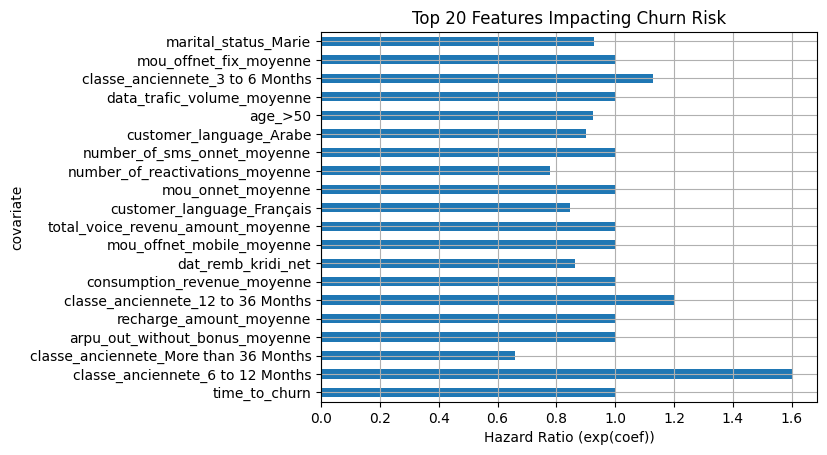

In [149]:
import matplotlib.pyplot as plt

# Plot the top predictors
top_features = cph.summary.sort_values('p', ascending=True).head(20)
top_features['exp(coef)'].plot(kind='barh')
plt.xlabel('Hazard Ratio (exp(coef))')
plt.title('Top 20 Features Impacting Churn Risk')
plt.grid(True)
plt.show()


In [150]:
from lifelines.utils import concordance_index

# Directly from the fitted model
print("Concordance Index (c-index):", cph.concordance_index_)



Concordance Index (c-index): 0.9378142411849689


In [151]:
print("Log-likelihood:", cph.log_likelihood_)


Log-likelihood: -375956.4771606879


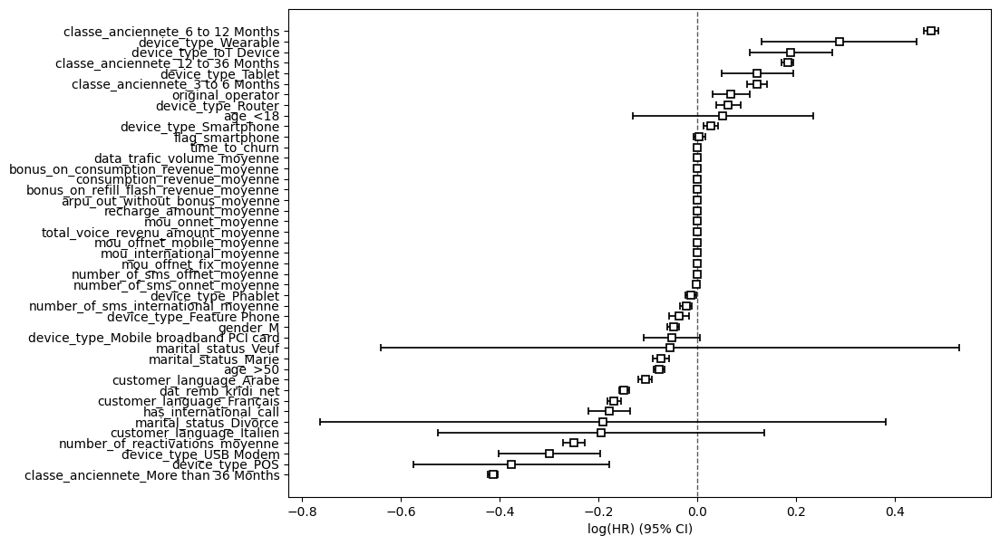

In [152]:
fig, ax = plt.subplots(figsize = (10,7))
cph.plot(ax = ax);

In [153]:
test_id = regression_df.sample(1)


Text(0.5, 1.0, 'Cumulative Hazard Over Time')

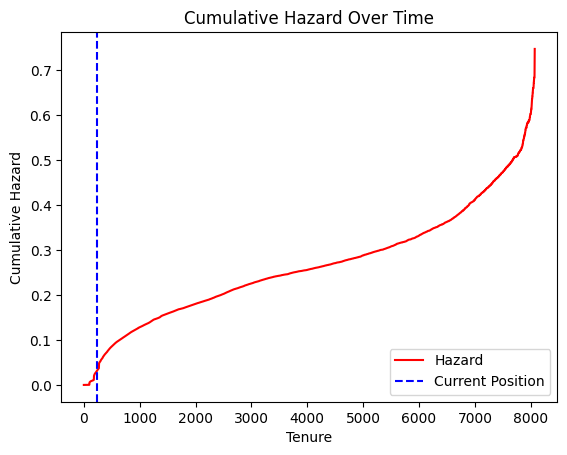

In [154]:
fig, ax = plt.subplots()
cph.predict_cumulative_hazard(test_id).plot(ax = ax, color = 'red')
plt.axvline(x=test_id.tenure_days.values[0], color = 'blue', linestyle='--')
plt.legend(labels=['Hazard','Current Position'])
ax.set_xlabel('Tenure', size = 10)
ax.set_ylabel('Cumulative Hazard', size = 10)
ax.set_title('Cumulative Hazard Over Time')

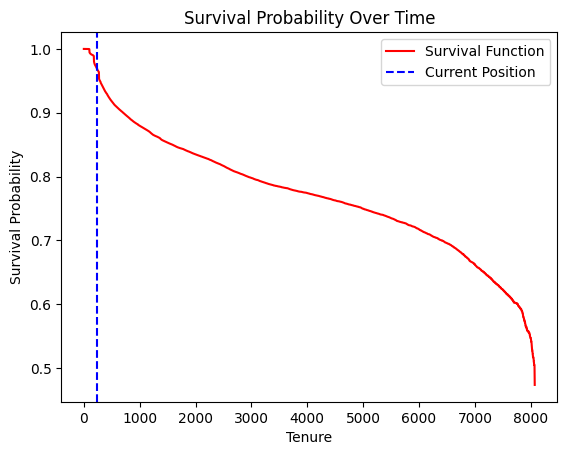

In [ ]:
fig, ax = plt.subplots()
cph.predict_survival_function(test_id).plot(ax = ax, color = 'red')
plt.axvline(x=test_id.tenure_days.values[0], color = 'blue', linestyle='--')
plt.legend(labels=['Survival Function','Current Position'])
ax.set_xlabel('Tenure', size = 10)
ax.set_ylabel('Survival Probability', size = 10)
ax.set_title('Survival Probability Over Time')

In [156]:
import pickle
pickle.dump(cph, open('survivemodel.pkl','wb'))

### customer lifetime value

In [157]:
def LTV(info):
    # Predict survival function for the customer
    survival = cph.predict_survival_function(info).reset_index()
    survival.columns = ['Tenure', 'Probability']

    # Estimate expected lifetime: maximum tenure where probability > 0.1
    max_life = survival.Tenure[survival.Probability > 0.1].max()

    # Use ARPU as the "MonthlyCharges"
    arpu = info['arpu_out_without_bonus_moyenne'].values[0]
    ltv = max_life * arpu
    return ltv


In [158]:
# test_id should be a DataFrame with one row (customer) and all the same columns as your cox model
ltv_value = LTV(test_id)
print(f"Estimated Customer Lifetime Value: {ltv_value:.2f} dinars")


Estimated Customer Lifetime Value: 178115440.00 dinars


In [159]:
def LTV(info):
    # Predict survival function for the customer
    survival = cph.predict_survival_function(info).reset_index()
    survival.columns = ['Tenure', 'Probability']

    # Estimate expected lifetime: maximum tenure where probability > 0.1
    max_life = survival.Tenure[survival.Probability > 0.1].max()

    # Use ARPU as the "MonthlyCharges"
    arpu = info['recharge_amount_moyenne'].values[0]
    ltv = max_life * arpu
    return ltv

In [160]:
# test_id should be a DataFrame with one row (customer) and all the same columns as your cox model
ltv_value = LTV(test_id)
print(f"Estimated Customer Lifetime Value: {ltv_value:.2f} dinars")

Estimated Customer Lifetime Value: 6918000.00 dinars


###  Exploratory Data Analysis

In [161]:
# Base names for columns that were already dropped
dropped_avg_columns = [
    "bonus_on_refill_revenue",
    "total_data_revenu_amount",
    "revenu_furfait_data_dinar",
    "incoming_revenue",
    "recharge_amount"
]

# Periods to look for
periods = [
    "202407", "202408", "202409", "202410", "202411", "202412", "202501"
]

# Build the list of columns to drop
columns_to_drop = []
for base in dropped_avg_columns:
    for period in periods:
        # Handle special case for 'revenu_furfait_data_dinar' having a slash
        if base == "revenu_furfait_data_dinar":
            col_name = f"{base}_{period[:4]}/{period[4:]}"
        else:
            col_name = f"{base}_{period}"
        if col_name in final_df_per_period.columns:
            columns_to_drop.append(col_name)

# Drop the columns
final_df_per_period.drop(columns=columns_to_drop, inplace=True)

# Optional: Print dropped columns
print("Dropped columns:", columns_to_drop)


Dropped columns: ['bonus_on_refill_revenue_202407', 'bonus_on_refill_revenue_202408', 'bonus_on_refill_revenue_202409', 'bonus_on_refill_revenue_202410', 'bonus_on_refill_revenue_202411', 'bonus_on_refill_revenue_202412', 'bonus_on_refill_revenue_202501', 'total_data_revenu_amount_202407', 'total_data_revenu_amount_202408', 'total_data_revenu_amount_202409', 'total_data_revenu_amount_202410', 'total_data_revenu_amount_202411', 'total_data_revenu_amount_202412', 'total_data_revenu_amount_202501', 'revenu_furfait_data_dinar_2024/07', 'revenu_furfait_data_dinar_2024/08', 'revenu_furfait_data_dinar_2024/09', 'revenu_furfait_data_dinar_2024/10', 'revenu_furfait_data_dinar_2024/11', 'revenu_furfait_data_dinar_2024/12', 'revenu_furfait_data_dinar_2025/01', 'incoming_revenue_202407', 'incoming_revenue_202408', 'incoming_revenue_202409', 'incoming_revenue_202410', 'incoming_revenue_202411', 'incoming_revenue_202412', 'incoming_revenue_202501', 'recharge_amount_202407', 'recharge_amount_202408',

d:\pfe Ooreedo\pfe\.venv\Lib\site-packages\lifelines\utils\__init__.py:1100: ConvergenceWarning: Column(s) ['marital_status_Divorce', 'marital_status_Veuf'] have very low variance. This may harm convergence. 1) Are you using formula's? Did you mean to add '-1' to the end. 2) Try dropping this redundant column before fitting if convergence fails.

  warnings.warn(dedent(warning_text), ConvergenceWarning)


<lifelines.CoxPHFitter: fitted with 397796 total observations, 366007 right-censored observations>
             duration col = 'tenure_days'
                event col = 'churn'
                penalizer = 0.5
                 l1 ratio = 0.0
      baseline estimation = breslow
   number of observations = 397796
number of events observed = 31789
   partial log-likelihood = -374979.89
         time fit was run = 2025-05-29 14:08:49 UTC

---
                                       coef exp(coef)  se(coef)  coef lower 95%  coef upper 95% exp(coef) lower 95% exp(coef) upper 95%
covariate                                                                                                                              
original_operator                      0.04      1.04      0.02            0.01            0.07                1.01                1.07
dat_remb_kridi_net                    -0.08      0.92      0.00           -0.09           -0.07                0.91                0.93
has_international_call                -0.10      0.90      0.02           -0.14           -0.07                0.87                0.94
time_to_churn                          0.00      1.00      0.00            0.00            0.00                1.00                1.00
flag_smartphone                        0.01      1.01      0.00           -0.00            0.02                1.00                1.02
arpu_out_without_bonus_202407         -0.00      1.00      0.00           -0.00           -0.00                1.00                1.00
arpu_out_without_bonus_202408         -0.00      1.00      0.00           -0.00           -0.00                1.00                1.00
arpu_out_without_bonus_202409         -0.00      1.00      0.00           -0.00           -0.00                1.00                1.00
arpu_out_without_bonus_202410         -0.00      1.00      0.00           -0.00           -0.00                1.00                1.00
arpu_out_without_bonus_202411         -0.00      1.00      0.00           -0.00           -0.00                1.00                1.00
arpu_out_without_bonus_202412         -0.00      1.00      0.00           -0.00           -0.00                1.00                1.00
arpu_out_without_bonus_202501         -0.00      1.00      0.00           -0.00           -0.00                1.00                1.00
bonus_on_consumption_revenue_202407   -0.00      1.00      0.00           -0.00            0.00                1.00                1.00
bonus_on_consumption_revenue_202409   -0.00      1.00      0.00           -0.00            0.00                1.00                1.00
bonus_on_consumption_revenue_202410   -0.00      1.00      0.00           -0.00            0.00                1.00                1.00
bonus_on_consumption_revenue_202411   -0.00      1.00      0.00           -0.00            0.00                1.00                1.00
bonus_on_consumption_revenue_202412   -0.00      1.00      0.00           -0.00            0.00                1.00                1.00
bonus_on_consumption_revenue_202501   -0.00      1.00      0.00           -0.00            0.00                1.00                1.00
bonus_on_refill_flash_revenue_202407  -0.00      1.00      0.00           -0.00           -0.00                1.00                1.00
consumption_revenue_202407            -0.00      1.00      0.00           -0.00           -0.00                1.00                1.00
consumption_revenue_202408            -0.00      1.00      0.00           -0.00           -0.00                1.00                1.00
consumption_revenue_202409            -0.00      1.00      0.00           -0.00           -0.00                1.00                1.00
consumption_revenue_202410            -0.00      1.00      0.00           -0.00           -0.00                1.00                1.00
consumption_revenue_202412            -0.00      1.00      0.00           -0.00           -0.00                1.00                1.00
consumption_revenue_20

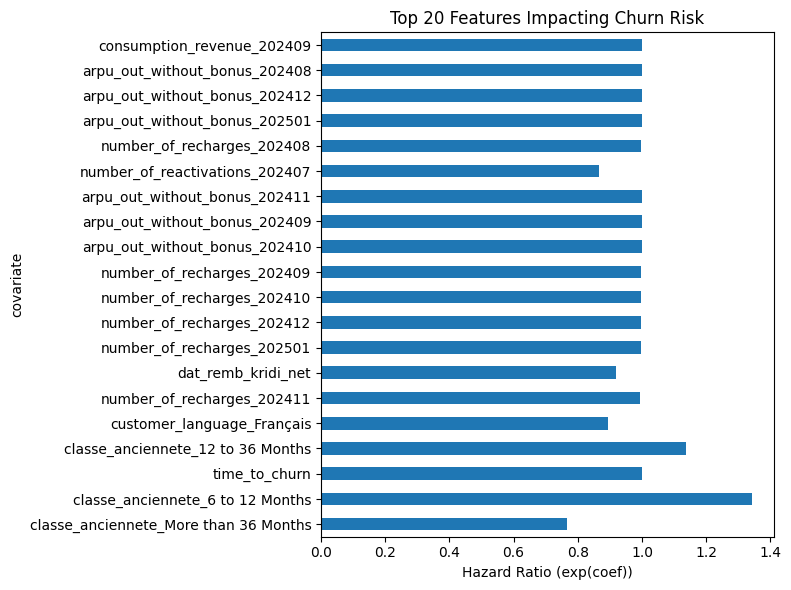

In [162]:
import numpy as np
import pandas as pd
from lifelines import CoxPHFitter
import matplotlib.pyplot as plt

# ====== STEP 1: COPY THE ORIGINAL DATA ======
regression_df_per_period = final_df_per_period.copy()

# ====== STEP 2: DROP UNUSED COLUMNS ======
cols_to_drop = [
    'subscriber_id', 'date_activation', 'first_call_date', 'last_call_date'
]
regression_df_per_period = regression_df_per_period.drop(columns=cols_to_drop, errors='ignore')

# ====== STEP 3: REMOVE NaN AND INF ======
regression_df_per_period = regression_df_per_period.replace([np.inf, -np.inf], np.nan).dropna()

# ====== STEP 4: DROP CONSTANT COLUMNS ======
constant_cols = [col for col in regression_df_per_period.columns if regression_df_per_period[col].nunique() <= 1]
regression_df_per_period = regression_df_per_period.drop(columns=constant_cols)

# ====== STEP 5: ONE-HOT ENCODE OBJECT/CATEGORICAL COLUMNS ======
# Identify categorical columns (object or category dtype, plus your known categorical columns)
cat_cols = regression_df_per_period.select_dtypes(include='object').columns.tolist()
for c in ['device_type', 'classe_anciennete', 'marital_status', 'gender', 'customer_language']:
    if c in regression_df_per_period.columns and c not in cat_cols:
        cat_cols.append(c)

regression_df_per_period = pd.get_dummies(regression_df_per_period, columns=cat_cols, drop_first=True, dtype=int)

# ====== STEP 6: DROP HIGHLY CORRELATED COLUMNS (OPTIONAL BUT RECOMMENDED) ======
corr_matrix = regression_df_per_period.corr().abs()
upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(bool))
to_drop = [col for col in upper.columns if any(upper[col] > 0.9)]
regression_df = regression_df_per_period.drop(columns=to_drop)

# ====== STEP 7: FIT THE COX PROPORTIONAL HAZARDS MODEL ======
cph = CoxPHFitter(penalizer=0.5)  # Penalizer helps if you have many variables
cph.fit(regression_df, duration_col='tenure_days', event_col='churn')
cph.print_summary()

# ====== STEP 8: VISUALIZE TOP FEATURES ======
# Plot the top 20 features by significance
top_features = cph.summary.sort_values('p', ascending=True).head(20)
top_features['exp(coef)'].plot(kind='barh', figsize=(8,6))
plt.xlabel('Hazard Ratio (exp(coef))')
plt.title('Top 20 Features Impacting Churn Risk')
plt.tight_layout()
plt.show()


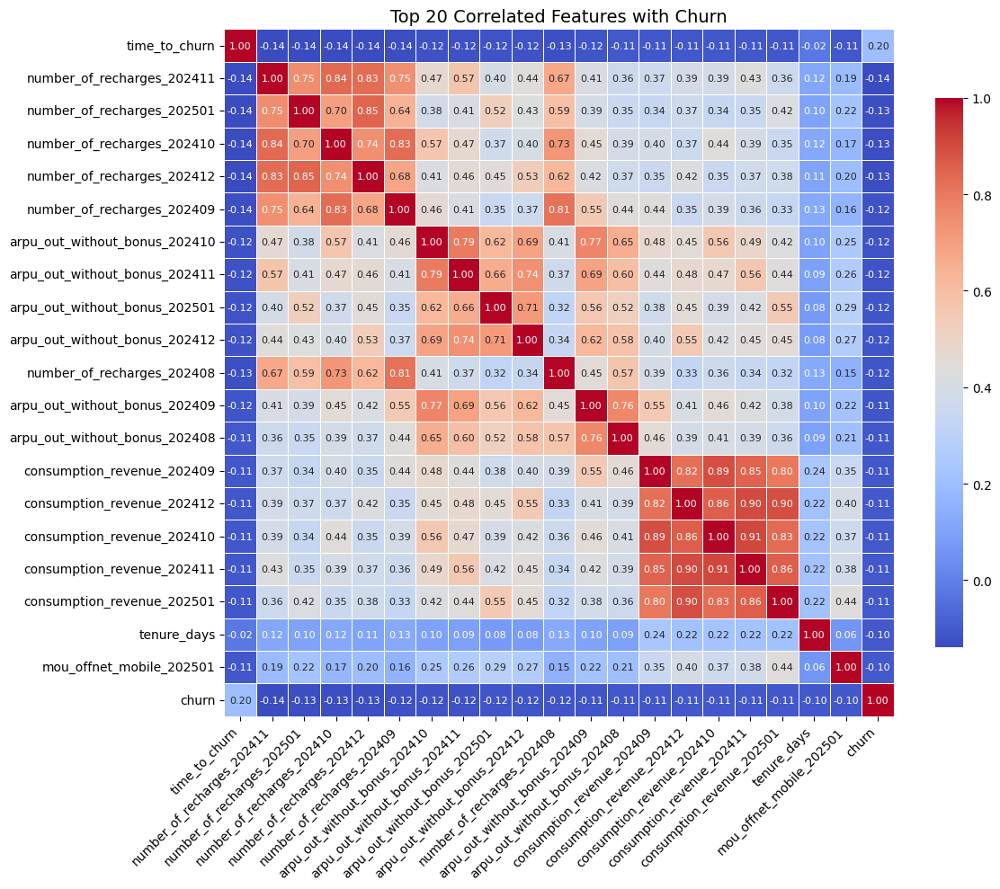

In [163]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

# Assuming df_final_0 is your DataFrame
# Step 1: Select only numeric columns
numeric_columns = final_df_per_period.select_dtypes(include=['float64', 'int64']).columns

# Step 2: Compute the correlation matrix
correlation_matrix = final_df_per_period[numeric_columns].corr()

# -----------------------------
# OPTION 1: Top N Correlated Features with Target (e.g., 'churn')
# -----------------------------
if 'churn' in correlation_matrix.columns:
    churn_corr = correlation_matrix['churn'].drop('churn')
    top_features = churn_corr.abs().sort_values(ascending=False).head(20).index.tolist()

    # Add 'churn' back in to see how each feature correlates with it
    top_corr_matrix = final_df_per_period[top_features + ['churn']].corr()

    plt.figure(figsize=(12, 10))
    sns.heatmap(top_corr_matrix,
                annot=True,
                cmap='coolwarm',
                fmt='.2f',
                linewidths=0.5,
                cbar_kws={'shrink': 0.8},
                annot_kws={"size": 8})
    plt.title('Top 20 Correlated Features with Churn', fontsize=14)
    plt.xticks(rotation=45, ha='right')
    plt.tight_layout()
    plt.show()
else:
    print("Column 'churn' not found in correlation matrix. Skipping Option 1.")

In [164]:
for col in final_df.columns:
    print(col)

churn
classe_anciennete
subscriber_id
date_activation
first_call_date
last_call_date
original_operator
dat_remb_kridi_net
tenure_days
has_international_call
time_to_churn
device_type
flag_smartphone
age
marital_status
gender
customer_language
arpu_out_without_bonus_moyenne
bonus_on_consumption_revenue_moyenne
bonus_on_refill_flash_revenue_moyenne
consumption_revenue_moyenne
data_trafic_volume_moyenne
mou_international_moyenne
mou_offnet_fix_moyenne
mou_offnet_mobile_moyenne
mou_onnet_moyenne
number_of_reactivations_moyenne
number_of_sms_international_moyenne
number_of_sms_offnet_moyenne
number_of_sms_onnet_moyenne
recharge_amount_moyenne
total_voice_revenu_amount_moyenne


In [2]:
import pandas as pd 
df=pd.read_csv('final_df_encoded.csv')

In [3]:
for col in df.columns:
    print(col)

churn
subscriber_id
original_operator
dat_remb_kridi_net
tenure_days
has_international_call
time_to_churn
flag_smartphone
arpu_out_without_bonus_202407
arpu_out_without_bonus_202408
arpu_out_without_bonus_202409
arpu_out_without_bonus_202410
arpu_out_without_bonus_202411
arpu_out_without_bonus_202412
arpu_out_without_bonus_202501
bonus_on_consumption_revenue_202407
bonus_on_consumption_revenue_202408
bonus_on_consumption_revenue_202409
bonus_on_consumption_revenue_202410
bonus_on_consumption_revenue_202411
bonus_on_consumption_revenue_202412
bonus_on_consumption_revenue_202501
bonus_on_refill_flash_revenue_202407
bonus_on_refill_flash_revenue_202408
bonus_on_refill_flash_revenue_202409
bonus_on_refill_flash_revenue_202410
bonus_on_refill_flash_revenue_202411
bonus_on_refill_flash_revenue_202412
bonus_on_refill_flash_revenue_202501
consumption_revenue_202407
consumption_revenue_202408
consumption_revenue_202409
consumption_revenue_202410
consumption_revenue_202411
consumption_revenue_20

In [4]:
import pandas as pd
import matplotlib.pyplot as plt

# Supposons que votre DataFrame s'appelle df et contient exactement ces trois colonnes
# (0 ou 1 dans chacune).

# 1. Calcul des effectifs par tranche d’âge
counts = df[['age_<18', 'age_18-50', 'age_>50']].sum()

# 2. Calcul des pourcentages
total = counts.sum()
percentages = (counts / total) * 100

# 3. Mise en forme dans un DataFrame pour lecture claire
result = pd.DataFrame({
    'Effectif': counts.astype(int),
    'Pourcentage (%)': percentages.round(2)
})
print(result)


           Effectif  Pourcentage (%)
age_<18         293             0.07
age_18-50    274599            68.92
age_>50      123514            31.00


C:\Users\Client\AppData\Local\Temp\ipykernel_24284\779797578.py:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=final_df, x='churn', y='tenure_days', palette='coolwarm', ax=axes[0, 0])
C:\Users\Client\AppData\Local\Temp\ipykernel_24284\779797578.py:12: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=final_df, x='churn', y='time_to_churn', palette='coolwarm', ax=axes[0, 1])


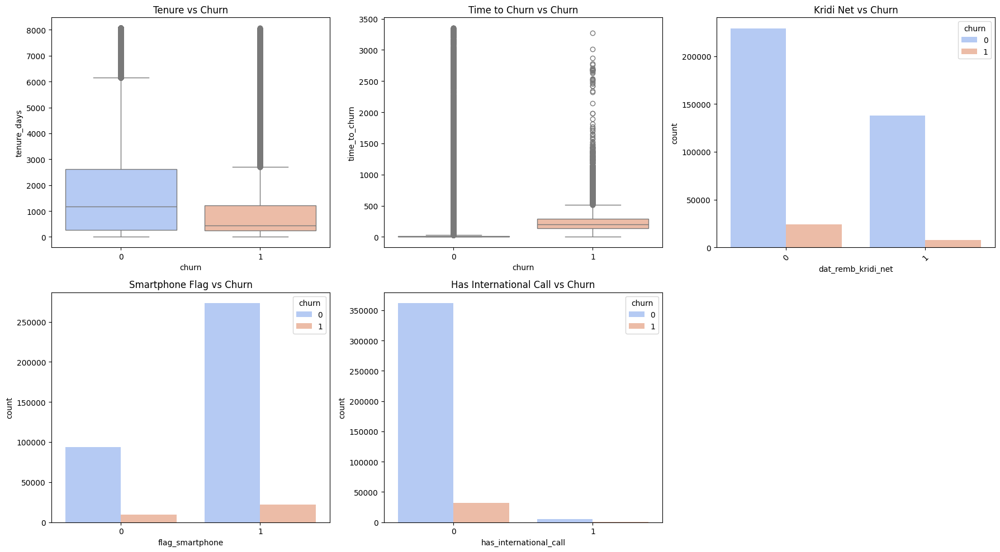

In [165]:
import matplotlib.pyplot as plt
import seaborn as sns

# Créer une figure avec suffisamment de sous-graphiques utilisés (2 lignes x 3 colonnes)
fig, axes = plt.subplots(2, 3, figsize=(18, 10))

# Plot 1: tenure_days vs churn
sns.boxplot(data=final_df, x='churn', y='tenure_days', palette='coolwarm', ax=axes[0, 0])
axes[0, 0].set_title('Tenure vs Churn')

# Plot 2: time_to_churn vs churn
sns.boxplot(data=final_df, x='churn', y='time_to_churn', palette='coolwarm', ax=axes[0, 1])
axes[0, 1].set_title('Time to Churn vs Churn')

# Plot 3: Kridi vs churn (discret, idéalement en countplot)
sns.countplot(data=final_df_per_period, x='dat_remb_kridi_net', hue='churn', palette='coolwarm', ax=axes[0, 2])
axes[0, 2].set_title('Kridi Net vs Churn')
axes[0, 2].tick_params(axis='x', rotation=45)

# Plot 4: flag_smartphone vs churn
sns.countplot(data=final_df, x='flag_smartphone', hue='churn', palette='coolwarm', ax=axes[1, 0])
axes[1, 0].set_title('Smartphone Flag vs Churn')

# Plot 5: has_international_call vs churn
sns.countplot(data=final_df, x='has_international_call', hue='churn', palette='coolwarm', ax=axes[1, 1])
axes[1, 1].set_title('Has International Call vs Churn')

# Masquer le dernier subplot inutilisé
axes[1, 2].axis('off')

# Ajuster l’espacement
plt.tight_layout()
plt.show()



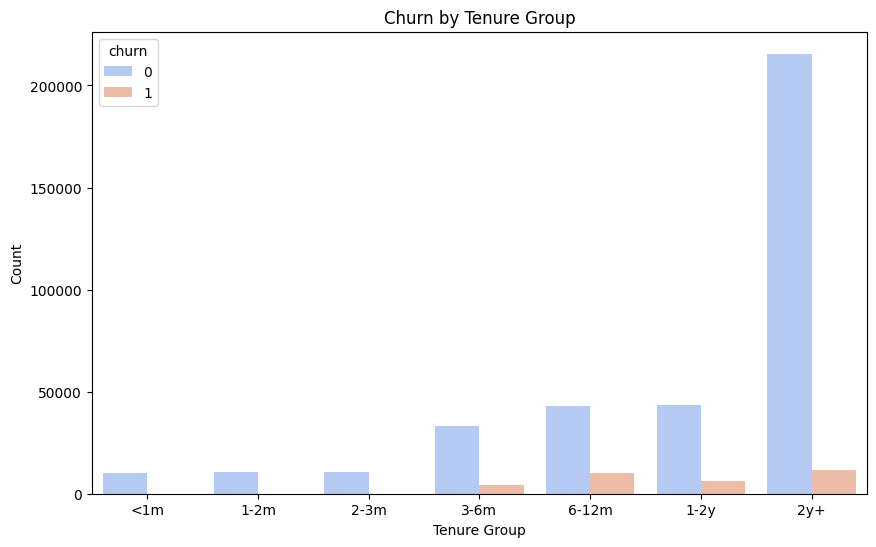

In [166]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Bin tenure_days into ranges (e.g., 0-30, 31-60, ...)
bins = [0, 30, 60, 90, 180, 365, 730, 10000]
labels = ['<1m', '1-2m', '2-3m', '3-6m', '6-12m', '1-2y', '2y+']
final_df['tenure_group'] = pd.cut(final_df['tenure_days'], bins=bins, labels=labels)

# Plot
plt.figure(figsize=(10,6))
sns.countplot(x="tenure_group", hue="churn", data=final_df, palette='coolwarm')
plt.title("Churn by Tenure Group")
plt.xlabel("Tenure Group")
plt.ylabel("Count")
plt.show()


In [167]:
final_df.drop(columns=['date_activation','first_call_date','last_call_date'], inplace=True)

In [168]:
final_df_per_period.drop(columns=['date_activation','first_call_date','last_call_date'], inplace=True)

In [169]:
# Drop tenure_group column
final_df = final_df.drop(columns=['tenure_group'])

# Fill NaNs in 'age' with '18-50'
final_df['age'] = final_df['age'].fillna('18-50')


In [170]:
import pandas as pd

# 1. Identify categorical columns
cat_cols = final_df.select_dtypes(include=['object', 'category']).columns.tolist()
print("Categorical columns:", cat_cols)



Categorical columns: ['classe_anciennete', 'device_type', 'age', 'marital_status', 'gender', 'customer_language']


In [171]:
cat_cols = final_df_per_period.select_dtypes(include=['object', 'category']).columns.tolist()
print("Categorical columns:", cat_cols)

Categorical columns: ['classe_anciennete', 'device_type', 'age', 'marital_status', 'gender', 'customer_language']


In [172]:
for col in final_df_per_period.columns:
    print(col)

churn
classe_anciennete
subscriber_id
original_operator
dat_remb_kridi_net
tenure_days
has_international_call
time_to_churn
device_type
flag_smartphone
arpu_out_without_bonus_202407
arpu_out_without_bonus_202408
arpu_out_without_bonus_202409
arpu_out_without_bonus_202410
arpu_out_without_bonus_202411
arpu_out_without_bonus_202412
arpu_out_without_bonus_202501
bonus_on_consumption_revenue_202407
bonus_on_consumption_revenue_202408
bonus_on_consumption_revenue_202409
bonus_on_consumption_revenue_202410
bonus_on_consumption_revenue_202411
bonus_on_consumption_revenue_202412
bonus_on_consumption_revenue_202501
bonus_on_refill_flash_revenue_202407
bonus_on_refill_flash_revenue_202408
bonus_on_refill_flash_revenue_202409
bonus_on_refill_flash_revenue_202410
bonus_on_refill_flash_revenue_202411
bonus_on_refill_flash_revenue_202412
bonus_on_refill_flash_revenue_202501
consumption_revenue_202407
consumption_revenue_202408
consumption_revenue_202409
consumption_revenue_202410
consumption_revenue

In [173]:
# 2. One-hot encode categorical columns (dummies, drop first if needed)
final_df_encoded = pd.get_dummies(final_df, columns=cat_cols, drop_first=False, dtype=int)





In [174]:
final_df_per_period_encoded = pd.get_dummies(final_df_per_period, columns=cat_cols, drop_first=False, dtype=int)

In [175]:
# 4. Preview new columns
final_df_encoded.drop(columns=['subscriber_id'], inplace=True)


In [176]:
final_df_per_period_encoded.drop(columns=['subscriber_id'], inplace=True)

### features imporatnces 

In [172]:
from sklearn.feature_selection import SelectKBest, f_classif, mutual_info_classif

X_moyenne = final_df_encoded.drop(['churn'], axis=1)
y_moyenne = final_df_encoded['churn']

# ANOVA F-test (linear): for classification
kbest_f = SelectKBest(score_func=f_classif, k=30)
kbest_f.fit(X_moyenne, y_moyenne)
print("Top 20 features by F-test:", list(X_moyenne.columns[kbest_f.get_support()]))

# Mutual information (nonlinear): for classification
kbest_mi = SelectKBest(score_func=mutual_info_classif, k=30)
kbest_mi.fit(X_moyenne, y_moyenne)
print("Top 20 features by MI:", list(X_moyenne.columns[kbest_mi.get_support()]))


Top 20 features by F-test: ['dat_remb_kridi_net', 'tenure_days', 'time_to_churn', 'flag_smartphone', 'arpu_out_without_bonus_moyenne', 'bonus_on_refill_flash_revenue_moyenne', 'consumption_revenue_moyenne', 'data_trafic_volume_moyenne', 'mou_offnet_fix_moyenne', 'mou_offnet_mobile_moyenne', 'mou_onnet_moyenne', 'number_of_reactivations_moyenne', 'number_of_sms_offnet_moyenne', 'number_of_sms_onnet_moyenne', 'recharge_amount_moyenne', 'total_voice_revenu_amount_moyenne', 'classe_anciennete_0 to 3 Months', 'classe_anciennete_12 to 36 Months', 'classe_anciennete_3 to 6 Months', 'classe_anciennete_6 to 12 Months', 'classe_anciennete_More than 36 Months', 'device_type_Phablet', 'device_type_Router', 'age_18-50', 'age_>50', 'gender_F', 'gender_M', 'customer_language_Anglais', 'customer_language_Arabe', 'customer_language_Francais']
Top 20 features by MI: ['original_operator', 'dat_remb_kridi_net', 'tenure_days', 'time_to_churn', 'flag_smartphone', 'arpu_out_without_bonus_moyenne', 'bonus_on_

In [173]:
from sklearn.feature_selection import SelectKBest, f_classif, mutual_info_classif

X_per_period = final_df_per_period_encoded.drop(['churn'], axis=1)
y_per_period = final_df_per_period_encoded['churn']

# ANOVA F-test (linear): for classification
kbest_f = SelectKBest(score_func=f_classif, k=30)
kbest_f.fit(X_per_period, y_per_period)
print("Top 20 features by F-test:", list(X_per_period.columns[kbest_f.get_support()]))

# Mutual information (nonlinear): for classification
kbest_mi = SelectKBest(score_func=mutual_info_classif, k=30)
kbest_mi.fit(X_per_period, y_per_period)
print("Top 20 features by MI:", list(X_per_period.columns[kbest_mi.get_support()]))


Top 20 features by F-test: ['tenure_days', 'time_to_churn', 'arpu_out_without_bonus_202408', 'arpu_out_without_bonus_202409', 'arpu_out_without_bonus_202410', 'arpu_out_without_bonus_202411', 'arpu_out_without_bonus_202412', 'arpu_out_without_bonus_202501', 'consumption_revenue_202408', 'consumption_revenue_202409', 'consumption_revenue_202410', 'consumption_revenue_202411', 'consumption_revenue_202412', 'consumption_revenue_202501', 'mou_offnet_mobile_202408', 'mou_offnet_mobile_202409', 'mou_offnet_mobile_202410', 'mou_offnet_mobile_202411', 'mou_offnet_mobile_202412', 'mou_offnet_mobile_202501', 'mou_onnet_202409', 'number_of_recharges_202408', 'number_of_recharges_202409', 'number_of_recharges_202410', 'number_of_recharges_202411', 'number_of_recharges_202412', 'number_of_recharges_202501', 'classe_anciennete_12 to 36 Months', 'classe_anciennete_6 to 12 Months', 'classe_anciennete_More than 36 Months']
Top 20 features by MI: ['original_operator', 'time_to_churn', 'flag_smartphone',

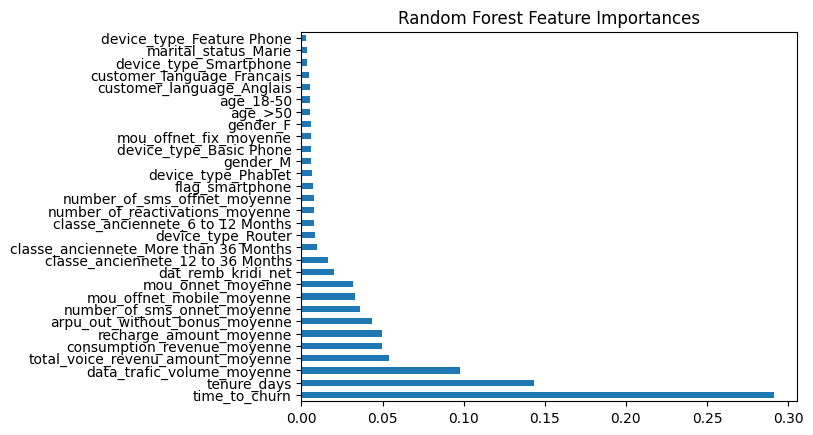

In [174]:
from sklearn.ensemble import RandomForestClassifier

rf_moyenne = RandomForestClassifier(n_estimators=100, random_state=42)
rf_moyenne.fit(X_moyenne, y_moyenne)
importances = pd.Series(rf_moyenne.feature_importances_, index=X_moyenne.columns)
importances.sort_values(ascending=False).head(30).plot(kind='barh')
plt.title('Random Forest Feature Importances')
plt.show()


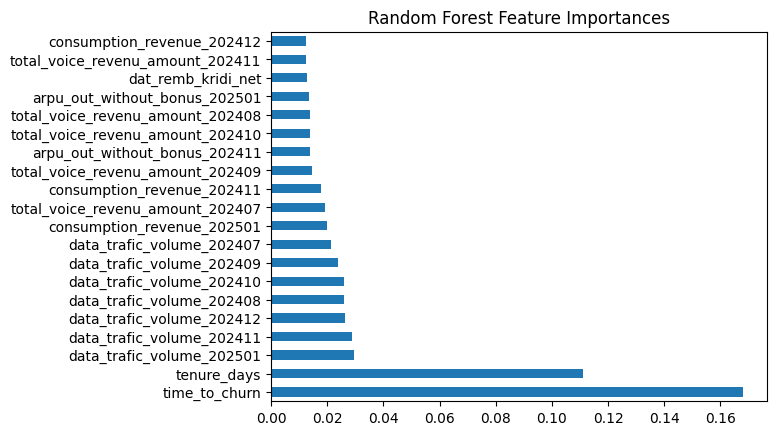

In [175]:
from sklearn.ensemble import RandomForestClassifier

rf_per_period = RandomForestClassifier(n_estimators=100, random_state=42)
rf_per_period.fit(X_per_period, y_per_period)
importances = pd.Series(rf_per_period.feature_importances_, index=X_per_period.columns)
importances.sort_values(ascending=False).head(20).plot(kind='barh')
plt.title('Random Forest Feature Importances')
plt.show()


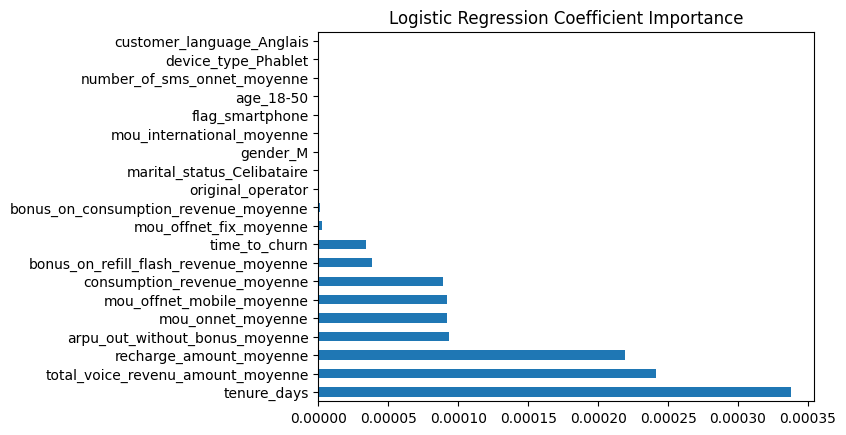

In [176]:
from sklearn.linear_model import LogisticRegression

logreg = LogisticRegression(max_iter=1000, random_state=42)
logreg.fit(X_moyenne, y_moyenne)
coefs = pd.Series(logreg.coef_[0], index=X_moyenne.columns)
coefs.abs().sort_values(ascending=False).head(20).plot(kind='barh')
plt.title('Logistic Regression Coefficient Importance')
plt.show()


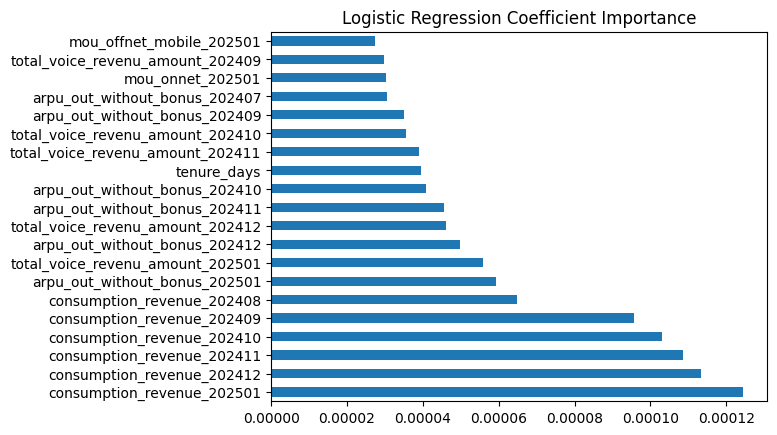

In [177]:
from sklearn.linear_model import LogisticRegression

logreg = LogisticRegression(max_iter=1000, random_state=42)
logreg.fit(X_per_period, y_per_period)
coefs = pd.Series(logreg.coef_[0], index=X_per_period.columns)
coefs.abs().sort_values(ascending=False).head(20).plot(kind='barh')
plt.title('Logistic Regression Coefficient Importance')
plt.show()


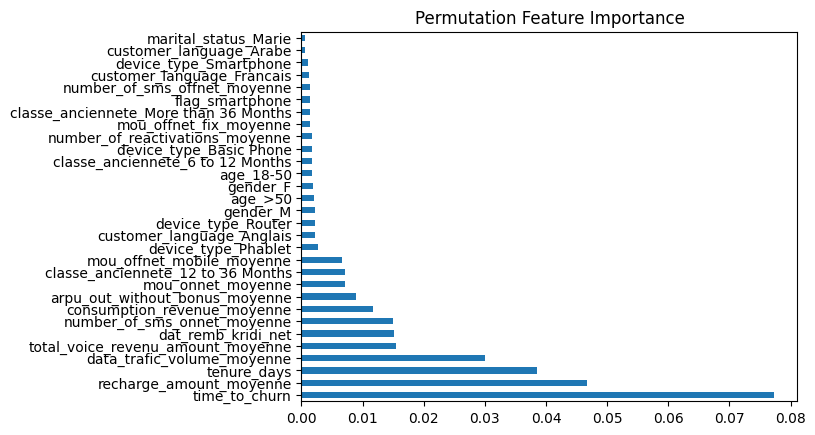

In [178]:
from sklearn.inspection import permutation_importance

result = permutation_importance(rf_moyenne, X_moyenne, y_moyenne, n_repeats=5, random_state=42, n_jobs=-1)
perm_imp = pd.Series(result.importances_mean, index=X_moyenne.columns)
perm_imp.sort_values(ascending=False).head(30).plot(kind='barh')
plt.title('Permutation Feature Importance')
plt.show()


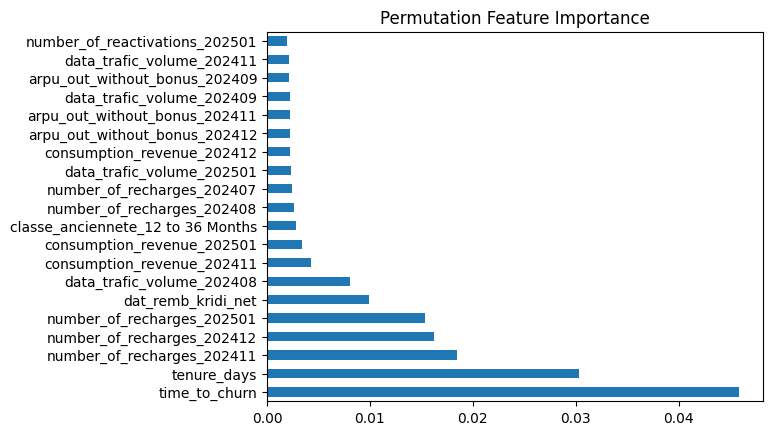

In [179]:
from sklearn.inspection import permutation_importance

result = permutation_importance(rf_per_period, X_per_period, y_per_period, n_repeats=5, random_state=42, n_jobs=-1)
perm_imp = pd.Series(result.importances_mean, index=X_per_period.columns)
perm_imp.sort_values(ascending=False).head(20).plot(kind='barh')
plt.title('Permutation Feature Importance')
plt.show()


In [180]:
from sklearn.feature_selection import RFE
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression

# Option 1: Use Logistic Regression (much faster)
rfe_moyenne = RFE(estimator=LogisticRegression(max_iter=1000, solver='saga'), n_features_to_select=30, step=5)
rfe_moyenne.fit(X_moyenne, y_moyenne)
print("RFE Selected Features (LogReg):", list(X_moyenne.columns[rfe_moyenne.support_]))

# Option 2: Preselect with SelectKBest then RFE with RF
from sklearn.feature_selection import SelectKBest, f_classif

kbest = SelectKBest(f_classif, k=40)
X_kbest = kbest.fit_transform(X_moyenne, y_moyenne)
selected_cols = X_moyenne.columns[kbest.get_support()]

rfe_rf = RFE(estimator=RandomForestClassifier(n_estimators=30, n_jobs=-1), n_features_to_select=20, step=3)
rfe_rf.fit(X_kbest, y_moyenne)
print("RFE Selected Features (RF, after KBest):", list(selected_cols[rfe_rf.support_]))


RFE Selected Features (LogReg): ['original_operator', 'dat_remb_kridi_net', 'tenure_days', 'time_to_churn', 'flag_smartphone', 'arpu_out_without_bonus_moyenne', 'bonus_on_consumption_revenue_moyenne', 'bonus_on_refill_flash_revenue_moyenne', 'consumption_revenue_moyenne', 'data_trafic_volume_moyenne', 'mou_international_moyenne', 'mou_offnet_fix_moyenne', 'mou_offnet_mobile_moyenne', 'mou_onnet_moyenne', 'number_of_sms_offnet_moyenne', 'number_of_sms_onnet_moyenne', 'recharge_amount_moyenne', 'total_voice_revenu_amount_moyenne', 'classe_anciennete_More than 36 Months', 'device_type_Basic Phone', 'device_type_Phablet', 'age_18-50', 'age_>50', 'marital_status_Celibataire', 'marital_status_Marie', 'gender_F', 'gender_M', 'customer_language_Anglais', 'customer_language_Arabe', 'customer_language_Francais']
RFE Selected Features (RF, after KBest): ['dat_remb_kridi_net', 'tenure_days', 'time_to_churn', 'flag_smartphone', 'arpu_out_without_bonus_moyenne', 'consumption_revenue_moyenne', 'data_

In [181]:
from sklearn.feature_selection import RFE
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression

# Option 1: Use Logistic Regression (much faster)
rfe_per_period = RFE(estimator=LogisticRegression(max_iter=1000, solver='saga'), n_features_to_select=30, step=5)
rfe_per_period.fit(X_per_period, y_per_period)
print("RFE Selected Features (LogReg):", list(X_per_period.columns[rfe_per_period.support_]))

# Option 2: Preselect with SelectKBest then RFE with RF
from sklearn.feature_selection import SelectKBest, f_classif

kbest = SelectKBest(f_classif, k=40)
X_kbest_per_period = kbest.fit_transform(X_per_period, y_per_period)
selected_cols = X_per_period.columns[kbest.get_support()]

rfe_rf_per_period = RFE(estimator=RandomForestClassifier(n_estimators=30, n_jobs=-1), n_features_to_select=20, step=3)
rfe_rf_per_period.fit(X_kbest_per_period, y_per_period)
print("RFE Selected Features (RF, after KBest):", list(selected_cols[rfe_rf_per_period.support_]))


RFE Selected Features (LogReg): ['arpu_out_without_bonus_202407', 'arpu_out_without_bonus_202408', 'arpu_out_without_bonus_202409', 'arpu_out_without_bonus_202410', 'arpu_out_without_bonus_202411', 'arpu_out_without_bonus_202412', 'arpu_out_without_bonus_202501', 'consumption_revenue_202407', 'consumption_revenue_202408', 'consumption_revenue_202409', 'consumption_revenue_202410', 'consumption_revenue_202411', 'consumption_revenue_202412', 'consumption_revenue_202501', 'data_trafic_volume_202407', 'data_trafic_volume_202408', 'data_trafic_volume_202409', 'data_trafic_volume_202410', 'data_trafic_volume_202411', 'data_trafic_volume_202412', 'data_trafic_volume_202501', 'mou_onnet_202408', 'mou_onnet_202409', 'total_voice_revenu_amount_202407', 'total_voice_revenu_amount_202408', 'total_voice_revenu_amount_202409', 'total_voice_revenu_amount_202410', 'total_voice_revenu_amount_202411', 'total_voice_revenu_amount_202412', 'total_voice_revenu_amount_202501']
RFE Selected Features (RF, afte


==== classe_anciennete breakdown ====
classe_anciennete
More than 36 Months    50.467111
12 to 36 Months        21.742142
6 to 12 Months         15.899108
3 to 6 Months           8.030000
0 to 3 Months           3.861639
Name: proportion, dtype: float64


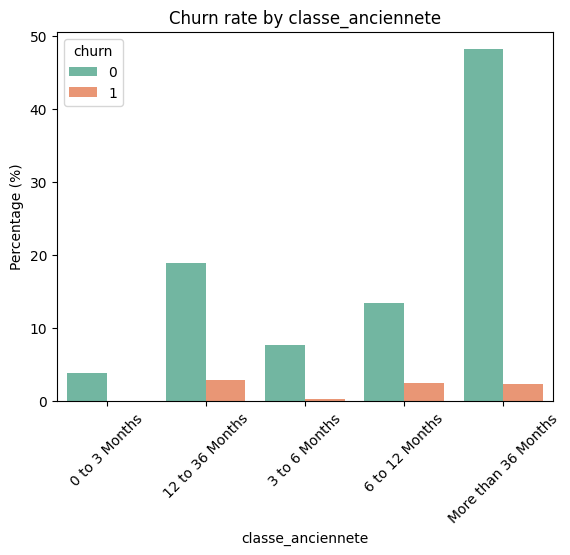


==== original_operator breakdown ====
original_operator
1    98.108462
0     1.891538
Name: proportion, dtype: float64


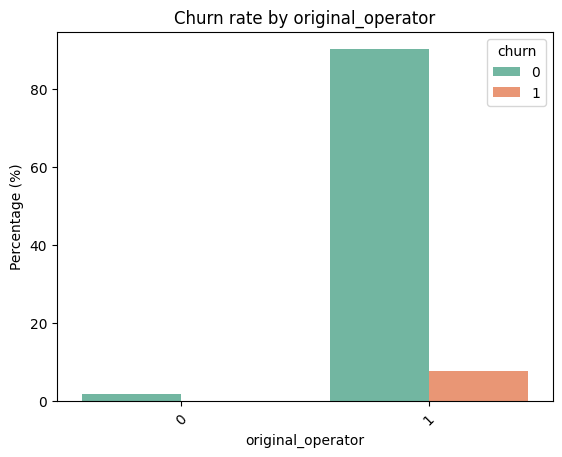


==== device_type breakdown ====
device_type
Phablet                      59.729271
Basic Phone                  14.171724
Smartphone                   13.921477
Feature Phone                 5.960754
Router                        4.333770
Mobile broadband PCI card     0.710331
Tablet                        0.473637
IoT Device                    0.325045
USB Modem                     0.215609
Wearable                      0.099898
POS                           0.058483
Name: proportion, dtype: float64


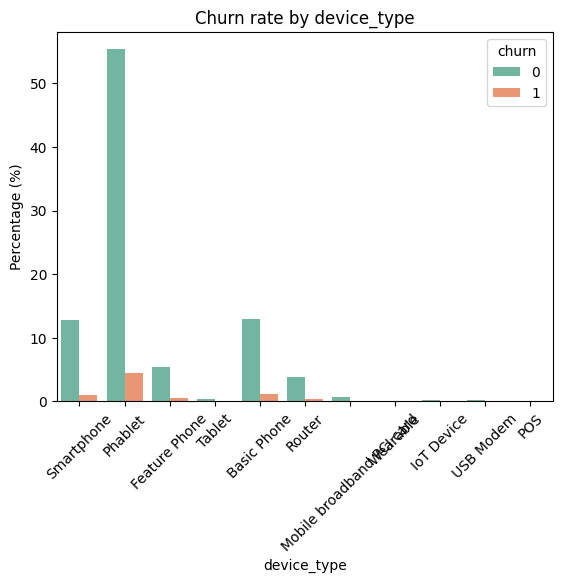


==== flag_smartphone breakdown ====
flag_smartphone
1    74.118864
0    25.881136
Name: proportion, dtype: float64


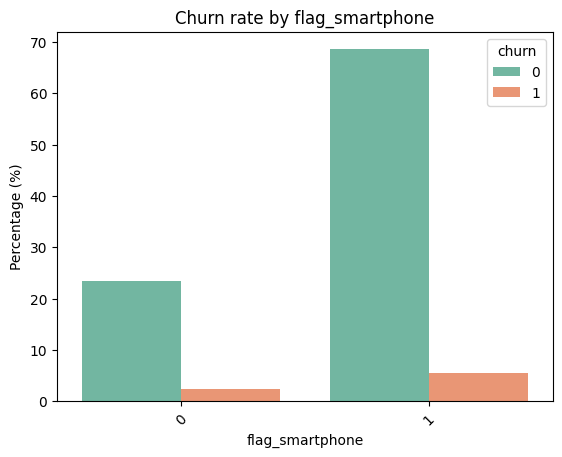


==== marital_status breakdown ====
marital_status
Celibataire    88.707499
Marie          11.277692
Divorce         0.007530
Veuf            0.007279
Name: proportion, dtype: float64


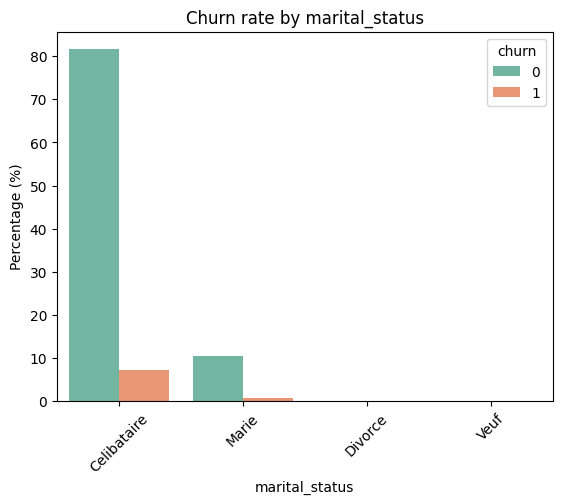


==== gender breakdown ====
gender
M    76.945377
F    23.054623
Name: proportion, dtype: float64


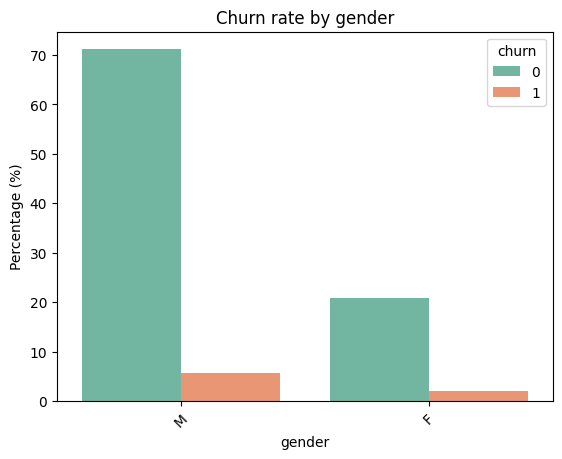


==== customer_language breakdown ====
customer_language
Anglais     68.018303
Arabe       16.720883
Francais    15.237722
Italien      0.023092
Name: proportion, dtype: float64


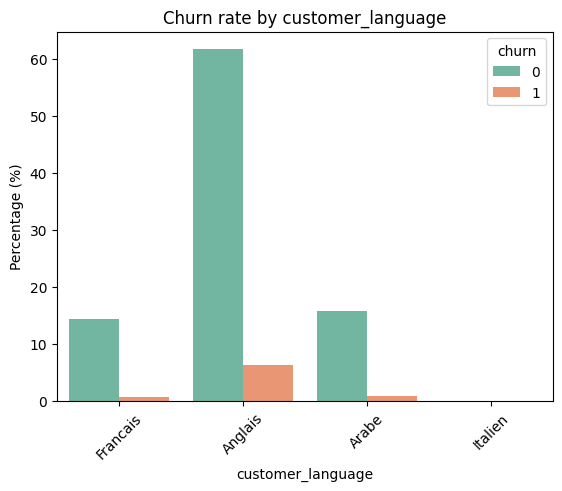

In [182]:
categorical_cols = ['classe_anciennete', 'original_operator', 'device_type', 'flag_smartphone',
                    'marital_status', 'gender', 'customer_language']

for col in categorical_cols:
    print(f"\n==== {col} breakdown ====")
    print(final_df[col].value_counts(dropna=False, normalize=True)*100)
    sns.countplot(data=final_df, x=col, hue='churn', stat='percent', palette='Set2')
    plt.title(f'Churn rate by {col}')
    plt.ylabel('Percentage (%)')
    plt.xticks(rotation=45)
    plt.show()


                                          count          mean           std  \
churn                                  398406.0  7.980302e-02  2.709883e-01   
original_operator                      398406.0  9.810846e-01  1.362264e-01   
dat_remb_kridi_net                     398406.0  3.650071e-01  4.814327e-01   
tenure_days                            398406.0  1.796974e+03  1.974633e+03   
has_international_call                 398406.0  1.357660e-02  1.157252e-01   
time_to_churn                          398406.0  7.331552e+01  2.370461e+02   
flag_smartphone                        398406.0  7.411886e-01  4.379823e-01   
arpu_out_without_bonus_moyenne         398406.0  1.031197e+04  2.082825e+04   
bonus_on_consumption_revenue_moyenne   398406.0  1.529198e+02  1.037799e+04   
bonus_on_refill_flash_revenue_moyenne  398406.0  1.534086e+03  1.117302e+04   
consumption_revenue_moyenne            398406.0  3.332365e+04  8.392448e+04   
data_trafic_volume_moyenne             398406.0  8.9

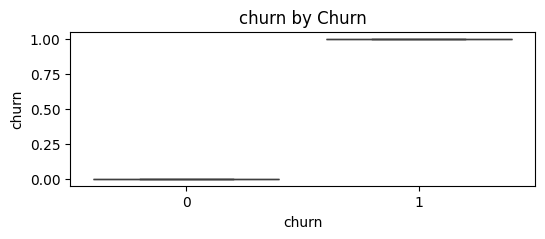

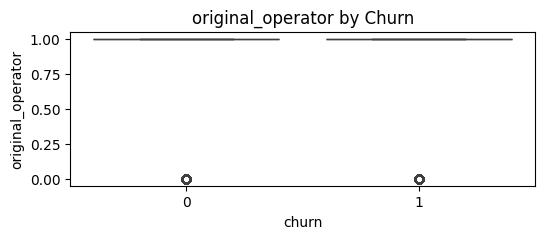

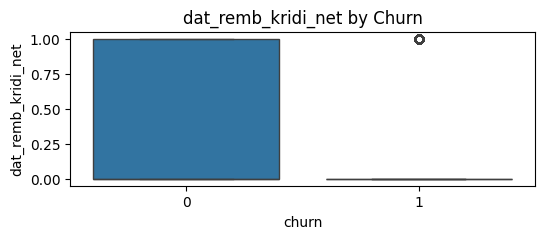

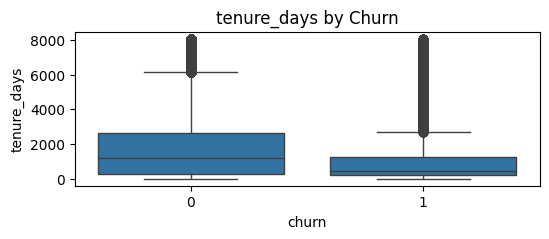

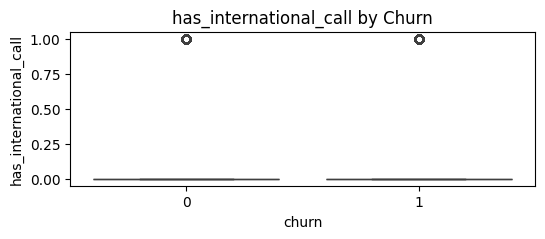

...

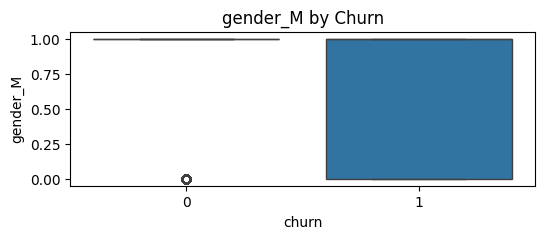

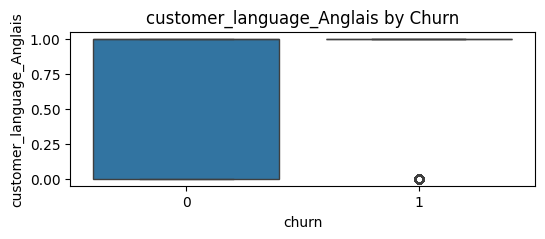

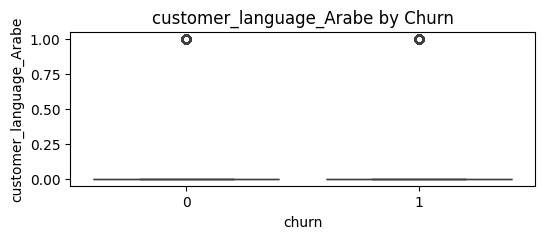

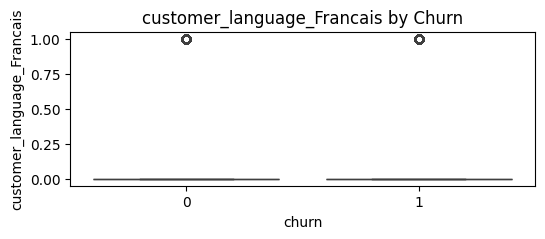

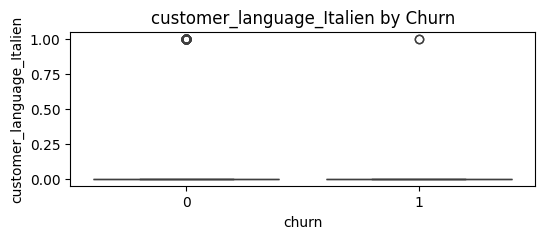

In [183]:
numerical_cols = final_df_encoded.select_dtypes(include='number').columns.tolist()
numerical_cols = [col for col in numerical_cols if col != 'subscriber_id']

print(final_df_encoded[numerical_cols].describe().T)

for col in numerical_cols:
    plt.figure(figsize=(6,2))
    sns.boxplot(x='churn', y=col, data=final_df_encoded)
    plt.title(f'{col} by Churn')
    plt.show()


                               count         mean          std  min    25%  \
churn                       398406.0     0.079803     0.270988  0.0    0.0   
original_operator           398406.0     0.981085     0.136226  0.0    1.0   
dat_remb_kridi_net          398406.0     0.365007     0.481433  0.0    0.0   
tenure_days                 398406.0  1796.974426  1974.633114  0.0  266.0   
has_international_call      398406.0     0.013577     0.115725  0.0    0.0   
...                              ...          ...          ...  ...    ...   
gender_M                    398406.0     0.769454     0.421183  0.0    1.0   
customer_language_Anglais   398406.0     0.680183     0.466406  0.0    0.0   
customer_language_Arabe     398406.0     0.167209     0.373163  0.0    0.0   
customer_language_Francais  398406.0     0.152377     0.359387  0.0    0.0   
customer_language_Italien   398406.0     0.000231     0.015194  0.0    0.0   

                               50%     75%     max  
churn     

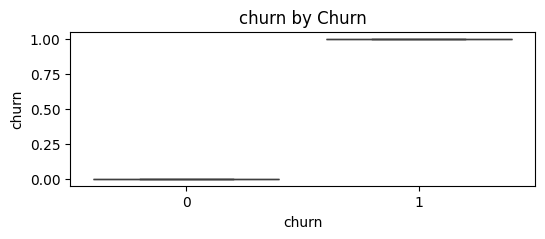

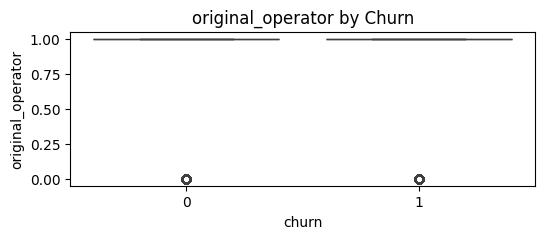

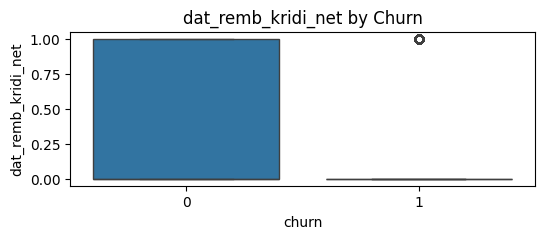

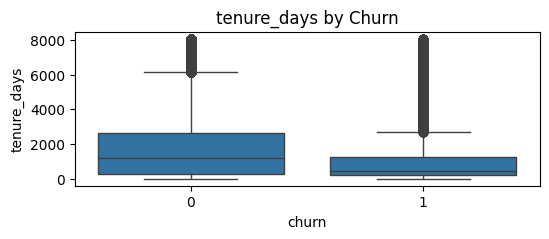

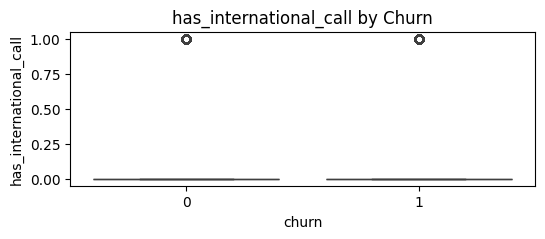

...

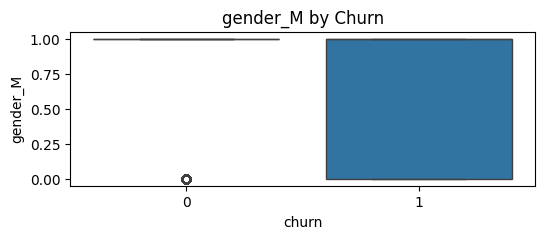

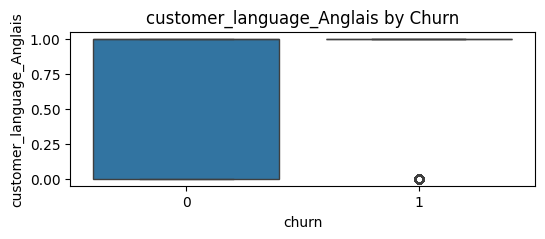

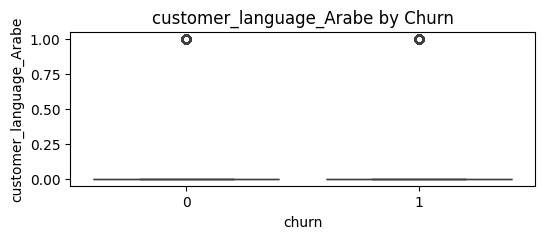

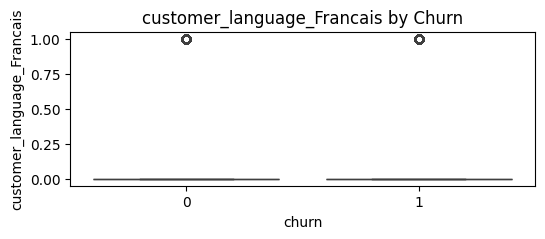

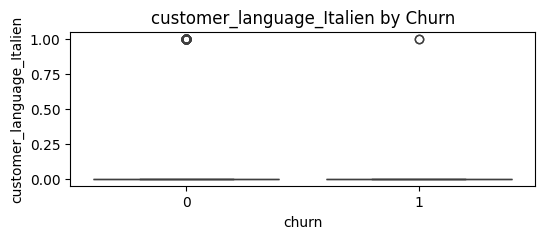

In [184]:
numerical_cols = final_df_per_period_encoded.select_dtypes(include='number').columns.tolist()
numerical_cols = [col for col in numerical_cols if col != 'subscriber_id']

print(final_df_per_period_encoded[numerical_cols].describe().T)

for col in numerical_cols:
    plt.figure(figsize=(6,2))
    sns.boxplot(x='churn', y=col, data=final_df_per_period_encoded)
    plt.title(f'{col} by Churn')
    plt.show()


In [185]:
# Select only float columns
float_cols = final_df.select_dtypes(include=['float', 'float64']).columns

summary_list = []
for col in float_cols:
    zeros = (final_df[col] == 0).sum()
    non_zeros = (final_df[col] != 0).sum()
    total = len(final_df[col])
    summary_list.append({
        'column': col,
        'num_zeros': zeros,
        'pct_zeros': zeros / total * 100,
        'num_nonzeros': non_zeros,
        'pct_nonzeros': non_zeros / total * 100
    })

summary_df = pd.DataFrame(summary_list)
summary_df


,column,num_zeros,pct_zeros,num_nonzeros,pct_nonzeros
0,arpu_out_without_bonus_moyenne,77385,19.423653,321021,80.576347
1,bonus_on_consumption_revenue_moyenne,394927,99.126770,3479,0.873230
2,bonus_on_refill_flash_revenue_moyenne,357310,89.684894,41096,10.315106
3,consumption_revenue_moyenne,74617,18.728885,323789,81.271115
4,data_trafic_volume_moyenne,4517,1.133768,393889,98.866232
5,mou_international_moyenne,373637,93.782975,24769,6.217025
6,mou_offnet_fix_moyenne,265803,66.716616,132603,33.283384
7,mou_offnet_mobile_moyenne,96237,24.155510,302169,75.844490
8,mou_onnet_moyenne,93197,23.392469,305209,76.607531
9,number_of_reactivations_moyenne,374118,93.903706,24288,6.096294


In [186]:
# Select only float columns
float_cols = final_df_per_period.select_dtypes(include=['float', 'float64']).columns

summary_list = []
for col in float_cols:
    zeros = (final_df_per_period[col] == 0).sum()
    non_zeros = (final_df_per_period[col] != 0).sum()
    total = len(final_df_per_period[col])
    summary_list.append({
        'column': col,
        'num_zeros': zeros,
        'pct_zeros': zeros / total * 100,
        'num_nonzeros': non_zeros,
        'pct_nonzeros': non_zeros / total * 100
    })

summary_df = pd.DataFrame(summary_list)
summary_df


,column,num_zeros,pct_zeros,num_nonzeros,pct_nonzeros
0,arpu_out_without_bonus_202407,169233,42.477523,229173,57.522477
1,arpu_out_without_bonus_202408,163876,41.132915,234530,58.867085
2,arpu_out_without_bonus_202409,160735,40.344523,237671,59.655477
3,arpu_out_without_bonus_202410,165219,41.470008,233187,58.529992
4,arpu_out_without_bonus_202411,167430,42.024970,230976,57.975030
...,...,...,...,...,...
100,total_voice_revenu_amount_202409,44847,11.256608,353559,88.743392
101,total_voice_revenu_amount_202410,33983,8.529741,364423,91.470259
102,total_voice_revenu_amount_202411,23987,6.020743,374419,93.979257
103,total_voice_revenu_amount_202412,12927,3.244680,385479,96.755320


In [177]:
# Example for one variable (repeat for all relevant ones)
for col in final_df_per_period.select_dtypes(include=['float64']).columns:
    q_low = final_df_per_period[col].quantile(0.01)
    q_high = final_df_per_period[col].quantile(0.99)
    outliers = final_df_per_period[(final_df_per_period[col] < q_low) | (final_df_per_period[col] > q_high)]
    print(f'{col} - Outliers: {len(outliers)}')



arpu_out_without_bonus_202407 - Outliers: 3990
arpu_out_without_bonus_202408 - Outliers: 3987
arpu_out_without_bonus_202409 - Outliers: 3987
arpu_out_without_bonus_202410 - Outliers: 3993
arpu_out_without_bonus_202411 - Outliers: 3990
arpu_out_without_bonus_202412 - Outliers: 3985
arpu_out_without_bonus_202501 - Outliers: 3985
bonus_on_consumption_revenue_202407 - Outliers: 2581
bonus_on_consumption_revenue_202408 - Outliers: 2574
bonus_on_consumption_revenue_202409 - Outliers: 2554
bonus_on_consumption_revenue_202410 - Outliers: 2511
bonus_on_consumption_revenue_202411 - Outliers: 2474
bonus_on_consumption_revenue_202412 - Outliers: 2417
bonus_on_consumption_revenue_202501 - Outliers: 2453
bonus_on_refill_flash_revenue_202407 - Outliers: 3974
bonus_on_refill_flash_revenue_202408 - Outliers: 3985
bonus_on_refill_flash_revenue_202409 - Outliers: 277
bonus_on_refill_flash_revenue_202410 - Outliers: 276
bonus_on_refill_flash_revenue_202411 - Outliers: 239
bonus_on_refill_flash_revenue_202

In [178]:
# Example for one variable (repeat for all relevant ones)
for col in final_df.select_dtypes(include=['float64']).columns:
    q_low = final_df[col].quantile(0.01)
    q_high = final_df[col].quantile(0.99)
    outliers = final_df[(final_df[col] < q_low) | (final_df[col] > q_high)]
    print(f'{col} - Outliers: {len(outliers)}')



arpu_out_without_bonus_moyenne - Outliers: 3987
bonus_on_consumption_revenue_moyenne - Outliers: 3479
bonus_on_refill_flash_revenue_moyenne - Outliers: 3985
consumption_revenue_moyenne - Outliers: 3987
data_trafic_volume_moyenne - Outliers: 3985
mou_international_moyenne - Outliers: 3774
mou_offnet_fix_moyenne - Outliers: 3963
mou_offnet_mobile_moyenne - Outliers: 3985
mou_onnet_moyenne - Outliers: 3985
number_of_reactivations_moyenne - Outliers: 0
number_of_sms_international_moyenne - Outliers: 3331
number_of_sms_offnet_moyenne - Outliers: 3979
number_of_sms_onnet_moyenne - Outliers: 3972
recharge_amount_moyenne - Outliers: 3970
total_voice_revenu_amount_moyenne - Outliers: 7970


In [179]:
import pandas as pd
import numpy as np

def iqr_capping(df, verbose=True):
    df_capped = df.copy()
    float_cols = df.select_dtypes(include=['float64']).columns

    for col in float_cols:
        Q1 = df[col].quantile(0.25)
        Q3 = df[col].quantile(0.75)
        IQR = Q3 - Q1
        lower = Q1 - 1.5 * IQR
        upper = Q3 + 1.5 * IQR

        outliers_before = ((df[col] < lower) | (df[col] > upper)).sum()

        df_capped[col] = df[col].clip(lower=lower, upper=upper)

        outliers_after = ((df_capped[col] < lower) | (df_capped[col] > upper)).sum()

        if verbose:
            print(f"{col}: capped {outliers_before} outliers. Remaining: {outliers_after}")

    return df_capped

# ✅ Apply it to your DataFrame
final_df_encoded = iqr_capping(final_df_encoded)

# Example to preview
final_df_encoded.head()


arpu_out_without_bonus_moyenne: capped 31695 outliers. Remaining: 0
bonus_on_consumption_revenue_moyenne: capped 3479 outliers. Remaining: 0
bonus_on_refill_flash_revenue_moyenne: capped 41096 outliers. Remaining: 0
consumption_revenue_moyenne: capped 54583 outliers. Remaining: 0
data_trafic_volume_moyenne: capped 60204 outliers. Remaining: 0
mou_international_moyenne: capped 24769 outliers. Remaining: 0
mou_offnet_fix_moyenne: capped 64570 outliers. Remaining: 0
mou_offnet_mobile_moyenne: capped 48862 outliers. Remaining: 0
mou_onnet_moyenne: capped 49718 outliers. Remaining: 0
number_of_reactivations_moyenne: capped 24288 outliers. Remaining: 0
number_of_sms_international_moyenne: capped 25651 outliers. Remaining: 0
number_of_sms_offnet_moyenne: capped 62504 outliers. Remaining: 0
number_of_sms_onnet_moyenne: capped 45465 outliers. Remaining: 0
recharge_amount_moyenne: capped 37345 outliers. Remaining: 0
total_voice_revenu_amount_moyenne: capped 38824 outliers. Remaining: 0


,churn,original_operator,dat_remb_kridi_net,tenure_days,has_international_call,time_to_churn,flag_smartphone,arpu_out_without_bonus_moyenne,bonus_on_consumption_revenue_moyenne,bonus_on_refill_flash_revenue_moyenne,...,marital_status_Celibataire,marital_status_Divorce,marital_status_Marie,marital_status_Veuf,gender_F,gender_M,customer_language_Anglais,customer_language_Arabe,customer_language_Français,customer_language_Italien
0,0,1,0,0,0,0,1,3614.285714,0.0,0.0,...,1,0,0,0,0,1,0,0,1,0
1,0,1,0,38,0,33,1,568.571429,0.0,0.0,...,1,0,0,0,0,1,1,0,0,0
2,0,1,0,24,0,24,0,71.428571,0.0,0.0,...,1,0,0,0,0,1,0,1,0,0
3,0,1,0,38,0,0,1,2233.571429,0.0,0.0,...,1,0,0,0,1,0,0,1,0,0
4,0,1,0,37,0,0,1,0.000000,0.0,0.0,...,1,0,0,0,0,1,1,0,0,0


In [180]:
final_df_per_period_encoded=iqr_capping(final_df_per_period_encoded)

# Example to preview
final_df_per_period_encoded.head()


arpu_out_without_bonus_202407: capped 38950 outliers. Remaining: 0
arpu_out_without_bonus_202408: capped 38243 outliers. Remaining: 0
arpu_out_without_bonus_202409: capped 35766 outliers. Remaining: 0
arpu_out_without_bonus_202410: capped 40507 outliers. Remaining: 0
arpu_out_without_bonus_202411: capped 42016 outliers. Remaining: 0
arpu_out_without_bonus_202412: capped 40866 outliers. Remaining: 0
arpu_out_without_bonus_202501: capped 40972 outliers. Remaining: 0
bonus_on_consumption_revenue_202407: capped 2581 outliers. Remaining: 0
bonus_on_consumption_revenue_202408: capped 2574 outliers. Remaining: 0
bonus_on_consumption_revenue_202409: capped 2554 outliers. Remaining: 0
bonus_on_consumption_revenue_202410: capped 2511 outliers. Remaining: 0
bonus_on_consumption_revenue_202411: capped 2474 outliers. Remaining: 0
bonus_on_consumption_revenue_202412: capped 2417 outliers. Remaining: 0
bonus_on_consumption_revenue_202501: capped 2453 outliers. Remaining: 0
bonus_on_refill_flash_reven

,churn,original_operator,dat_remb_kridi_net,tenure_days,has_international_call,time_to_churn,flag_smartphone,arpu_out_without_bonus_202407,arpu_out_without_bonus_202408,arpu_out_without_bonus_202409,...,marital_status_Celibataire,marital_status_Divorce,marital_status_Marie,marital_status_Veuf,gender_F,gender_M,customer_language_Anglais,customer_language_Arabe,customer_language_Français,customer_language_Italien
0,0,1,0,0,0,0,1,0.0,0.0,0.0,...,1,0,0,0,0,1,0,0,1,0
1,0,1,0,38,0,33,1,0.0,0.0,0.0,...,1,0,0,0,0,1,1,0,0,0
2,0,1,0,24,0,24,0,0.0,0.0,0.0,...,1,0,0,0,0,1,0,1,0,0
3,0,1,0,38,0,0,1,0.0,0.0,0.0,...,1,0,0,0,1,0,0,1,0,0
4,0,1,0,37,0,0,1,0.0,0.0,0.0,...,1,0,0,0,0,1,1,0,0,0


In [191]:
for col in float_cols:
    data_count = final_df_per_period_encoded[col]
    zeros = (data_count == 0).sum()
    non_zeros = (data_count != 0).sum()
    total = data_count.notna().sum()
    print(f"{col}: zeros={zeros} ({zeros/total:.2%}), non-zeros={non_zeros} ({non_zeros/total:.2%})")


arpu_out_without_bonus_202407: zeros=169233 (42.48%), non-zeros=229173 (57.52%)
arpu_out_without_bonus_202408: zeros=163876 (41.13%), non-zeros=234530 (58.87%)
arpu_out_without_bonus_202409: zeros=160735 (40.34%), non-zeros=237671 (59.66%)
arpu_out_without_bonus_202410: zeros=165219 (41.47%), non-zeros=233187 (58.53%)
arpu_out_without_bonus_202411: zeros=167430 (42.02%), non-zeros=230976 (57.98%)
arpu_out_without_bonus_202412: zeros=164906 (41.39%), non-zeros=233500 (58.61%)
arpu_out_without_bonus_202501: zeros=164267 (41.23%), non-zeros=234139 (58.77%)
bonus_on_consumption_revenue_202407: zeros=398406 (100.00%), non-zeros=0 (0.00%)
bonus_on_consumption_revenue_202408: zeros=398406 (100.00%), non-zeros=0 (0.00%)
bonus_on_consumption_revenue_202409: zeros=398406 (100.00%), non-zeros=0 (0.00%)
bonus_on_consumption_revenue_202410: zeros=398406 (100.00%), non-zeros=0 (0.00%)
bonus_on_consumption_revenue_202411: zeros=398406 (100.00%), non-zeros=0 (0.00%)
bonus_on_consumption_revenue_202412

In [192]:
for col in final_df_encoded.select_dtypes(include='float64').columns:
    data_moyenne_count = final_df_encoded[col]
    zeros = (data_moyenne_count == 0).sum()
    non_zeros = (data_moyenne_count != 0).sum()
    total = data_moyenne_count.notna().sum()
    print(f"{col}: zeros={zeros} ({zeros/total:.2%}), non-zeros={non_zeros} ({non_zeros/total:.2%})")


arpu_out_without_bonus_moyenne: zeros=77385 (19.42%), non-zeros=321021 (80.58%)
bonus_on_consumption_revenue_moyenne: zeros=398406 (100.00%), non-zeros=0 (0.00%)
bonus_on_refill_flash_revenue_moyenne: zeros=398406 (100.00%), non-zeros=0 (0.00%)
consumption_revenue_moyenne: zeros=74617 (18.73%), non-zeros=323789 (81.27%)
data_trafic_volume_moyenne: zeros=4517 (1.13%), non-zeros=393889 (98.87%)
mou_international_moyenne: zeros=398406 (100.00%), non-zeros=0 (0.00%)
mou_offnet_fix_moyenne: zeros=265803 (66.72%), non-zeros=132603 (33.28%)
mou_offnet_mobile_moyenne: zeros=96237 (24.16%), non-zeros=302169 (75.84%)
mou_onnet_moyenne: zeros=93197 (23.39%), non-zeros=305209 (76.61%)
number_of_reactivations_moyenne: zeros=398406 (100.00%), non-zeros=0 (0.00%)
number_of_sms_international_moyenne: zeros=398406 (100.00%), non-zeros=0 (0.00%)
number_of_sms_offnet_moyenne: zeros=241094 (60.51%), non-zeros=157312 (39.49%)
number_of_sms_onnet_moyenne: zeros=100486 (25.22%), non-zeros=297920 (74.78%)
rec

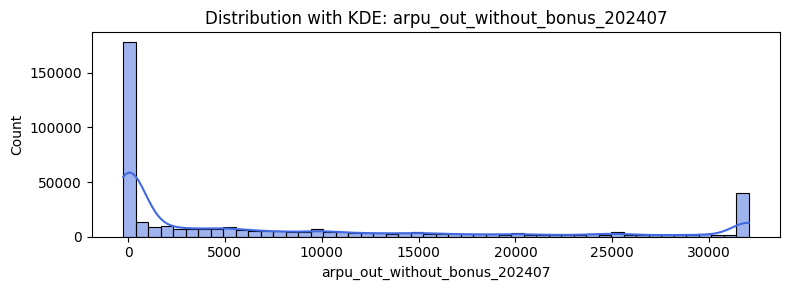

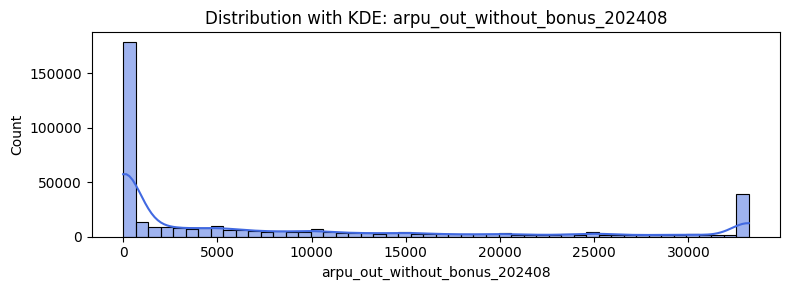

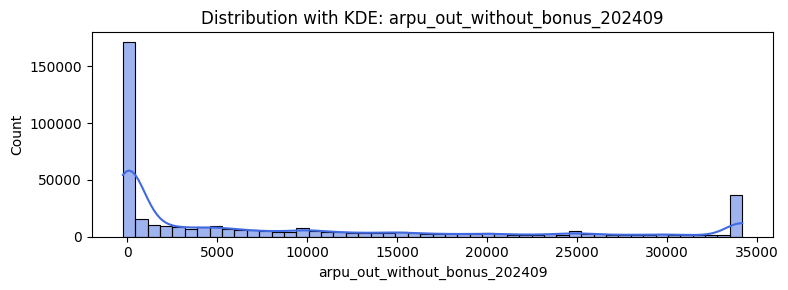

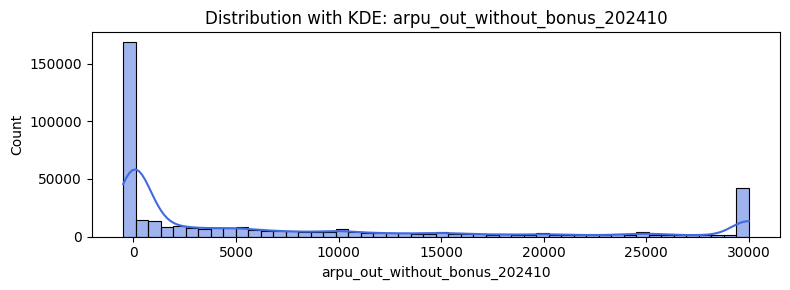

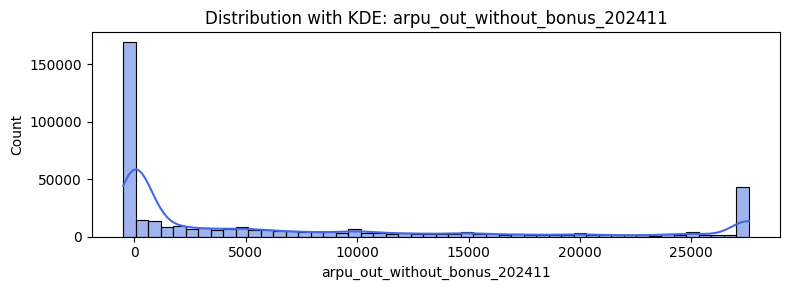

...

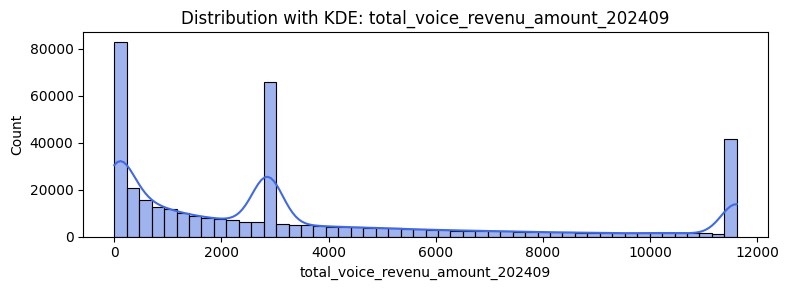

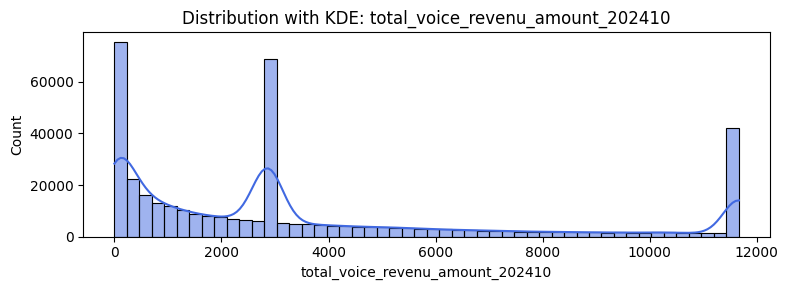

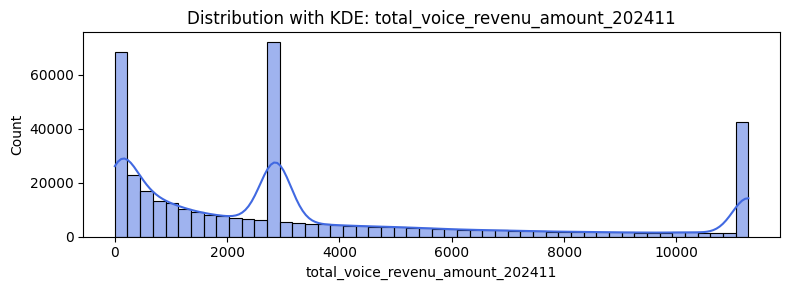

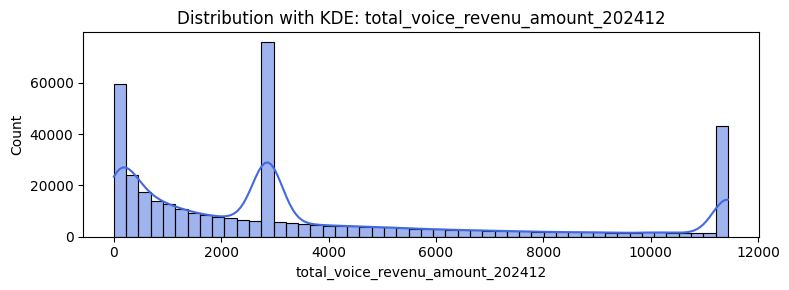

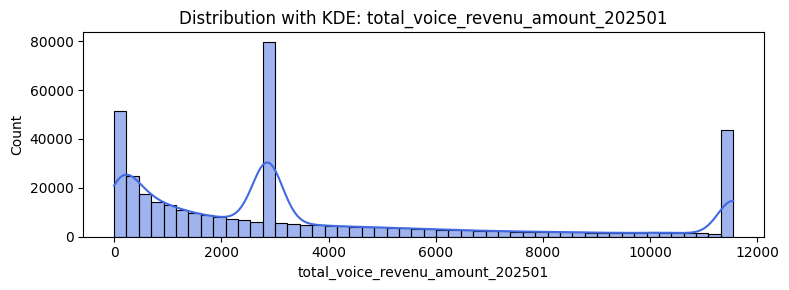

In [181]:
import matplotlib.pyplot as plt
import seaborn as sns

float_cols = final_df_per_period_encoded.select_dtypes(include='float').columns

for col in float_cols:
    plt.figure(figsize=(8, 3))
    sns.histplot(final_df_per_period_encoded[col], bins=50, kde=True, color="royalblue", edgecolor="black")
    plt.title(f"Distribution with KDE: {col}")
    plt.xlabel(col)
    plt.ylabel("Count")
    plt.tight_layout()
    plt.show()


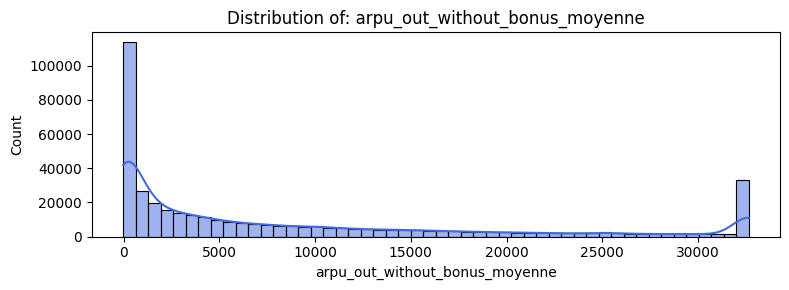

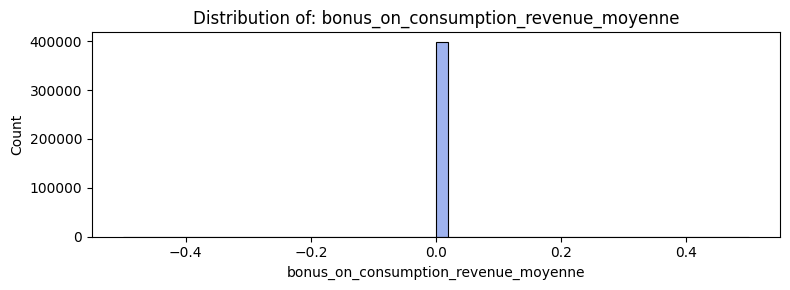

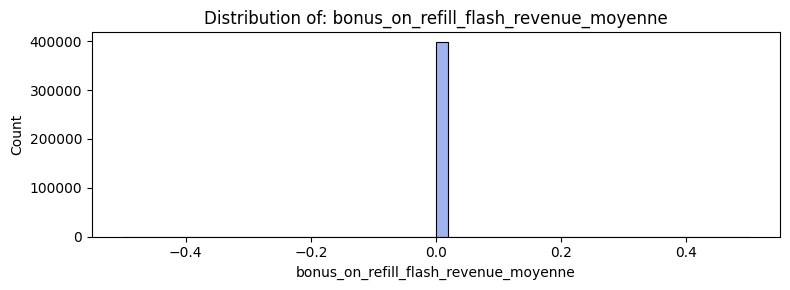

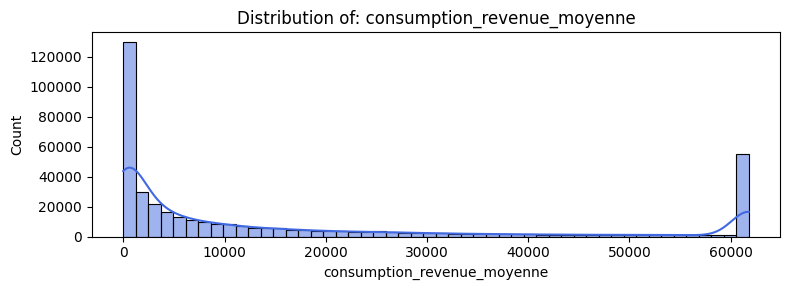

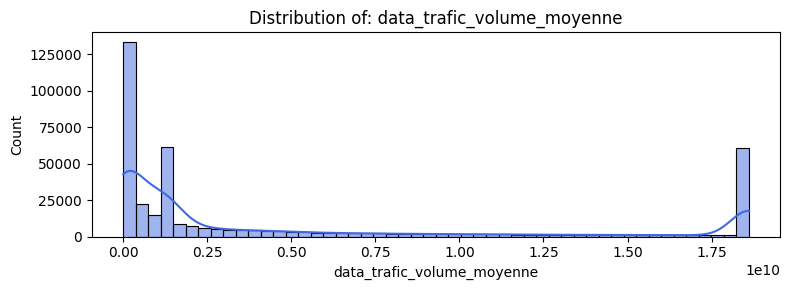

...

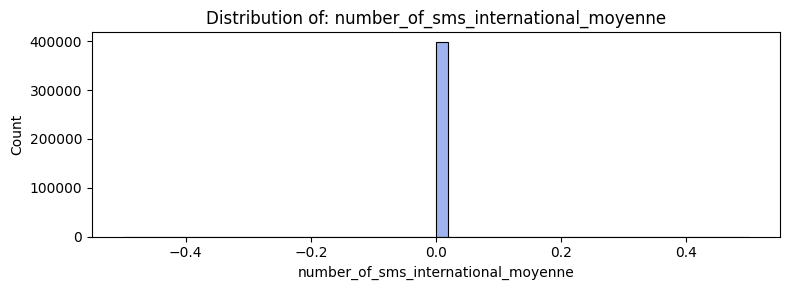

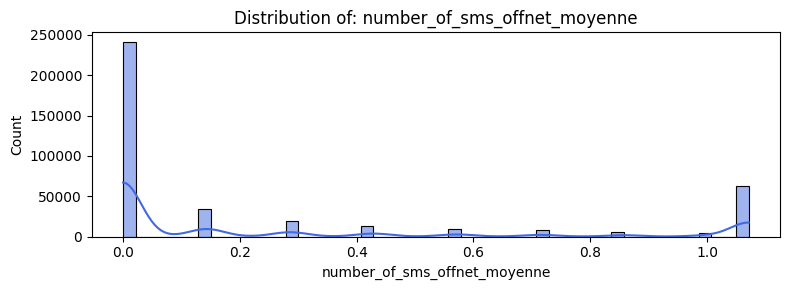

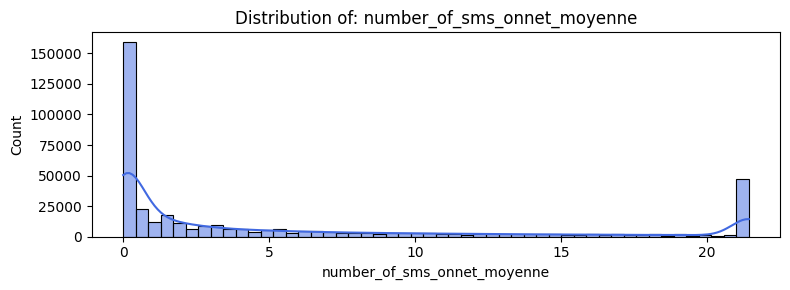

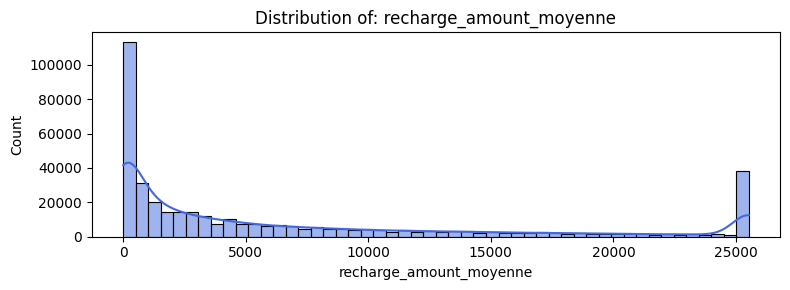

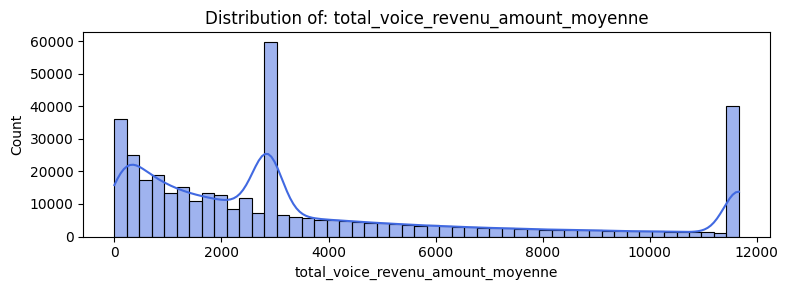

In [194]:
avg_cols = [col for col in final_df_encoded.columns if '_moyenne' in col or 'avg' in col or 'mean' in col]
for col in avg_cols:
    plt.figure(figsize=(8, 3))
    sns.histplot(final_df_encoded[col], bins=50, kde=True, color="royalblue", edgecolor="black")
    plt.title(f"Distribution of: {col}")
    plt.xlabel(col)
    plt.ylabel("Count")
    plt.tight_layout()
    plt.show()


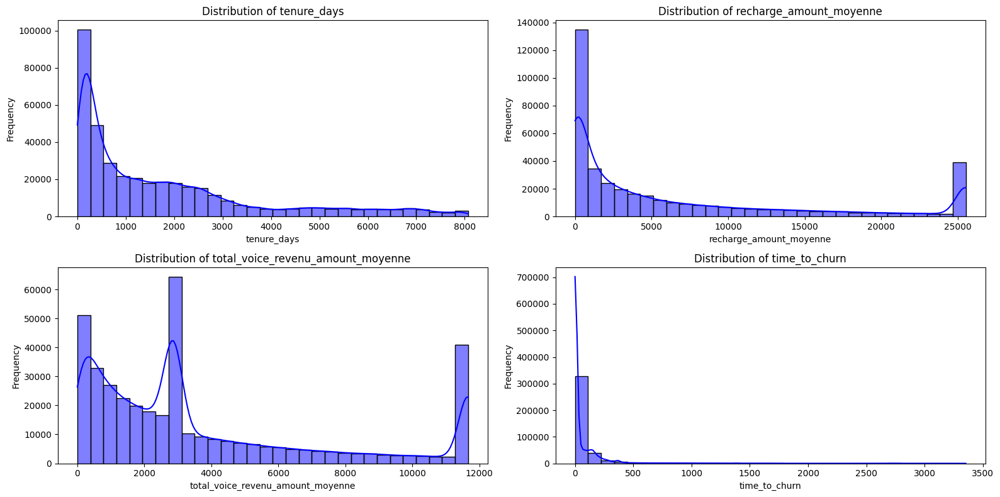

In [195]:
import matplotlib.pyplot as plt
import seaborn as sns

numerical_features = ['tenure_days', 'recharge_amount_moyenne', 'total_voice_revenu_amount_moyenne', 'time_to_churn']

plt.figure(figsize=(16, 8))  # Adapter la taille

for i, col in enumerate(numerical_features):
    plt.subplot(2, 2, i + 1)  # 2 lignes, 2 colonnes
    sns.histplot(final_df_encoded[col], bins=30, kde=True, color='blue')
    plt.title(f'Distribution of {col}')
    plt.xlabel(col)
    plt.ylabel('Frequency')

plt.tight_layout()
plt.show()


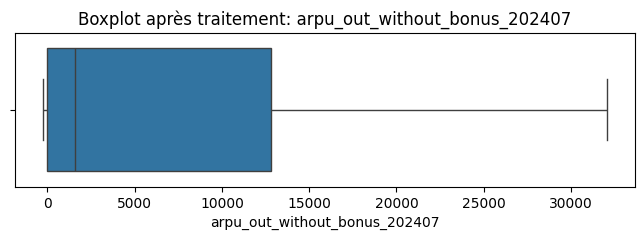

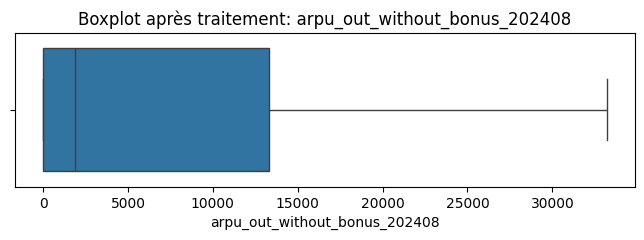

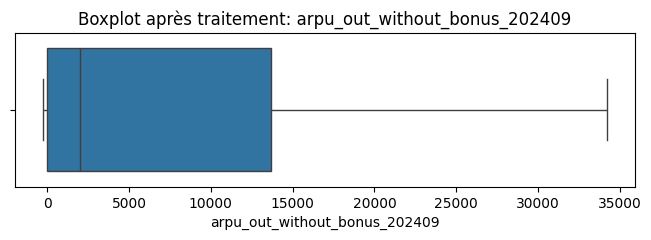

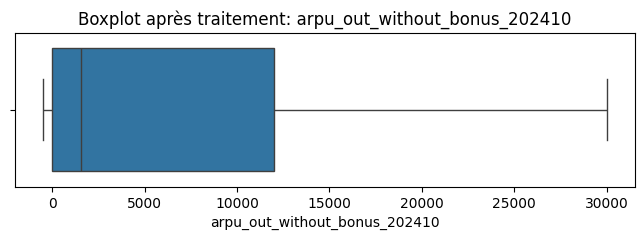

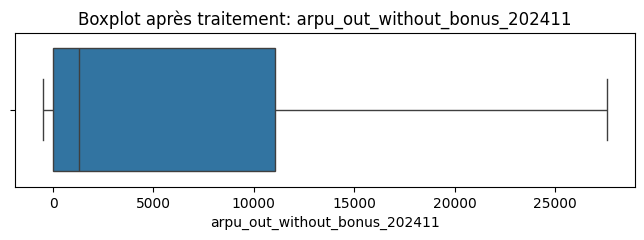

...

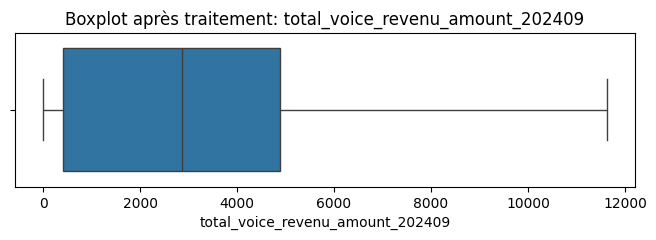

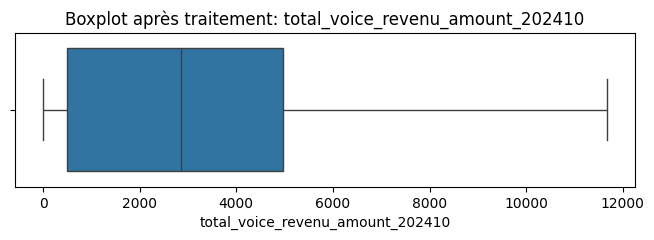

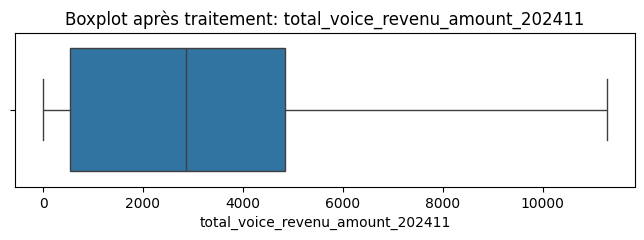

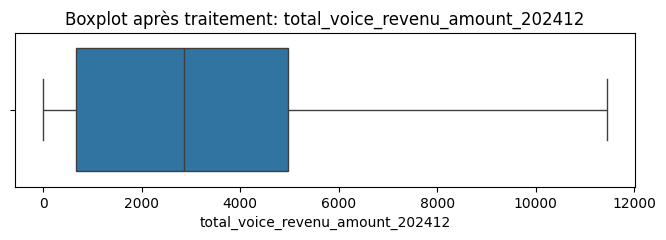

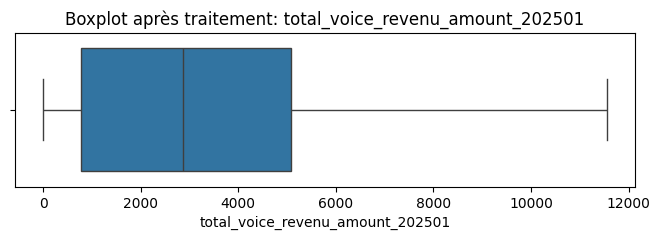

In [196]:
for col in final_df_per_period_encoded.select_dtypes(include=['float64']).columns:
    plt.figure(figsize=(8, 2))
    sns.boxplot(x=final_df_per_period_encoded[col])
    plt.title(f'Boxplot après traitement: {col}')
    plt.show()


C:\Users\Client\AppData\Local\Temp\ipykernel_14728\75265049.py:22: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  bin_stats = df_trait.groupby('bin').agg(


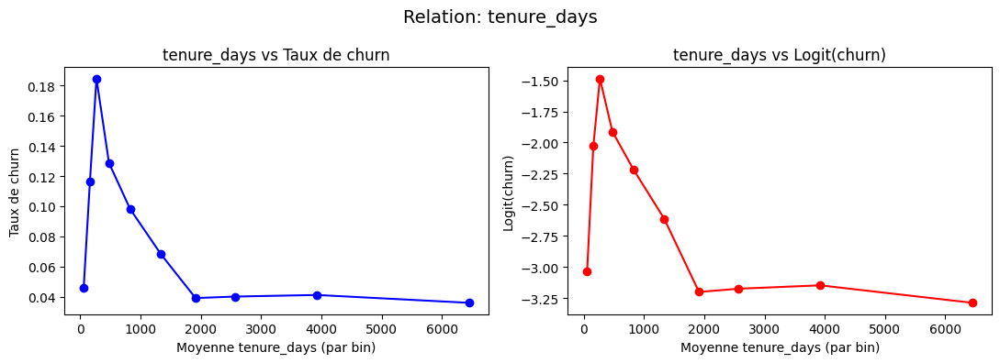

C:\Users\Client\AppData\Local\Temp\ipykernel_14728\75265049.py:22: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  bin_stats = df_trait.groupby('bin').agg(


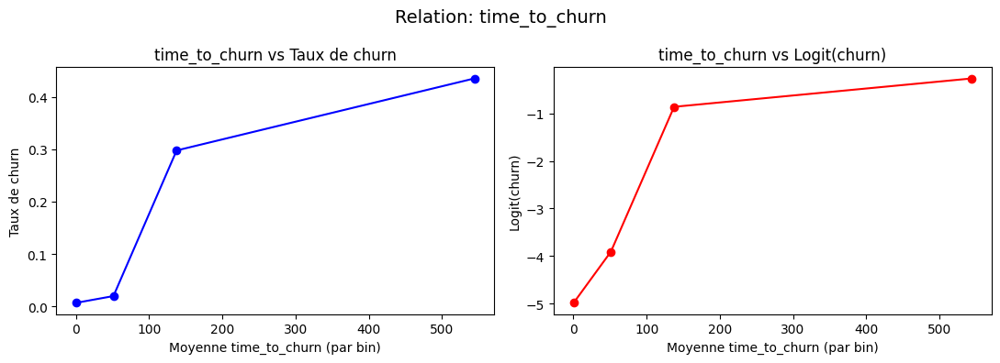

C:\Users\Client\AppData\Local\Temp\ipykernel_14728\75265049.py:22: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  bin_stats = df_trait.groupby('bin').agg(


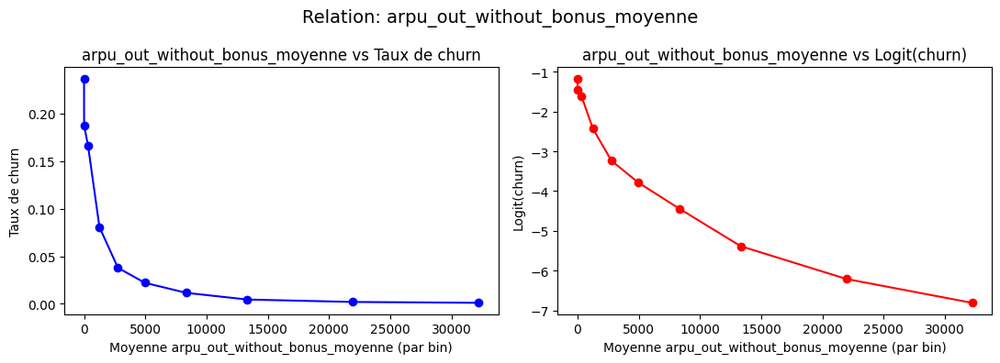

C:\Users\Client\AppData\Local\Temp\ipykernel_14728\75265049.py:22: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  bin_stats = df_trait.groupby('bin').agg(


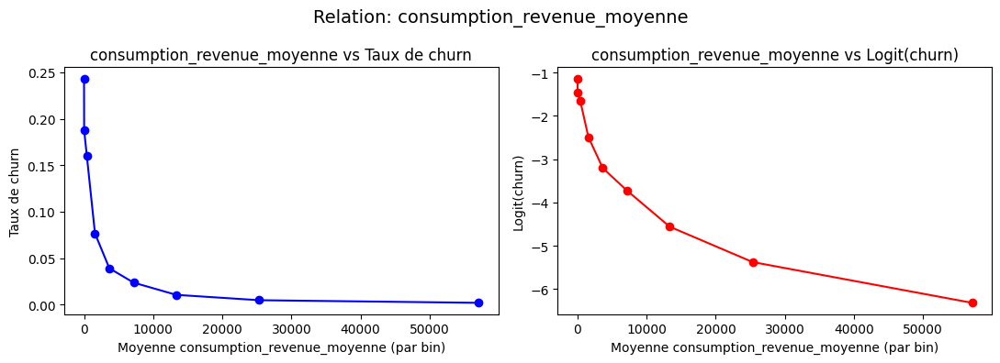

C:\Users\Client\AppData\Local\Temp\ipykernel_14728\75265049.py:22: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  bin_stats = df_trait.groupby('bin').agg(


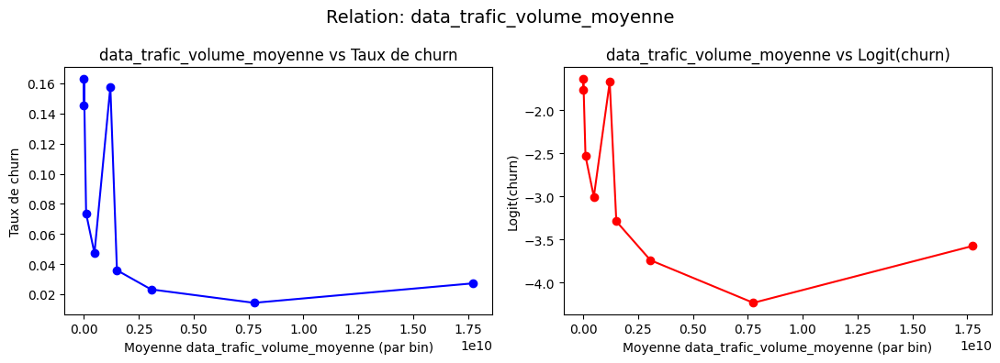

C:\Users\Client\AppData\Local\Temp\ipykernel_14728\75265049.py:22: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  bin_stats = df_trait.groupby('bin').agg(


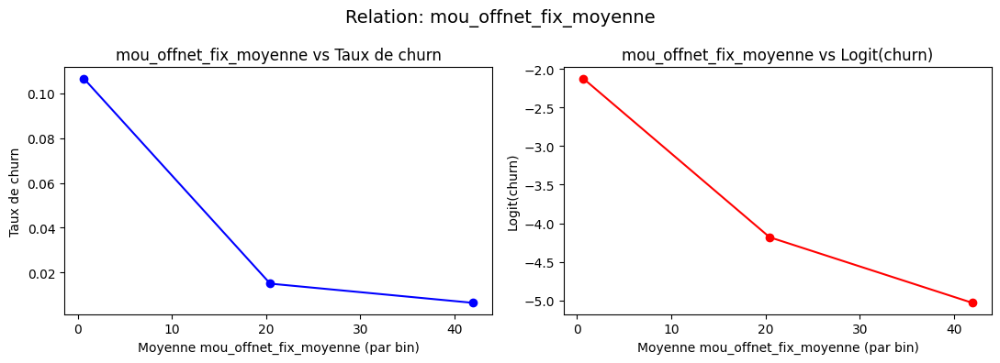

C:\Users\Client\AppData\Local\Temp\ipykernel_14728\75265049.py:22: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  bin_stats = df_trait.groupby('bin').agg(


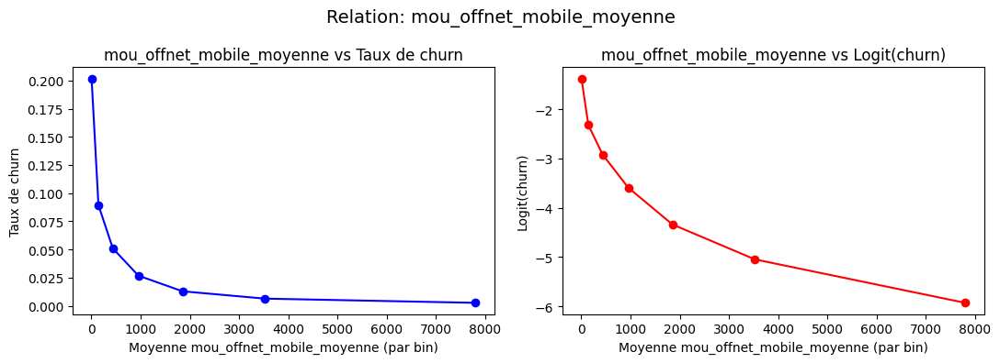

C:\Users\Client\AppData\Local\Temp\ipykernel_14728\75265049.py:22: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  bin_stats = df_trait.groupby('bin').agg(


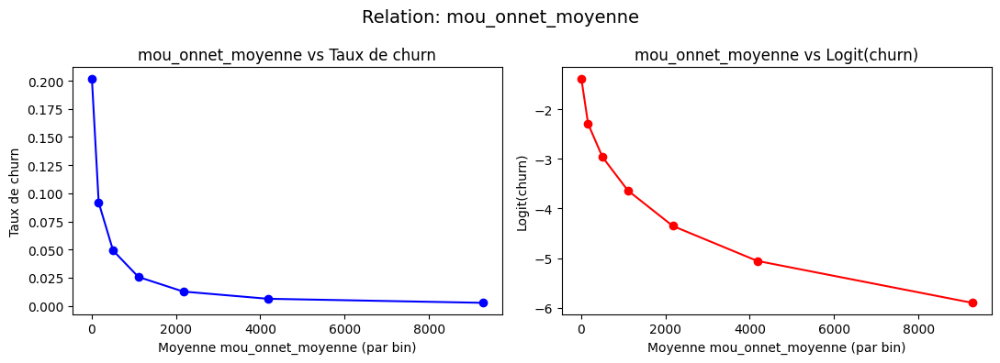

C:\Users\Client\AppData\Local\Temp\ipykernel_14728\75265049.py:22: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  bin_stats = df_trait.groupby('bin').agg(


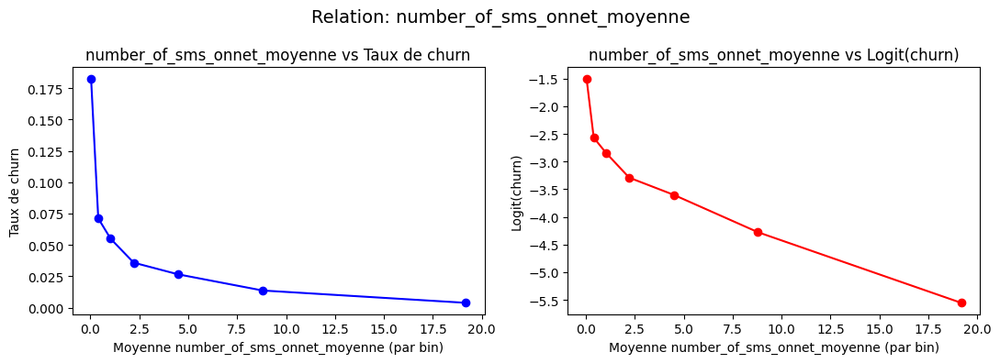

C:\Users\Client\AppData\Local\Temp\ipykernel_14728\75265049.py:22: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  bin_stats = df_trait.groupby('bin').agg(


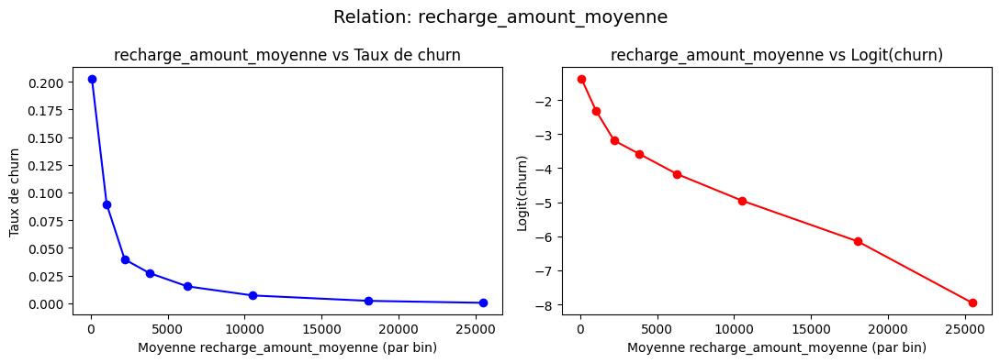

C:\Users\Client\AppData\Local\Temp\ipykernel_14728\75265049.py:22: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  bin_stats = df_trait.groupby('bin').agg(


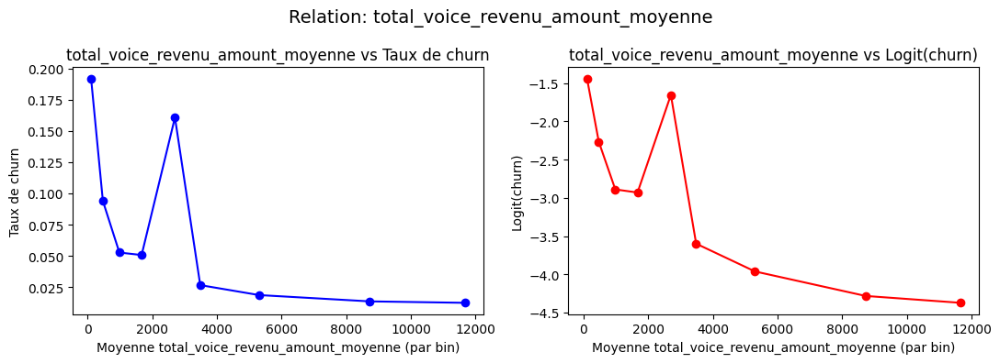

In [197]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# Garde uniquement les colonnes numériques sauf churn
num_cols = final_df_encoded.select_dtypes(include=[np.number]).columns.drop(['churn'])

for X_name in num_cols:
    df_trait = final_df_encoded[[X_name, 'churn']].copy().dropna()

    # Si toute la colonne = constante, skip
    if df_trait[X_name].nunique() < 10:
        continue

    # Création des bins (quantiles)
    try:
        df_trait['bin'] = pd.qcut(df_trait[X_name], q=10, duplicates='drop')
    except:
        continue

    # Calcul stats par bin
    bin_stats = df_trait.groupby('bin').agg(
        moyenne_X = (X_name, 'mean'),
        taux_churn = ('churn', 'mean')
    ).reset_index()
    bin_stats['logit_churn'] = np.log(bin_stats['taux_churn'] / (1 - bin_stats['taux_churn'] + 1e-5))

    # Plot 1: Taux de churn
    plt.figure(figsize=(11,4))
    plt.subplot(1,2,1)
    plt.plot(bin_stats['moyenne_X'], bin_stats['taux_churn'], marker='o', color='blue')
    plt.xlabel(f'Moyenne {X_name} (par bin)')
    plt.ylabel('Taux de churn')
    plt.title(f'{X_name} vs Taux de churn')

    # Plot 2: Logit du churn
    plt.subplot(1,2,2)
    plt.plot(bin_stats['moyenne_X'], bin_stats['logit_churn'], marker='o', color='red')
    plt.xlabel(f'Moyenne {X_name} (par bin)')
    plt.ylabel('Logit(churn)')
    plt.title(f'{X_name} vs Logit(churn)')

    plt.suptitle(f'Relation: {X_name}', fontsize=14)
    plt.tight_layout()
    plt.show()


Conséquence pour la régression logistique :

Hypothèse de linéarité non respectée → je peux transformer cette variable (ex : log, binning, ou spline/polynomial).

Si je passes en log-transformée (log1p), je peux regénérer le même graphe pour voir si la relation devient plus linéaire.



In [192]:
import numpy as np
import pandas as pd
from sklearn.preprocessing import PowerTransformer, QuantileTransformer, StandardScaler
from scipy.stats import shapiro, skew, kurtosis
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings("ignore")
import re

# ------------------ Config ------------------
methods = ['none', 'log', 'sqrt', 'box-cox', 'yeo-johnson', 'quantile', 'zscore', 'minmax']

# ------------------ Transformation Function ------------------
def apply_transform_col(values, method):
    values = values.values.astype(float).reshape(-1, 1)
    if method == 'log':
        values = np.log1p(np.clip(values, 0, None))
    elif method == 'sqrt':
        values = np.sqrt(np.clip(values, 0, None))
    elif method == 'yeo-johnson':
        values = PowerTransformer(method='yeo-johnson').fit_transform(values)
    elif method == 'box-cox':
        values = np.clip(values, 1e-4, None)
        values = PowerTransformer(method='box-cox').fit_transform(values)
    elif method == 'quantile':
        values = QuantileTransformer(output_distribution='normal', random_state=42).fit_transform(values)
    elif method == 'zscore':
        values = StandardScaler().fit_transform(values)
    elif method == 'minmax':
        from sklearn.preprocessing import MinMaxScaler
        values = MinMaxScaler().fit_transform(values)
    
    return values.flatten()

# ------------------ Evaluation Function ------------------
def evaluate_method_columnwise(df, cols, method):
    pvals, skews, kurts = [], [], []
    for col in cols:
        col_data = df[col].dropna()
        if col_data.std() == 0:
            continue
        try:
            transformed = apply_transform_col(col_data, method)
            stat, p = shapiro(transformed[:5000])
            pvals.append(p)
            skews.append(skew(transformed))
            kurts.append(kurtosis(transformed))
        except:
            continue
    return {
        'method': method,
        'mean_shapiro_p': np.mean(pvals) if pvals else 0,
        'mean_skew': np.mean(np.abs(skews)) if skews else np.nan,
        'mean_kurtosis': np.mean(np.abs(np.array(kurts) - 3)) if kurts else np.nan
    }

# ------------------ Scoring Function ------------------
def score_method(row):
    # Combine criteria: high p-value, low skewness, low distance from normal kurtosis
    # You can adjust the weights below
    score = (
        0.5 * row['mean_shapiro_p'] -  # high p is good
        0.25 * row['mean_skew'] -      # low skew is good
        0.25 * row['mean_kurtosis']    # low deviation from 3 is good
    )
    return score

# ------------------ Main ------------------
prefixes = set(re.sub(r'_\d{6}$', '', col) for col in final_df_per_period_encoded.columns if re.search(r'_\d{6}$', col))
best_methods = {}
transformed_data_per_period = final_df_per_period_encoded.copy()

for prefix in prefixes:
    cols = [col for col in final_df_per_period_encoded.columns if col.startswith(prefix)]
    if len(cols) < 2:
        continue

    print(f"\n🔍 Evaluating group: {prefix}")
    results = []
    for method in methods:
        result = evaluate_method_columnwise(final_df_per_period_encoded, cols, method)
        results.append(result)

    results_df = pd.DataFrame(results)
    results_df['score'] = results_df.apply(score_method, axis=1)
    results_df = results_df.sort_values(by='score', ascending=False)
    print(results_df[['method', 'mean_shapiro_p', 'mean_skew', 'mean_kurtosis', 'score']].round(4))

    best_method = results_df.iloc[0]['method']
    best_methods[prefix] = best_method
    print(f"✅ Best method for {prefix}: {best_method}")

    # Apply best transformation column-wise
    for col in cols:
        original_col = final_df_per_period_encoded[col]
        transformed_col = pd.Series(index=original_col.index, dtype=float)

        # Appliquer uniquement sur les valeurs non manquantes
        non_null_values = original_col.dropna()
        transformed_values = apply_transform_col(non_null_values, best_method)

        # Réintégrer les valeurs transformées à leurs bons indices
        transformed_col.loc[non_null_values.index] = transformed_values

        # Affecter la colonne complète transformée
        transformed_data_per_period[col] = transformed_col

# ------------------ Summary ------------------
print("\n📌 Best methods per group:")
for prefix, method in best_methods.items():
    print(f"{prefix}: {method}")



🔍 Evaluating group: bonus_on_consumption_revenue
        method  mean_shapiro_p  mean_skew  mean_kurtosis  score
0         none               0        NaN            NaN    NaN
1          log               0        NaN            NaN    NaN
2         sqrt               0        NaN            NaN    NaN
3      box-cox               0        NaN            NaN    NaN
4  yeo-johnson               0        NaN            NaN    NaN
5     quantile               0        NaN            NaN    NaN
6       zscore               0        NaN            NaN    NaN
7       minmax               0        NaN            NaN    NaN
✅ Best method for bonus_on_consumption_revenue: none

🔍 Evaluating group: data_trafic_volume
        method  mean_shapiro_p  mean_skew  mean_kurtosis   score
5     quantile             0.0     1.7029         1.8144 -0.8793
1          log             0.0     1.0981         3.0215 -1.0299
6       zscore             0.0     1.1989         3.3108 -1.1274
7       minmax       

In [199]:
for col in final_df_per_period_encoded.columns:
    print(col)

churn
original_operator
dat_remb_kridi_net
tenure_days
has_international_call
time_to_churn
flag_smartphone
arpu_out_without_bonus_202407
arpu_out_without_bonus_202408
arpu_out_without_bonus_202409
arpu_out_without_bonus_202410
arpu_out_without_bonus_202411
arpu_out_without_bonus_202412
arpu_out_without_bonus_202501
bonus_on_consumption_revenue_202407
bonus_on_consumption_revenue_202408
bonus_on_consumption_revenue_202409
bonus_on_consumption_revenue_202410
bonus_on_consumption_revenue_202411
bonus_on_consumption_revenue_202412
bonus_on_consumption_revenue_202501
bonus_on_refill_flash_revenue_202407
bonus_on_refill_flash_revenue_202408
bonus_on_refill_flash_revenue_202409
bonus_on_refill_flash_revenue_202410
bonus_on_refill_flash_revenue_202411
bonus_on_refill_flash_revenue_202412
bonus_on_refill_flash_revenue_202501
consumption_revenue_202407
consumption_revenue_202408
consumption_revenue_202409
consumption_revenue_202410
consumption_revenue_202411
consumption_revenue_202412
consumpti

In [196]:
import pandas as pd
from sklearn.preprocessing import StandardScaler, MinMaxScaler, QuantileTransformer

# Chargement du DataFrame supposé déjà disponible sous le nom final_df_per_period_encoded
# df = final_df_per_period_encoded.copy()  # Utilisé en environnement réel

# Définition des méthodes recommandées pour chaque groupe de variable
best_methods = {
    "mou_offnet_mobile": "minmax",
    "consumption_revenue": "none",
    "mou_offnet_fix": "none",
    "total_voice_revenu_amount": "quantile",
    "number_of_sms_onnet": "none",
    "number_of_reactivations": "none",
    "bonus_on_consumption_revenue": "none",
    "arpu_out_without_bonus": "none",
    "number_of_sms_offnet": "none",
    "mou_international": "none",
    "mou_onnet": "none",
    "number_of_recharges": "zscore",
    "number_of_sms_international": "none",
    "data_trafic_volume": "quantile",
    "bonus_on_refill_flash_revenue": "none"
}

# Application du prétraitement
df_transformed_per_period = final_df_per_period_encoded.copy()

for base_col, method in best_methods.items():
    matching_cols = [col for col in df_transformed_per_period.columns if col.startswith(base_col + "_")]
    if not matching_cols or method == "none":
        continue

    if method == "zscore":
        scaler = StandardScaler()
    elif method == "minmax":
        scaler = MinMaxScaler()
    elif method == "quantile":
        scaler = QuantileTransformer(output_distribution="normal", random_state=42)
    else:
        continue

    df_transformed_per_period[matching_cols] = scaler.fit_transform(df_transformed_per_period[matching_cols])

In [201]:
df_transformed_per_period

,churn,original_operator,dat_remb_kridi_net,tenure_days,has_international_call,time_to_churn,flag_smartphone,arpu_out_without_bonus_202407,arpu_out_without_bonus_202408,arpu_out_without_bonus_202409,...,marital_status_Celibataire,marital_status_Divorce,marital_status_Marie,marital_status_Veuf,gender_F,gender_M,customer_language_Anglais,customer_language_Arabe,customer_language_Francais,customer_language_Italien
0,0,1,0,0,0,0,1,0.0,0.0,0.0,...,1,0,0,0,0,1,0,0,1,0
1,0,1,0,38,0,33,1,0.0,0.0,0.0,...,1,0,0,0,0,1,1,0,0,0
2,0,1,0,24,0,24,0,0.0,0.0,0.0,...,1,0,0,0,0,1,0,1,0,0
3,0,1,0,38,0,0,1,0.0,0.0,0.0,...,1,0,0,0,1,0,0,1,0,0
4,0,1,0,37,0,0,1,0.0,0.0,0.0,...,1,0,0,0,0,1,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
398401,1,1,1,2364,0,610,1,0.0,0.0,0.0,...,1,0,0,0,1,0,1,0,0,0
398402,1,1,1,2136,0,296,1,0.0,0.0,0.0,...,1,0,0,0,1,0,1,0,0,0
398403,1,1,0,4365,0,247,1,0.0,0.0,0.0,...,1,0,0,0,0,1,0,0,1,0
398404,1,1,1,5343,0,98,1,0.0,0.0,0.0,...,1,0,0,0,0,1,1,0,0,0


### test parametrique

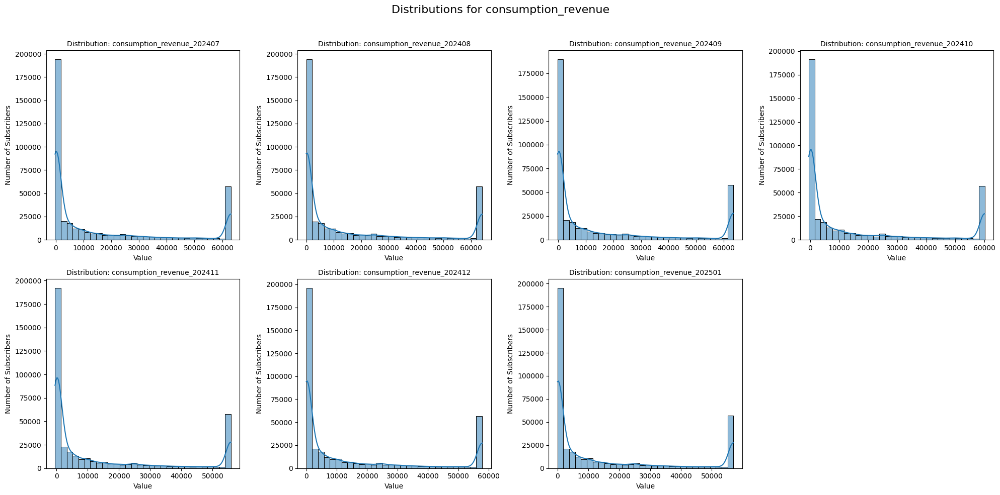

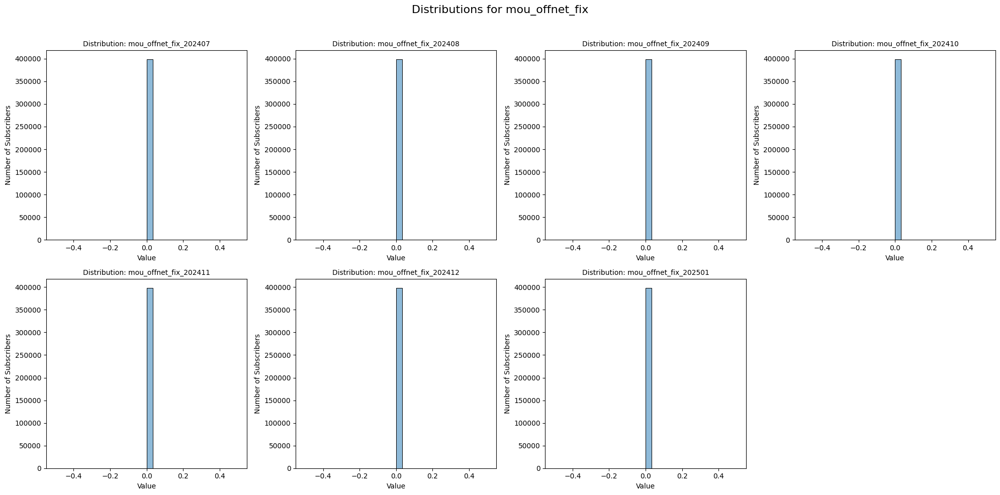

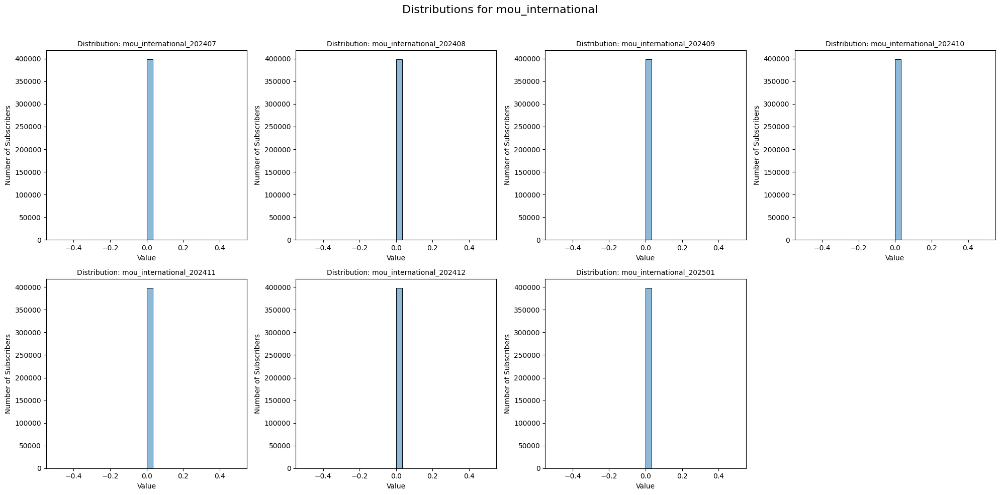

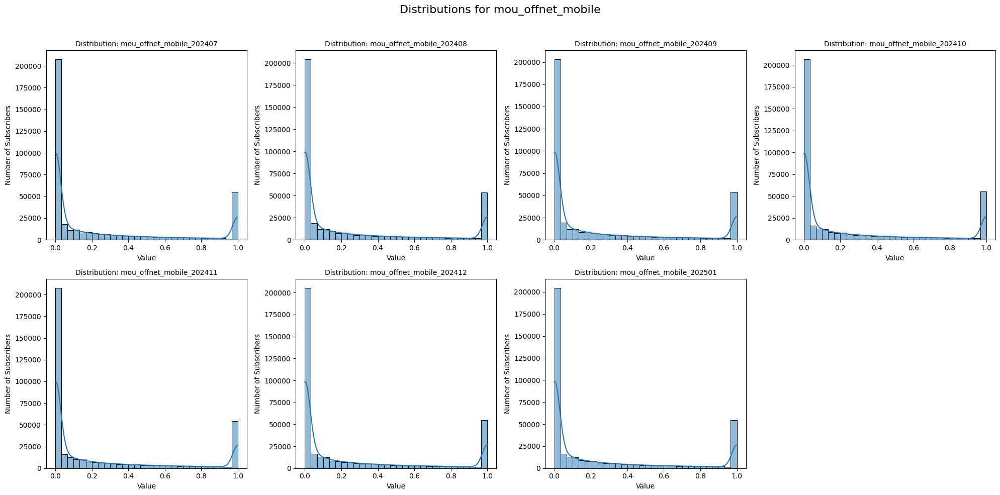

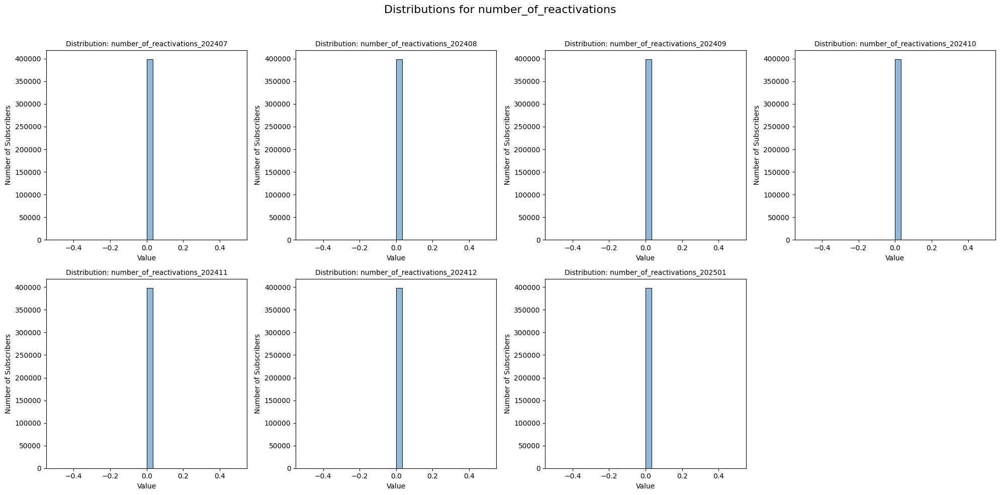

...

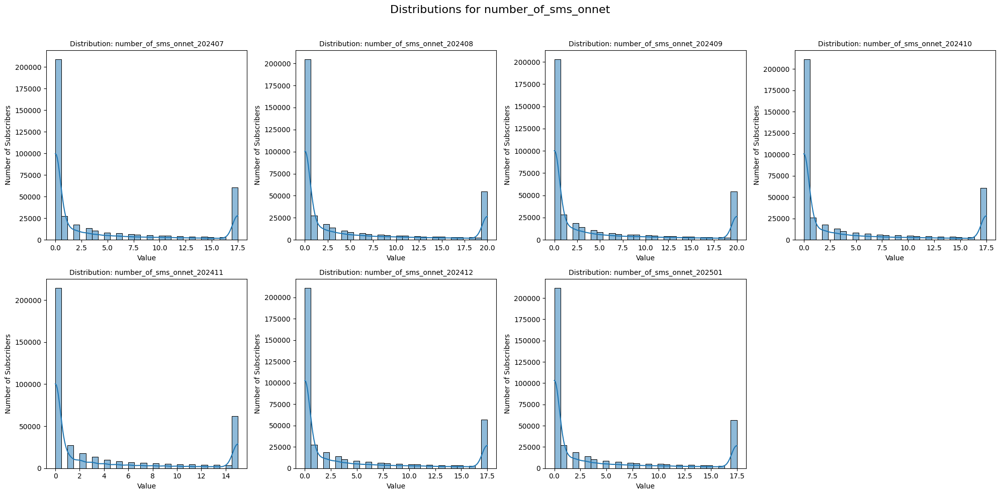

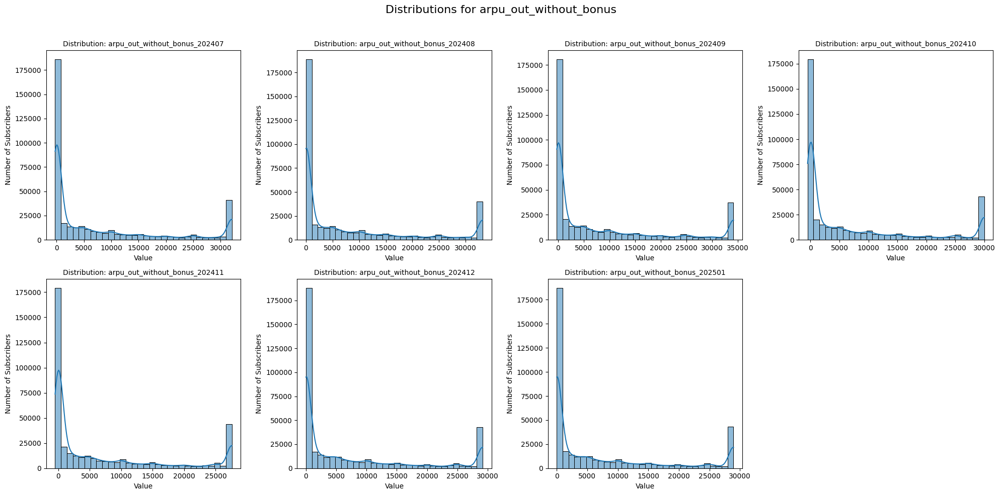

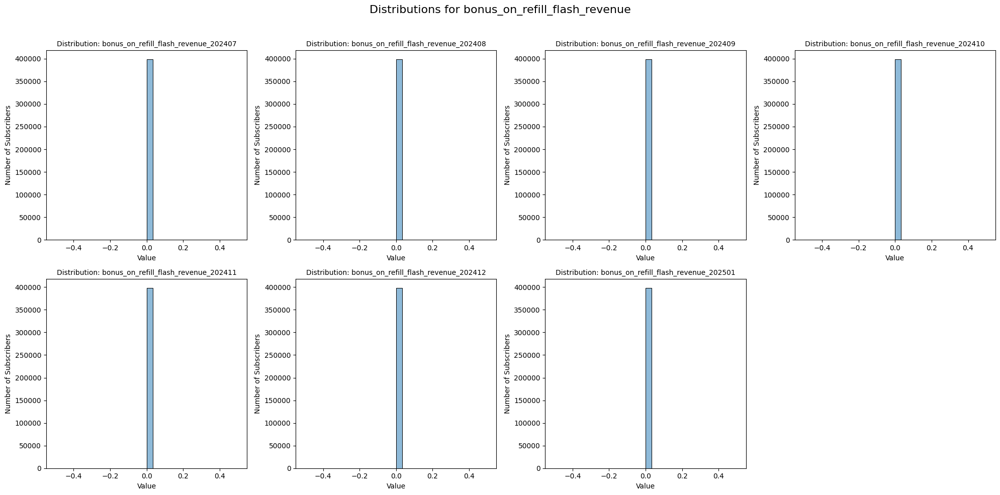

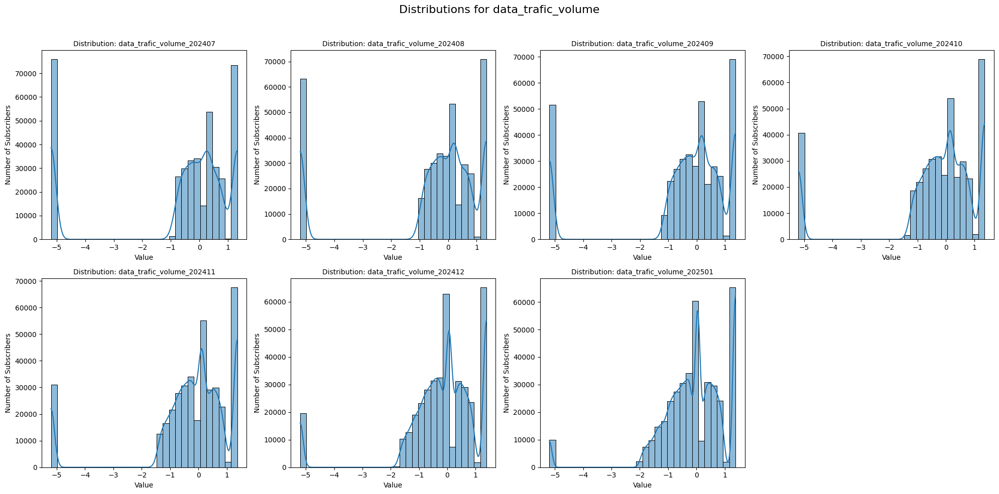

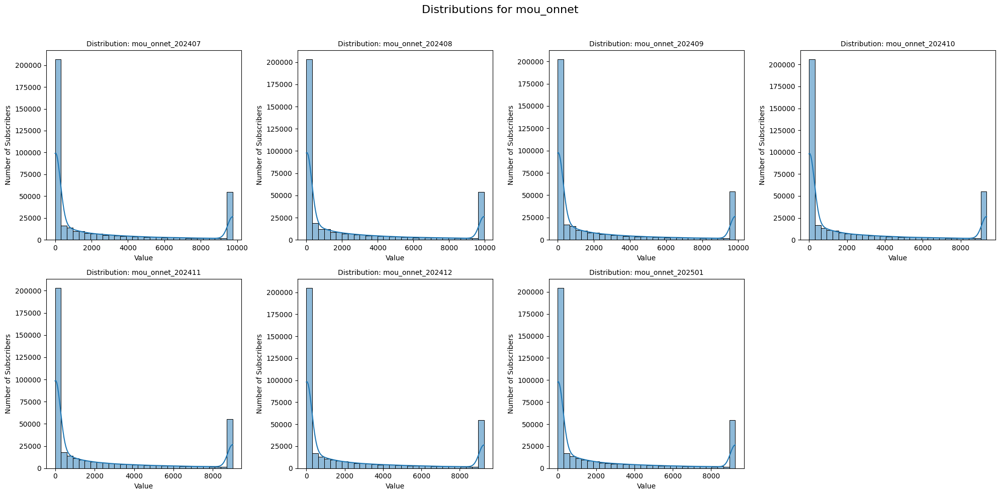

In [202]:
import matplotlib.pyplot as plt
import seaborn as sns
import re

prefixes = set(re.sub(r'_\d{6}$', '', col) for col in df_transformed_per_period.columns if re.search(r'_\d{6}$', col))

# Step 2: For each prefix (like mou_onnet, consumption_revenue, etc.)
for prefix in prefixes:
    # Select all columns for that feature
    cols = [col for col in df_transformed_per_period.columns if col.startswith(prefix)]
    
    if cols:
        # Create subplots
        n_cols = 4  # 4 plots per row
        n_rows = (len(cols) + n_cols - 1) // n_cols
        
        fig, axes = plt.subplots(n_rows, n_cols, figsize=(20, 5 * n_rows))
        axes = axes.flatten()

        for idx, col in enumerate(cols):
            sns.histplot(df_transformed_per_period[col], kde=True, ax=axes[idx], bins=30)
            axes[idx].set_title(f'Distribution: {col}', fontsize=10)
            axes[idx].set_xlabel('Value')
            axes[idx].set_ylabel('Number of Subscribers')

        # Hide any empty plots
        for idx in range(len(cols), len(axes)):
            fig.delaxes(axes[idx])

        plt.suptitle(f'Distributions for {prefix}', fontsize=16)
        plt.tight_layout(rect=[0, 0, 1, 0.96])
        plt.show()


In [203]:
import numpy as np
import pandas as pd
from sklearn.preprocessing import PowerTransformer, QuantileTransformer, StandardScaler, MinMaxScaler
from scipy.stats import shapiro, skew, kurtosis
import warnings
warnings.filterwarnings("ignore")

methods = ['none', 'log', 'sqrt', 'box-cox', 'yeo-johnson', 'quantile', 'zscore', 'minmax']

def apply_transform_col(values, method):
    values = values.values.astype(float).reshape(-1, 1)
    if method == 'log':
        values = np.log1p(np.clip(values, 0, None))
    elif method == 'sqrt':
        values = np.sqrt(np.clip(values, 0, None))
    elif method == 'yeo-johnson':
        values = PowerTransformer(method='yeo-johnson').fit_transform(values)
    elif method == 'box-cox':
        values = np.clip(values, 1e-4, None)
        values = PowerTransformer(method='box-cox').fit_transform(values)
    elif method == 'quantile':
        values = QuantileTransformer(output_distribution='normal', random_state=42).fit_transform(values)
    elif method == 'zscore':
        values = StandardScaler().fit_transform(values)
    elif method == 'minmax':
        values = MinMaxScaler().fit_transform(values)
    else:
        values = values.flatten()
        return values
    return values.flatten()

def evaluate_method_columnwise(df, col, method):
    pvals, skews, kurts = [], [], []
    col_data = df[col].dropna()
    if col_data.std() == 0:
        return None
    try:
        transformed = apply_transform_col(col_data, method)
        stat, p = shapiro(transformed[:5000])  # Limit size for speed
        return {
            'method': method,
            'mean_shapiro_p': p,
            'mean_skew': abs(skew(transformed)),
            'mean_kurtosis': abs(kurtosis(transformed) - 3)
        }
    except Exception:
        return None

def score_method(row):
    return 0.5 * row['mean_shapiro_p'] - 0.25 * row['mean_skew'] - 0.25 * row['mean_kurtosis']

transformed_data_moyenne = final_df_encoded.copy()
moyenne_cols = [col for col in transformed_data_moyenne.columns if col.endswith('_moyenne')]

best_methods_per_col = []

for col in moyenne_cols:
    results = []
    for method in methods:
        res = evaluate_method_columnwise(transformed_data_moyenne, col, method)
        if res:
            results.append(res)
    if results:
        results_df = pd.DataFrame(results)
        results_df['score'] = results_df.apply(score_method, axis=1)
        best_method = results_df.sort_values(by='score', ascending=False).iloc[0]
        best_methods_per_col.append({
            'column': col,
            'best_method': best_method['method'],
            'score': best_method['score'],
            'mean_shapiro_p': best_method['mean_shapiro_p'],
            'mean_skew': best_method['mean_skew'],
            'mean_kurtosis': best_method['mean_kurtosis']
        })

best_methods_df = pd.DataFrame(best_methods_per_col)
print(best_methods_df.sort_values(by='score', ascending=False))


                              column best_method     score  mean_shapiro_p  \
9  total_voice_revenu_amount_moyenne    quantile -0.470591    8.172136e-62   
2         data_trafic_volume_moyenne         log -0.539743    4.730586e-62   
0     arpu_out_without_bonus_moyenne    quantile -0.759406    2.758446e-69   
1        consumption_revenue_moyenne    quantile -0.782735    9.956544e-70   
8            recharge_amount_moyenne    quantile -0.846479    8.994220e-70   
5                  mou_onnet_moyenne    quantile -0.857549    7.394355e-68   
4          mou_offnet_mobile_moyenne    quantile -0.868225    6.649854e-68   
7        number_of_sms_onnet_moyenne    quantile -0.874969    7.634714e-69   
6       number_of_sms_offnet_moyenne      zscore -1.102716    3.539916e-86   
3             mou_offnet_fix_moyenne      minmax -1.129357    1.885667e-88   

   mean_skew  mean_kurtosis  
9   1.557382       0.324982  
2   1.698213       0.460759  
0   0.267321       2.770304  
1   0.058825       3.

In [130]:
# Copie du DataFrame original
transformed_data_moyenne = final_df_encoded.copy()
# Dictionnaire des meilleures méthodes obtenu (extrait de ton DataFrame best_methods_df)
best_methods_dict = {
    'mou_onnet_moyenne': 'quantile',
    'consumption_revenue_moyenne': 'quantile',
    'data_trafic_volume_moyenne': 'log ',
    'mou_offnet_mobile_moyenne': 'quantile',
    'total_voice_revenu_amount_moyenne': 'quantile',
    'number_of_sms_onnet_moyenne': 'quantile',
    'recharge_amount_moyenne': 'quantile',
    'arpu_out_without_bonus_moyenne': 'quantile',
    'mou_offnet_fix_moyenne': 'minmax ',
    'number_of_sms_offnet_moyenne': 'zscore '}

# Fonction d'application de transformation (même que précédemment)
def apply_transform_col(values, method):
    values = values.values.astype(float).reshape(-1, 1)
    if method == 'log':
        values = np.log1p(np.clip(values, 0, None))
    elif method == 'sqrt':
        values = np.sqrt(np.clip(values, 0, None))
    elif method == 'yeo-johnson':
        values = PowerTransformer(method='yeo-johnson').fit_transform(values)
    elif method == 'box-cox':
        values = np.clip(values, 1e-4, None)
        values = PowerTransformer(method='box-cox').fit_transform(values)
    elif method == 'quantile':
        values = QuantileTransformer(output_distribution='normal', random_state=42).fit_transform(values)
    elif method == 'zscore':
        values = StandardScaler().fit_transform(values)
    elif method == 'minmax':
        values = MinMaxScaler().fit_transform(values)
    else:  # none or unknown
        return values.flatten()
    return values.flatten()

# Application des transformations colonne par colonne
for col, method in best_methods_dict.items():
    if col in transformed_data_moyenne.columns:
        original_col = transformed_data_moyenne[col]
        transformed_col = pd.Series(index=original_col.index, dtype=float)

        non_null_values = original_col.dropna()
        transformed_values = apply_transform_col(non_null_values, method)
        transformed_col.loc[non_null_values.index] = transformed_values

        transformed_data_moyenne[col] = transformed_col

# transformed_moyenne_data contient maintenant les colonnes moyennes transformées


In [205]:
transformed_data_moyenne

,churn,original_operator,dat_remb_kridi_net,tenure_days,has_international_call,time_to_churn,flag_smartphone,arpu_out_without_bonus_moyenne,bonus_on_consumption_revenue_moyenne,bonus_on_refill_flash_revenue_moyenne,...,marital_status_Celibataire,marital_status_Divorce,marital_status_Marie,marital_status_Veuf,gender_F,gender_M,customer_language_Anglais,customer_language_Arabe,customer_language_Francais,customer_language_Italien
0,0,1,0,0,0,0,1,0.006255,0.0,0.0,...,1,0,0,0,0,1,0,0,1,0
1,0,1,0,38,0,33,1,-0.591623,0.0,0.0,...,1,0,0,0,0,1,1,0,0,0
2,0,1,0,24,0,24,0,-0.802226,0.0,0.0,...,1,0,0,0,0,1,0,1,0,0
3,0,1,0,38,0,0,1,-0.193903,0.0,0.0,...,1,0,0,0,1,0,0,1,0,0
4,0,1,0,37,0,0,1,-5.199338,0.0,0.0,...,1,0,0,0,0,1,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
398401,1,1,1,2364,0,610,1,-5.199338,0.0,0.0,...,1,0,0,0,1,0,1,0,0,0
398402,1,1,1,2136,0,296,1,-5.199338,0.0,0.0,...,1,0,0,0,1,0,1,0,0,0
398403,1,1,0,4365,0,247,1,-5.199338,0.0,0.0,...,1,0,0,0,0,1,0,0,1,0
398404,1,1,1,5343,0,98,1,-0.826698,0.0,0.0,...,1,0,0,0,0,1,1,0,0,0


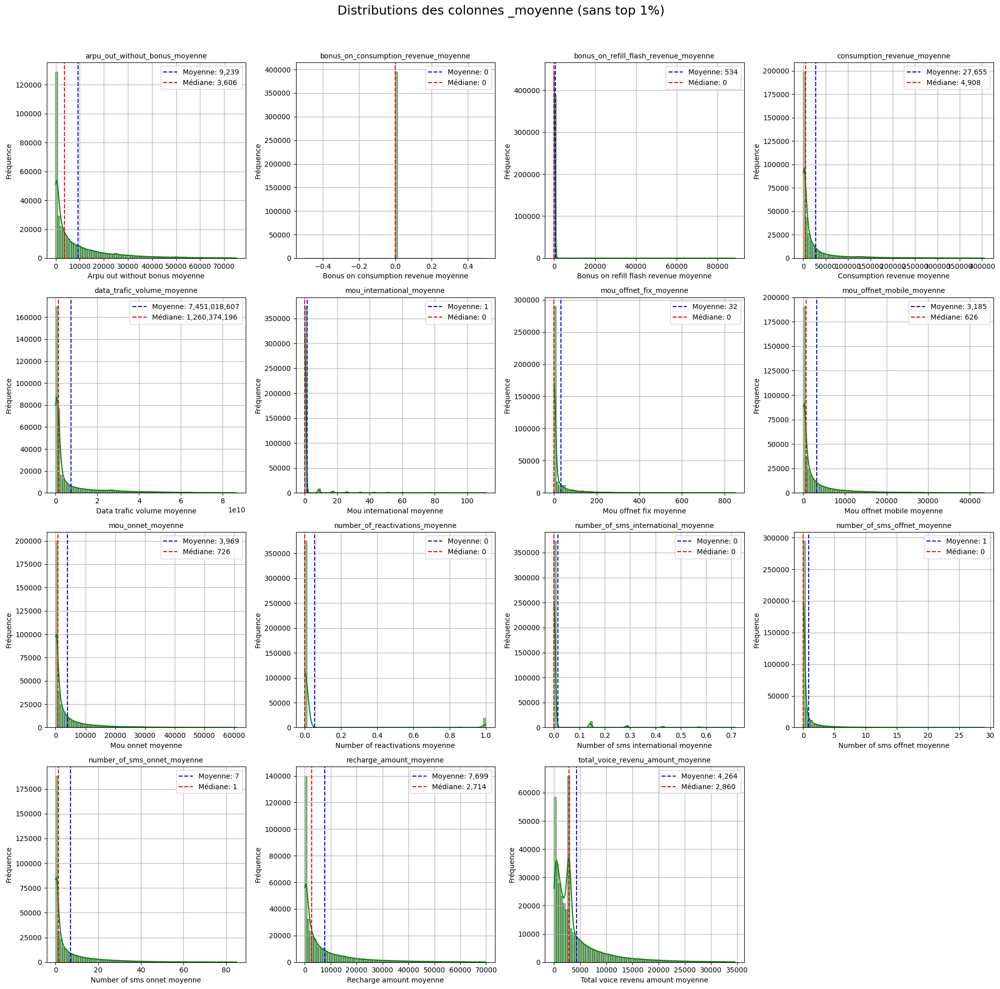

In [206]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# 1. Obtenir toutes les colonnes _moyenne
moyenne_cols = [col for col in final_df.columns if col.endswith('_moyenne')]

if moyenne_cols:
    # 2. Paramètres pour les subplots
    n_cols = 4  # 4 plots par ligne
    n_rows = (len(moyenne_cols) + n_cols - 1) // n_cols
    
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(20, 5 * n_rows))
    axes = axes.flatten()

    for idx, col in enumerate(moyenne_cols):
        data = final_df[col].copy()

        # 3. Supprimer le top 1% des valeurs (outliers)
        threshold = np.percentile(data.dropna(), 99)
        filtered_data = data[data <= threshold]

        # 4. Tracer l'histogramme avec KDE
        sns.histplot(filtered_data, bins=80, kde=True, color='green', edgecolor='black', ax=axes[idx])

        # 5. Moyenne et médiane
        mean_val = filtered_data.mean()
        median_val = filtered_data.median()
        axes[idx].axvline(mean_val, color='blue', linestyle='dashed', linewidth=1.5, label=f'Moyenne: {mean_val:,.0f}')
        axes[idx].axvline(median_val, color='red', linestyle='dashed', linewidth=1.5, label=f'Médiane: {median_val:,.0f}')

        # 6. Légendes et titres
        axes[idx].set_title(f'{col}', fontsize=10)
        axes[idx].set_xlabel(col.replace('_', ' ').capitalize())
        axes[idx].set_ylabel('Fréquence')
        axes[idx].legend()
        axes[idx].grid(True)

    # 7. Supprimer les sous-graphiques inutilisés
    for idx in range(len(moyenne_cols), len(axes)):
        fig.delaxes(axes[idx])

    plt.suptitle(f'Distributions des colonnes _moyenne (sans top 1%)', fontsize=18)
    plt.tight_layout(rect=[0, 0, 1, 0.96])
    plt.show()


In [207]:
import pandas as pd
import pingouin as pg

# Convert churn to categorical
transformed_data_moyenne['churn'] = transformed_data_moyenne['churn'].astype('category')

# Select avg columns
moyenne_cols = [col for col in transformed_data_moyenne.columns if col.endswith('_moyenne')]

# Create an empty list to store results
results = []

# Loop over avg columns and compute eta squared
for col in moyenne_cols:
    try:
        aov = pg.anova(dv=col, between='churn', data=transformed_data_moyenne, detailed=True)
        eta_sq = aov.loc[0, 'np2']  # np2 = partial eta squared
        results.append({'feature': col, 'eta_squared': eta_sq})
    except Exception as e:
        print(f"Error with column {col}: {e}")

# Create a DataFrame from the results
eta_df = pd.DataFrame(results).sort_values(by='eta_squared', ascending=False)

# Display the result
print(eta_df)


Error with column bonus_on_consumption_revenue_moyenne: 'np2'
Error with column bonus_on_refill_flash_revenue_moyenne: 'np2'
Error with column mou_international_moyenne: 'np2'
Error with column number_of_reactivations_moyenne: 'np2'
Error with column number_of_sms_international_moyenne: 'np2'
                             feature  eta_squared
0     arpu_out_without_bonus_moyenne     0.085703
1        consumption_revenue_moyenne     0.084557
4          mou_offnet_mobile_moyenne     0.080819
5                  mou_onnet_moyenne     0.079768
7        number_of_sms_onnet_moyenne     0.078290
8            recharge_amount_moyenne     0.070874
3             mou_offnet_fix_moyenne     0.026699
6       number_of_sms_offnet_moyenne     0.025500
9  total_voice_revenu_amount_moyenne     0.017033
2         data_trafic_volume_moyenne     0.016769


Même les meilleures variables n’expliquent qu’environ 1.8% de la variance du churn (ou de la cible).

Cela signifie que :

Soit la cible n’est pas fortement liée aux variables moyennes,

Soit des interactions non linéaires ou croisées (entre variables) sont nécessaires pour mieux modéliser la cible,

Ou que des autres types de variables (ex : comportementaux, catégoriels, historiques) pourraient être plus explicatifs.

In [208]:
import pandas as pd
import pingouin as pg

# Convert churn to categorical
transformed_data_per_period['churn'] = transformed_data_per_period['churn'].astype('category')

# Select avg columns
number_col = [col for col in transformed_data_per_period.select_dtypes(include=['float64']).columns ]

# Create an empty list to store results
results = []

# Loop over avg columns and compute eta squared
for col in number_col:
    try:
        aov = pg.anova(dv=col, between='churn', data=transformed_data_per_period, detailed=True)
        eta_sq = aov.loc[0, 'np2']  # np2 = partial eta squared
        results.append({'feature': col, 'eta_squared': eta_sq})
    except Exception as e:
        print(f"Error with column {col}: {e}")

# Create a DataFrame from the results
eta_df = pd.DataFrame(results).sort_values(by='eta_squared', ascending=False)

# Display the result
print(eta_df)


Error with column bonus_on_consumption_revenue_202407: 'np2'
Error with column bonus_on_consumption_revenue_202408: 'np2'
Error with column bonus_on_consumption_revenue_202409: 'np2'
Error with column bonus_on_consumption_revenue_202410: 'np2'
Error with column bonus_on_consumption_revenue_202411: 'np2'
Error with column bonus_on_consumption_revenue_202412: 'np2'
Error with column bonus_on_consumption_revenue_202501: 'np2'
Error with column bonus_on_refill_flash_revenue_202407: 'np2'
Error with column bonus_on_refill_flash_revenue_202408: 'np2'
Error with column bonus_on_refill_flash_revenue_202409: 'np2'
Error with column bonus_on_refill_flash_revenue_202410: 'np2'
Error with column bonus_on_refill_flash_revenue_202411: 'np2'
Error with column bonus_on_refill_flash_revenue_202412: 'np2'
Error with column bonus_on_refill_flash_revenue_202501: 'np2'
Error with column mou_international_202407: 'np2'
Error with column mou_international_202408: 'np2'
Error with column mou_international_202

In [183]:
final_df_per_period.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 398406 entries, 0 to 398405
Columns: 119 entries, churn to customer_language
dtypes: float64(105), int64(8), object(6)
memory usage: 361.7+ MB


In [185]:
import pandas as pd
import numpy as np
from scipy.stats import chi2_contingency

def cramers_v(confusion_matrix):
    chi2 = chi2_contingency(confusion_matrix)[0]
    n = confusion_matrix.sum().sum()
    phi2 = chi2 / n
    r, k = confusion_matrix.shape
    phi2corr = max(0, phi2 - ((k-1)*(r-1)) / (n-1))
    rcorr = r - ((r-1)**2) / (n-1)
    kcorr = k - ((k-1)**2) / (n-1)
    return np.sqrt(phi2corr / min((kcorr - 1), (rcorr - 1)))

# Clean churn column
cramer_data=final_df_per_period.copy()
cramer_data = cramer_data.dropna(subset=['churn'])
cramer_data['churn'] = cramer_data['churn'].astype(str)

# Detect categorical features
categorical_features = cramer_data.select_dtypes(include=['object', 'category', 'bool', 'int32','int64']).columns.tolist()
categorical_features = [col for col in categorical_features if col not in ['subscriber_id', 'date_activation', 'first_call_date', 'last_call_date']]

# Calculate Cramér's V
cramer_results = []

for col in categorical_features:
    try:
        confusion_matrix = pd.crosstab(cramer_data[col], cramer_data['churn'])
        if confusion_matrix.shape[0] > 1 and confusion_matrix.shape[1] > 1:
            cramer_v_value = cramers_v(confusion_matrix)
            cramer_results.append((col, cramer_v_value))
    except Exception as e:
        print(f"Error processing column {col}: {e}")

cramer_df = pd.DataFrame(cramer_results, columns=['feature', 'cramers_v']).sort_values(by='cramers_v', ascending=False)
print(cramer_df)


                   feature  cramers_v
0                    churn   0.999983
6            time_to_churn   0.613077
4              tenure_days   0.388293
1        classe_anciennete   0.183738
3       dat_remb_kridi_net   0.073834
12       customer_language   0.066661
7              device_type   0.041561
11                  gender   0.028380
8          flag_smartphone   0.028312
9                      age   0.021320
2        original_operator   0.016781
5   has_international_call   0.011509
10          marital_status   0.006611


Seule la variable classe_anciennete montre une corrélation significative avec le churn.

Les autres variables booléennes ou catégorielles ont un pouvoir explicatif très limité pour prédire le churn individuellement.

Recharge_amount_moyenne et arpu_out_without_bonus_moyenne ont une très forte corrélation positive (~0.87). Cela signifie que plus la recharge moyenne est élevée, plus l’ARPU (revenu moyen par utilisateur) sans bonus est élevé, ce qui est logique.

Number_of_sms_onnet_moyenne et arpu_out_without_bonus_moyenne aussi fortement corrélés (~0.66), ce qui peut indiquer que plus les utilisateurs envoient des SMS en on-net, plus leur ARPU est élevé.

Mou_offnet_mobile_moyenne et mou_onnet_moyenne sont modérément corrélés (~0.64), ce qui reflète une relation entre la consommation d’appels hors réseau mobile et sur réseau mobile.

La variable bonus_on_consumption_revenue_moyenne montre des corrélations très faibles ou nulles avec toutes les autres variables — potentiellement une variable très spécifique ou peu liée aux autres comportements.

In [210]:
import pandas as pd
from scipy.stats import spearmanr

# Choisir les colonnes float64 dans le dataframe final_df
float_columns = final_df.select_dtypes(include=['float64'])
columns = float_columns.columns

# Initialiser une matrice vide pour stocker les résultats
corr_matrix = pd.DataFrame(index=columns, columns=columns, dtype=float)

# Calculer la matrice de corrélation de Spearman
for i in range(len(columns)):
    for j in range(i, len(columns)):
        col1 = float_columns[columns[i]]
        col2 = float_columns[columns[j]]
        corr, _ = spearmanr(col1, col2)
        corr_matrix.iloc[i, j] = corr
        corr_matrix.iloc[j, i] = corr  # matrice symétrique

# Afficher la matrice entière (tu peux aussi la sauvegarder)
print(corr_matrix)

# Optionnel : afficher seulement les corrélations fortes (ex : >0.7 ou <-0.7)
strong_corrs = corr_matrix[(corr_matrix.abs() > 0.7) & (corr_matrix.abs() < 1.0)].stack().reset_index()
strong_corrs.columns = ['Variable 1', 'Variable 2', 'Corrélation Spearman']
print("\nCorrélations fortes :")
print(strong_corrs)


                                       arpu_out_without_bonus_moyenne  \
arpu_out_without_bonus_moyenne                               1.000000   
bonus_on_consumption_revenue_moyenne                        -0.009448   
bonus_on_refill_flash_revenue_moyenne                        0.356906   
consumption_revenue_moyenne                                  0.939643   
data_trafic_volume_moyenne                                   0.300922   
mou_international_moyenne                                    0.163977   
mou_offnet_fix_moyenne                                       0.493103   
mou_offnet_mobile_moyenne                                    0.811689   
mou_onnet_moyenne                                            0.817933   
number_of_reactivations_moyenne                             -0.022753   
number_of_sms_international_moyenne                          0.148023   
number_of_sms_offnet_moyenne                                 0.573107   
number_of_sms_onnet_moyenne                        

| Variables corrélées                                              | Corrélation (ρ) | Interprétation                  |
| ---------------------------------------------------------------- | --------------- | ------------------------------- |
| `arpu_out_without_bonus_moyenne` ↔ `consumption_revenue_moyenne` | **0.94**        | Très forte corrélation positive |
| `arpu_out_without_bonus_moyenne` ↔ `recharge_amount_moyenne`     | **0.84**        | Très forte corrélation positive |
| `arpu_out_without_bonus_moyenne` ↔ `number_of_sms_onnet_moyenne` | **0.82**        | Très forte corrélation positive |
| `arpu_out_without_bonus_moyenne` ↔ `mou_onnet_moyenne`           | **0.82**        | Très forte corrélation positive |
| `arpu_out_without_bonus_moyenne` ↔ `mou_offnet_mobile_moyenne`   | **0.81**        | Très forte corrélation positive |
| `consumption_revenue_moyenne` ↔ `mou_onnet_moyenne`              | **0.83**        | Très forte corrélation positive |
| `consumption_revenue_moyenne` ↔ `mou_offnet_mobile_moyenne`      | **0.82**        | Très forte corrélation positive |
| `consumption_revenue_moyenne` ↔ `recharge_amount_moyenne`        | **0.82**        | Très forte corrélation positive |
| `consumption_revenue_moyenne` ↔ `number_of_sms_onnet_moyenne`    | **0.79**        | Forte corrélation positive      |


| Variables corrélées                                                     | Corrélation (ρ) | Interprétation      |
| ----------------------------------------------------------------------- | --------------- | ------------------- |
| `arpu_out_without_bonus_moyenne` ↔ `number_of_sms_offnet_moyenne`       | 0.57            | Corrélation modérée |
| `arpu_out_without_bonus_moyenne` ↔ `total_voice_revenu_amount_moyenne`  | 0.50            | Corrélation modérée |
| `arpu_out_without_bonus_moyenne` ↔ `mou_offnet_fix_moyenne`             | 0.49            | Corrélation modérée |
| `bonus_on_refill_flash_revenue_moyenne` ↔ `number_of_sms_onnet_moyenne` | 0.32            | Corrélation modérée |
| `bonus_on_refill_flash_revenue_moyenne` ↔ `mou_onnet_moyenne`           | 0.31            | Corrélation modérée |
| `bonus_on_refill_flash_revenue_moyenne` ↔ `consumption_revenue_moyenne` | 0.35            | Corrélation modérée |


Nombreuses variables comme :

arpu_out_without_bonus_moyenne ↔ data_trafic_volume_moyenne (0.30)

bonus_on_refill_flash_revenue_moyenne ↔ mou_offnet_mobile_moyenne (0.29)

data_trafic_volume_moyenne ↔ number_of_sms_onnet_moyenne (0.29)

❌ Corrélations très faibles ou nulles (|ρ| < 0.1)
Notamment avec bonus_on_consumption_revenue_moyenne, qui montre très peu de corrélation avec la majorité des autres variables. Par exemple :

bonus_on_consumption_revenue_moyenne ↔ arpu_out_without_bonus_moyenne : -0.009

bonus_on_consumption_revenue_moyenne ↔ recharge_amount_moyenne : -0.019

bonus_on_consumption_revenue_moyenne ↔ number_of_sms_onnet_moyenne : -0.029

🧠 Conclusion principale :
arpu_out_without_bonus_moyenne est fortement corrélée avec les revenus (consumption_revenue, recharge_amount) et les usages voix/SMS.

Les bonus sur consommation ont peu d’effet direct mesurable sur les variables clés (comme le revenu ou l’usage).

Le trafic data présente une corrélation faible à modérée avec les autres variables, indiquant un comportement distinct du reste des services (voix, SMS).

In [186]:
import pandas as pd
from scipy.stats import kendalltau

float_columns = final_df_per_period.select_dtypes(include=['float64'])
columns = float_columns.columns

results = []

for i in range(len(columns)):
    for j in range(i+1, len(columns)):
        col1 = float_columns[columns[i]]
        col2 = float_columns[columns[j]]
        corr, _ = kendalltau(col1, col2)
        results.append({
            'Variable 1': columns[i],
            'Variable 2': columns[j],
            'Corrélation Kendall': corr
        })

df_kendall = pd.DataFrame(results)
df_kendall['abs_corr'] = df_kendall['Corrélation Kendall'].abs()
df_kendall_sorted = df_kendall.sort_values(by='abs_corr', ascending=False)

# Afficher les corrélations avec une force supérieure à 0.5 (seuil à ajuster)
strong_corr = df_kendall_sorted[df_kendall_sorted['abs_corr'] > 0.5]

print(strong_corr[['Variable 1', 'Variable 2', 'Corrélation Kendall']])


                          Variable 1                      Variable 2  \
4719  number_of_reactivations_202410  number_of_reactivations_202411   
4794  number_of_reactivations_202412  number_of_reactivations_202501   
4599  number_of_reactivations_202407  number_of_reactivations_202408   
4680  number_of_reactivations_202409  number_of_reactivations_202410   
4757  number_of_reactivations_202411  number_of_reactivations_202412   
...                              ...                             ...   
295    arpu_out_without_bonus_202409      number_of_sms_onnet_202407   
2210      consumption_revenue_202409      number_of_sms_onnet_202411   
498    arpu_out_without_bonus_202411      number_of_sms_onnet_202409   
2409      consumption_revenue_202412                mou_onnet_202408   
2206      consumption_revenue_202409      number_of_sms_onnet_202407   

      Corrélation Kendall  
4719             0.973812  
4794             0.967657  
4599             0.963372  
4680             0.9600

In [189]:
strong_corr.head(20)

,Variable 1,Variable 2,Corrélation Kendall,abs_corr
4719,number_of_reactivations_202410,number_of_reactivations_202411,0.973812,0.973812
4794,number_of_reactivations_202412,number_of_reactivations_202501,0.967657,0.967657
4599,number_of_reactivations_202407,number_of_reactivations_202408,0.963372,0.963372
4680,number_of_reactivations_202409,number_of_reactivations_202410,0.960083,0.960083
4757,number_of_reactivations_202411,number_of_reactivations_202412,0.959944,0.959944
4640,number_of_reactivations_202408,number_of_reactivations_202409,0.959706,0.959706
4758,number_of_reactivations_202411,number_of_reactivations_202501,0.958105,0.958105
4681,number_of_reactivations_202409,number_of_reactivations_202411,0.953493,0.953493
4600,number_of_reactivations_202407,number_of_reactivations_202409,0.950593,0.950593
4720,number_of_reactivations_202410,number_of_reactivations_202412,0.947589,0.947589


In [188]:
from scipy.stats import ttest_ind
import itertools

# Filtrer les colonnes de type float64
float_columns = final_df_per_period.select_dtypes(include=['float64']).columns

# Comparer chaque paire de colonnes
for col1, col2 in itertools.combinations(float_columns, 2):
    # Test t de Student
    stat, p_value = ttest_ind(final_df_per_period[col1], final_df_per_period[col2], equal_var=False)
    
    # Affichage des résultats
    print(f"Comparaison entre {col1} et {col2}:")
    print(f"Statistique t : {stat}, p-value : {p_value}")
    
    if p_value < 0.05:
        print("Les moyennes des deux colonnes sont significativement différentes.")
    else:
        print("Les moyennes des deux colonnes ne sont pas significativement différentes.")
    print("-" * 50)


Comparaison entre arpu_out_without_bonus_202407 et arpu_out_without_bonus_202408:
Statistique t : -5.470371952100196, p-value : 4.4922713114334925e-08
Les moyennes des deux colonnes sont significativement différentes.
--------------------------------------------------
Comparaison entre arpu_out_without_bonus_202407 et arpu_out_without_bonus_202409:
Statistique t : -2.817092931720313, p-value : 0.004846169593252364
Les moyennes des deux colonnes sont significativement différentes.
--------------------------------------------------
Comparaison entre arpu_out_without_bonus_202407 et arpu_out_without_bonus_202410:
Statistique t : 7.780886322837598, p-value : 7.210383539549182e-15
Les moyennes des deux colonnes sont significativement différentes.
--------------------------------------------------
Comparaison entre arpu_out_without_bonus_202407 et arpu_out_without_bonus_202411:
Statistique t : 20.023145488789456, p-value : 3.6422624792184214e-89
Les moyennes des deux colonnes sont significat

Statistique t proche de 0 et une p-value proche de 1 : Cela suggère qu'il n'y a pas de différence significative entre les moyennes des deux colonnes.



 ### Test ANOVA


In [ ]:
import pandas as pd
from scipy.stats import ttest_ind

# Supposons que final_df est ton DataFrame
# churn est la variable binaire cible (0 = non churn, 1 = churn)

# Sélection des colonnes numériques sauf churn
num_cols = final_df_per_period.select_dtypes(include=['number']).columns.drop('churn')

results = []

for col in num_cols:
    # Données pour chaque groupe
    group0 = final_df[final_df['churn'] == 0][col].dropna()
    group1 = final_df[final_df['churn'] == 1][col].dropna()
    
    # Test t de Student (test indépendant, variances non supposées égales)
    stat, p_value = ttest_ind(group0, group1, equal_var=False)
    
    # Moyennes des deux groupes
    mean0 = group0.mean()
    mean1 = group1.mean()
    
    results.append({
        'variable': col,
        'mean_churn_0': mean0,
        'mean_churn_1': mean1,
        't_statistic': stat,
        'p_value': p_value,
        'significant': p_value < 0.05
    })

# Transformer en DataFrame pour analyse
results_df = pd.DataFrame(results).sort_values('p_value')

# Afficher les variables significatives triées par p-value
print(results_df[results_df['significant']])

# Optionnel : sauvegarder dans CSV
# results_df.to_csv("ttest_churn_vs_variables.csv", index=False)


                                 variable  mean_churn_0  mean_churn_1  \
0                           subscriber_id  1.806736e+09  2.004701e+09   
2                      dat_remb_kridi_net  3.754787e-01  2.442599e-01   
3                             tenure_days  1.857926e+03  1.094145e+03   
5                           time_to_churn  5.942590e+01  2.334748e+02   
7          arpu_out_without_bonus_moyenne  1.114087e+04  7.540407e+02   
11             data_trafic_volume_moyenne  9.337650e+09  4.511879e+09   
10            consumption_revenue_moyenne  3.610332e+04  1.271663e+03   
9   bonus_on_refill_flash_revenue_moyenne  1.657560e+03  1.103204e+02   
15                      mou_onnet_moyenne  5.334024e+03  2.623090e+02   
14              mou_offnet_mobile_moyenne  4.154465e+03  2.203224e+02   
13                 mou_offnet_fix_moyenne  5.607507e+01  2.297846e+00   
19            number_of_sms_onnet_moyenne  9.544541e+00  7.757304e-01   
20                recharge_amount_moyenne  9.379629

La plupart des variables montrent une différence significative et cohérente entre churn et non churn.

Les clients churnés sont souvent moins actifs (appels, SMS, data) et ont une ancienneté plus faible.

Ces variables sont donc potentiellement très utiles pour la modélisation de churn.

Variance expliquée par les deux premiers composants : 83.44%


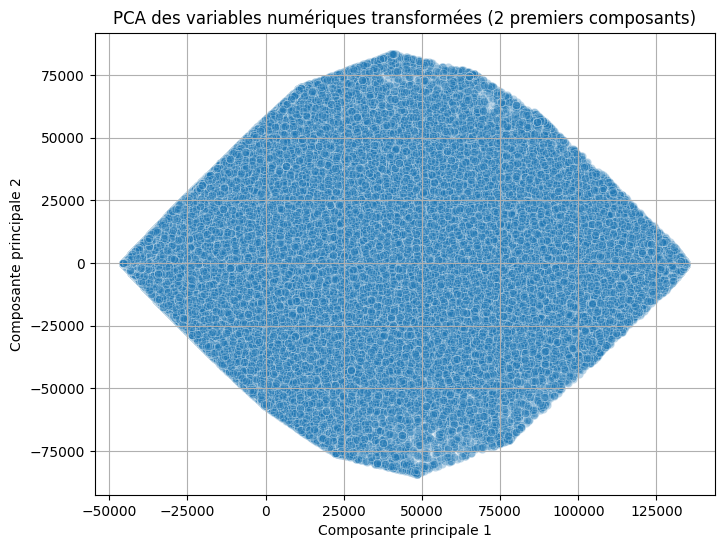

In [197]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
import seaborn as sns

numeric_cols = [
    'tenure_days',
    'arpu_out_without_bonus_moyenne',
    'bonus_on_consumption_revenue_moyenne',
    'bonus_on_refill_flash_revenue_moyenne',
    'consumption_revenue_moyenne',
    'data_trafic_volume_moyenne',
    'mou_international_moyenne',
    'mou_offnet_fix_moyenne',
    'mou_offnet_mobile_moyenne',
    'mou_onnet_moyenne',
    'number_of_reactivations_moyenne',
    'number_of_sms_international_moyenne',
    'number_of_sms_offnet_moyenne',
    'number_of_sms_onnet_moyenne',
    'recharge_amount_moyenne',
    'total_voice_revenu_amount_moyenne',
    'time_to_churn',
]

# Data cleaning : supprimer les lignes avec NA sur ces colonnes
X = transformed_data_per_period.select_dtypes(include=['float64'])


# PCA
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X)

# Variance expliquée
print(f"Variance expliquée par les deux premiers composants : {pca.explained_variance_ratio_.sum():.2%}")

# Plot PCA
plt.figure(figsize=(8, 6))
sns.scatterplot(x=X_pca[:, 0], y=X_pca[:, 1], alpha=0.3)
plt.title("PCA des variables numériques transformées (2 premiers composants)")
plt.xlabel("Composante principale 1")
plt.ylabel("Composante principale 2")
plt.grid(True)
plt.show()


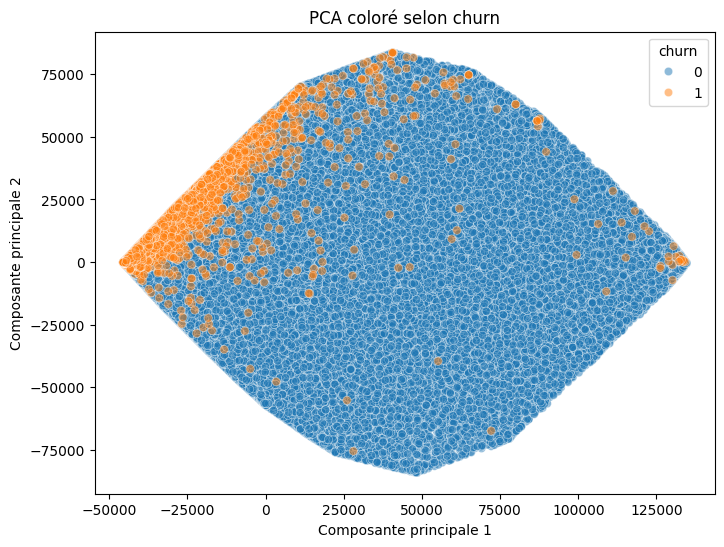

In [198]:
import seaborn as sns

plt.figure(figsize=(8,6))
sns.scatterplot(x=X_pca[:,0], y=X_pca[:,1], hue=transformed_data_per_period.loc[X.index, 'churn'], alpha=0.5)
plt.title('PCA coloré selon churn')
plt.xlabel('Composante principale 1')
plt.ylabel('Composante principale 2')
plt.show()


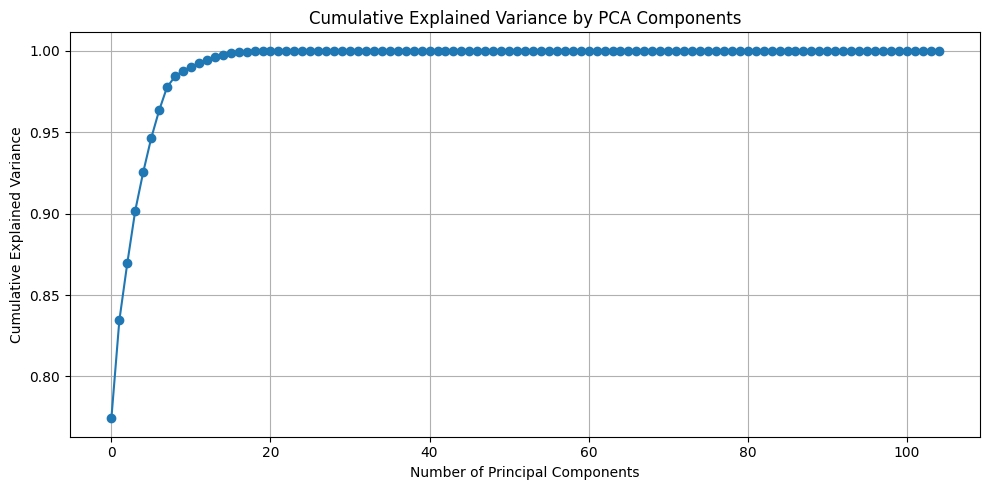

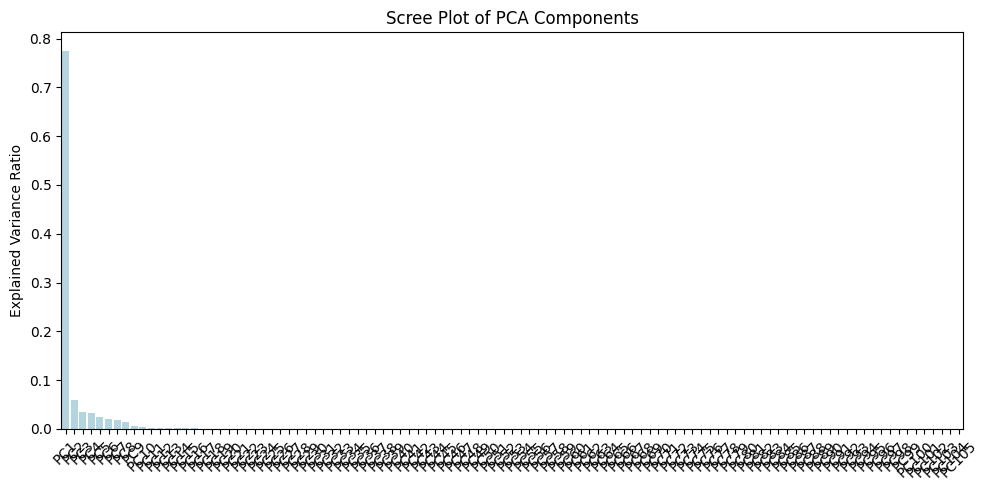

In [195]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
import seaborn as sns


# Step 1: Drop rows with missing values in those columns
data_for_pca =transformed_data_per_period.select_dtypes(include=['float64'])



# Step 3: Apply PCA
pca = PCA()
pca_components = pca.fit_transform(data_for_pca)

# Step 4: Plot cumulative explained variance
plt.figure(figsize=(10, 5))
plt.plot(np.cumsum(pca.explained_variance_ratio_), marker='o')
plt.xlabel('Number of Principal Components')
plt.ylabel('Cumulative Explained Variance')
plt.title('Cumulative Explained Variance by PCA Components')
plt.grid(True)
plt.tight_layout()
plt.show()

# Step 5: Scree plot
plt.figure(figsize=(10, 5))
sns.barplot(
    x=[f'PC{i+1}' for i in range(len(pca.explained_variance_ratio_))],
    y=pca.explained_variance_ratio_,
    color='lightblue'
)
plt.ylabel('Explained Variance Ratio')
plt.title('Scree Plot of PCA Components')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

# Optional: PCA results DataFrame
pca_df = pd.DataFrame(
    pca_components, 
    columns=[f'PC{i+1}' for i in range(pca_components.shape[1])]
)


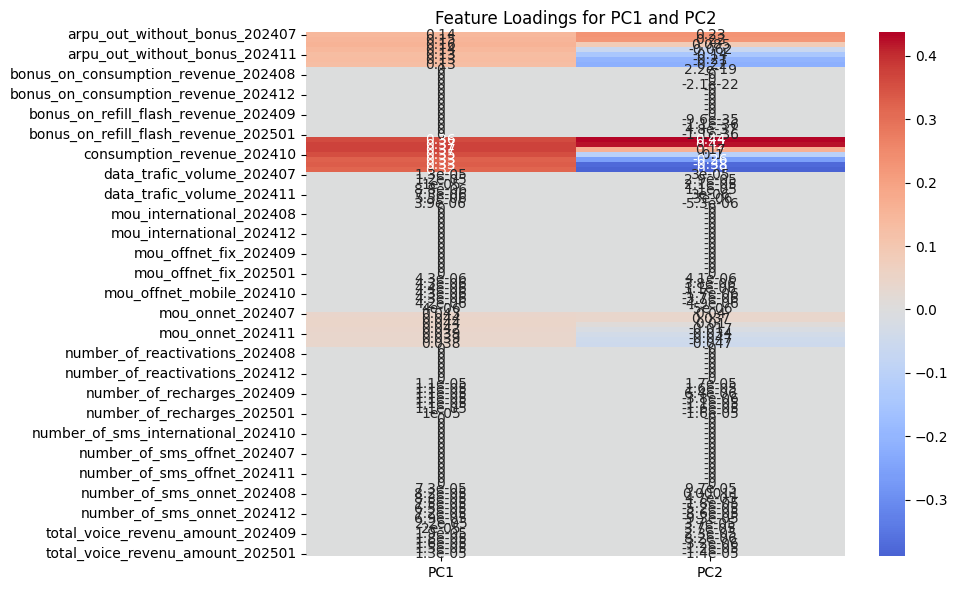

In [ ]:
# 6. Résultats PCA en DataFrame (optionnel)
pca_df = pd.DataFrame(
    pca_components, 
    columns=[f'PC{i+1}' for i in range(pca_components.shape[1])]
)

# 7. Heatmap des loadings pour PC1 et PC2
loadings = pd.DataFrame(
    pca.components_.T,
    columns=[f'PC{i+1}' for i in range(pca.n_components_)],
    index=data_for_pca.columns
)

plt.figure(figsize=(10, 6))
sns.heatmap(loadings.iloc[:, :2], annot=True, cmap='coolwarm', center=0)
plt.title("Feature Loadings for PC1 and PC2")
plt.tight_layout()
plt.show()

Les couleurs rouges indiquent une corrélation positive forte avec la composante.

Les couleurs bleues indiquent une corrélation négative.

Par exemple, arpu_out_without_bonus_moyenne a une forte contribution positive sur PC1 (0.40) mais une contribution négative plus faible sur PC2 (-0.087).

bonus_on_refill_flash_revenue_moyenne contribue surtout à PC2 (0.47).

time_to_churn est négativement corrélé avec PC1 (-0.13), ce qui peut indiquer que ce composant capte des variations liées à la fidélité (time_to_churn élevé signifie client fidèle).

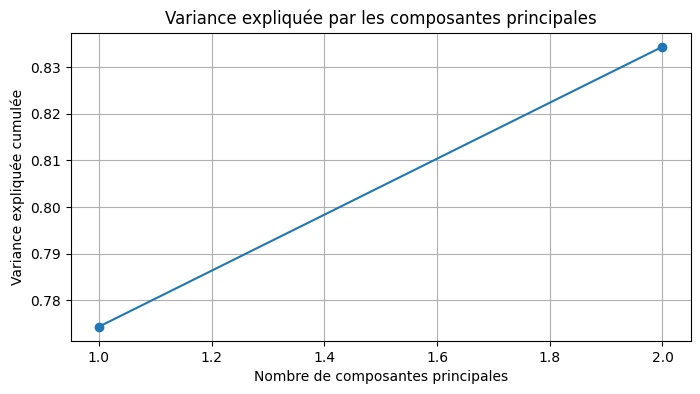

Variance expliquée par composante principale :
PC1 : 0.7743
PC2 : 0.0601

Coefficients (loadings) des variables sur PC1 et PC2 :
                                       PC1       PC2
arpu_out_without_bonus_202407     0.144271  0.228273
arpu_out_without_bonus_202408     0.150588  0.223441
arpu_out_without_bonus_202409     0.156934  0.084959
arpu_out_without_bonus_202410     0.143346 -0.061990
arpu_out_without_bonus_202411     0.131162 -0.144158
...                                    ...       ...
total_voice_revenu_amount_202409  0.000019  0.000023
total_voice_revenu_amount_202410  0.000018  0.000008
total_voice_revenu_amount_202411  0.000016 -0.000003
total_voice_revenu_amount_202412  0.000015 -0.000012
total_voice_revenu_amount_202501  0.000013 -0.000014

[105 rows x 2 columns]


In [199]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA

# Supposons que X est votre DataFrame avec les variables numériques (après nettoyage)

# PCA déjà appliqué
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X)

# Variance expliquée par composante
explained_variance = pca.explained_variance_ratio_

# Affichage variance expliquée cumulée
plt.figure(figsize=(8,4))
plt.plot(range(1, len(explained_variance)+1), explained_variance.cumsum(), marker='o')
plt.xlabel('Nombre de composantes principales')
plt.ylabel('Variance expliquée cumulée')
plt.title('Variance expliquée par les composantes principales')
plt.grid(True)
plt.show()

# Coefficients (loadings) pour chaque variable sur les deux premières composantes
loadings = pd.DataFrame(
    pca.components_.T,
    columns=['PC1', 'PC2'],
    index=X.columns
)

print("Variance expliquée par composante principale :")
for i, var_exp in enumerate(explained_variance, 1):
    print(f"PC{i} : {var_exp:.4f}")

print("\nCoefficients (loadings) des variables sur PC1 et PC2 :")
print(loadings)


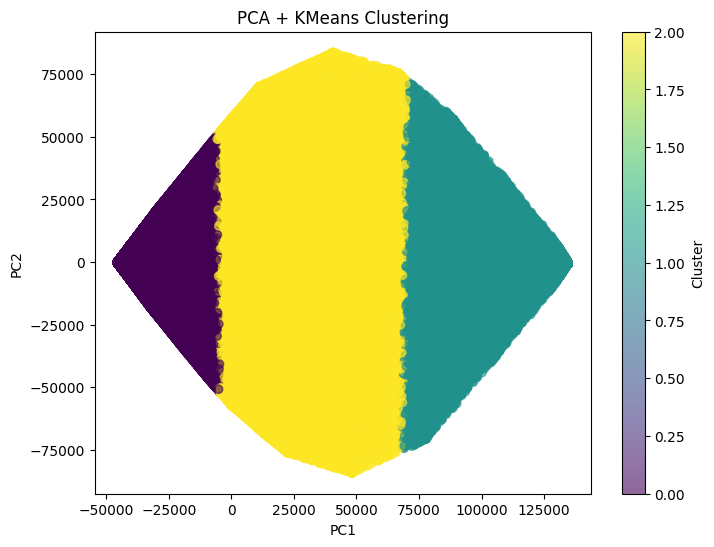

In [200]:
from sklearn.cluster import KMeans

kmeans = KMeans(n_clusters=3)  # choose the number of clusters based on Elbow method
clusters = kmeans.fit_predict(pca_components[:, :2])

# Visualize clusters
plt.figure(figsize=(8,6))
plt.scatter(pca_components[:, 0], pca_components[:, 1], c=clusters, cmap='viridis', alpha=0.6)
plt.xlabel("PC1")
plt.ylabel("PC2")
plt.title("PCA + KMeans Clustering")
plt.colorbar(label="Cluster")
plt.show()


### modeling 

### regression logistique

In [131]:
transformed_data_per_period.to_csv("transformed_data_per_period.csv", index=False)

In [132]:
final_df_per_period_encoded.to_csv("final_df_per_period_encoded.csv", index=False)

In [133]:
final_df_per_period.to_csv("final_df_per_period.csv", index=False)

In [183]:
# Scale numeric features (optional)
X_per_period = transformed_data_per_period.drop(columns=['churn'])
y_per_period = transformed_data_per_period['churn']
X_moyenne=transformed_data_moyenne.drop(columns=['churn'])
y_moyenne= transformed_data_moyenne['churn']


In [1]:
import pandas as pd
df=pd.read_csv("final_df_transformed_per_period.csv")

In [2]:
import joblib
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import classification_report, confusion_matrix, roc_curve, auc, precision_recall_curve


In [3]:
logreg_model = joblib.load("logreg_model_optimal.pkl")
threshold_logreg = joblib.load("logreg_threshold.pkl")["best_threshold"]


In [4]:
for col in df.columns:
    print(col)

churn
subscriber_id
original_operator
dat_remb_kridi_net
tenure_days
has_international_call
time_to_churn
flag_smartphone
arpu_out_without_bonus_202407
arpu_out_without_bonus_202408
arpu_out_without_bonus_202409
arpu_out_without_bonus_202410
arpu_out_without_bonus_202411
arpu_out_without_bonus_202412
arpu_out_without_bonus_202501
bonus_on_consumption_revenue_202407
bonus_on_consumption_revenue_202408
bonus_on_consumption_revenue_202409
bonus_on_consumption_revenue_202410
bonus_on_consumption_revenue_202411
bonus_on_consumption_revenue_202412
bonus_on_consumption_revenue_202501
bonus_on_refill_flash_revenue_202407
bonus_on_refill_flash_revenue_202408
bonus_on_refill_flash_revenue_202409
bonus_on_refill_flash_revenue_202410
bonus_on_refill_flash_revenue_202411
bonus_on_refill_flash_revenue_202412
bonus_on_refill_flash_revenue_202501
consumption_revenue_202407
consumption_revenue_202408
consumption_revenue_202409
consumption_revenue_202410
consumption_revenue_202411
consumption_revenue_20


📊 Classification Report :
              precision    recall  f1-score   support

           0       0.96      0.96      0.96    109984
           1       0.55      0.56      0.55      9538

    accuracy                           0.93    119522
   macro avg       0.76      0.76      0.76    119522
weighted avg       0.93      0.93      0.93    119522



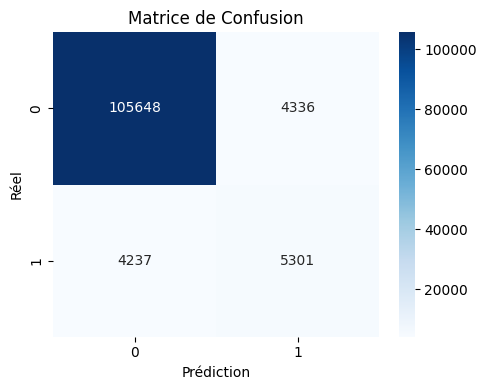

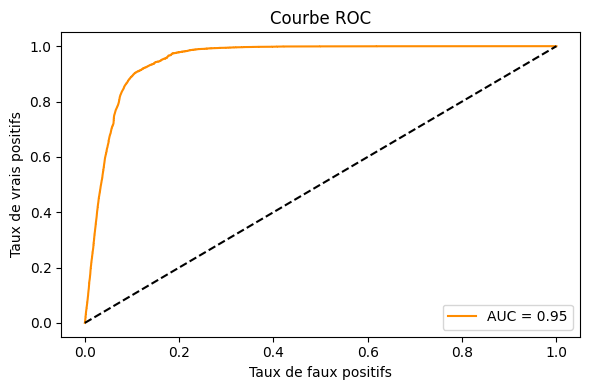

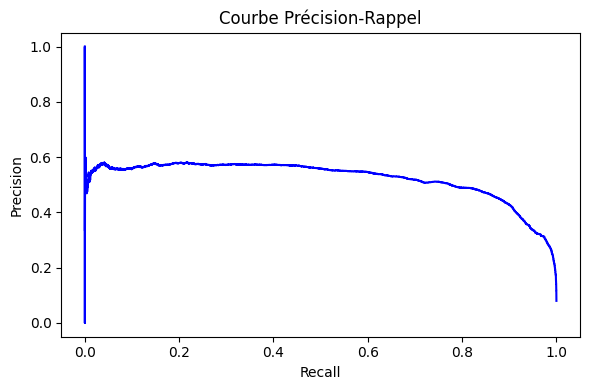

In [ ]:
import pandas as pd
import numpy as np
import joblib
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix, roc_curve, auc, precision_recall_curve
from imblearn.over_sampling import SMOTE

# 1. Charger les données
# 🔁 Remplacez 'data.csv', 'target' par vos noms réels

X = df.drop(columns=["churn","subscriber_id"], axis=1)  # Remplacez "target" par le nom de votre variable cible
y = df["churn"]

# 2. Séparer les données
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.5, stratify=y, random_state=42)

# 3. Appliquer SMOTE pour rééquilibrer les classes
smote = SMOTE(random_state=42)
X_resampled, y_resampled = smote.fit_resample(X_train, y_train)

# 4. Charger le modèle et le seuil optimal
logreg_model = joblib.load("logreg_model_optimal.pkl")
threshold_logreg = joblib.load("logreg_threshold.pkl")["best_threshold"]

# 5. Prédictions sur les données test
y_proba = logreg_model.predict_proba(X_test)[:, 1]
y_pred = (y_proba >= threshold_logreg).astype(int)

# 6. Afficher le classification report
print("\n📊 Classification Report :")
print(classification_report(y_test, y_pred))

# 7. Matrice de confusion
cm = confusion_matrix(y_test, y_pred)
plt.figure(figsize=(5, 4))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.xlabel("Prédiction")
plt.ylabel("Réel")
plt.title("Matrice de Confusion")
plt.tight_layout()
plt.show()

# 8. Courbe ROC
fpr, tpr, _ = roc_curve(y_test, y_proba)
roc_auc = auc(fpr, tpr)

plt.figure(figsize=(6, 4))
plt.plot(fpr, tpr, label=f"AUC = {roc_auc:.2f}", color='darkorange')
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel("Taux de faux positifs")
plt.ylabel("Taux de vrais positifs")
plt.title("Courbe ROC")
plt.legend()
plt.tight_layout()
plt.show()

# 9. Courbe Précision-Rappel
precision, recall, _ = precision_recall_curve(y_test, y_proba)

plt.figure(figsize=(6, 4))
plt.plot(recall, precision, color='blue')
plt.xlabel("Recall")
plt.ylabel("Precision")
plt.title("Courbe Précision-Rappel")
plt.tight_layout()
plt.show()


In [1]:
import pandas as pd
transformed_data_per_period = pd.read_csv("final_df_transformed_per_period.csv")

In [2]:

X_per_period=transformed_data_per_period.drop(columns=['churn','subscriber_id'])
y_per_period= transformed_data_per_period['churn']


In [158]:
for col in final_df.columns:
    print(col)

churn
classe_anciennete
subscriber_id
original_operator
dat_remb_kridi_net
tenure_days
has_international_call
time_to_churn
device_type
flag_smartphone
age
marital_status
gender
customer_language
arpu_out_without_bonus_moyenne
bonus_on_consumption_revenue_moyenne
bonus_on_refill_flash_revenue_moyenne
consumption_revenue_moyenne
data_trafic_volume_moyenne
mou_international_moyenne
mou_offnet_fix_moyenne
mou_offnet_mobile_moyenne
mou_onnet_moyenne
number_of_reactivations_moyenne
number_of_sms_international_moyenne
number_of_sms_offnet_moyenne
number_of_sms_onnet_moyenne
recharge_amount_moyenne
total_voice_revenu_amount_moyenne


In [7]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegressionCV
from sklearn.metrics import (
    classification_report, confusion_matrix, roc_auc_score,
    precision_recall_curve
)
from sklearn.preprocessing import StandardScaler
from imblearn.over_sampling import BorderlineSMOTE

# 1. Split dataset
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.5, stratify=y, random_state=42
)

# 2. Scale features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# 3. Resampling with BorderlineSMOTE
smote = BorderlineSMOTE(random_state=42)
X_resampled, y_resampled = smote.fit_resample(X_train_scaled, y_train)

# 4. Train Logistic Regression with Cross-Validation
logreg_cv = LogisticRegressionCV(
    cv=3,
    scoring='roc_auc',
    solver='lbfgs',
    max_iter=5000,
    n_jobs=-1,
    random_state=42,
    class_weight='balanced'
)
logreg_cv.fit(X_resampled, y_resampled)

# 5. Predict probabilities
y_proba = logreg_cv.predict_proba(X_test_scaled)[:, 1]

# 6. Find optimal threshold to maximize F1
precisions, recalls, thresholds = precision_recall_curve(y_test, y_proba)
f1_scores = 2 * precisions * recalls / (precisions + recalls + 1e-10)
best_idx = np.argmax(f1_scores)
best_threshold = thresholds[best_idx]

# 7. Predict with optimal threshold
y_pred_opt = (y_proba >= best_threshold).astype(int)

# 8. Results
print(f"\n🔎 AUC Score: {roc_auc_score(y_test, y_proba):.4f}")
print(f"🎯 Best Threshold: {best_threshold:.3f} | Best F1: {f1_scores[best_idx]:.3f}\n")
print("📊 Confusion Matrix:")
print(confusion_matrix(y_test, y_pred_opt))
print("\n📋 Classification Report:")
print(classification_report(y_test, y_pred_opt))



🔎 AUC Score: 0.9504
🎯 Best Threshold: 0.777 | Best F1: 0.610

📊 Confusion Matrix:
[[169309  13997]
 [  2766  13131]]

📋 Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.92      0.95    183306
           1       0.48      0.83      0.61     15897

    accuracy                           0.92    199203
   macro avg       0.73      0.87      0.78    199203
weighted avg       0.94      0.92      0.93    199203



In [8]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split, StratifiedKFold
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier, StackingClassifier
from sklearn.svm import SVC
from sklearn.metrics import (
    classification_report, confusion_matrix,
    roc_auc_score, precision_recall_curve
)
from sklearn.feature_selection import RFECV
from imblearn.over_sampling import BorderlineSMOTE
from imblearn.pipeline import Pipeline

# 1. Split data
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.5, stratify=y, random_state=42
)

# 2. Standardize
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# 3. Handle imbalance
smote = BorderlineSMOTE(random_state=42)
X_resampled, y_resampled = smote.fit_resample(X_train_scaled, y_train)

# 4. Base models
base_estimators = [
    ('rf', RandomForestClassifier(n_estimators=100, random_state=42)),
    ('svc', SVC(kernel='rbf', probability=True, random_state=42))
]

# 5. Meta-model: Logistic Regression
meta_model = LogisticRegression(solver='lbfgs', max_iter=5000, class_weight='balanced')

# 6. Stacking classifier
stacking = StackingClassifier(
    estimators=base_estimators,
    final_estimator=meta_model,
    cv=5,
    passthrough=True,  # keep original features
    n_jobs=-1
)

# 7. Feature selection with RFECV on resampled data
selector = RFECV(
    estimator=stacking,
    step=1,
    cv=StratifiedKFold(3),
    scoring='roc_auc',
    n_jobs=-1
)

# 8. Fit RFECV
selector.fit(X_resampled, y_resampled)
print(f"✅ Features selected: {np.sum(selector.support_)} / {X.shape[1]}")

# Apply feature selection
X_test_selected = selector.transform(X_test_scaled)

# 9. Predict probabilities
y_proba = selector.predict_proba(X_test_selected)[:, 1]

# 10. Threshold optimization
precisions, recalls, thresholds = precision_recall_curve(y_test, y_proba)
f1_scores = 2 * precisions * recalls / (precisions + recalls + 1e-10)
best_idx = np.argmax(f1_scores)
best_threshold = thresholds[best_idx]

# 11. Predict using optimal threshold
y_pred_opt = (y_proba >= best_threshold).astype(int)

# 12. Evaluation
print(f"\n🔎 AUC Score: {roc_auc_score(y_test, y_proba):.4f}")
print(f"🎯 Best Threshold: {best_threshold:.3f} | Best F1: {f1_scores[best_idx]:.3f}\n")
print("📊 Confusion Matrix:")
print(confusion_matrix(y_test, y_pred_opt))
print("\n📋 Classification Report:")
print(classification_report(y_test, y_pred_opt, digits=4))


KeyboardInterrupt: 

Fitting 2 folds for each of 6 candidates, totalling 12 fits

✅ Meilleurs paramètres : {'penalty': 'l1', 'C': np.float64(0.01)}

🔎 AUC Score: 0.9507
🎯 Seuil optimal (F1): 0.781 | F1 = 0.612
📉 Brier Score: 0.1060
📊 Confusion Matrix:
[[101954   8030]
 [  1794   7744]]

📋 Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.93      0.95    109984
           1       0.49      0.81      0.61      9538

    accuracy                           0.92    119522
   macro avg       0.74      0.87      0.78    119522
weighted avg       0.94      0.92      0.93    119522



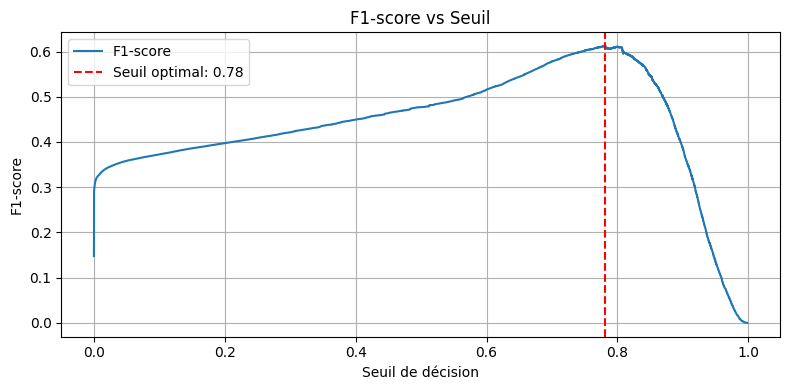


📌 Principales variables contributives :
                              Feature  Coefficient
81         number_of_recharges_202412   -11.108993
80         number_of_recharges_202411   -10.937863
82         number_of_recharges_202501    -9.675694
61           mou_offnet_mobile_202501    -3.364045
103        number_of_sms_onnet_202501    -1.291661
111   classe_anciennete_0 to 3 Months    -1.157600
10      arpu_out_without_bonus_202411     1.072043
7       arpu_out_without_bonus_202408    -0.981382
8       arpu_out_without_bonus_202409    -0.931338
109  total_voice_revenu_amount_202412    -0.748355


In [4]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split, RandomizedSearchCV
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import (
    classification_report, confusion_matrix, roc_auc_score,
    precision_recall_curve, brier_score_loss
)
from sklearn.preprocessing import StandardScaler
from imblearn.over_sampling import BorderlineSMOTE
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings("ignore")

# === 1. Split
X_train, X_test, y_train, y_test = train_test_split(
    X_per_period, y_per_period, test_size=0.3, stratify=y_per_period, random_state=42
)

# === 2. Standardisation
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# === 3. Borderline SMOTE
smote = BorderlineSMOTE(random_state=42)
X_resampled, y_resampled = smote.fit_resample(X_train_scaled, y_train)

# === 4. Sous-échantillonnage pour tuning rapide
X_sample = X_resampled[:1500]
y_sample = y_resampled[:1500]

# === 5. RandomizedSearchCV optimisé
param_dist = {
    'C': np.logspace(-2, 1, 4),
    'penalty': ['l1', 'l2'],  # enlève elasticnet pour éviter l1_ratio
}

logreg = LogisticRegression(
    solver='saga',
    max_iter=500,
    class_weight='balanced',
    n_jobs=-1,
    random_state=42
)

rs = RandomizedSearchCV(
    estimator=logreg,
    param_distributions=param_dist,
    n_iter=6,
    scoring='roc_auc',
    cv=2,
    verbose=1,
    n_jobs=-1,
    random_state=42
)
rs.fit(X_sample, y_sample)
best_model = rs.best_estimator_
print("\n✅ Meilleurs paramètres :", rs.best_params_)

# === 6. Fit complet
best_model.fit(X_resampled, y_resampled)

# === 7. Prédictions
y_proba = best_model.predict_proba(X_test_scaled)[:, 1]

# === 8. Seuil optimal
precisions, recalls, thresholds = precision_recall_curve(y_test, y_proba)
f1_scores = 2 * precisions * recalls / (precisions + recalls + 1e-10)
best_idx = np.argmax(f1_scores)
best_threshold = thresholds[best_idx]
y_pred_opt = (y_proba >= best_threshold).astype(int)

# === 9. Évaluation
print(f"\n🔎 AUC Score: {roc_auc_score(y_test, y_proba):.4f}")
print(f"🎯 Seuil optimal (F1): {best_threshold:.3f} | F1 = {f1_scores[best_idx]:.3f}")
print(f"📉 Brier Score: {brier_score_loss(y_test, y_proba):.4f}")
print("📊 Confusion Matrix:")
print(confusion_matrix(y_test, y_pred_opt))
print("\n📋 Classification Report:")
print(classification_report(y_test, y_pred_opt))

# === 10. Courbe F1
plt.figure(figsize=(8, 4))
plt.plot(thresholds, f1_scores[:-1], label='F1-score')
plt.axvline(best_threshold, color='r', linestyle='--', label=f'Seuil optimal: {best_threshold:.2f}')
plt.xlabel('Seuil de décision')
plt.ylabel('F1-score')
plt.title('F1-score vs Seuil')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# === 11. Interprétation des coefficients
coef_df = pd.DataFrame({
    'Feature': X_per_period.columns,
    'Coefficient': best_model.coef_[0]
}).sort_values(by='Coefficient', key=abs, ascending=False)

print("\n📌 Principales variables contributives :")
print(coef_df.head(10))


In [5]:
from matplotlib import pyplot as plt

# Tri de la courbe pour afficher précision vs seuil
thresholds = thresholds[np.where(thresholds <= 0.95)]  # ignore les extrêmes
precisions = precisions[:len(thresholds)]

# Cherche le plus petit seuil qui donne precision >= 0.60
for i, p in enumerate(precisions):
    if p >= 0.60:
        best_precision_threshold = thresholds[i]
        break

y_pred_highprec = (y_proba >= best_precision_threshold).astype(int)

print(f"\n🎯 Nouveau seuil (precision ≥ 0.60): {best_precision_threshold:.3f}")
print("\n📋 Rapport de classification (objectif précision) :")
print(classification_report(y_test, y_pred_highprec))


NameError: name 'best_precision_threshold' is not defined

In [143]:
# IMPORTANT : récupère les index d'origine pour le test set
test_idx = X_test.index

# Après entraînement et prédiction sur X_test
# (tu as déjà y_proba et y_pred_opt)

# Récupère le subscriber_id du test set original
subscriber_id_test = final_df_per_period.loc[test_idx, 'subscriber_id'].reset_index(drop=True)

# Assemble le DataFrame résultat
results_df = pd.DataFrame({
    'subscriber_id': subscriber_id_test,
    'proba_churn': y_proba,
    'churn_pred': y_pred_opt
})

# Filtre les clients à fort risque de churn
seuil_churn = 0.7
top_churners = results_df[results_df['proba_churn'] > seuil_churn].sort_values('proba_churn', ascending=False)
print(top_churners.head(20))

# Option : export
top_churners.to_csv('top_churners_logreg.csv', index=False)
print("\n✅ Les clients à risque exportés dans 'top_churners_logreg.csv'")

        subscriber_id  proba_churn  churn_pred
64703      2178925658     0.999990           1
114340     2173598270     0.999981           1
188502     2176823349     0.999978           1
4076       2178209480     0.999971           1
193823     2167687505     0.999944           1
190940     2157516478     0.999917           1
4518       2168765699     0.999916           1
142701     2178720767     0.999914           1
121642     2142560557     0.999913           1
143510     2174837750     0.999908           1
6836       2166662708     0.999902           1
158868     2167243349     0.999901           1
155324     2179439916     0.999889           1
143582     2155102377     0.999875           1
142334     2176465763     0.999875           1
104168     2161770013     0.999873           1
106922     2179310278     0.999857           1
177324     2176679622     0.999855           1
182814        5952577     0.999855           1
2470       2178628232     0.999851           1

✅ Les client

In [ ]:
import joblib

# Save the best model
joblib.dump(logreg_cv, 'best_logreg_cv_model.pkl')


✅ Model saved as 'best_random_forest_model.pkl'


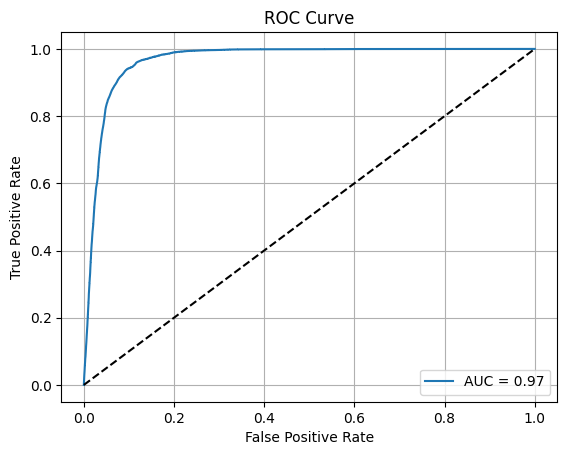

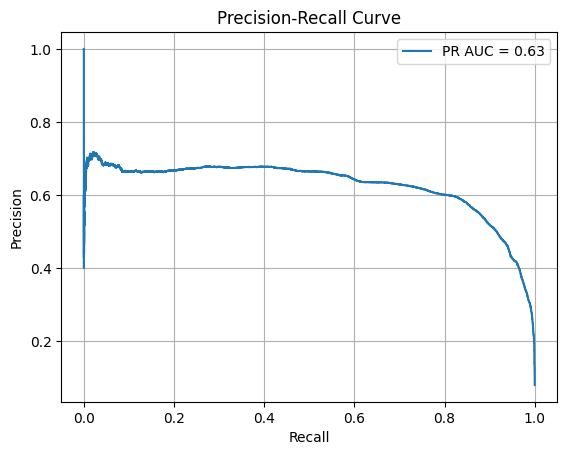

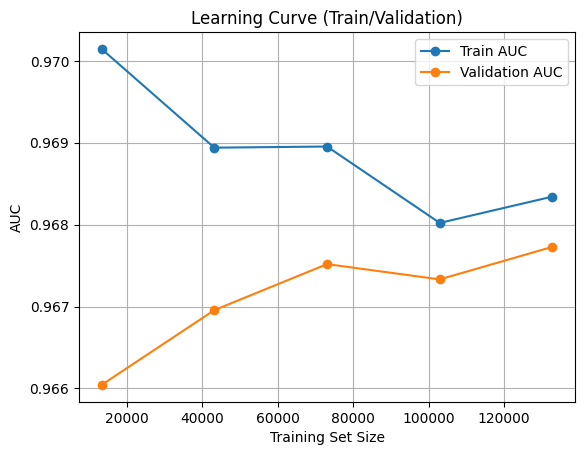

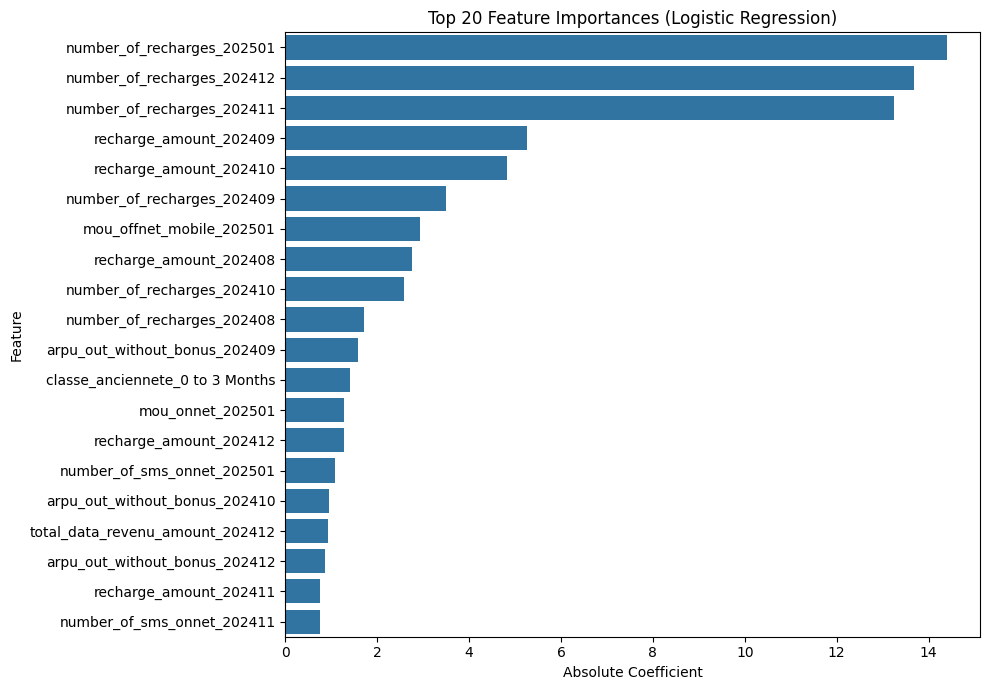

In [145]:
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, auc, precision_recall_curve
from sklearn.model_selection import learning_curve
import seaborn as sns

# 1. ROC Curve
fpr, tpr, _ = roc_curve(y_test, y_proba)
roc_auc = auc(fpr, tpr)
plt.figure()
plt.plot(fpr, tpr, label=f'AUC = {roc_auc:.2f}')
plt.plot([0,1], [0,1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve')
plt.legend()
plt.grid()
plt.show()

# 2. Precision-Recall Curve
precisions, recalls, _ = precision_recall_curve(y_test, y_proba)
pr_auc = auc(recalls, precisions)
plt.figure()
plt.plot(recalls, precisions, label=f'PR AUC = {pr_auc:.2f}')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Precision-Recall Curve')
plt.legend()
plt.grid()
plt.show()

# 3. Learning Curve (train/validation AUC)
train_sizes, train_scores, test_scores = learning_curve(
    logreg_cv, X_train_scaled, y_train, cv=3, n_jobs=-1, scoring='roc_auc',
    train_sizes=np.linspace(0.1, 1.0, 5)
)
plt.figure()
plt.plot(train_sizes, train_scores.mean(axis=1), 'o-', label='Train AUC')
plt.plot(train_sizes, test_scores.mean(axis=1), 'o-', label='Validation AUC')
plt.xlabel("Training Set Size")
plt.ylabel("AUC")
plt.title("Learning Curve (Train/Validation)")
plt.legend()
plt.grid()
plt.show()

# 4. Feature Importances (coefficients)
feature_names = X_train.columns
coefs = logreg_cv.coef_.flatten()
feat_imp = pd.DataFrame({
    'feature': feature_names,
    'coefficient': coefs,
    'importance_abs': np.abs(coefs)
}).sort_values('importance_abs', ascending=False)

plt.figure(figsize=(10,7))
sns.barplot(x='importance_abs', y='feature', data=feat_imp.head(20), orient='h')
plt.title("Top 20 Feature Importances (Logistic Regression)")
plt.xlabel("Absolute Coefficient")
plt.ylabel("Feature")
plt.tight_layout()
plt.show()


In [231]:
import joblib

# Save the best model
joblib.dump(logreg_cv, 'best_logreg_cv_model.pkl')
print("✅ Model saved as 'best_random_forest_model.pkl'")


✅ Model saved as 'best_random_forest_model.pkl'


In [6]:
import numpy as np
from sklearn.model_selection import train_test_split, RandomizedSearchCV
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import StandardScaler
from imblearn.over_sampling import BorderlineSMOTE
from imblearn.pipeline import Pipeline as ImbPipeline

# 1. Split complet train/test (garde tout)
X_train, X_test, y_train, y_test = train_test_split(
    X_per_period, y_per_period, test_size=0.3, stratify=y_per_period, random_state=42
)

# 2. Prend un sous-échantillon du train pour le tuning rapide
# Ici, 3000 lignes ou 10% du train, au choix :
N = min(3000, len(X_train))  # max 3000 lignes pour tuner rapidement
X_sample = X_train.sample(n=N, random_state=42)
y_sample = y_train.loc[X_sample.index]

# 3. Pipeline rapide
pipeline = ImbPipeline([
    ('scaler', StandardScaler()),
    ('smote', BorderlineSMOTE(random_state=42)),
    ('logreg', LogisticRegression(
        max_iter=500,
        class_weight='balanced',
        random_state=42,
        solver='saga',
        n_jobs=-1
    ))
])

# 4. Grille minimaliste (adapte selon ce qui t'intéresse vraiment)
param_grid = {
    'logreg__C': np.logspace(-2, 1, 5),
    'logreg__penalty': ['l2', 'l1', 'elasticnet'],
    'logreg__l1_ratio': [0, 0.5, 1],  # pour elasticnet, ignoré sinon
}

rs = RandomizedSearchCV(
    estimator=pipeline,
    param_distributions=param_grid,
    n_iter=6,     # 6 essais rapides !
    scoring='roc_auc',
    cv=2,
    verbose=2,
    n_jobs=-1,
    random_state=42
)

# 5. Fit sur l'échantillon !
rs.fit(X_sample, y_sample)
print("\nMeilleurs paramètres sur sous-échantillon :")
print(rs.best_params_)

# 6. Réentraine le pipeline optimal sur **tout le train**
best_pipe = rs.best_estimator_
best_pipe.fit(X_train, y_train)

# 7. Teste sur le vrai test set !
y_proba = best_pipe.predict_proba(X_test)[:, 1]
from sklearn.metrics import roc_auc_score, classification_report, confusion_matrix, precision_recall_curve
precisions, recalls, thresholds = precision_recall_curve(y_test, y_proba)
f1_scores = 2 * precisions * recalls / (precisions + recalls + 1e-10)
best_idx = np.argmax(f1_scores)
best_threshold = thresholds[best_idx]
y_pred_opt = (y_proba >= best_threshold).astype(int)

print(f"\n🔎 AUC Score: {roc_auc_score(y_test, y_proba):.4f}")
print(f"🎯 Best Threshold: {best_threshold:.3f} | Best F1: {f1_scores[best_idx]:.3f}")
print("📊 Confusion Matrix:")
print(confusion_matrix(y_test, y_pred_opt))
print("\n📋 Classification Report:")
print(classification_report(y_test, y_pred_opt))


Fitting 2 folds for each of 6 candidates, totalling 12 fits

Meilleurs paramètres sur sous-échantillon :
{'logreg__penalty': 'l1', 'logreg__l1_ratio': 1, 'logreg__C': np.float64(0.31622776601683794)}

🔎 AUC Score: 0.9506
🎯 Best Threshold: 0.779 | Best F1: 0.612
📊 Confusion Matrix:
[[101723   8261]
 [  1691   7847]]

📋 Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.92      0.95    109984
           1       0.49      0.82      0.61      9538

    accuracy                           0.92    119522
   macro avg       0.74      0.87      0.78    119522
weighted avg       0.94      0.92      0.93    119522



In [7]:
# Ajuster le seuil pour avoir une précision >= 0.60
best_precision_threshold = None

for i, p in enumerate(precisions[:len(thresholds)]):  # éviter overflow
    if p >= 0.60:
        best_precision_threshold = thresholds[i]
        break

if best_precision_threshold is None:
    print("❌ Aucun seuil trouvé avec précision >= 0.60. Utilisation du seuil max par défaut.")
    best_precision_threshold = thresholds[-1]  # dernier seuil, plus strict

# Prédiction avec ce seuil
y_pred_highprec = (y_proba >= best_precision_threshold).astype(int)

# Affichage des résultats
print(f"\n🎯 Nouveau seuil (precision ≥ 0.60): {best_precision_threshold:.3f}")
print("\n📋 Rapport de classification (objectif précision) :")
print(classification_report(y_test, y_pred_highprec))



🎯 Nouveau seuil (precision ≥ 0.60): 0.995

📋 Rapport de classification (objectif précision) :
              precision    recall  f1-score   support

           0       0.92      1.00      0.96    109984
           1       0.60      0.00      0.00      9538

    accuracy                           0.92    119522
   macro avg       0.76      0.50      0.48    119522
weighted avg       0.89      0.92      0.88    119522



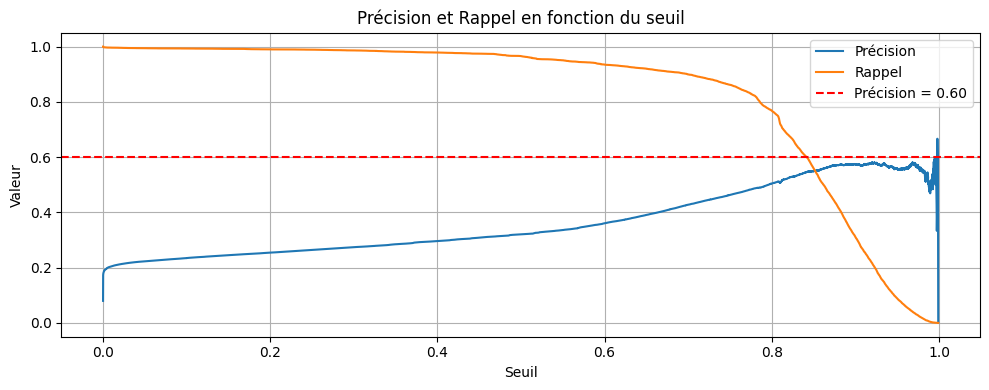

In [8]:
# Tracer précision et rappel pour mieux choisir
plt.figure(figsize=(10, 4))
plt.plot(thresholds, precisions[:-1], label='Précision')
plt.plot(thresholds, recalls[:-1], label='Rappel')
plt.axhline(0.60, color='red', linestyle='--', label='Précision = 0.60')
plt.xlabel("Seuil")
plt.ylabel("Valeur")
plt.title("Précision et Rappel en fonction du seuil")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


In [9]:
def find_best_threshold(precisions, recalls, thresholds, min_precision=0.60, min_recall=0.30):
    best_threshold = None
    best_f1 = 0

    for i in range(len(thresholds)):
        if precisions[i] >= min_precision and recalls[i] >= min_recall:
            f1 = 2 * precisions[i] * recalls[i] / (precisions[i] + recalls[i] + 1e-10)
            if f1 > best_f1:
                best_f1 = f1
                best_threshold = thresholds[i]

    return best_threshold, best_f1

# 🔍 Application :
best_thresh, best_f1 = find_best_threshold(precisions, recalls, thresholds)

if best_thresh:
    print(f"✅ Nouveau seuil optimal : {best_thresh:.3f} avec F1 = {best_f1:.3f}")
    y_pred_balanced = (y_proba >= best_thresh).astype(int)
    print(classification_report(y_test, y_pred_balanced))
    print(confusion_matrix(y_test, y_pred_balanced))
else:
    print("❌ Aucun seuil trouvé avec précision ≥ 0.60 et rappel ≥ 0.30.")


❌ Aucun seuil trouvé avec précision ≥ 0.60 et rappel ≥ 0.30.


In [10]:
best_thresh, best_f1 = find_best_threshold(precisions, recalls, thresholds, min_precision=0.55, min_recall=0.25)

if best_thresh:
    print(f"✅ Nouveau seuil plus tolérant : {best_thresh:.3f} avec F1 = {best_f1:.3f}")
    y_pred_balanced = (y_proba >= best_thresh).astype(int)
    print(classification_report(y_test, y_pred_balanced))
    print(confusion_matrix(y_test, y_pred_balanced))
else:
    print("❌ Toujours aucun seuil acceptable. Il faut revoir le modèle.")


✅ Nouveau seuil plus tolérant : 0.851 avec F1 = 0.553
              precision    recall  f1-score   support

           0       0.96      0.96      0.96    109984
           1       0.55      0.56      0.55      9538

    accuracy                           0.93    119522
   macro avg       0.76      0.76      0.76    119522
weighted avg       0.93      0.93      0.93    119522

[[105648   4336]
 [  4237   5301]]


In [51]:
import joblib

# Sauvegarde du modèle complet (pipeline)
joblib.dump(best_pipe, "logreg_model_optimal.pkl")

# Sauvegarde du scaler (déjà intégré dans le pipeline, donc pas nécessaire à part)

# Sauvegarde du seuil optimal dans un fichier .pkl
joblib.dump({"best_threshold": best_thresh}, "logreg_threshold.pkl")


['logreg_threshold.pkl']

In [52]:
# Chargement du modèle et du seuil
model = joblib.load("logreg_model_optimal.pkl")
threshold = joblib.load("logreg_threshold.pkl")["best_threshold"]

# Utilisation du pipeline directement (il contient scaler + SMOTE + modèle)
X_scaled = X_sample  # Ne pas rescinder : le pipeline le fait

# Prédiction
y_proba = model.predict_proba(X_scaled)[0][1]
y_pred = int(y_proba >= threshold)


In [1]:
import pandas as pd
df=pd.read_csv("final_df_transformed_per_period.csv")
X= df.drop(columns=['subscriber_id', 'churn'])
y= df['churn']
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.6, stratify=y, random_state=42)

=== Classification Report ===
              precision    recall  f1-score   support

           0     0.9614    0.9602    0.9608    219968
           1     0.5474    0.5550    0.5512     19076

    accuracy                         0.9279    239044
   macro avg     0.7544    0.7576    0.7560    239044
weighted avg     0.9283    0.9279    0.9281    239044



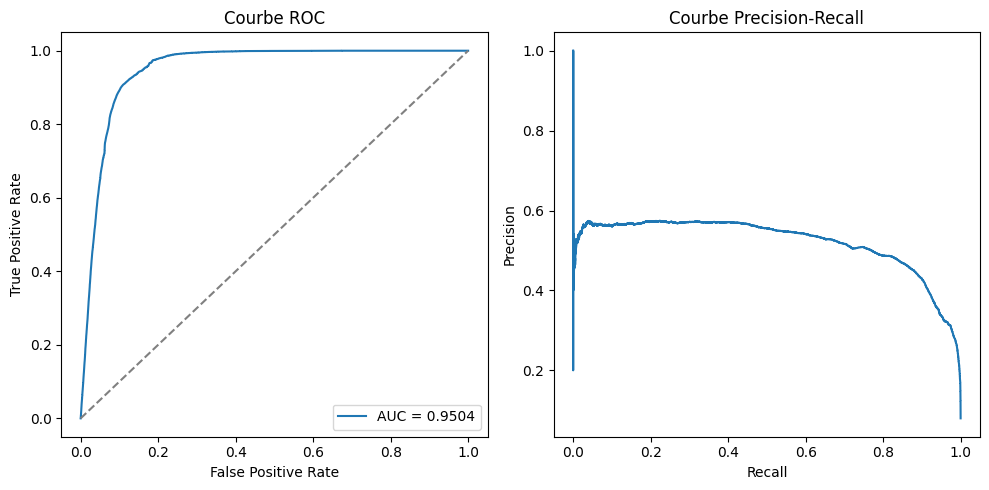

In [2]:
import joblib
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import classification_report, roc_curve, auc, precision_recall_curve

# Chargement modèle et seuil
model = joblib.load("logreg_model_optimal.pkl")
threshold = joblib.load("logreg_threshold.pkl")["best_threshold"]

# Charger données test (à adapter selon ton dataset)
# Ici on suppose que tu as X_test et y_test prêts
# Par exemple :
# import pandas as pd
# df_test = pd.read_csv("test_data.csv")
# X_test = df_test.drop(columns=["churn"])
# y_test = df_test["churn"]

# Supposons X_test, y_test déjà définis, sinon adapte ce chargement

# Prédictions probabilistes sur test
y_proba = model.predict_proba(X_test)[:, 1]

# Prédiction binaire avec seuil personnalisé
y_pred = (y_proba >= threshold).astype(int)

# Rapport de classification
print("=== Classification Report ===")
print(classification_report(y_test, y_pred, digits=4))

# Courbe ROC
fpr, tpr, roc_thresholds = roc_curve(y_test, y_proba)
roc_auc = auc(fpr, tpr)

plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.plot(fpr, tpr, label=f"AUC = {roc_auc:.4f}")
plt.plot([0,1], [0,1], linestyle='--', color='grey')
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("Courbe ROC")
plt.legend()

# Courbe Precision-Recall
precision, recall, pr_thresholds = precision_recall_curve(y_test, y_proba)
plt.subplot(1, 2, 2)
plt.plot(recall, precision)
plt.xlabel("Recall")
plt.ylabel("Precision")
plt.title("Courbe Precision-Recall")

plt.tight_layout()
plt.show()


In [54]:
y_proba

np.float64(0.818273665402715)

In [ ]:
import joblib

# 1. Sauvegarder le modèle entraîné
joblib.dump(best_model, "logreg_model_optima.pkl")

# 2. Sauvegarder le scaler utilisé
joblib.dump(scaler, "scaler_logreg.pkl")

# 3. Sauvegarder le seuil optimal dans un simple dictionnaire
seuil_info = {"best_threshold": best_thresh}
joblib.dump(seuil_info, "logreg_threshold.pkl")

print("✅ Modèle, scaler et seuil sauvegardés avec succès.")


✅ Modèle, scaler et seuil sauvegardés avec succès.


Fitting 2 folds for each of 6 candidates, totalling 12 fits

Meilleurs paramètres sur sous-échantillon :
{'logreg__penalty': 'l1', 'logreg__l1_ratio': 1, 'logreg__C': np.float64(0.31622776601683794)}

🔎 AUC Score: 0.9350
🎯 Best Threshold: 0.765 | Best F1: 0.546
📊 Confusion Matrix:
[[101160   8824]
 [  2637   6901]]

📋 Classification Report:
              precision    recall  f1-score   support

           0       0.97      0.92      0.95    109984
           1       0.44      0.72      0.55      9538

    accuracy                           0.90    119522
   macro avg       0.71      0.82      0.75    119522
weighted avg       0.93      0.90      0.91    119522



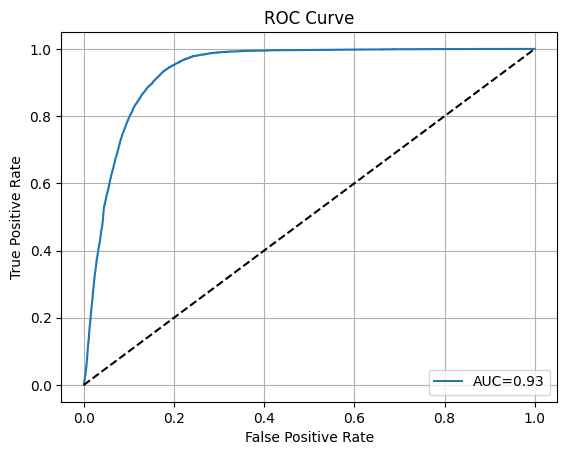

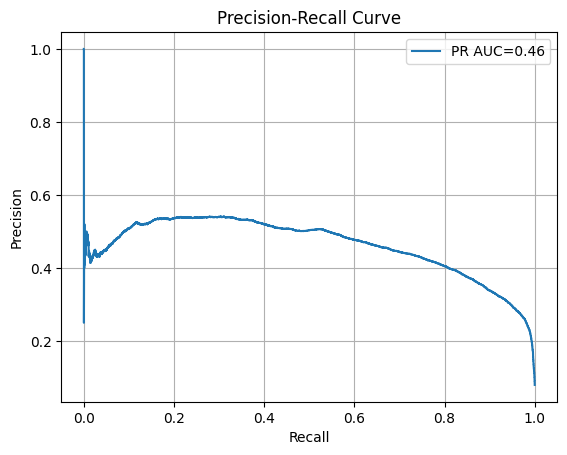

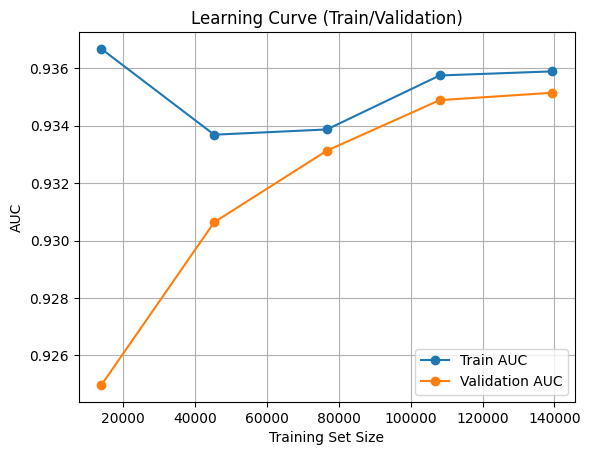


🔝 Clients à fort risque de churn :
        subscriber_id  proba_churn  churn_pred
70679      2146365289     0.999999           1
35422      2178596157     0.999998           1
59713      2141680549     0.999997           1
96826      1517075131     0.999891           1
77651      2160988732     0.999859           1
33079      2144745367     0.999832           1
5199       2142508463     0.999795           1
115387     2178545677     0.999728           1
75511      2178611975     0.999682           1
99356      2166367173     0.999653           1
105884     2178120724     0.999649           1
62766      2178405078     0.999290           1
90442      2153704749     0.999272           1
71193      2175921247     0.998899           1
52894      2165468745     0.998897           1
22878      2174194934     0.998892           1
7970       2145252585     0.998879           1
56827        18524346     0.998768           1
118454     2158922961     0.998721           1
27203      2167192895   

In [227]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split, RandomizedSearchCV, learning_curve
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import (
    classification_report, confusion_matrix, roc_auc_score,
    precision_recall_curve, roc_curve, auc
)
from sklearn.preprocessing import StandardScaler
from imblearn.over_sampling import BorderlineSMOTE
from imblearn.pipeline import Pipeline as ImbPipeline
import joblib

# 1. Chargement base + split train/test
df_modeling_per_period = final_df_per_period.copy()
target = 'churn'
id_col = 'subscriber_id'

X_full = df_modeling_per_period.drop(columns=[target])
y_full = df_modeling_per_period[target]

# Split pour train/test (garder subscriber_id pour extraction finale)
X_train_orig, X_test_orig, y_train, y_test = train_test_split(
    X_full, y_full, test_size=0.3, stratify=y_full, random_state=42
)
subscriber_id_test = X_test_orig[id_col].reset_index(drop=True)

# One-hot encoding APRÈS split pour garder l’alignement
cat_cols = X_train_orig.select_dtypes(include=['object', 'category']).columns
cat_cols = [col for col in cat_cols if col != id_col]
X_train = pd.get_dummies(X_train_orig, columns=cat_cols, drop_first=True)
X_test = pd.get_dummies(X_test_orig, columns=cat_cols, drop_first=True)
X_train, X_test = X_train.align(X_test, join='left', axis=1, fill_value=0)

# 2. Sous-échantillon pour RandomizedSearchCV
N = min(3000, len(X_train))
X_sample = X_train.sample(n=N, random_state=42)
y_sample = y_train.loc[X_sample.index]

# 3. Pipeline complet
pipeline = ImbPipeline([
    ('scaler', StandardScaler()),
    ('smote', BorderlineSMOTE(random_state=42)),
    ('logreg', LogisticRegression(
        max_iter=500,
        class_weight='balanced',
        random_state=42,
        solver='saga',
        n_jobs=-1
    ))
])
param_grid = {
    'logreg__C': np.logspace(-2, 1, 5),
    'logreg__penalty': ['l2', 'l1', 'elasticnet'],
    'logreg__l1_ratio': [0, 0.5, 1],
}
rs = RandomizedSearchCV(
    estimator=pipeline,
    param_distributions=param_grid,
    n_iter=6,
    scoring='roc_auc',
    cv=2,
    verbose=2,
    n_jobs=-1,
    random_state=42
)
rs.fit(X_sample, y_sample)
print("\nMeilleurs paramètres sur sous-échantillon :")
print(rs.best_params_)

# 4. Réentraîne le pipeline optimal sur tout le train
best_pipe = rs.best_estimator_
best_pipe.fit(X_train, y_train)

# 5. Prédiction sur tout le test
y_proba = best_pipe.predict_proba(X_test)[:, 1]
precisions, recalls, thresholds = precision_recall_curve(y_test, y_proba)
f1_scores = 2 * precisions * recalls / (precisions + recalls + 1e-10)
best_idx = np.argmax(f1_scores)
best_threshold = thresholds[best_idx]
y_pred_opt = (y_proba >= best_threshold).astype(int)

print(f"\n🔎 AUC Score: {roc_auc_score(y_test, y_proba):.4f}")
print(f"🎯 Best Threshold: {best_threshold:.3f} | Best F1: {f1_scores[best_idx]:.3f}")
print("📊 Confusion Matrix:")
print(confusion_matrix(y_test, y_pred_opt))
print("\n📋 Classification Report:")
print(classification_report(y_test, y_pred_opt))

# 6. Courbe ROC
fpr, tpr, _ = roc_curve(y_test, y_proba)
roc_auc = auc(fpr, tpr)
plt.figure()
plt.plot(fpr, tpr, label=f'AUC={roc_auc:.2f}')
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("ROC Curve")
plt.legend()
plt.grid()
plt.show()

# 7. Courbe Precision-Recall
pr_auc = auc(recalls, precisions)
plt.figure()
plt.plot(recalls, precisions, label=f'PR AUC={pr_auc:.2f}')
plt.xlabel("Recall")
plt.ylabel("Precision")
plt.title("Precision-Recall Curve")
plt.legend()
plt.grid()
plt.show()

# 8. Learning Curve
train_sizes, train_scores, test_scores = learning_curve(
    best_pipe, X_train, y_train, cv=2, n_jobs=-1, scoring='roc_auc',
    train_sizes=np.linspace(0.1, 1.0, 5)
)
plt.figure()
plt.plot(train_sizes, train_scores.mean(axis=1), 'o-', label='Train AUC')
plt.plot(train_sizes, test_scores.mean(axis=1), 'o-', label='Validation AUC')
plt.xlabel("Training Set Size")
plt.ylabel("AUC")
plt.title("Learning Curve (Train/Validation)")
plt.legend()
plt.grid()
plt.show()

# 9. Extraction clients à fort churn (avec subscriber_id)
seuil_churn = 0.7
results_df = pd.DataFrame({
    'subscriber_id': subscriber_id_test,
    'proba_churn': y_proba,
    'churn_pred': y_pred_opt
})
top_churners = results_df[results_df['proba_churn'] > seuil_churn].sort_values('proba_churn', ascending=False)
print("\n🔝 Clients à fort risque de churn :")
print(top_churners.head(20))
top_churners.to_csv("top_churners_logreg.csv", index=False)
print("\n✅ Les clients à risque exportés dans 'top_churners_logreg.csv'")

# 10. Sauvegarde pipeline
joblib.dump(best_pipe, "best_logreg_pipeline.pkl")
print("\n✅ Pipeline sauvegardé sous 'best_logreg_pipeline.pkl'")


### random forest

In [ ]:
import pandas as pd


In [13]:
X=transformed_data_per_period.drop(columns= 'churn')
y=transformed_data_per_period['churn']

In [ ]:
with open("best_logreg_cv_model.pkl", "rb") as f:
    loaded_model = pickle.load(f)


In [195]:
# Suppose que X_test est déjà défini et prétraité
y_pred_opt = loaded_model.predict(X_test)
print("Exemple de prédiction :", y_pred_opt[:5])


Exemple de prédiction : [0 0 0 1 0]


In [208]:
import pandas as pd
import random
from sklearn.linear_model import LogisticRegressionCV
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from huggingface_hub import login
from transformers import AutoTokenizer, AutoModelForSeq2SeqLM, pipeline
from langchain_community.llms import HuggingFacePipeline
from langchain_core.prompts import PromptTemplate

# ==== Connexion Hugging Face ====
hf_token = input("🔑 Entrez votre token Hugging Face : ").strip()
login(token=hf_token)

# ==== Chargement des données ====
df = pd.read_csv("transformed_data_per_period_with_id.csv")
df["churn"] = df["churn"].astype(int)

# ==== Préparation des données ====
X = df.drop(columns=["subscriber_id", "churn"], errors="ignore")
y = df["churn"]
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# ==== Régression logistique ====
logreg_cv = LogisticRegressionCV(cv=3, max_iter=5000, class_weight="balanced")
logreg_cv.fit(X_scaled, y)

# ==== LLM Hugging Face ====
model_id = "google/flan-t5-base"
tokenizer = AutoTokenizer.from_pretrained(model_id, token=hf_token)
model = AutoModelForSeq2SeqLM.from_pretrained(model_id, token=hf_token)
pipe = pipeline("text2text-generation", model=model, tokenizer=tokenizer)
llm = HuggingFacePipeline(pipeline=pipe)

# ==== Prompt Template ====
prompt = PromptTemplate.from_template(
    "Données client : {features}\n"
    "Expliquez en 3 phrases simples si ce client est susceptible de se désabonner et pourquoi."
)
chain = prompt | llm

# ==== Prédiction pour un client spécifique ====
subscriber_id_target = 2146365289
client_row = df[df["subscriber_id"] == subscriber_id_target]
if client_row.empty:
    print(f"❌ Aucun client trouvé avec l'ID {subscriber_id_target}")
    exit()

X_input = client_row.drop(columns=["subscriber_id", "churn"], errors="ignore")
X_input_scaled = scaler.transform(X_input)

# Prédiction
prediction = logreg_cv.predict(X_input_scaled)[0]
label = "Churn" if prediction == 1 else "No Churn"

# Sélection de variables limitées pour éviter dépassement de tokens
features_dict = X_input.iloc[0].to_dict()
selected_keys = list(features_dict.keys())[:10]  # Choisir les 10 premières variables
filtered_features = {k: features_dict[k] for k in selected_keys}
features_str = ", ".join([f"{k}={v}" for k, v in filtered_features.items()])

# ==== Génération d'explication ====
response = chain.invoke({"features": features_str})
explanation = response['text'] if isinstance(response, dict) else response

# ==== Affichage final ====
print(f"\n🎯 Prédiction du modèle pour le client {subscriber_id_target} : {label}")
print("\n🧠 Explication générée par le LLM :")
print(explanation)


Device set to use cpu



🎯 Prédiction du modèle pour le client 2146365289 : No Churn

🧠 Explication générée par le LLM :
Client : original_operator = 1.0, dat_remb_kridi_net = 0.0, tenure_days = 2477.0, has_international_call = 0.0, time_to_churn = 1439.0, flag_smartphone = 1.0, arpu_out_without_bonus_202407=0.0, arpu_out_without_bonus_202408=0.0, arpu_out_without_bonus_202409=0.0, arpu_out_without_bonus_202410=0.0


In [212]:
with open("best_logreg_cv_model.pkl", "wb") as f:
    pickle.dump(logreg_cv, f)

In [ ]:
import pandas as pd
import pickle
from sklearn.preprocessing import StandardScaler
from openai import OpenAI

# ==== Configuration ====
from openai import OpenAI

client = OpenAI(
    api_key="XXXXXXXXXXXXXXXXXXXXXXXXXXX",
    base_url="https://api.groq.com/openai/v1"
)

# Avec joblib
import joblib
def load_model(filename):
    return joblib.load(filename)



# ==== Chargement des données ====
df = pd.read_csv("transformed_data_per_period_with_id.csv")

# ==== Recréation du scaler ====
X = df.drop(columns=["subscriber_id", "churn"], errors="ignore")
scaler = StandardScaler()
scaler.fit(X)

# ==== Sélection du client ====
subscriber_id = 2166924217
client_row = df[df['subscriber_id'] == subscriber_id]

if client_row.empty:
    print(f"❌ Client {subscriber_id} non trouvé.")
    exit()

X_sample = client_row.drop(columns=["subscriber_id", "churn"], errors="ignore")
X_sample_scaled = scaler.transform(X_sample)

# ==== Prédiction ====
probability = logreg_cv.predict_proba(X_sample_scaled)[0][1]
prediction = logreg_cv.predict(X_sample_scaled)[0]
label = "Churn" if prediction == 1 else "No Churn"

# ==== Préparation du prompt ====
def explain_prediction(probability, input_dict, client_id):
    prompt = f"""Tu es un data scientist expert chez Ooredoo.

Un client identifié par l’ID {client_id} présente une probabilité de churn estimée à {round(probability * 100, 1)}%.

Voici les principales informations connues :
{input_dict}

- Si le risque est supérieur à 40%, rédige une explication en 3 phrases en français expliquant pourquoi ce client risque de partir.
- Si le risque est inférieur ou égal à 40%, rédige une explication en 3 phrases en français expliquant pourquoi ce client semble fidèle.
- Ne mentionne jamais les probabilités ou les mots techniques liés au machine learning. Reste simple et compréhensible.
"""
    response = client.chat.completions.create(
        model="llama3-70b-8192",
        messages=[{"role": "user", "content": prompt}]
    )
    return response.choices[0].message.content.strip()

def generate_email(probability, input_dict, explanation, client_id):
    prompt = f"""Tu es responsable marketing chez Ooredoo.

Voici l'explication du profil du client {client_id} :
{explanation}

Voici les informations disponibles :
{input_dict}

Rédige un email engageant et chaleureux en français, pour encourager ce client à rester chez Ooredoo. Propose 3 incitations adaptées à son profil (offres, services, avantages).

- N'utilise jamais les mots 'churn' ou 'risque'.
- Utilise un ton positif et bienveillant.
- Termine l’email avec une phrase d’appel à l’action pour nous contacter ou visiter une agence.
"""
    response = client.chat.completions.create(
        model="llama3-70b-8192",
        messages=[{"role": "user", "content": prompt}]
    )
    return response.choices[0].message.content.strip()

# ==== Lancement des générations ====
input_dict = X_sample.to_dict(orient="records")[0]
explanation = explain_prediction(probability, input_dict, subscriber_id)
email = generate_email(probability, input_dict, explanation, subscriber_id)

# ==== Affichage final ====
print(f"\n🎯 Prédiction du modèle pour le client {subscriber_id} : {label} ({round(probability*100, 1)}%)")
print("\n🧠 Explication générée par le LLM :")
print(explanation)
print("\n📧 Email de rétention proposé :")
print(email)



🎯 Prédiction du modèle pour le client 2166924217 : Churn (68.6%)

🧠 Explication générée par le LLM :
Le client identifié par l'ID 2166924217 risque de partir car il n'a pas utilisé ses données pendant une longue période, ce qui signifie qu'il n'a pas besoin de nos services. De plus, il n'a pas effectué de recharge significative depuis longtemps, ce qui montre qu'il n'est pas satisfait de notre offre. Enfin, il a un faible volume de trafic voice, ce qui indique qu'il n'a pas une relation forte avec notre réseau.

📧 Email de rétention proposé :
Objet : Nous vous apprécions chez Ooredoo

Bonjour Monsieur,

 Nous nous soucions de vous et nous voulons vous assurer que vous bénéficiez de la meilleure expérience possible avec Ooredoo. Nous avons remarqué que vous avez un peu ralenti dans votre utilisation de nos services dernièrement.

Nous sommes là pour vous aider à retrouver votre rythme et nous. Voici trois incitations spécialement conçues pour vous :

* Un forfait de données supplémenta

In [ ]:

df['churn_pred'] = logreg_cv.predict(scaler.transform(X))
print(df[df['churn_pred'] == 1]['subscriber_id','churn_pred'].head(10))  # Top 10 churners


15381    2166924217
15384    2176222375
15387    2167112314
15389    2174121235
15390    2174623973
15403    2176520384
15405    2174791016
15414    2174013607
15426    2174756311
15443    2170842777
Name: subscriber_id, dtype: int64


In [ ]:
from transformers import AutoTokenizer, AutoModelForSeq2SeqLM, pipeline
from huggingface_hub import login

# Step 1: Login
hf_token = input("Enter your Hugging Face token: ")
login(token=hf_token)

# Step 2: Load model
model_id = "google/flan-t5-base"

tokenizer = AutoTokenizer.from_pretrained(model_id, token=hf_token)
model = AutoModelForSeq2SeqLM.from_pretrained(model_id, token=hf_token)

pipe = pipeline("text2text-generation", model=model, tokenizer=tokenizer)

In [ ]:
# Step 13: Wrap the Hugging Face pipeline with LangChain
llm = HuggingFacePipeline(pipeline=pipe)

In [ ]:

# Step 14: Define the prompt template
prompt = PromptTemplate.from_template(
    "Customer features:\n{features}\n\nExplain if this customer is likely to churn and why."
)

In [4]:
import pandas as pd
import numpy as np
import joblib
from sklearn.metrics import classification_report, confusion_matrix, precision_score, recall_score, f1_score, roc_auc_score

# 📂 Chargement des fichiers
df = pd.read_csv("final_df_transformed_per_period.csv")
logreg_model = joblib.load("logreg_model_optimal.pkl")
logreg_thresh = joblib.load("logreg_threshold.pkl")["best_threshold"]

# 🎯 Définir X et y
X = df.drop(columns=["subscriber_id", "churn"])
y = df["churn"]

# 🔀 Séparation train/test (identique à l'entraînement)
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.3, stratify=y, random_state=42
)

# 📈 Prédiction des probabilités et classes
y_proba = logreg_model.predict_proba(X_test)[:, 1]
y_pred = (y_proba >= logreg_thresh).astype(int)

# 📊 Affichage des performances
print(f"✅ Seuil optimal utilisé : {logreg_thresh:.3f}")
print(f"🔍 AUC: {roc_auc_score(y_test, y_proba):.4f}")
print("\n📋 Classification Report:")
print(classification_report(y_test, y_pred, digits=3))
print("📊 Confusion Matrix:")
print(confusion_matrix(y_test, y_pred))

# 🔢 Résumé des 3 métriques principales
precision = precision_score(y_test, y_pred)
recall = recall_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred)

print("\n📈 Résumé des scores:")
print(f"Precision: {precision:.3f}")
print(f"Recall:    {recall:.3f}")
print(f"F1-Score:  {f1:.3f}")


✅ Seuil optimal utilisé : 0.917
🔍 AUC: 0.9506

📋 Classification Report:
              precision    recall  f1-score   support

           0      0.937     0.985     0.960    109984
           1      0.577     0.230     0.329      9538

    accuracy                          0.925    119522
   macro avg      0.757     0.608     0.645    119522
weighted avg      0.908     0.925     0.910    119522

📊 Confusion Matrix:
[[108370   1614]
 [  7340   2198]]

📈 Résumé des scores:
Precision: 0.577
Recall:    0.230
F1-Score:  0.329


In [5]:
from sklearn.metrics import precision_recall_curve

precisions, recalls, thresholds = precision_recall_curve(y_test, y_proba)

def find_best_threshold(precisions, recalls, thresholds, min_precision=0.55, min_recall=0.25):
    best_threshold = None
    best_f1 = 0
    for i in range(len(thresholds)):
        if precisions[i] >= min_precision and recalls[i] >= min_recall:
            f1 = 2 * precisions[i] * recalls[i] / (precisions[i] + recalls[i] + 1e-10)
            if f1 > best_f1:
                best_f1 = f1
                best_threshold = thresholds[i]
    return best_threshold, best_f1

best_thresh, best_f1 = find_best_threshold(precisions, recalls, thresholds)

print(f"✅ Nouveau seuil : {best_thresh:.3f} avec F1 = {best_f1:.3f}")


✅ Nouveau seuil : 0.851 avec F1 = 0.553


In [6]:
y_pred_adjusted = (y_proba >= best_thresh).astype(int)
print(classification_report(y_test, y_pred_adjusted, digits=3))


              precision    recall  f1-score   support

           0      0.961     0.961     0.961    109984
           1      0.550     0.556     0.553      9538

    accuracy                          0.928    119522
   macro avg      0.756     0.758     0.757    119522
weighted avg      0.929     0.928     0.928    119522



In [7]:
import joblib
joblib.dump({"best_threshold": best_thresh}, "logreg_threshold.pkl")


['logreg_threshold.pkl']

In [8]:
logreg_thresh = joblib.load("logreg_threshold.pkl")["best_threshold"]


In [11]:
import pandas as pd
import numpy as np
import joblib
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix, precision_score, recall_score, f1_score, roc_auc_score, precision_recall_curve

# 📂 Chargement des données et du modèle
df = pd.read_csv("final_df_transformed_per_period.csv")
xgb_model = joblib.load("xgb_model.pkl")

# 🔧 Préparation des données
X = df.drop(columns=["subscriber_id", "churn"])
y = df["churn"]

# 🔀 Split train/test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, stratify=y, random_state=42)

# 🎯 Prédiction des probabilités
y_proba = xgb_model.predict_proba(X_test)[:, 1]

# 📈 Courbes précision/rappel pour trouver le meilleur seuil
precisions, recalls, thresholds = precision_recall_curve(y_test, y_proba)
f1_scores = 2 * (precisions * recalls) / (precisions + recalls + 1e-10)
best_idx = np.argmax(f1_scores)
best_thresh = thresholds[best_idx]

# 📊 Prédiction avec le seuil optimal
y_pred = (y_proba >= best_thresh).astype(int)

# 📋 Résultats
print(f"✅ Seuil optimal basé sur F1-score : {best_thresh:.4f}")
print(f"🔍 AUC: {roc_auc_score(y_test, y_proba):.4f}")
print("\n📋 Rapport de classification :")
print(classification_report(y_test, y_pred, digits=3))
print("📊 Matrice de confusion :")
print(confusion_matrix(y_test, y_pred))

# 📌 Résumé des scores principaux
print("\nRésumé :")
print(f"Precision: {precision_score(y_test, y_pred):.3f}")
print(f"Recall:    {recall_score(y_test, y_pred):.3f}")
print(f"F1-Score:  {f1_score(y_test, y_pred):.3f}")

# 💾 Sauvegarde du seuil
joblib.dump({"best_threshold": best_thresh}, "xgb_threshold.pkl")


ValueError: feature_names mismatch: ['original_operator', 'dat_remb_kridi_net', 'tenure_days', 'has_international_call', 'time_to_churn', 'flag_smartphone', 'arpu_out_without_bonus_202407', 'arpu_out_without_bonus_202408', 'arpu_out_without_bonus_202409', 'arpu_out_without_bonus_202410', 'arpu_out_without_bonus_202411', 'arpu_out_without_bonus_202412', 'arpu_out_without_bonus_202501', 'bonus_on_consumption_revenue_202407', 'bonus_on_consumption_revenue_202408', 'bonus_on_consumption_revenue_202409', 'bonus_on_consumption_revenue_202410', 'bonus_on_consumption_revenue_202411', 'bonus_on_consumption_revenue_202412', 'bonus_on_consumption_revenue_202501', 'bonus_on_refill_flash_revenue_202407', 'bonus_on_refill_flash_revenue_202408', 'bonus_on_refill_flash_revenue_202409', 'bonus_on_refill_flash_revenue_202410', 'bonus_on_refill_flash_revenue_202411', 'bonus_on_refill_flash_revenue_202412', 'bonus_on_refill_flash_revenue_202501', 'bonus_on_refill_revenue_202407', 'bonus_on_refill_revenue_202408', 'bonus_on_refill_revenue_202409', 'bonus_on_refill_revenue_202410', 'bonus_on_refill_revenue_202411', 'bonus_on_refill_revenue_202412', 'bonus_on_refill_revenue_202501', 'consumption_revenue_202407', 'consumption_revenue_202408', 'consumption_revenue_202409', 'consumption_revenue_202410', 'consumption_revenue_202411', 'consumption_revenue_202412', 'consumption_revenue_202501', 'data_trafic_volume_202407', 'data_trafic_volume_202408', 'data_trafic_volume_202409', 'data_trafic_volume_202410', 'data_trafic_volume_202411', 'data_trafic_volume_202412', 'data_trafic_volume_202501', 'incoming_revenue_202407', 'incoming_revenue_202408', 'incoming_revenue_202409', 'incoming_revenue_202410', 'incoming_revenue_202411', 'incoming_revenue_202412', 'incoming_revenue_202501', 'mou_international_202407', 'mou_international_202408', 'mou_international_202409', 'mou_international_202410', 'mou_international_202411', 'mou_international_202412', 'mou_international_202501', 'mou_offnet_fix_202407', 'mou_offnet_fix_202408', 'mou_offnet_fix_202409', 'mou_offnet_fix_202410', 'mou_offnet_fix_202411', 'mou_offnet_fix_202412', 'mou_offnet_fix_202501', 'mou_offnet_mobile_202407', 'mou_offnet_mobile_202408', 'mou_offnet_mobile_202409', 'mou_offnet_mobile_202410', 'mou_offnet_mobile_202411', 'mou_offnet_mobile_202412', 'mou_offnet_mobile_202501', 'mou_onnet_202407', 'mou_onnet_202408', 'mou_onnet_202409', 'mou_onnet_202410', 'mou_onnet_202411', 'mou_onnet_202412', 'mou_onnet_202501', 'number_of_reactivations_202407', 'number_of_reactivations_202408', 'number_of_reactivations_202409', 'number_of_reactivations_202410', 'number_of_reactivations_202411', 'number_of_reactivations_202412', 'number_of_reactivations_202501', 'number_of_recharges_202407', 'number_of_recharges_202408', 'number_of_recharges_202409', 'number_of_recharges_202410', 'number_of_recharges_202411', 'number_of_recharges_202412', 'number_of_recharges_202501', 'number_of_sms_international_202407', 'number_of_sms_international_202408', 'number_of_sms_international_202409', 'number_of_sms_international_202410', 'number_of_sms_international_202411', 'number_of_sms_international_202412', 'number_of_sms_international_202501', 'number_of_sms_offnet_202407', 'number_of_sms_offnet_202408', 'number_of_sms_offnet_202409', 'number_of_sms_offnet_202410', 'number_of_sms_offnet_202411', 'number_of_sms_offnet_202412', 'number_of_sms_offnet_202501', 'number_of_sms_onnet_202407', 'number_of_sms_onnet_202408', 'number_of_sms_onnet_202409', 'number_of_sms_onnet_202410', 'number_of_sms_onnet_202411', 'number_of_sms_onnet_202412', 'number_of_sms_onnet_202501', 'recharge_amount_202407', 'recharge_amount_202408', 'recharge_amount_202409', 'recharge_amount_202410', 'recharge_amount_202411', 'recharge_amount_202412', 'recharge_amount_202501', 'total_data_revenu_amount_202407', 'total_data_revenu_amount_202408', 'total_data_revenu_amount_202409', 'total_data_revenu_amount_202410', 'total_data_revenu_amount_202411', 'total_data_revenu_amount_202412', 'total_data_revenu_amount_202501', 'total_voice_revenu_amount_202407', 'total_voice_revenu_amount_202408', 'total_voice_revenu_amount_202409', 'total_voice_revenu_amount_202410', 'total_voice_revenu_amount_202411', 'total_voice_revenu_amount_202412', 'total_voice_revenu_amount_202501', 'revenu_furfait_data_dinar_2024/07', 'revenu_furfait_data_dinar_2024/08', 'revenu_furfait_data_dinar_2024/09', 'revenu_furfait_data_dinar_2024/10', 'revenu_furfait_data_dinar_2024/11', 'revenu_furfait_data_dinar_2024/12', 'revenu_furfait_data_dinar_2025/01', 'classe_anciennete_0 to 3 Months', 'classe_anciennete_12 to 36 Months', 'classe_anciennete_3 to 6 Months', 'classe_anciennete_6 to 12 Months', 'classe_anciennete_More than 36 Months', 'device_type_-', 'device_type_Basic Phone', 'device_type_Feature Phone', 'device_type_IoT Device', 'device_type_Mobile broadband PCI card', 'device_type_POS', 'device_type_Phablet', 'device_type_Router', 'device_type_Smartphone', 'device_type_Tablet', 'device_type_USB Modem', 'device_type_Wearable', 'age_18-50', 'age__18', 'age__50', 'marital_status_Celibataire', 'marital_status_Divorce', 'marital_status_Marie', 'marital_status_Veuf', 'gender_F', 'gender_M', 'customer_language_Anglais', 'customer_language_Arabe', 'customer_language_Francais', 'customer_language_Français', 'customer_language_Italien'] ['original_operator', 'dat_remb_kridi_net', 'tenure_days', 'has_international_call', 'time_to_churn', 'flag_smartphone', 'arpu_out_without_bonus_202407', 'arpu_out_without_bonus_202408', 'arpu_out_without_bonus_202409', 'arpu_out_without_bonus_202410', 'arpu_out_without_bonus_202411', 'arpu_out_without_bonus_202412', 'arpu_out_without_bonus_202501', 'bonus_on_consumption_revenue_202407', 'bonus_on_consumption_revenue_202408', 'bonus_on_consumption_revenue_202409', 'bonus_on_consumption_revenue_202410', 'bonus_on_consumption_revenue_202411', 'bonus_on_consumption_revenue_202412', 'bonus_on_consumption_revenue_202501', 'bonus_on_refill_flash_revenue_202407', 'bonus_on_refill_flash_revenue_202408', 'bonus_on_refill_flash_revenue_202409', 'bonus_on_refill_flash_revenue_202410', 'bonus_on_refill_flash_revenue_202411', 'bonus_on_refill_flash_revenue_202412', 'bonus_on_refill_flash_revenue_202501', 'consumption_revenue_202407', 'consumption_revenue_202408', 'consumption_revenue_202409', 'consumption_revenue_202410', 'consumption_revenue_202411', 'consumption_revenue_202412', 'consumption_revenue_202501', 'data_trafic_volume_202407', 'data_trafic_volume_202408', 'data_trafic_volume_202409', 'data_trafic_volume_202410', 'data_trafic_volume_202411', 'data_trafic_volume_202412', 'data_trafic_volume_202501', 'mou_international_202407', 'mou_international_202408', 'mou_international_202409', 'mou_international_202410', 'mou_international_202411', 'mou_international_202412', 'mou_international_202501', 'mou_offnet_fix_202407', 'mou_offnet_fix_202408', 'mou_offnet_fix_202409', 'mou_offnet_fix_202410', 'mou_offnet_fix_202411', 'mou_offnet_fix_202412', 'mou_offnet_fix_202501', 'mou_offnet_mobile_202407', 'mou_offnet_mobile_202408', 'mou_offnet_mobile_202409', 'mou_offnet_mobile_202410', 'mou_offnet_mobile_202411', 'mou_offnet_mobile_202412', 'mou_offnet_mobile_202501', 'mou_onnet_202407', 'mou_onnet_202408', 'mou_onnet_202409', 'mou_onnet_202410', 'mou_onnet_202411', 'mou_onnet_202412', 'mou_onnet_202501', 'number_of_reactivations_202407', 'number_of_reactivations_202408', 'number_of_reactivations_202409', 'number_of_reactivations_202410', 'number_of_reactivations_202411', 'number_of_reactivations_202412', 'number_of_reactivations_202501', 'number_of_recharges_202407', 'number_of_recharges_202408', 'number_of_recharges_202409', 'number_of_recharges_202410', 'number_of_recharges_202411', 'number_of_recharges_202412', 'number_of_recharges_202501', 'number_of_sms_international_202407', 'number_of_sms_international_202408', 'number_of_sms_international_202409', 'number_of_sms_international_202410', 'number_of_sms_international_202411', 'number_of_sms_international_202412', 'number_of_sms_international_202501', 'number_of_sms_offnet_202407', 'number_of_sms_offnet_202408', 'number_of_sms_offnet_202409', 'number_of_sms_offnet_202410', 'number_of_sms_offnet_202411', 'number_of_sms_offnet_202412', 'number_of_sms_offnet_202501', 'number_of_sms_onnet_202407', 'number_of_sms_onnet_202408', 'number_of_sms_onnet_202409', 'number_of_sms_onnet_202410', 'number_of_sms_onnet_202411', 'number_of_sms_onnet_202412', 'number_of_sms_onnet_202501', 'total_voice_revenu_amount_202407', 'total_voice_revenu_amount_202408', 'total_voice_revenu_amount_202409', 'total_voice_revenu_amount_202410', 'total_voice_revenu_amount_202411', 'total_voice_revenu_amount_202412', 'total_voice_revenu_amount_202501', 'classe_anciennete_0 to 3 Months', 'classe_anciennete_12 to 36 Months', 'classe_anciennete_3 to 6 Months', 'classe_anciennete_6 to 12 Months', 'classe_anciennete_More than 36 Months', 'device_type_Basic Phone', 'device_type_Feature Phone', 'device_type_IoT Device', 'device_type_Mobile broadband PCI card', 'device_type_POS', 'device_type_Phablet', 'device_type_Router', 'device_type_Smartphone', 'device_type_Tablet', 'device_type_USB Modem', 'device_type_Wearable', 'age_18-50', 'age_<18', 'age_>50', 'marital_status_Celibataire', 'marital_status_Divorce', 'marital_status_Marie', 'marital_status_Veuf', 'gender_F', 'gender_M', 'customer_language_Anglais', 'customer_language_Arabe', 'customer_language_Français', 'customer_language_Italien']
expected total_data_revenu_amount_202412, incoming_revenue_202411, total_data_revenu_amount_202410, recharge_amount_202409, incoming_revenue_202407, revenu_furfait_data_dinar_2024/08, recharge_amount_202411, incoming_revenue_202408, revenu_furfait_data_dinar_2024/12, bonus_on_refill_revenue_202407, incoming_revenue_202412, recharge_amount_202410, bonus_on_refill_revenue_202409, revenu_furfait_data_dinar_2024/10, bonus_on_refill_revenue_202501, age__18, bonus_on_refill_revenue_202411, revenu_furfait_data_dinar_2024/07, bonus_on_refill_revenue_202412, recharge_amount_202408, device_type_-, incoming_revenue_202410, bonus_on_refill_revenue_202408, recharge_amount_202407, total_data_revenu_amount_202407, incoming_revenue_202501, total_data_revenu_amount_202501, incoming_revenue_202409, recharge_amount_202501, revenu_furfait_data_dinar_2024/11, total_data_revenu_amount_202408, total_data_revenu_amount_202411, age__50, total_data_revenu_amount_202409, revenu_furfait_data_dinar_2024/09, customer_language_Francais, bonus_on_refill_revenue_202410, recharge_amount_202412, revenu_furfait_data_dinar_2025/01 in input data
training data did not have the following fields: age_<18, age_>50

In [ ]:

# Step 15: Build the LangChain chain
chain = prompt | llm

In [ ]:
# Step 16: Pick a random sample customer
sample_idx = random.randint(0, X_test.shape[0] - 1)
sample = X_test.iloc[sample_idx]

In [ ]:
# Step 17: Predict churn
prediction = logreg_cv.predict(sample.to_frame().T)[0]
label = "Churn" if prediction == 1 else "No Churn"

In [ ]:
# Step 18: Get explanation from LLM
try:
    response = chain.invoke({"features": str(sample.to_dict())})
    print(f"🔮 Model Prediction: {label}")
    print("🧠 LLM Explanation:\n", response['text'] if isinstance(response, dict) else response)
except Exception as e:
    print("Error while invoking LLM explanation:", e)

In [14]:
data_per_period=pd.read_csv("final_df_transformed_per_period.csv")


In [15]:
X=data_per_period.drop(columns= ['churn','subscriber_id'])
y=data_per_period['churn']

In [16]:
from sklearn.model_selection import train_test_split, RandomizedSearchCV
from sklearn.ensemble import RandomForestClassifier
from sklearn.preprocessing import StandardScaler
from imblearn.over_sampling import BorderlineSMOTE
from imblearn.pipeline import Pipeline as ImbPipeline
from scipy.stats import randint

# 1. Split dataset
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.5, stratify=y, random_state=42
)

# 2. Pipeline: scaling + SMOTE + RandomForest
pipeline = ImbPipeline([
    ('smote', BorderlineSMOTE(random_state=42)),
    ('rf', RandomForestClassifier(random_state=42))
])

param_dist = {
    'rf__n_estimators': [50, 100, 200],
    'rf__max_depth': [10, 20, None],
    'rf__min_samples_split': randint(2, 11),
    'rf__min_samples_leaf': randint(1, 5)
}

random_search_rf = RandomizedSearchCV(
    estimator=pipeline,
    param_distributions=param_dist,
    n_iter=20,
    cv=3,
    random_state=42,
    n_jobs=-1,
    verbose=2
)

random_search_rf.fit(X_train, y_train)

print("Best Parameters:", random_search_rf.best_params_)


Fitting 3 folds for each of 20 candidates, totalling 60 fits
Best Parameters: {'rf__max_depth': None, 'rf__min_samples_leaf': 1, 'rf__min_samples_split': 10, 'rf__n_estimators': 200}


In [17]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
import pickle

import xgboost as xgb
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import SVC
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier

In [ ]:
from sklearn.metrics import classification_report, confusion_matrix, roc_auc_score

# 1. Prédictions sur le test set
best_rf = random_search_rf.best_estimator_
y_pred = best_rf.predict(X_test)
y_proba = best_rf.predict_proba(X_test)[:, 1]

# 2. Rapport complet
print("\n🔎 AUC Score:", roc_auc_score(y_test, y_proba))
print("\n📊 Confusion Matrix:\n", confusion_matrix(y_test, y_pred))
print("\n📋 Classification Report:\n", classification_report(y_test, y_pred))




🔎 AUC Score: 0.9827823919227895

📊 Confusion Matrix:
 [[178523   4783]
 [  2307  13590]]

📋 Classification Report:
               precision    recall  f1-score   support

           0       0.99      0.97      0.98    183306
           1       0.74      0.85      0.79     15897

    accuracy                           0.96    199203
   macro avg       0.86      0.91      0.89    199203
weighted avg       0.97      0.96      0.97    199203



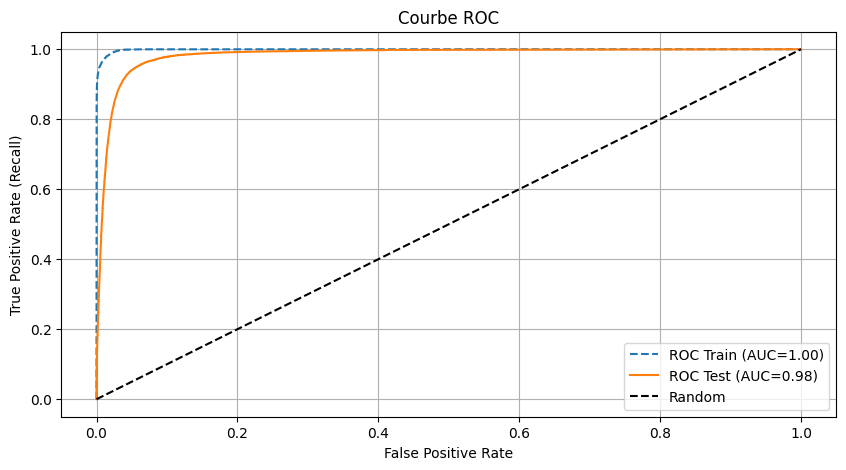

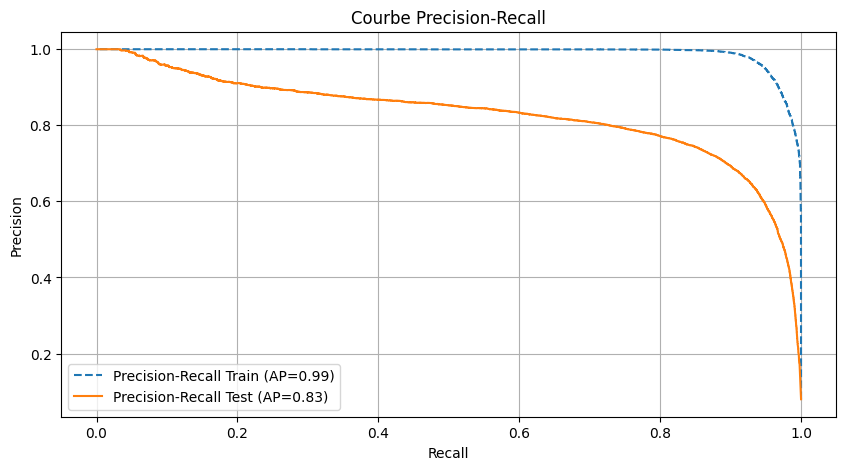

In [19]:
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, auc, precision_recall_curve, average_precision_score

# Prédictions sur le train set aussi
y_train_pred_proba = best_rf.predict_proba(X_train)[:, 1]
y_test_pred_proba = y_proba

# ROC
fpr_train, tpr_train, _ = roc_curve(y_train, y_train_pred_proba)
fpr_test, tpr_test, _ = roc_curve(y_test, y_test_pred_proba)

plt.figure(figsize=(10,5))
plt.plot(fpr_train, tpr_train, label=f"ROC Train (AUC={auc(fpr_train, tpr_train):.2f})", linestyle='--')
plt.plot(fpr_test, tpr_test, label=f"ROC Test (AUC={auc(fpr_test, tpr_test):.2f})")
plt.plot([0,1], [0,1], 'k--', label="Random")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate (Recall)")
plt.title("Courbe ROC")
plt.legend()
plt.grid()
plt.show()

# Precision-Recall
precision_train, recall_train, _ = precision_recall_curve(y_train, y_train_pred_proba)
precision_test, recall_test, _ = precision_recall_curve(y_test, y_test_pred_proba)

plt.figure(figsize=(10,5))
plt.plot(recall_train, precision_train, label=f"Precision-Recall Train (AP={average_precision_score(y_train, y_train_pred_proba):.2f})", linestyle='--')
plt.plot(recall_test, precision_test, label=f"Precision-Recall Test (AP={average_precision_score(y_test, y_test_pred_proba):.2f})")
plt.xlabel("Recall")
plt.ylabel("Precision")
plt.title("Courbe Precision-Recall")
plt.legend()
plt.grid()
plt.show()


In [15]:
# 1. On ajoute la probabilité de churn aux données X_test
X_test_with_proba = X_test.copy()
X_test_with_proba['proba_churn'] = y_proba

# 2. On récupère les bons subscriber_id depuis le DataFrame initial
# Il faut s'assurer qu'on a les bons index après le split
# => Utilisation de .loc avec les index de X_test pour bien récupérer les bons IDs
X_test_with_proba['subscriber_id'] = data_per_period.loc[X_test.index, 'subscriber_id'].values

# 3. Tri des clients selon la probabilité décroissante
top_churners = X_test_with_proba.sort_values('proba_churn', ascending=False)

# 4. Affichage des 20 clients les plus à risque
print(top_churners[['subscriber_id', 'proba_churn']].head(20))


        subscriber_id  proba_churn
391137     2151325071          1.0
380803     2178820934          1.0
375603     2176634137          1.0
380428     2177534154          1.0
379969     2177485400          1.0
383325     2178277272          1.0
369985     2177304753          1.0
379780     2178187196          1.0
381784     2177668248          1.0
380325     2178644745          1.0
372012     2177174593          1.0
385330     2177661790          1.0
388435     2177727487          1.0
373161     2177113359          1.0
366890     2177229551          1.0
380351     2177643583          1.0
387020     2177600594          1.0
384903     2177519563          1.0
383536     2177894261          1.0
386286     2177648554          1.0


In [20]:
import joblib

# Save the best model
joblib.dump(best_rf, 'best_random_forest_model.pkl')
print("✅ Model saved as 'best_random_forest_model.pkl'")


✅ Model saved as 'best_random_forest_model.pkl'


In [17]:
# Récupérer le meilleur pipeline entraîné
best_pipeline = random_search_rf.best_estimator_

# Extraire le modèle RandomForest depuis le pipeline
best_rf = best_pipeline.named_steps['rf']

# Récupérer l’importance des variables
importances = best_rf.feature_importances_

# Récupérer les noms de variables (features)
feature_names = X.columns  # X doit être un DataFrame pour garder les noms des colonnes

# Créer un DataFrame
import pandas as pd
feature_importance_df = pd.DataFrame({
    'Feature': feature_names,
    'Importance': importances
}).sort_values(by='Importance', ascending=False)

# Top 10
top_10 = feature_importance_df.head(10)


In [177]:
df_transformed=pd.read_csv('transformed_data_per_period_with_id.csv')

In [178]:
for col in df_transformed_per_period.columns:
    print(col)

churn
original_operator
dat_remb_kridi_net
tenure_days
has_international_call
time_to_churn
flag_smartphone
arpu_out_without_bonus_202407
arpu_out_without_bonus_202408
arpu_out_without_bonus_202409
arpu_out_without_bonus_202410
arpu_out_without_bonus_202411
arpu_out_without_bonus_202412
arpu_out_without_bonus_202501
bonus_on_consumption_revenue_202407
bonus_on_consumption_revenue_202408
bonus_on_consumption_revenue_202409
bonus_on_consumption_revenue_202410
bonus_on_consumption_revenue_202411
bonus_on_consumption_revenue_202412
bonus_on_consumption_revenue_202501
bonus_on_refill_flash_revenue_202407
bonus_on_refill_flash_revenue_202408
bonus_on_refill_flash_revenue_202409
bonus_on_refill_flash_revenue_202410
bonus_on_refill_flash_revenue_202411
bonus_on_refill_flash_revenue_202412
bonus_on_refill_flash_revenue_202501
bonus_on_refill_revenue_202407
bonus_on_refill_revenue_202408
bonus_on_refill_revenue_202409
bonus_on_refill_revenue_202410
bonus_on_refill_revenue_202411
bonus_on_refill_

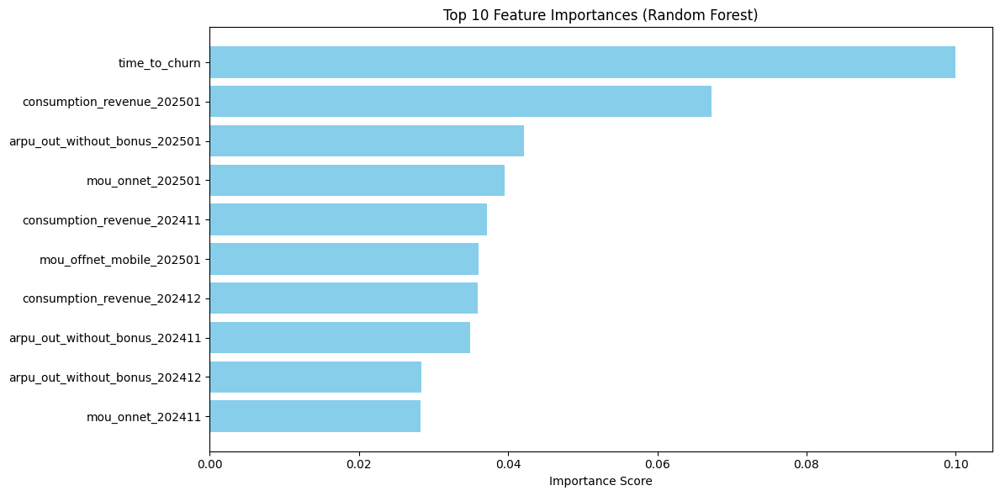

In [18]:
import matplotlib.pyplot as plt

plt.figure(figsize=(12, 6))
plt.barh(top_10['Feature'], top_10['Importance'], color='skyblue')
plt.gca().invert_yaxis()  # Pour avoir les plus importantes en haut
plt.title('Top 10 Feature Importances (Random Forest)')
plt.xlabel('Importance Score')
plt.tight_layout()
plt.show()


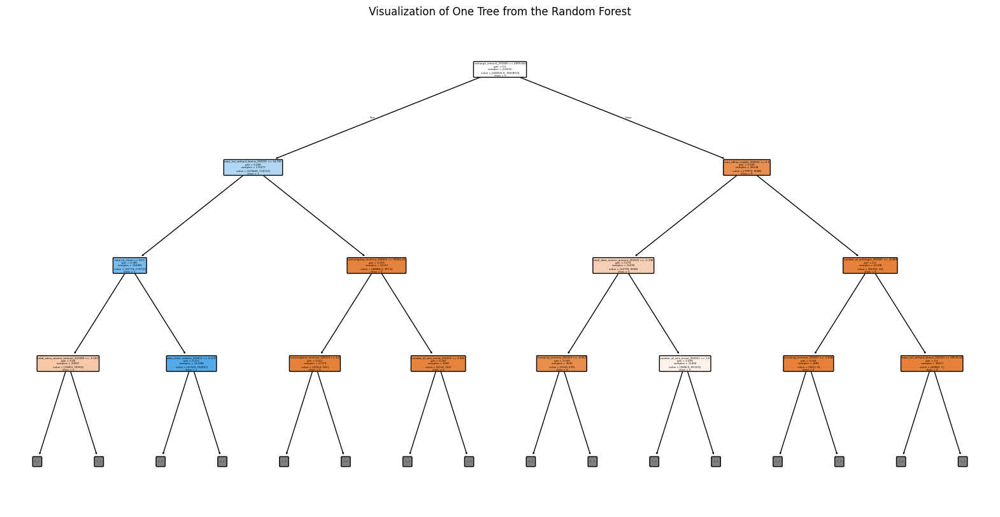

In [19]:
from sklearn.tree import plot_tree
import matplotlib.pyplot as plt

# 1. Récupère le meilleur pipeline
best_pipeline = random_search_rf.best_estimator_

# 2. Extraire le modèle RandomForest entraîné du pipeline
best_rf = best_pipeline.named_steps['rf']

# 3. Récupère le premier arbre du Random Forest (arbre numéro 0)
estimator = best_rf.estimators_[0]

# 4. Visualisation de l’arbre
plt.figure(figsize=(20, 10))
plot_tree(
    estimator,
    feature_names=X.columns,  # Assure-toi que X.columns est bien la liste de tes features
    class_names=[str(cls) for cls in best_rf.classes_],  # Ou [str(c) for c in y.unique()]
    filled=True,
    rounded=True,
    max_depth=3  # Pour limiter la taille de l’arbre sur le graphe (modifiable)
)
plt.title("Visualization of One Tree from the Random Forest")
plt.show()


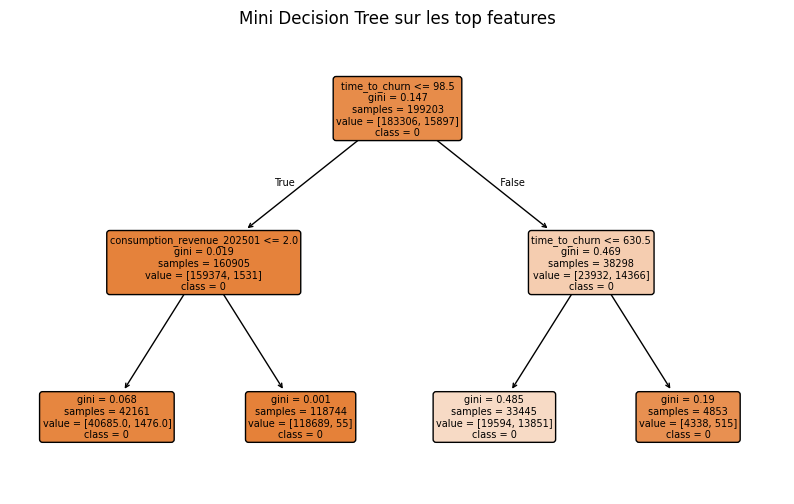

In [20]:
from sklearn.tree import DecisionTreeClassifier, plot_tree

# Prends quelques colonnes parmi les plus importantes
top_features = feature_importance_df['Feature'].head(3).tolist()

# Entraîne un mini-arbre pour l’exemple
mini_tree = DecisionTreeClassifier(max_depth=2, random_state=42)
mini_tree.fit(X_train[top_features], y_train)

plt.figure(figsize=(10,6))
plot_tree(mini_tree,
          feature_names=top_features,
          class_names=[str(cls) for cls in mini_tree.classes_],
          filled=True, rounded=True, max_depth=2)
plt.title("Mini Decision Tree sur les top features")
plt.show()


In [59]:
import pandas as pd
import numpy as np
import joblib
from sklearn.model_selection import train_test_split
from sklearn.metrics import precision_recall_curve, classification_report, confusion_matrix, roc_auc_score

# 1. Charger les données
df = pd.read_csv("final_df_transformed_per_period.csv")
features = [col for col in df.columns if col not in ["subscriber_id", "churn"]]
X = df[features]
y = df["churn"]

# 2. Split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, stratify=y, random_state=42)

# 3. Charger le modèle
model_rf = joblib.load("best_random_forest_model.pkl")

# 4. Fonction de prédiction par batch
def predict_proba_in_chunks(model, X, chunk_size=5000):
    proba = []
    for i in range(0, len(X), chunk_size):
        chunk = X.iloc[i:i+chunk_size]
        proba.extend(model.predict_proba(chunk)[:, 1])
    return np.array(proba)

# 5. Prédiction des probabilités sans surcharge mémoire
y_proba = predict_proba_in_chunks(model_rf, X_test)

# 6. Seuil optimal basé sur F1
precisions, recalls, thresholds = precision_recall_curve(y_test, y_proba)
f1_scores = 2 * precisions * recalls / (precisions + recalls + 1e-10)
best_idx = np.argmax(f1_scores)
best_threshold = thresholds[best_idx]

# 7. Prédiction
y_pred_opt = (y_proba >= best_threshold).astype(int)

# 8. Résultats
conf_matrix = confusion_matrix(y_test, y_pred_opt)
report = classification_report(y_test, y_pred_opt)
auc = roc_auc_score(y_test, y_proba)

# 9. Affichage
print(f"✅ Best threshold: {best_threshold:.3f}")
print(f"🎯 AUC: {auc:.4f}")
print("📊 Confusion Matrix:\n", conf_matrix)
print("📋 Classification Report:\n", report)

# 10. Sauvegarde du seuil
joblib.dump({"best_threshold": best_threshold}, "rf_threshold.pkl")
print("✅ Seuil sauvegardé dans rf_threshold.pkl")


✅ Best threshold: 0.510
🎯 AUC: 0.9826
📊 Confusion Matrix:
 [[107238   2746]
 [  1447   8091]]
📋 Classification Report:
               precision    recall  f1-score   support

           0       0.99      0.98      0.98    109984
           1       0.75      0.85      0.79      9538

    accuracy                           0.96    119522
   macro avg       0.87      0.91      0.89    119522
weighted avg       0.97      0.96      0.97    119522

✅ Seuil sauvegardé dans rf_threshold.pkl


### XGB

In [ ]:
import pandas as pd
import numpy as np
import joblib
from sklearn.model_selection import train_test_split
from sklearn.metrics import precision_recall_curve, roc_auc_score, classification_report, confusion_matrix, precision_score, recall_score, f1_score

# 📂 Chargement du modèle et des données
xgb_model = joblib.load("xgb_model.pkl")
df = pd.read_csv("final_df_transformed_per_period.csv")

# 🎯 Features et Target
X = df.drop(columns=["subscriber_id", "churn"])
y = df["churn"]

# 🧪 Split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, stratify=y, random_state=42)

# ✅ Aligner les features
expected_features = xgb_model.get_booster().feature_names

X_test_aligned = X_test.copy()
for col in expected_features:
    if col not in X_test_aligned.columns:
        X_test_aligned[col] = 0
X_test_aligned = X_test_aligned[expected_features]

# 🔮 Prédictions
y_proba = xgb_model.predict_proba(X_test_aligned)[:, 1]

# 🎯 Courbe PR et meilleur seuil
precisions, recalls, thresholds = precision_recall_curve(y_test, y_proba)
f1_scores = 2 * (precisions * recalls) / (precisions + recalls + 1e-10)
best_idx = np.argmax(f1_scores)
best_thresh = thresholds[best_idx]

# 🔀 Prédiction finale
y_pred = (y_proba >= best_thresh).astype(int)

# 📊 Évaluation
print(f"✅ Seuil optimal basé sur F1-score : {best_thresh:.4f}")
print(f"🔍 AUC: {roc_auc_score(y_test, y_proba):.4f}\n")
print("📋 Rapport de classification :")
print(classification_report(y_test, y_pred, digits=3))
print("📊 Matrice de confusion :")
print(confusion_matrix(y_test, y_pred))

# Résumé
print("\nRésumé :")
print(f"Precision: {precision_score(y_test, y_pred):.3f}")
print(f"Recall:    {recall_score(y_test, y_pred):.3f}")
print(f"F1-Score:  {f1_score(y_test, y_pred):.3f}")


✅ Seuil optimal basé sur F1-score : 0.5190
🔍 AUC: 0.9606

📋 Rapport de classification :
              precision    recall  f1-score   support

           0      0.980     0.942     0.961    109984
           1      0.537     0.778     0.636      9538

    accuracy                          0.929    119522
   macro avg      0.759     0.860     0.798    119522
weighted avg      0.945     0.929     0.935    119522

📊 Matrice de confusion :
[[103591   6393]
 [  2116   7422]]

Résumé :
Precision: 0.537
Recall:    0.778
F1-Score:  0.636


In [18]:
import joblib

# Sauvegarde du seuil optimal
joblib.dump({"best_threshold": best_thresh}, "xgb_threshold.pkl")
print("✅ Seuil sauvegardé dans xgb_threshold.pkl")


✅ Seuil sauvegardé dans xgb_threshold.pkl


In [14]:
expected_features = xgb_model.get_booster().feature_names


In [15]:
expected_features

['original_operator',
 'dat_remb_kridi_net',
 'tenure_days',
 'has_international_call',
 'time_to_churn',
 'flag_smartphone',
 'arpu_out_without_bonus_202407',
 'arpu_out_without_bonus_202408',
 'arpu_out_without_bonus_202409',
 'arpu_out_without_bonus_202410',
 'arpu_out_without_bonus_202411',
 'arpu_out_without_bonus_202412',
 'arpu_out_without_bonus_202501',
 'bonus_on_consumption_revenue_202407',
 'bonus_on_consumption_revenue_202408',
 'bonus_on_consumption_revenue_202409',
 'bonus_on_consumption_revenue_202410',
 'bonus_on_consumption_revenue_202411',
 'bonus_on_consumption_revenue_202412',
 'bonus_on_consumption_revenue_202501',
 'bonus_on_refill_flash_revenue_202407',
 'bonus_on_refill_flash_revenue_202408',
 'bonus_on_refill_flash_revenue_202409',
 'bonus_on_refill_flash_revenue_202410',
 'bonus_on_refill_flash_revenue_202411',
 'bonus_on_refill_flash_revenue_202412',
 'bonus_on_refill_flash_revenue_202501',
 'bonus_on_refill_revenue_202407',
 'bonus_on_refill_revenue_202408',

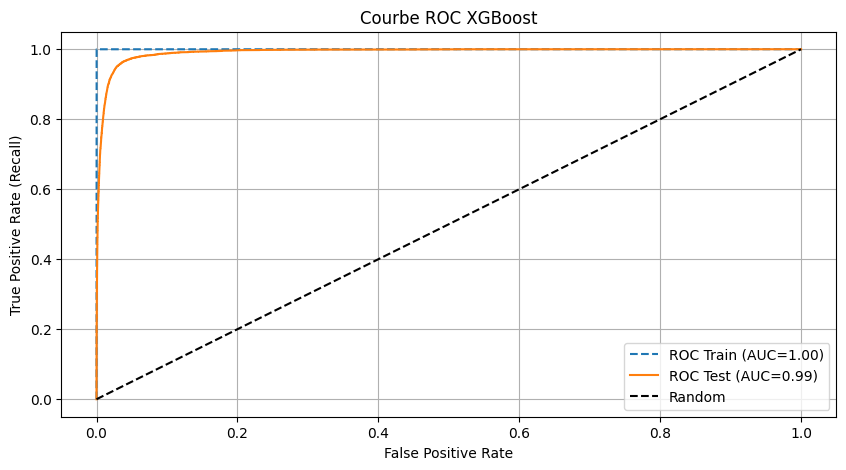

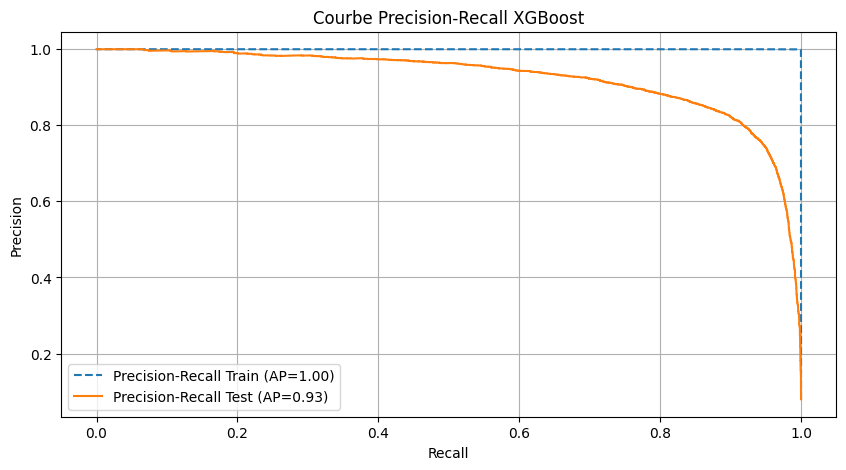

In [23]:
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, auc, precision_recall_curve, average_precision_score, confusion_matrix

# Prédictions proba
y_train_pred_proba = xgb_model.predict_proba(X_train)[:, 1]
y_test_pred_proba = xgb_model.predict_proba(X_test)[:, 1]

# ROC curves
fpr_train, tpr_train, _ = roc_curve(y_train, y_train_pred_proba)
fpr_test, tpr_test, _ = roc_curve(y_test, y_test_pred_proba)

plt.figure(figsize=(10, 5))
plt.plot(fpr_train, tpr_train, label=f"ROC Train (AUC={auc(fpr_train, tpr_train):.2f})", linestyle='--')
plt.plot(fpr_test, tpr_test, label=f"ROC Test (AUC={auc(fpr_test, tpr_test):.2f})")
plt.plot([0, 1], [0, 1], 'k--', label="Random")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate (Recall)")
plt.title("Courbe ROC XGBoost")
plt.legend()
plt.grid()
plt.show()

# Precision-Recall
precision_train, recall_train, _ = precision_recall_curve(y_train, y_train_pred_proba)
precision_test, recall_test, _ = precision_recall_curve(y_test, y_test_pred_proba)

plt.figure(figsize=(10, 5))
plt.plot(recall_train, precision_train, label=f"Precision-Recall Train (AP={average_precision_score(y_train, y_train_pred_proba):.2f})", linestyle='--')
plt.plot(recall_test, precision_test, label=f"Precision-Recall Test (AP={average_precision_score(y_test, y_test_pred_proba):.2f})")
plt.xlabel("Recall")
plt.ylabel("Precision")
plt.title("Courbe Precision-Recall XGBoost")
plt.legend()
plt.grid()
plt.show()


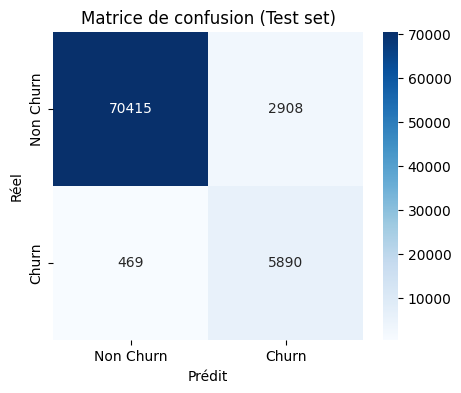

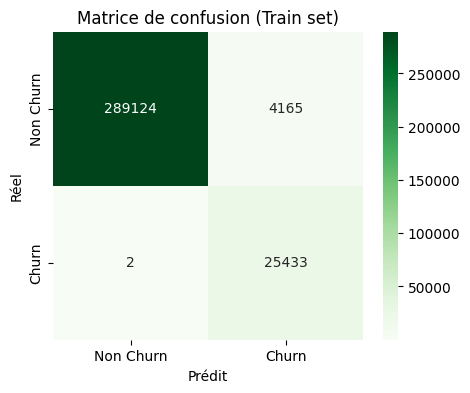

In [ ]:
import seaborn as sns

# Test set
y_test_pred = xgb_model.predict(X_test)
cm_test = confusion_matrix(y_test, y_test_pred)
plt.figure(figsize=(5,4))
sns.heatmap(cm_test, annot=True, fmt='d', cmap='Blues',
            xticklabels=['Non Churn', 'Churn'],
            yticklabels=['Non Churn', 'Churn'])
plt.xlabel('Prédit')
plt.ylabel('Réel')
plt.title('Matrice de confusion (Test set)')
plt.show()

# Train set
y_train_pred = xgb_model.predict(X_train_scaled)
cm_train = confusion_matrix(y_train, y_train_pred)
plt.figure(figsize=(5,4))
sns.heatmap(cm_train, annot=True, fmt='d', cmap='Greens',
            xticklabels=['Non Churn', 'Churn'],
            yticklabels=['Non Churn', 'Churn'])
plt.xlabel('Prédit')
plt.ylabel('Réel')
plt.title('Matrice de confusion (Train set)')
plt.show()


In [25]:
# Supposons que tu as sauvegardé les index de X_test ou as 'subscriber_id'
X_test_index = X_test.index
if 'subscriber_id' in data_per_period.columns:
    subscribers = data_per_period.loc[X_test_index, 'subscriber_id']
else:
    subscribers = X_test_index  # Sinon, l'index sert d'identifiant

clients_proba = pd.DataFrame({
    'subscriber_id': subscribers,
    'proba_churn': y_test_pred_proba,
    'true_churn': y_test.values
})

# Trier par proba décroissante
top_churners = clients_proba.sort_values('proba_churn', ascending=False)
print(top_churners.head(20))

# Clients à très haut risque (exemple proba > 0.8)
high_risk = top_churners[top_churners['proba_churn'] > 0.8]
print(f"\nNombre de clients à proba_churn > 0.8 : {len(high_risk)}")
print(high_risk.head(10))


        subscriber_id  proba_churn  true_churn
379550     2179567695     0.999999           1
387192     2179473187     0.999999           1
372138     2177244955     0.999999           1
379940     2179491465     0.999998           1
378666     2179595692     0.999998           1
382585     2179532290     0.999998           1
380546     2179515643     0.999998           1
383868     2179439818     0.999998           1
387120     2179494364     0.999998           1
382645     2179383887     0.999998           1
386610     2179465585     0.999998           1
381004     2179484991     0.999998           1
379515     2179477983     0.999998           1
387979     2179475335     0.999998           1
370618     2177282518     0.999998           1
385774     2179466695     0.999998           1
378719     2179584214     0.999998           1
376261     2177298495     0.999998           1
388921     2178780072     0.999998           1
387051     2179496268     0.999998           1

Nombre de cl

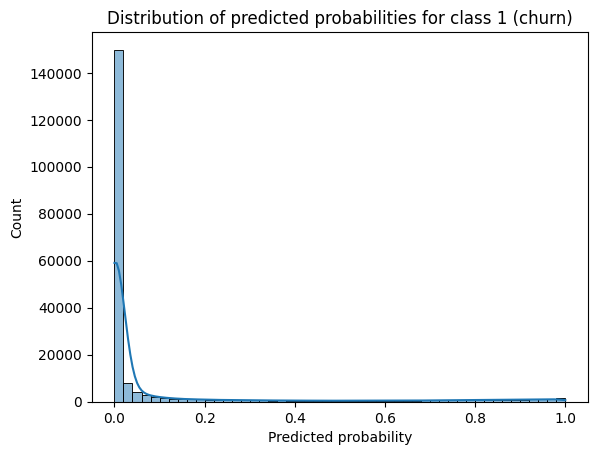

In [26]:
import seaborn as sns
sns.histplot(y_proba, bins=50, kde=True)
plt.title("Distribution of predicted probabilities for class 1 (churn)")
plt.xlabel("Predicted probability")
plt.show()


In [ ]:
import pickle

# 1. Sauvegarder le modèle XGBoost
with open('xgb_model.pkl', 'wb') as f:
    pickle.dump(xgb_model, f)



print("✅ Modèle et scaler sauvegardés dans xgb_model.pkl et scaler.pkl")


✅ Modèle et scaler sauvegardés dans xgb_model.pkl et scaler.pkl


In [30]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from imblearn.over_sampling import ADASYN
from sklearn.metrics import classification_report
import xgboost as xgb

# 1. Drop IDs and dates from features
cols_to_drop = ['churn', 'subscriber_id', 'date_activation', 'first_call_date', 'last_call_date']
X = data_per_period.drop(cols_to_drop, axis=1, errors='ignore')
y = data_per_period['churn']

# 2. Convert categoricals if needed
if len(X.select_dtypes(include=['object', 'category']).columns) > 0:
    X = pd.get_dummies(X, drop_first=True, dtype=float)

# 3. Train/test split BEFORE resampling/scaling!
X_train, X_test, y_train, y_test = train_test_split(X, y, stratify=y, test_size=0.2, random_state=42)



adasyn = ADASYN(random_state=42)
X_train_bal, y_train_bal = adasyn.fit_resample(X_train, y_train)

# 5. XGBoost with lower max_depth
xgb_model = xgb.XGBClassifier(
    max_depth=6,
    learning_rate=0.1,
    n_estimators=200,
    objective='binary:logistic',
    random_state=42,
    n_jobs=-1,
    scale_pos_weight=(len(y_train_bal) - sum(y_train_bal)) / sum(y_train_bal)
)

xgb_model.fit(X_train_bal, y_train_bal)

# 6. Evaluate
for split, Xx, yy in [
    ("Train", X_train_bal, y_train_bal),
    ("Test", X_test, y_test)
]:
    y_pred = xgb_model.predict(Xx)
    print(f"\n{split} set evaluation:\n", classification_report(yy, y_pred))



Train set evaluation:
               precision    recall  f1-score   support

           0       0.99      0.98      0.98    293289
           1       0.98      0.99      0.98    294141

    accuracy                           0.98    587430
   macro avg       0.98      0.98      0.98    587430
weighted avg       0.98      0.98      0.98    587430


Test set evaluation:
               precision    recall  f1-score   support

           0       0.99      0.98      0.99     73323
           1       0.80      0.90      0.85      6359

    accuracy                           0.97     79682
   macro avg       0.90      0.94      0.92     79682
weighted avg       0.98      0.97      0.98     79682



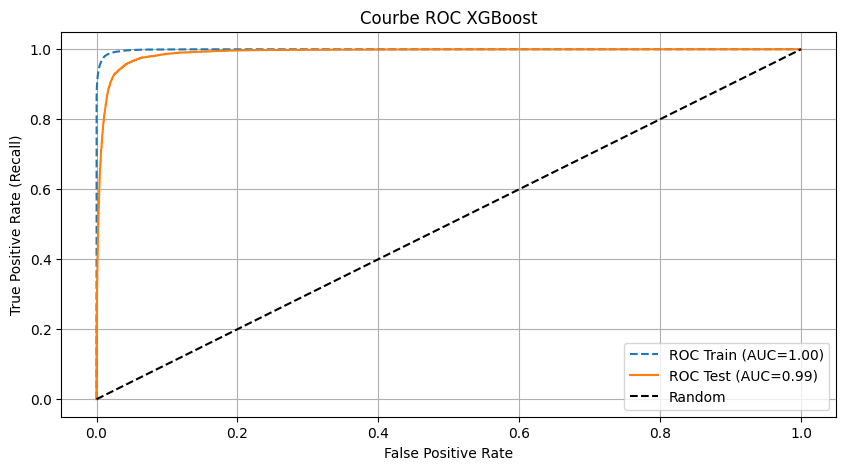

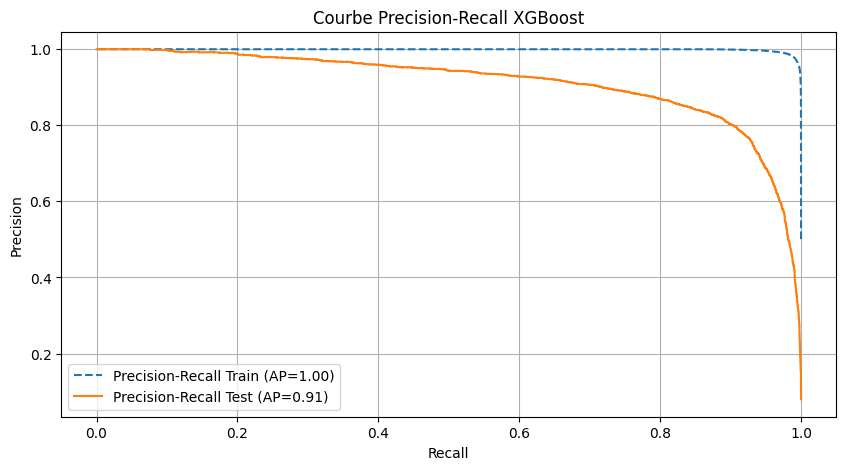

In [32]:
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, auc, precision_recall_curve, average_precision_score, confusion_matrix
import seaborn as sns
import pandas as pd

# Prédictions proba
y_train_pred_proba = xgb_model.predict_proba(X_train_bal)[:, 1]
y_test_pred_proba = xgb_model.predict_proba(X_test)[:, 1]

# ROC curves
fpr_train, tpr_train, _ = roc_curve(y_train_bal, y_train_pred_proba)
fpr_test, tpr_test, _ = roc_curve(y_test, y_test_pred_proba)

plt.figure(figsize=(10, 5))
plt.plot(fpr_train, tpr_train, label=f"ROC Train (AUC={auc(fpr_train, tpr_train):.2f})", linestyle='--')
plt.plot(fpr_test, tpr_test, label=f"ROC Test (AUC={auc(fpr_test, tpr_test):.2f})")
plt.plot([0, 1], [0, 1], 'k--', label="Random")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate (Recall)")
plt.title("Courbe ROC XGBoost")
plt.legend()
plt.grid()
plt.show()

# Precision-Recall
precision_train, recall_train, _ = precision_recall_curve(y_train_bal, y_train_pred_proba)
precision_test, recall_test, _ = precision_recall_curve(y_test, y_test_pred_proba)

plt.figure(figsize=(10, 5))
plt.plot(recall_train, precision_train, label=f"Precision-Recall Train (AP={average_precision_score(y_train_bal, y_train_pred_proba):.2f})", linestyle='--')
plt.plot(recall_test, precision_test, label=f"Precision-Recall Test (AP={average_precision_score(y_test, y_test_pred_proba):.2f})")
plt.xlabel("Recall")
plt.ylabel("Precision")
plt.title("Courbe Precision-Recall XGBoost")
plt.legend()
plt.grid()
plt.show()


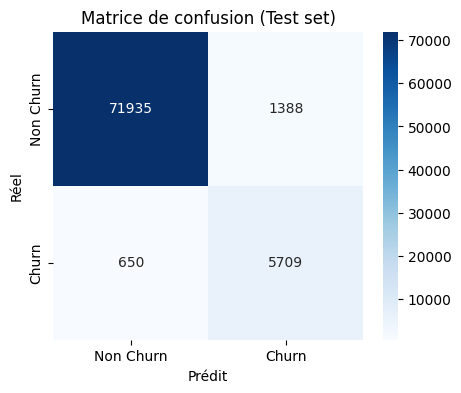

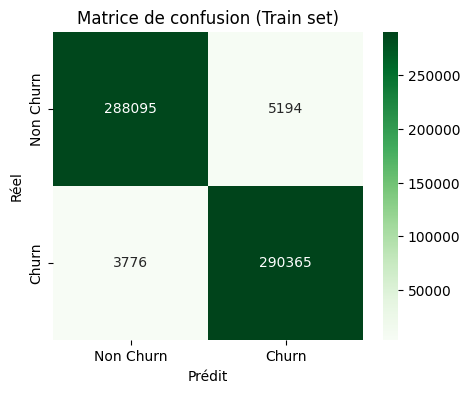

In [34]:
# Test set
y_test_pred = xgb_model.predict(X_test)
cm_test = confusion_matrix(y_test, y_test_pred)
plt.figure(figsize=(5,4))
sns.heatmap(cm_test, annot=True, fmt='d', cmap='Blues',
            xticklabels=['Non Churn', 'Churn'],
            yticklabels=['Non Churn', 'Churn'])
plt.xlabel('Prédit')
plt.ylabel('Réel')
plt.title('Matrice de confusion (Test set)')
plt.show()

# Train set (balance)
y_train_pred = xgb_model.predict(X_train_bal)
cm_train = confusion_matrix(y_train_bal, y_train_pred)
plt.figure(figsize=(5,4))
sns.heatmap(cm_train, annot=True, fmt='d', cmap='Greens',
            xticklabels=['Non Churn', 'Churn'],
            yticklabels=['Non Churn', 'Churn'])
plt.xlabel('Prédit')
plt.ylabel('Réel')
plt.title('Matrice de confusion (Train set)')
plt.show()


In [36]:
# Récupère les index de X_test dans la table d'origine
test_indices = X_test.index
if 'subscriber_id' in data_per_period.columns:
    subscribers = data_per_period.loc[test_indices, 'subscriber_id']
else:
    subscribers = test_indices  # sinon index

clients_proba = pd.DataFrame({
    'subscriber_id': subscribers,
    'proba_churn': y_test_pred_proba,
    'true_churn': y_test.values
})

# Trier par proba décroissante
top_churners = clients_proba.sort_values('proba_churn', ascending=False)
print(top_churners.head(20))

# Clients à très haut risque (exemple proba > 0.8)
high_risk = top_churners[top_churners['proba_churn'] > 0.8]
print(f"\nNombre de clients à proba_churn > 0.8 : {len(high_risk)}")
print(high_risk.head(10))

# (Optionnel) Export
high_risk.to_csv("clients_fort_risque_churn_xgb.csv", index=False)


        subscriber_id  proba_churn  true_churn
379418     2178370286     0.999324           1
382265     2178661266     0.998765           1
383642     2178094307     0.998750           1
388238     2178655685     0.998720           1
387937     2178417367     0.998668           1
384873     2178501968     0.998535           1
382575     2178022427     0.998510           1
380643     2178570767     0.997929           1
384868     2179187572     0.997870           1
386641     2178635497     0.997740           1
387120     2179494364     0.997635           1
380082     2178413008     0.997379           1
387459     2179354874     0.997337           1
372138     2177244955     0.997117           1
386610     2179465585     0.997002           1
385908     2178512845     0.996938           1
379645     2178554951     0.996930           1
380519     2178746626     0.996814           1
384237     2179533254     0.996720           1
385554     2178431233     0.996633           1

Nombre de cl

In [38]:
import xgboost as xgb
from sklearn.model_selection import train_test_split
from imblearn.over_sampling import ADASYN
from sklearn.metrics import classification_report
from sklearn.preprocessing import StandardScaler
import pandas as pd
import numpy as np

# 1. Préparation des données (drop des colonnes non utilisables)
cols_to_drop = 'churn'
X = data_per_period.drop(cols_to_drop, axis=1, errors='ignore')
y = data_per_period['churn']

# 2. Encodage one-hot si besoin
if len(X.select_dtypes(include=['object', 'category']).columns) > 0:
    X = pd.get_dummies(X, drop_first=True, dtype=float)

# 3. Split train/test AVANT équilibrage et scaling !
X_train, X_test, y_train, y_test = train_test_split(X, y, stratify=y, test_size=0.2, random_state=42)



# 5. Balance (ADASYN) uniquement sur le TRAIN
adasyn = ADASYN(random_state=42)
X_train_bal, y_train_bal = adasyn.fit_resample(X_train, y_train)

# 6. Conversion en DMatrix (optionnel, pour XGBoost natif)
dtrain = xgb.DMatrix(X_train_bal, label=y_train_bal)
dtest = xgb.DMatrix(X_test, label=y_test)

# 7. Paramètres XGBoost
params = {
    'max_depth': 10,
    'learning_rate': 0.1,
    'objective': 'binary:logistic',
    'eval_metric': 'logloss',
    'scale_pos_weight': (len(y_train_bal) - sum(y_train_bal)) / sum(y_train_bal),
    'min_child_weight': 3,
}

# 8. Entraînement avec early stopping
evals = [(dtrain, 'train'), (dtest, 'eval')]
xgb_model = xgb.train(
    params=params,
    dtrain=dtrain,
    num_boost_round=200,
    evals=evals,
    early_stopping_rounds=10,
    verbose_eval=True
)

# 9. Meilleur itération
best_iteration = xgb_model.best_iteration
print(f"Best iteration: {best_iteration}")

# 10. Prédictions PROBA pour courbes de précision-rappel
y_pred_proba = xgb_model.predict(dtest, iteration_range=(0, best_iteration))



# 13. Si tu veux choisir un SEUIL OPTIMAL, fais-le ici (ex: 0.72)
optimal_threshold = 0.72
y_pred_optimal = (y_pred_proba > optimal_threshold).astype(int)
print("\nClassification report (seuil optimal):\n", classification_report(y_test, y_pred_optimal))


[0]	train-logloss:0.60708	eval-logloss:0.60944
[1]	train-logloss:0.53650	eval-logloss:0.54110
[2]	train-logloss:0.47760	eval-logloss:0.48411
[3]	train-logloss:0.42777	eval-logloss:0.43604
[4]	train-logloss:0.38521	eval-logloss:0.39508
[5]	train-logloss:0.34802	eval-logloss:0.35913
[6]	train-logloss:0.31566	eval-logloss:0.32815
[7]	train-logloss:0.28741	eval-logloss:0.30113
[8]	train-logloss:0.26266	eval-logloss:0.27762
[9]	train-logloss:0.24080	eval-logloss:0.25675
[10]	train-logloss:0.22136	eval-logloss:0.23814
[11]	train-logloss:0.20377	eval-logloss:0.22122
[12]	train-logloss:0.18821	eval-logloss:0.20635
[13]	train-logloss:0.17422	eval-logloss:0.19301
[14]	train-logloss:0.16170	eval-logloss:0.18119
[15]	train-logloss:0.15053	eval-logloss:0.17071
[16]	train-logloss:0.14037	eval-logloss:0.16108
[17]	train-logloss:0.13129	eval-logloss:0.15270
[18]	train-logloss:0.12311	eval-logloss:0.14508
[19]	train-logloss:0.11573	eval-logloss:0.13818
[20]	train-logloss:0.10918	eval-logloss:0.13216
[2

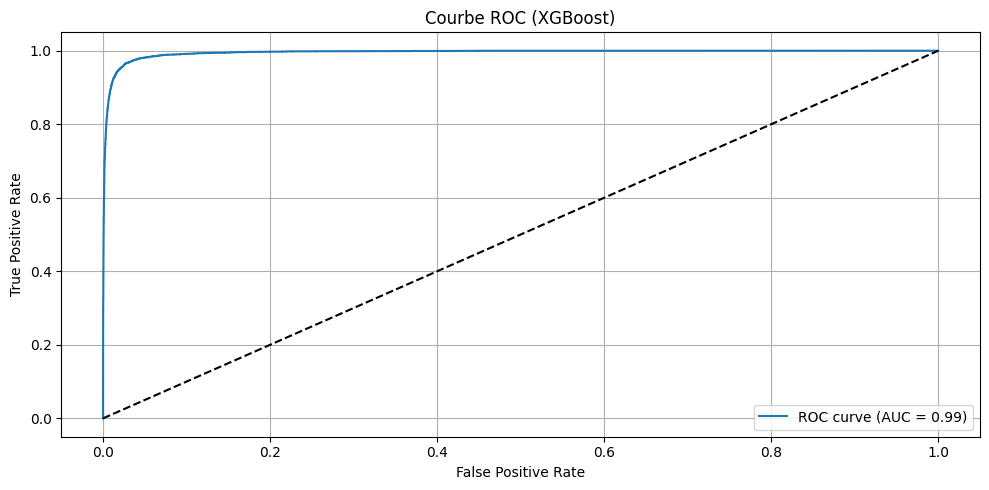

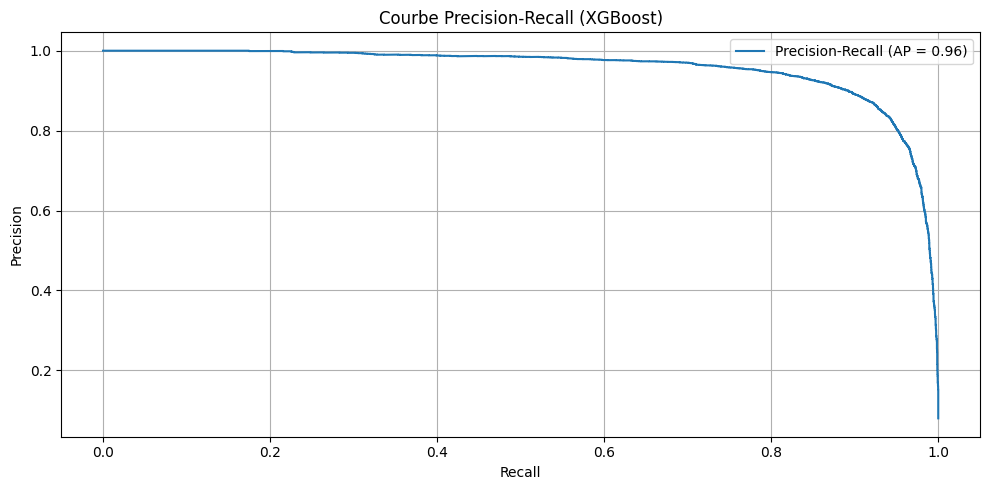

In [39]:
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, auc, precision_recall_curve, average_precision_score, confusion_matrix

# ROC et Precision-Recall avec le meilleur seuil ou avec 0.5
fpr, tpr, _ = roc_curve(y_test, y_pred_proba)
roc_auc = auc(fpr, tpr)

precision, recall, _ = precision_recall_curve(y_test, y_pred_proba)
ap = average_precision_score(y_test, y_pred_proba)

plt.figure(figsize=(10, 5))
plt.plot(fpr, tpr, label=f'ROC curve (AUC = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Courbe ROC (XGBoost)')
plt.legend()
plt.grid()
plt.tight_layout()
plt.savefig("roc_curve_xgb_natif.png")
plt.show()

plt.figure(figsize=(10, 5))
plt.plot(recall, precision, label=f'Precision-Recall (AP = {ap:.2f})')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Courbe Precision-Recall (XGBoost)')
plt.legend()
plt.grid()
plt.tight_layout()
plt.savefig("precision_recall_curve_xgb_natif.png")
plt.show()


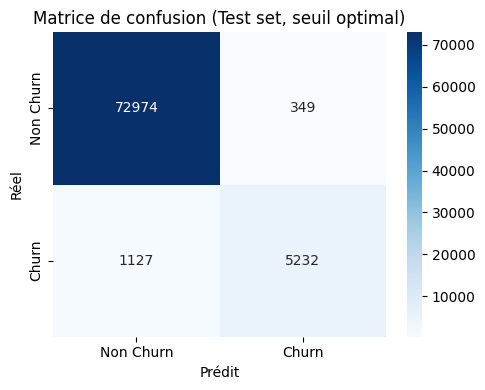

In [40]:
import seaborn as sns

cm = confusion_matrix(y_test, y_pred_optimal)
plt.figure(figsize=(5,4))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=['Non Churn', 'Churn'],
            yticklabels=['Non Churn', 'Churn'])
plt.xlabel('Prédit')
plt.ylabel('Réel')
plt.title('Matrice de confusion (Test set, seuil optimal)')
plt.tight_layout()
plt.savefig("confusion_matrix_xgb_natif.png")
plt.show()


In [41]:
# Suppose que tu as subscriber_id dans ta table d'origine
test_indices = X_test.index
if 'subscriber_id' in data_per_period.columns:
    subscribers = data_per_period.loc[test_indices, 'subscriber_id']
else:
    subscribers = test_indices

clients_proba = pd.DataFrame({
    'subscriber_id': subscribers,
    'proba_churn': y_pred_proba,
    'true_churn': y_test.values
})

# Trier par proba décroissante
top_churners = clients_proba.sort_values('proba_churn', ascending=False)
print("\nTop 20 clients à fort risque de churn :")
print(top_churners.head(20))

# Clients à proba > 0.8 (modifie si besoin)
high_risk = top_churners[top_churners['proba_churn'] > 0.8]
high_risk.to_csv("clients_fort_risque_churn_xgb_natif.csv", index=False)
print(f"\nNombre de clients à proba_churn > 0.8 : {len(high_risk)}")
print(high_risk.head(10))



Top 20 clients à fort risque de churn :
        subscriber_id  proba_churn  true_churn
385059     2179464313     0.999838           1
386323     2179566116     0.999785           1
378146     2179593406     0.999768           1
382276     2179299411     0.999758           1
380177     2179563574     0.999754           1
383706     2179518267     0.999747           1
379418     2178370286     0.999744           1
379507     2179570739     0.999734           1
376359     2177281077     0.999732           1
378430     2179663171     0.999721           1
387120     2179494364     0.999703           1
378111     2179653490     0.999702           1
386054     2179481312     0.999700           1
382319     2178440716     0.999698           1
380470     2179476451     0.999683           1
384237     2179533254     0.999680           1
368085     2177185632     0.999679           1
370706     2177203709     0.999676           1
385179     2179352801     0.999664           1
380652     21795196

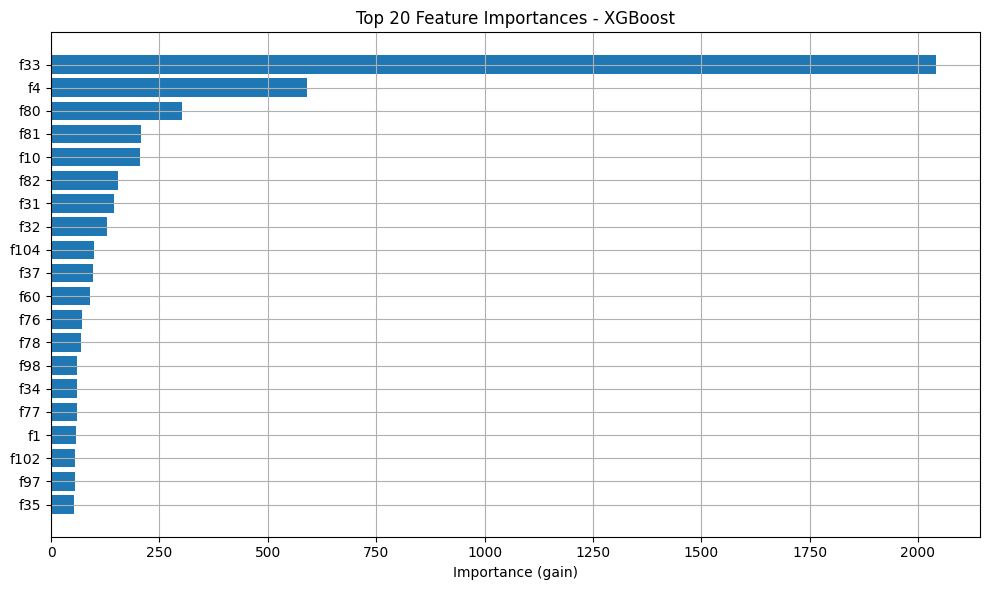

📁 Importances sauvegardées sous 'xgboost_feature_importances.csv'


In [253]:
# 12. Importance des variables
importances = xgb_model.get_score(importance_type='gain')  # ou 'weight', 'cover', 'total_gain', etc.
importances_df = pd.DataFrame({
    'feature': list(importances.keys()),
    'importance': list(importances.values())
}).sort_values(by='importance', ascending=False)

# Affichage graphique
plt.figure(figsize=(10, 6))
plt.barh(importances_df['feature'][:20][::-1], importances_df['importance'][:20][::-1])
plt.xlabel("Importance (gain)")
plt.title("Top 20 Feature Importances - XGBoost")
plt.tight_layout()
plt.grid(True)
plt.show()

# Sauvegarde CSV
importances_df.to_csv("xgboost_feature_importances.csv", index=False)
print("📁 Importances sauvegardées sous 'xgboost_feature_importances.csv'")


In [42]:
import pickle

# Sauvegarder le booster xgb natif dans un fichier .pkl
with open("xgb_model_native.pkl", "wb") as f:
    pickle.dump(xgb_model, f)

print("✅ Modèle XGBoost natif sauvegardé dans xgb_model_native.pkl")


✅ Modèle XGBoost natif sauvegardé dans xgb_model_native.pkl


In [255]:
%matplotlib inline


### LGB

In [11]:
import lightgbm as lgb
from sklearn.experimental import enable_halving_search_cv
from sklearn.model_selection import HalvingRandomSearchCV, train_test_split
from sklearn.metrics import classification_report
from imblearn.over_sampling import ADASYN
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
import pandas as pd




# 1.3. Train/test split
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.5, stratify=y, random_state=42
)




In [24]:
adasyn = ADASYN(random_state=42)
X_train_bal, y_train_bal = adasyn.fit_resample(X_train, y_train)


In [25]:
# Paramètres LightGBM
param_dist = {
    'max_depth': [3, 5],
    'learning_rate': [0.05, 0.1],
    'n_estimators': [100, 200],
    'subsample': [0.8, 1.0],
    'colsample_bytree': [0.8, 1.0],
    'min_child_samples': [20, 50],
    'num_leaves': [31, 50],
}

lgb_model = lgb.LGBMClassifier(
    objective='binary', metric='binary_logloss', random_state=42
)

halving_search = HalvingRandomSearchCV(
    estimator=lgb_model,
    param_distributions=param_dist,
    scoring='f1',
    factor=3,
    random_state=42,
    n_jobs=-1,
    verbose=1
)

# Fit sur les données BALANCED
halving_search.fit(X_train_bal, y_train_bal)

best_model_lgb = halving_search.best_estimator_
print("Best Parameters:", halving_search.best_params_)


n_iterations: 5
n_required_iterations: 5
n_possible_iterations: 9
min_resources_: 20
max_resources_: 367318
aggressive_elimination: False
factor: 3
----------
iter: 0
n_candidates: 128
n_resources: 20
Fitting 5 folds for each of 128 candidates, totalling 640 fits
----------
iter: 1
n_candidates: 43
n_resources: 60
Fitting 5 folds for each of 43 candidates, totalling 215 fits
----------
iter: 2
n_candidates: 15
n_resources: 180
Fitting 5 folds for each of 15 candidates, totalling 75 fits
----------
iter: 3
n_candidates: 5
n_resources: 540
Fitting 5 folds for each of 5 candidates, totalling 25 fits
----------
iter: 4
n_candidates: 2
n_resources: 1620
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 184012, number of negative: 183306
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.059072 seconds.
You can set `force_row_wis

In [26]:
y_pred = best_model_lgb.predict(X_test)
print("Classification Report:\n", classification_report(y_test, y_pred))


Classification Report:
               precision    recall  f1-score   support

           0       0.99      0.96      0.98    183306
           1       0.67      0.86      0.75     15897

    accuracy                           0.96    199203
   macro avg       0.83      0.91      0.86    199203
weighted avg       0.96      0.96      0.96    199203



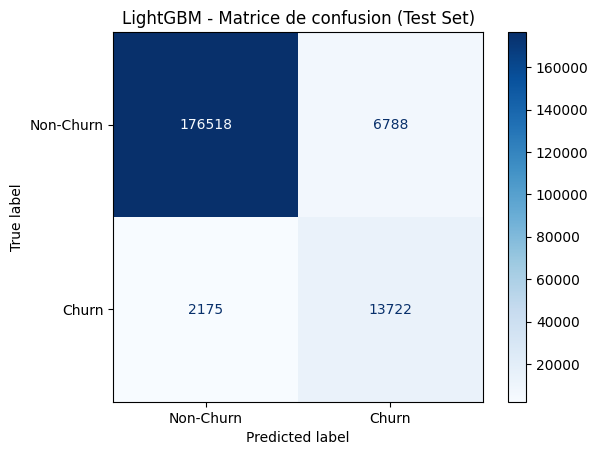

In [28]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import matplotlib.pyplot as plt

cm = confusion_matrix(y_test, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=['Non-Churn', 'Churn'])
disp.plot(cmap='Blues')
plt.title('LightGBM - Matrice de confusion (Test Set)')
plt.show()


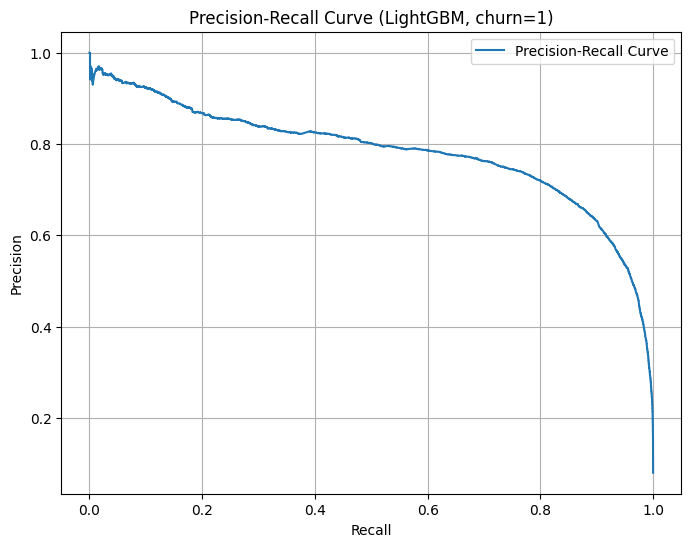

In [29]:
from sklearn.metrics import precision_recall_curve

y_proba = best_model_lgb.predict_proba(X_test)[:, 1]
precision, recall, thresholds = precision_recall_curve(y_test, y_proba)

plt.figure(figsize=(8,6))
plt.plot(recall, precision, label="Precision-Recall Curve")
plt.xlabel("Recall")
plt.ylabel("Precision")
plt.title("Precision-Recall Curve (LightGBM, churn=1)")
plt.legend()
plt.grid()
plt.show()


In [30]:
import numpy as np
from sklearn.metrics import f1_score

f1_scores = []
for t in thresholds:
    preds = (y_proba >= t).astype(int)
    f1_scores.append(f1_score(y_test, preds))

best_idx = np.argmax(f1_scores)
best_thresh = thresholds[best_idx]
print(f"Best threshold: {best_thresh:.2f} | F1-score: {f1_scores[best_idx]:.2f}")

# Optionnel: Prédictions avec ce seuil
y_pred_best = (y_proba >= best_thresh).astype(int)
print(classification_report(y_test, y_pred_best))


Best threshold: 0.57 | F1-score: 0.76
              precision    recall  f1-score   support

           0       0.98      0.97      0.98    183306
           1       0.71      0.82      0.76     15897

    accuracy                           0.96    199203
   macro avg       0.85      0.90      0.87    199203
weighted avg       0.96      0.96      0.96    199203



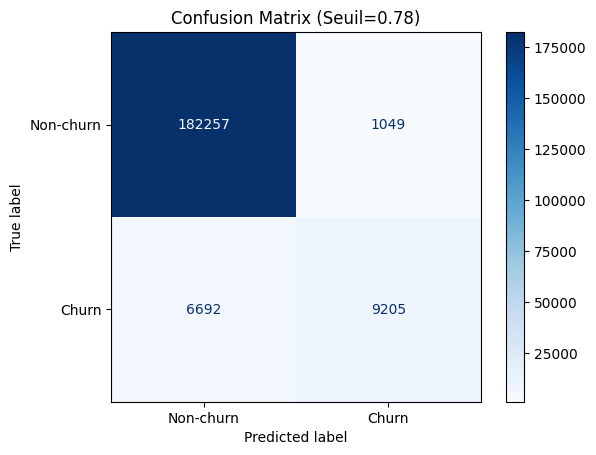

In [52]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

y_pred_best = (y_proba >= 0.78).astype(int)
cm = confusion_matrix(y_test, y_pred_best)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=['Non-churn', 'Churn'])
disp.plot(cmap='Blues')
plt.title(f'Confusion Matrix (Seuil={0.78})')
plt.show()


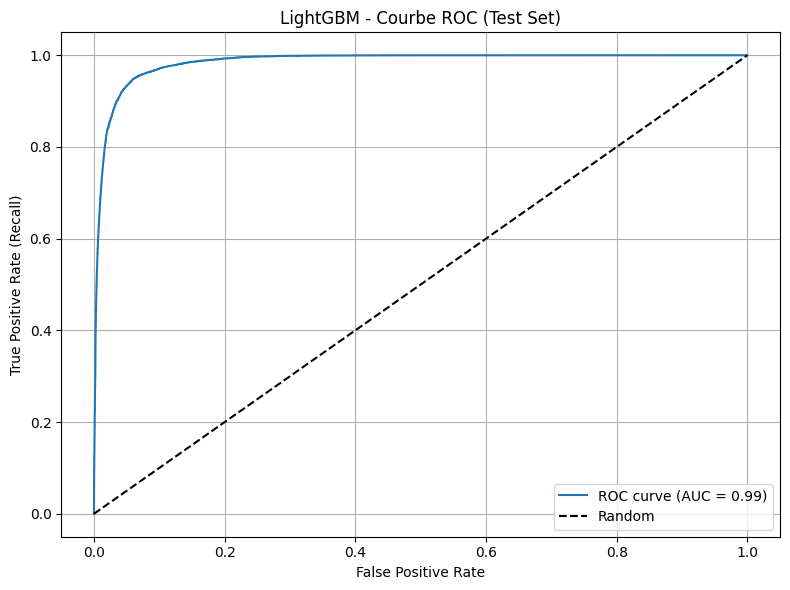

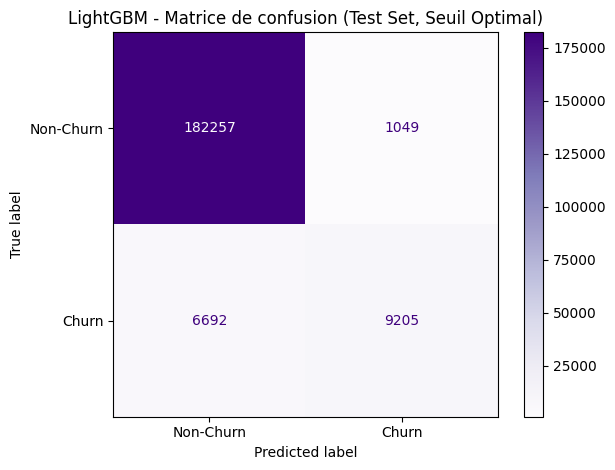

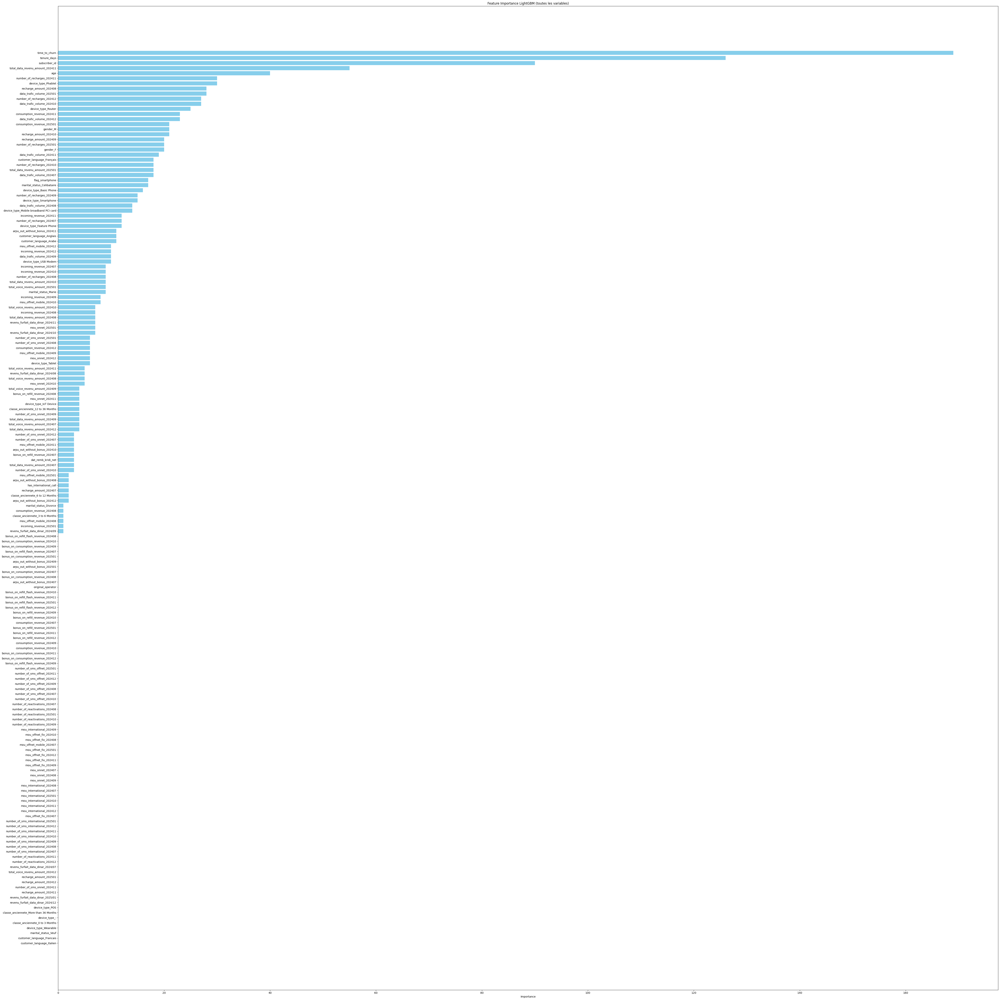


Top 20 clients à fort risque de churn :
        subscriber_id  proba_churn  true_churn
381766     2178384715     0.995194           1
387720     2178184531     0.995097           1
379272     2178365020     0.994701           1
385616     2170657879     0.993817           1
386728     2178355956     0.993314           1
383999     2178663820     0.993255           1
381606     2178832992     0.992652           1
387200     2178522122     0.992169           1
378085     2177699879     0.991224           1
384609     2178780920     0.991211           1
387432     2178422753     0.990916           1
385843     2177803328     0.990810           1
385220     2177907855     0.990194           1
380235     2177663756     0.990071           1
381431     2178636145     0.989796           1
382247     2178482319     0.989575           1
387931     2178619365     0.989489           1
384448     2179484956     0.989344           1
385861     2177839730     0.989288           1
388421     21786412

In [53]:
from sklearn.metrics import roc_curve, auc, precision_recall_curve, average_precision_score, confusion_matrix, f1_score
import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

# 1. Courbe ROC
fpr, tpr, _ = roc_curve(y_test, y_proba)
roc_auc = auc(fpr, tpr)

plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, label=f'ROC curve (AUC = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], 'k--', label="Random")
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate (Recall)')
plt.title('LightGBM - Courbe ROC (Test Set)')
plt.legend()
plt.grid()
plt.tight_layout()
plt.savefig("roc_curve_lightgbm.png")
plt.show()

# 2. Courbe Precision-Recall déjà tracée plus haut
# (Tu peux garder ton code précédent pour celle-ci)

# 3. Matrice de confusion avec seuil optimal
cm_best = confusion_matrix(y_test, y_pred_best)
disp_best = ConfusionMatrixDisplay(confusion_matrix=cm_best, display_labels=['Non-Churn', 'Churn'])
disp_best.plot(cmap='Purples')
plt.title('LightGBM - Matrice de confusion (Test Set, Seuil Optimal)')
plt.tight_layout()
plt.savefig("confusion_matrix_lightgbm_best.png")
plt.show()

# 4. Feature importance
feature_names = X_train.columns
importances = best_model_lgb.feature_importances_
feat_imp_df = pd.DataFrame({
    'Feature': feature_names,
    'Importance': importances
}).sort_values('Importance', ascending=False)
feat_imp_df.to_csv("feature_importances_lightgbm.csv", index=False)
plt.figure(figsize=(max(12, 0.3*len(feat_imp_df)), 0.3*len(feat_imp_df)))
plt.barh(feat_imp_df['Feature'][::-1], feat_imp_df['Importance'][::-1], color='skyblue')
plt.xlabel("Importance")
plt.title("Feature Importance LightGBM (toutes les variables)")
plt.tight_layout()
plt.savefig("feature_importance_lightgbm.png")
plt.show()

# 5. Clients à forte probabilité de churn (test set)
test_indices = X_test.index
if 'subscriber_id' in data_per_period.columns:
    subscribers = data_per_period.loc[test_indices, 'subscriber_id']
else:
    subscribers = test_indices

clients_proba = pd.DataFrame({
    'subscriber_id': subscribers,
    'proba_churn': y_proba,
    'true_churn': y_test.values
})

# Trier par proba décroissante
top_churners = clients_proba.sort_values('proba_churn', ascending=False)
print("\nTop 20 clients à fort risque de churn :")
print(top_churners.head(20))

# Extraction des clients à très haut risque (proba > 0.8 par exemple)
high_risk = top_churners[top_churners['proba_churn'] > 0.8]
high_risk.to_csv("clients_fort_risque_churn_lightgbm.csv", index=False)
print(f"\nNombre de clients à proba_churn > 0.8 : {len(high_risk)}")
print(high_risk.head(10))


In [1]:
import pandas as pd
import numpy as np
import joblib
from sklearn.model_selection import train_test_split
from sklearn.metrics import precision_recall_curve, f1_score

# 📁 Charger la base transformée (avec 'churn' et features encodés)
df = pd.read_csv("final_df_encoded.csv")
features = [col for col in df.columns if col not in ['subscriber_id', 'churn']]
X = df[features]
y = df["churn"]

# ⚖️ Split des données pour validation
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.3, stratify=y, random_state=42)

# 🔍 Charger le modèle XGBoost
xgb_model = joblib.load("xgboost_model.pkl")

# 🔮 Prédire les probabilités sur le jeu de validation
y_proba = xgb_model.predict_proba(X_val)[:, 1]

# 📊 Courbe précision-rappel pour trouver le meilleur seuil
precisions, recalls, thresholds = precision_recall_curve(y_val, y_proba)
f1_scores = 2 * (precisions * recalls) / (precisions + recalls + 1e-6)

# 🎯 Meilleur seuil = celui qui maximise le F1-score
best_idx = np.argmax(f1_scores)
best_threshold = thresholds[best_idx]

# 💾 Sauvegarder le seuil
joblib.dump({'best_threshold': best_threshold}, "xgb_threshold.pkl")

# ✅ Affichage
print(f"✅ Seuil optimal pour XGBoost (F1-score max) : {best_threshold:.4f}")


✅ Seuil optimal pour XGBoost (F1-score max) : 0.9906


                        Feature  Importance
4                 time_to_churn         442
2                   tenure_days         221
33   consumption_revenue_202501          92
40    data_trafic_volume_202501          79
37    data_trafic_volume_202410          73
39    data_trafic_volume_202412          69
38    data_trafic_volume_202411          68
34    data_trafic_volume_202407          65
121         device_type_Phablet          65
82   number_of_recharges_202501          62


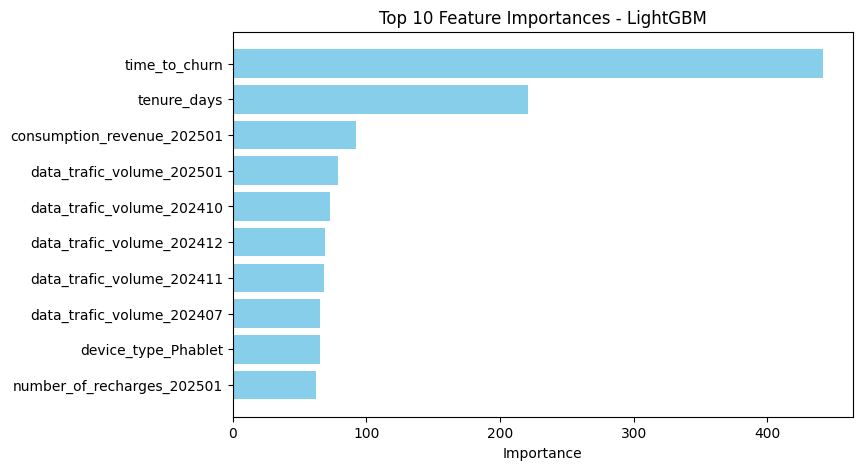

In [12]:
import joblib
import pandas as pd
import matplotlib.pyplot as plt

# Charger le modèle LightGBM sauvegardé
best_model_lgb = joblib.load("best_model_lgb.pkl")

# Récupérer les importances des features
importances = best_model_lgb.feature_importances_

# Récupérer les noms des features (si disponible)
feature_names = best_model_lgb.feature_name_

# Créer un DataFrame trié par importance décroissante
feat_imp_df = pd.DataFrame({
    'Feature': feature_names,
    'Importance': importances
}).sort_values(by='Importance', ascending=False)

# Extraire les 10 premières
top_10 = feat_imp_df.head(10)

print(top_10)

# Visualisation simple
plt.figure(figsize=(8,5))
plt.barh(top_10['Feature'][::-1], top_10['Importance'][::-1], color='skyblue')
plt.xlabel("Importance")
plt.title("Top 10 Feature Importances - LightGBM")
plt.show()


In [31]:


with open("best_model_lgb.pkl", "wb") as f:
    pickle.dump(best_model_lgb, f)
print("Modèle LightGBM sauvegardé sous le nom 'best_model_lgb.pkl'")

Modèle LightGBM sauvegardé sous le nom 'best_model_lgb.pkl'


### Decision tree 

n_iterations: 6
n_required_iterations: 6
n_possible_iterations: 10
min_resources_: 20
max_resources_: 588797
aggressive_elimination: False
factor: 3
----------
iter: 0
n_candidates: 270
n_resources: 20
Fitting 5 folds for each of 270 candidates, totalling 1350 fits
----------
iter: 1
n_candidates: 90
n_resources: 60
Fitting 5 folds for each of 90 candidates, totalling 450 fits
----------
iter: 2
n_candidates: 30
n_resources: 180
Fitting 5 folds for each of 30 candidates, totalling 150 fits
----------
iter: 3
n_candidates: 10
n_resources: 540
Fitting 5 folds for each of 10 candidates, totalling 50 fits
----------
iter: 4
n_candidates: 4
n_resources: 1620
Fitting 5 folds for each of 4 candidates, totalling 20 fits
----------
iter: 5
n_candidates: 2
n_resources: 4860
Fitting 5 folds for each of 2 candidates, totalling 10 fits
Best parameters: {'min_samples_split': 10, 'min_samples_leaf': 2, 'max_features': 'sqrt', 'max_depth': 10, 'criterion': 'gini'}
Classification Report (Test set):
   

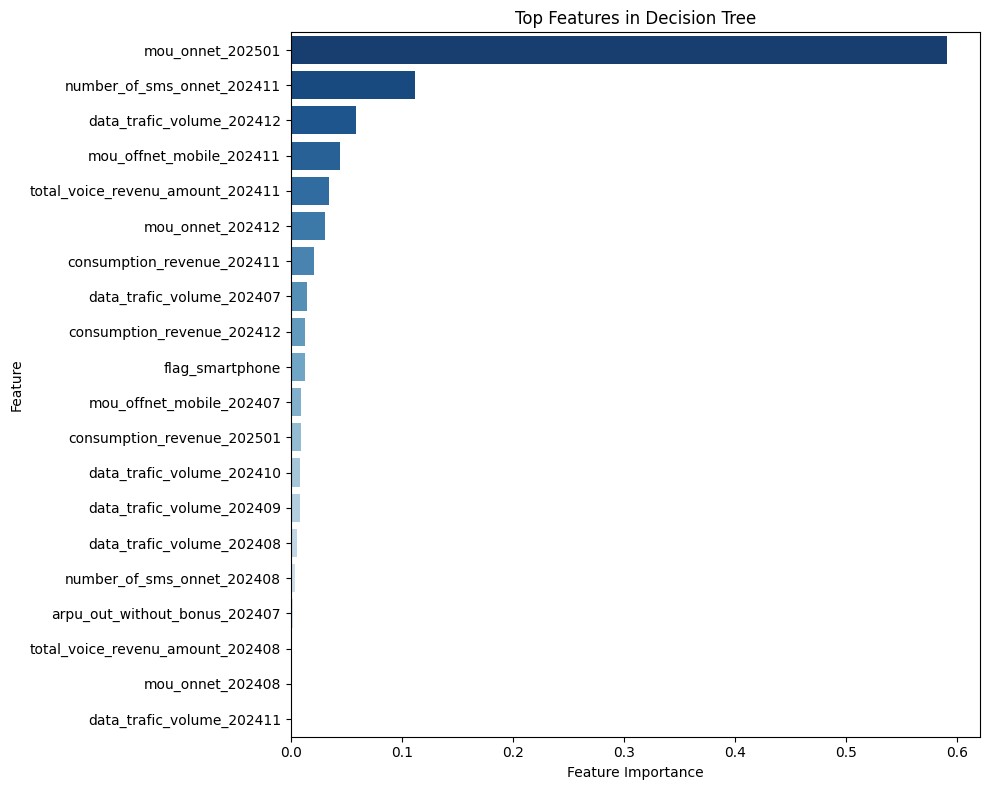

In [32]:
import numpy as np
import pandas as pd
from sklearn.tree import DecisionTreeClassifier
from sklearn.experimental import enable_halving_search_cv  # noqa
from sklearn.model_selection import train_test_split, HalvingRandomSearchCV
from sklearn.metrics import classification_report
from imblearn.over_sampling import ADASYN
import matplotlib.pyplot as plt
import seaborn as sns

# Supposons que X et y sont déjà définis
# 1. Optionnel : retirer les colonnes inutiles ou à fuite
X = X.drop(['time_to_churn'], axis=1, errors='ignore')  # Retirer la colonne fuite

# 2. Train/test split AVANT balancing
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42, stratify=y
)

# 3. Balancing uniquement sur le train
adasyn = ADASYN(random_state=42)
X_train_bal, y_train_bal = adasyn.fit_resample(X_train, y_train)

# 4. Définir la grille de paramètres
param_dist = {
    'max_depth': [5, 10, 15, 20, None],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'max_features': ['sqrt', 'log2', None],
    'criterion': ['gini', 'entropy'],
}

# 5. Hyperparameter Search
halving_search = HalvingRandomSearchCV(
    estimator=DecisionTreeClassifier(random_state=42),
    param_distributions=param_dist,
    scoring='f1',
    factor=3,
    random_state=42,
    n_jobs=-1,
    verbose=1
)

halving_search.fit(X_train_bal, y_train_bal)
best_dt = halving_search.best_estimator_

print("Best parameters:", halving_search.best_params_)

# 6. Prédiction et reporting
y_pred = best_dt.predict(X_test)
print("Classification Report (Test set):\n", classification_report(y_test, y_pred))

# 7. Feature Importance
importances = best_dt.feature_importances_
feat_names = X_train.columns
indices = np.argsort(importances)[::-1]
topn = 20  # Nombre de features à afficher

plt.figure(figsize=(10, 8))
sns.barplot(
    x=importances[indices][:topn], 
    y=np.array(feat_names)[indices][:topn],
    palette='Blues_r'
)
plt.title("Top Features in Decision Tree")
plt.xlabel("Feature Importance")
plt.ylabel("Feature")
plt.tight_layout()
plt.show()


Best threshold: 0.80 | F1-score: 0.57
              precision    recall  f1-score   support

           0       0.99      0.89      0.94     73323
           1       0.41      0.90      0.57      6359

    accuracy                           0.89     79682
   macro avg       0.70      0.89      0.75     79682
weighted avg       0.94      0.89      0.91     79682



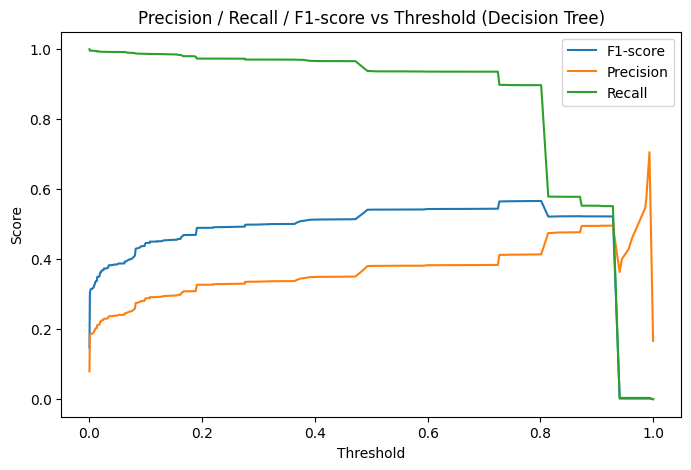

In [33]:
from sklearn.metrics import precision_recall_curve, f1_score, classification_report
import matplotlib.pyplot as plt
import numpy as np

# Obtenir les probabilités de churn
y_proba = best_dt.predict_proba(X_test)[:, 1]

# Calculer les courbes de precision/recall
precision, recall, thresholds = precision_recall_curve(y_test, y_proba)
f1_scores = 2 * (precision * recall) / (precision + recall + 1e-8)

# Trouver le meilleur seuil pour F1
best_idx = np.argmax(f1_scores)
best_thresh = thresholds[best_idx]
print(f"Best threshold: {best_thresh:.2f} | F1-score: {f1_scores[best_idx]:.2f}")

# Evaluer à ce seuil optimal
y_pred_opt = (y_proba >= best_thresh).astype(int)
print(classification_report(y_test, y_pred_opt))

# Visualisation
plt.figure(figsize=(8,5))
plt.plot(thresholds, f1_scores[:-1], label="F1-score")
plt.plot(thresholds, precision[:-1], label="Precision")
plt.plot(thresholds, recall[:-1], label="Recall")
plt.xlabel("Threshold")
plt.ylabel("Score")
plt.legend()
plt.title("Precision / Recall / F1-score vs Threshold (Decision Tree)")
plt.show()


In [269]:
from sklearn.tree import DecisionTreeClassifier

# Example: Penalize less for missing churns (class 1), so model is more cautious
dt_highprec = DecisionTreeClassifier(
    random_state=42,
    class_weight={0: 1.0, 1: 0.5},  # Try 0.5, 0.3, etc. Lower values => higher precision, lower recall
    max_depth=best_model.max_depth,  # You can use best params found earlier
    min_samples_split=best_model.min_samples_split,
    min_samples_leaf=best_model.min_samples_leaf,
    max_features=best_model.max_features,
    criterion=best_model.criterion
)

dt_highprec.fit(X_train_bal, y_train_bal)

# Predict probabilities
y_proba_dt = dt_highprec.predict_proba(X_test)[:, 1]


Fitting 5 folds for each of 30 candidates, totalling 150 fits
Best parameters: {'min_samples_split': 2, 'min_samples_leaf': 2, 'max_features': None, 'max_depth': None, 'criterion': 'entropy', 'class_weight': {0: 1.0, 1: 0.5}}


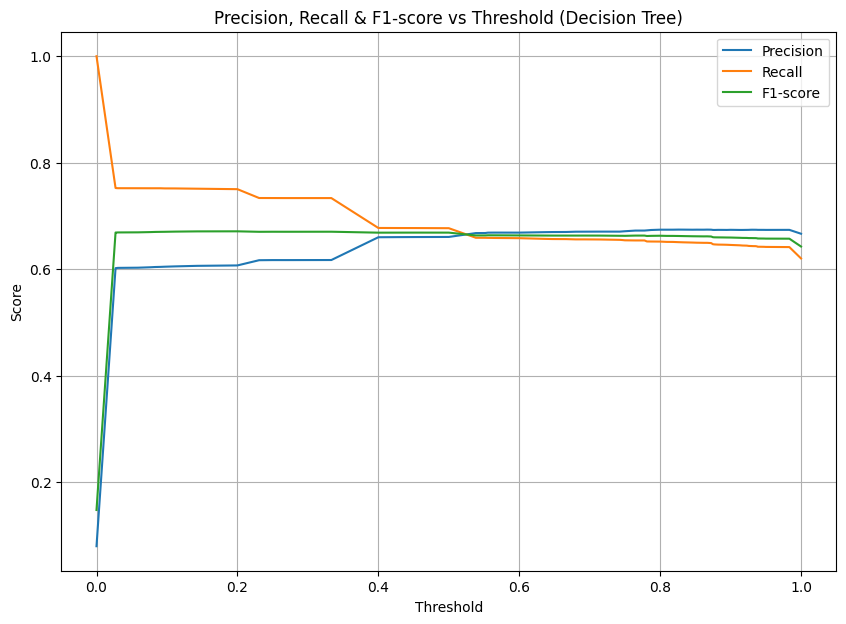


No threshold achieves the desired precision of 0.7.
Maximum precision reached: 0.67 at threshold 0.83
Corresponding recall: 0.65

Classification Report (max precision threshold):
              precision    recall  f1-score   support

           0       0.97      0.97      0.97    183306
           1       0.67      0.65      0.66     15897

    accuracy                           0.95    199203
   macro avg       0.82      0.81      0.82    199203
weighted avg       0.95      0.95      0.95    199203



In [34]:
from sklearn.model_selection import RandomizedSearchCV, train_test_split
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import classification_report, precision_recall_curve, confusion_matrix, ConfusionMatrixDisplay
from imblearn.over_sampling import ADASYN
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd



# 2. Train/test split
X_train, X_test, y_train, y_test = train_test_split(X, y, stratify=y, test_size=0.5, random_state=42)

# 3. Balance classes on train set
adasyn = ADASYN(random_state=42)
X_train_bal, y_train_bal = adasyn.fit_resample(X_train, y_train)

# 4. Parameter grid for randomized search
param_dist = {
    'max_depth': [3, 5, 10, 15, 20, None],
    'min_samples_split': [2, 5, 10, 20],
    'min_samples_leaf': [1, 2, 4, 10],
    'max_features': [None, 'sqrt', 'log2'],
    'criterion': ['gini', 'entropy'],
    'class_weight': [None, 'balanced', {0: 1.0, 1: 0.5}, {0: 1.0, 1: 0.3}]
}

dt_model = DecisionTreeClassifier(random_state=42)

# 5. Randomized search
random_search = RandomizedSearchCV(
    estimator=dt_model,
    param_distributions=param_dist,
    n_iter=30,  # More iterations = more chances to find a good model
    scoring='f1',
    cv=5,
    random_state=42,
    n_jobs=-1,
    verbose=2
)

random_search.fit(X_train_bal, y_train_bal)

# 6. Best model
best_model = random_search.best_estimator_
print("Best parameters:", random_search.best_params_)

# 7. Predict probabilities on test set
y_proba = best_model.predict_proba(X_test)[:, 1]

# 8. Precision-Recall curve and threshold tuning
precisions, recalls, thresholds = precision_recall_curve(y_test, y_proba)
f1_scores = 2 * (precisions * recalls) / (precisions + recalls + 1e-8)

# Plot
plt.figure(figsize=(10, 7))
plt.plot(thresholds, precisions[:-1], label='Precision')
plt.plot(thresholds, recalls[:-1], label='Recall')
plt.plot(thresholds, f1_scores[:-1], label='F1-score')
plt.xlabel("Threshold")
plt.ylabel("Score")
plt.legend()
plt.title("Precision, Recall & F1-score vs Threshold (Decision Tree)")
plt.grid(True)
plt.show()

# Choose threshold for desired precision (e.g., >= 0.70)
desired_precision = 0.70
precision_idx = np.where(precisions[:-1] >= desired_precision)[0]
if len(precision_idx) > 0:
    idx = precision_idx[0]
    thresh = thresholds[idx]
    print(f"\nThreshold achieving precision {desired_precision}: {thresh:.2f}")
    print(f"Precision: {precisions[idx]:.2f}, Recall: {recalls[idx]:.2f}, F1: {f1_scores[idx]:.2f}")

    y_pred_high_prec = (y_proba >= thresh).astype(int)
    print("\nClassification Report (high precision threshold):")
    print(classification_report(y_test, y_pred_high_prec))

    # Confusion matrix
    cm = confusion_matrix(y_test, y_pred_high_prec)
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=['Non-Churn', 'Churn'])
    disp.plot(cmap='Blues')
    plt.title(f'Confusion Matrix (Threshold={thresh:.2f})')
    plt.show()
else:
    print(f"\nNo threshold achieves the desired precision of {desired_precision}.")
    # Show max precision anyway
    max_prec = np.max(precisions[:-1])
    idx_max_prec = np.argmax(precisions[:-1])
    print(f"Maximum precision reached: {max_prec:.2f} at threshold {thresholds[idx_max_prec]:.2f}")
    print(f"Corresponding recall: {recalls[idx_max_prec]:.2f}")
    y_pred_maxprec = (y_proba >= thresholds[idx_max_prec]).astype(int)
    print("\nClassification Report (max precision threshold):")
    print(classification_report(y_test, y_pred_maxprec))


In [271]:
import pandas as pd

# Get indices of X_test in the original dataframe
test_indices = X_test.index
# Suppose you have 'subscriber_id' in your original dataframe (adapt if another field)
if 'subscriber_id' in final_df_per_period_encoded.columns:
    subscribers = final_df_per_period_encoded.loc[test_indices, 'subscriber_id']
else:
    subscribers = test_indices  # fallback: use index

clients_proba = pd.DataFrame({
    'subscriber_id': subscribers,
    'proba_churn': y_proba,
    'true_churn': y_test.values
})

# Sort by probability, descending: top churn risks first
top_churners = clients_proba.sort_values('proba_churn', ascending=False)
print("\nTop 20 clients at highest churn risk:")
print(top_churners.head(20))

# Optionally export all high risk clients (e.g., proba > 0.8)
high_risk = top_churners[top_churners['proba_churn'] > 0.8]
high_risk.to_csv("clients_high_risk_churn_decision_tree.csv", index=False)
print(f"\nNumber of clients with churn probability > 0.8: {len(high_risk)}")
print(high_risk.head(10))



Top 20 clients at highest churn risk:
        subscriber_id  proba_churn  true_churn
74000          380464          1.0           1
142928         379834          1.0           1
170203         144199          1.0           0
89784          378942          1.0           1
185361         382132          1.0           1
70410          390536          1.0           1
185355          98082          1.0           0
32319          379167          1.0           1
142988         382227          1.0           1
128017         386904          1.0           1
99102          371929          1.0           1
107894         379418          1.0           1
143046         387483          1.0           1
82741          378884          1.0           1
71310          384092          1.0           1
97046           66819          1.0           0
28672          387614          1.0           1
7019           382478          1.0           1
199186         380795          1.0           1
41315          385420

                              Feature  Importance
4                       time_to_churn    0.589239
80         number_of_recharges_202411    0.049504
33         consumption_revenue_202501    0.041540
104  total_voice_revenu_amount_202407    0.034784
2                         tenure_days    0.029615
..                                ...         ...
116                     device_type_-    0.000000
132            marital_status_Divorce    0.000000
127              device_type_Wearable    0.000000
134               marital_status_Veuf    0.000000
140         customer_language_Italien    0.000000

[141 rows x 2 columns]


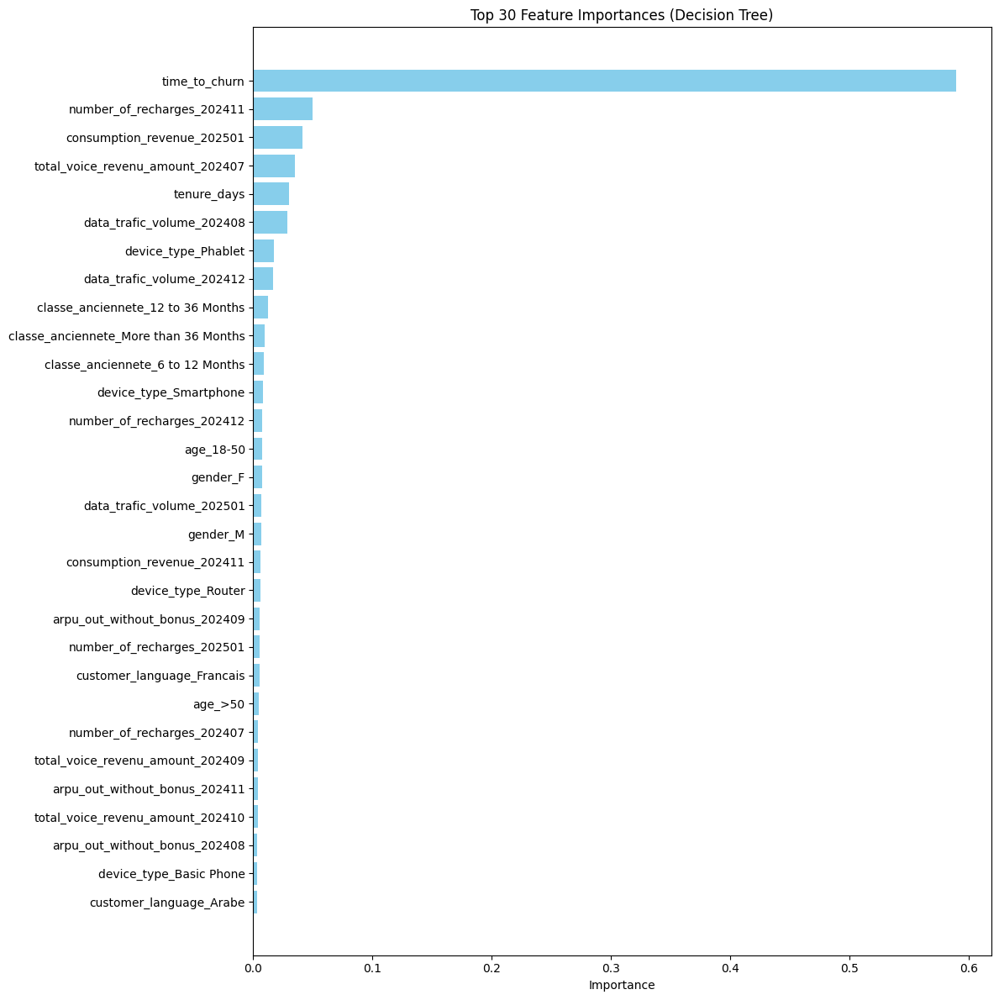

In [272]:
import pandas as pd
import matplotlib.pyplot as plt

# 1. Get feature importances and names
feature_names = X_train.columns
importances = best_model.feature_importances_

# 2. Put into a DataFrame, sort
feat_imp_df = pd.DataFrame({
    'Feature': feature_names,
    'Importance': importances
}).sort_values('Importance', ascending=False)

# 3. Print and save to CSV
print(feat_imp_df)
feat_imp_df.to_csv("feature_importances_decision_tree.csv", index=False)

# 4. Visualize (you can change top_n for more/fewer features)
top_n = 30
plt.figure(figsize=(12, 0.4*top_n))
plt.barh(feat_imp_df['Feature'][:top_n][::-1], feat_imp_df['Importance'][:top_n][::-1], color='skyblue')
plt.xlabel("Importance")
plt.title(f"Top {top_n} Feature Importances (Decision Tree)")
plt.tight_layout()
plt.show()


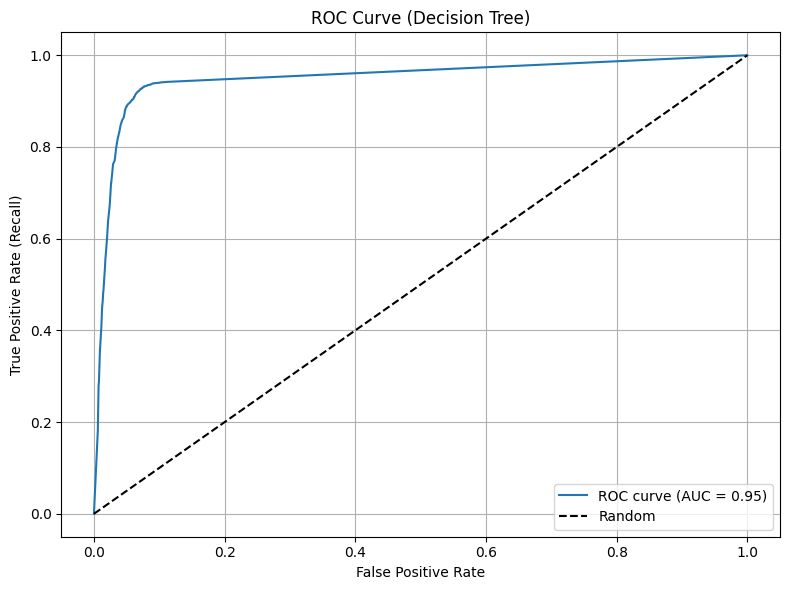

In [273]:
from sklearn.metrics import roc_curve, auc

# 1. ROC curve and AUC
fpr, tpr, _ = roc_curve(y_test, y_proba)
roc_auc = auc(fpr, tpr)

import matplotlib.pyplot as plt
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, label=f'ROC curve (AUC = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], 'k--', label='Random')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate (Recall)')
plt.title('ROC Curve (Decision Tree)')
plt.legend()
plt.grid()
plt.tight_layout()
plt.show()


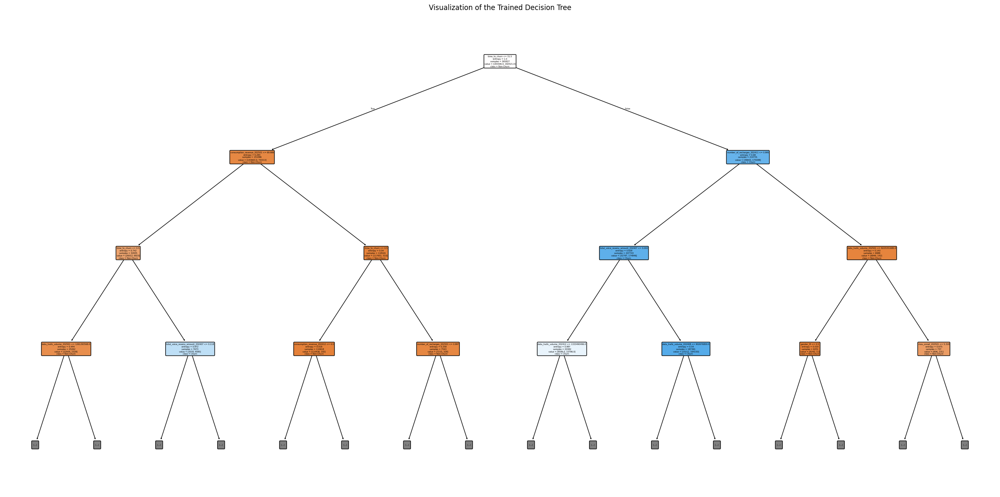

In [274]:
from sklearn.tree import plot_tree
import matplotlib.pyplot as plt

# Optionally, use only the first N levels for clarity (e.g., max_depth=3)
plt.figure(figsize=(24, 12))
plot_tree(
    best_model,  # your fitted DecisionTreeClassifier
    feature_names=X_train.columns,
    class_names=['Non-Churn', 'Churn'],
    filled=True,
    rounded=True,
    max_depth=3  # Increase for more details, decrease for clarity
)
plt.title("Visualization of the Trained Decision Tree")
plt.tight_layout()
plt.show()


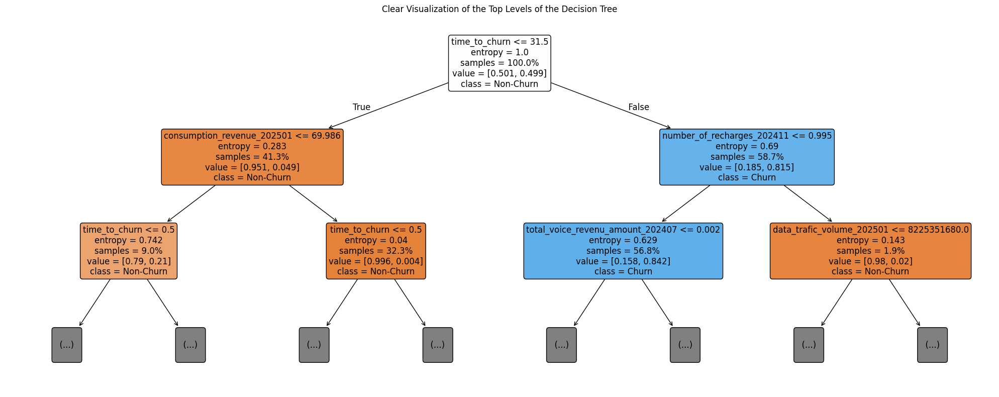

In [275]:
from sklearn.tree import plot_tree
import matplotlib.pyplot as plt

# Set max_depth to 2 or 3 for a clear summary of the main decision rules
plt.figure(figsize=(20, 8))  # Wide figure for clarity
plot_tree(
    best_model,
    feature_names=X_train.columns,
    class_names=['Non-Churn', 'Churn'],
    filled=True,
    rounded=True,
    max_depth=2,        # Adjust: 2 = very clear summary, 3 = a bit more detail
    fontsize=12,        # Adjust font size for readability
    proportion=True     # Node sizes proportional to samples (optional)
)
plt.title("Clear Visualization of the Top Levels of the Decision Tree")
plt.tight_layout()
plt.show()


In [35]:
import joblib

# Save the best decision tree model as a .pkl file
joblib.dump(best_model, 'best_decision_tree.pkl')
print("✅ Model saved as best_decision_tree.pkl")


✅ Model saved as best_decision_tree.pkl


### catboost

Fitting 3 folds for each of 20 candidates, totalling 60 fits
Best Parameters: {'learning_rate': 0.1, 'l2_leaf_reg': 1, 'iterations': 300, 'depth': 6, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 0.2}
Classification Report:
               precision    recall  f1-score   support

           0       0.99      0.97      0.98    183306
           1       0.71      0.85      0.77     15897

    accuracy                           0.96    199203
   macro avg       0.85      0.91      0.88    199203
weighted avg       0.96      0.96      0.96    199203



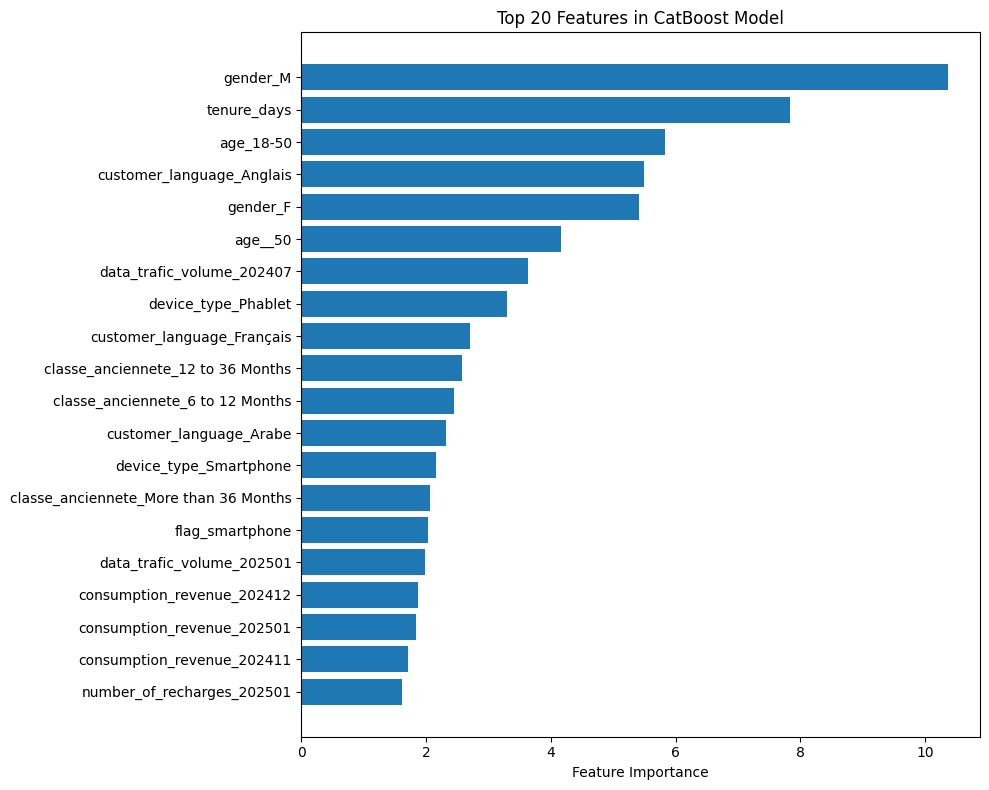

In [36]:
from catboost import CatBoostClassifier
from sklearn.model_selection import train_test_split, RandomizedSearchCV
from sklearn.metrics import classification_report
from imblearn.over_sampling import ADASYN
import matplotlib.pyplot as plt
import numpy as np

# 1. Train/test split (NO balancing/scaling before split!)
X_train, X_test, y_train, y_test = train_test_split(
    X, y, stratify=y, test_size=0.5, random_state=42
)

# 2. Balance the train set only (ADASYN or SMOTE)
adasyn = ADASYN(random_state=42)
X_train_bal, y_train_bal = adasyn.fit_resample(X_train, y_train)

# 3. CatBoost model & RandomizedSearchCV
cat_model = CatBoostClassifier(
    verbose=0,
    random_seed=42,
    eval_metric='F1',
    early_stopping_rounds=50
)

param_dist = {
    'depth': [4, 6],
    'learning_rate': [0.05, 0.1],
    'iterations': [100, 300],
    'l2_leaf_reg': [1, 5],
    'bootstrap_type': ['Bayesian'],
    'bagging_temperature': [0.2, 1.0]
}

search = RandomizedSearchCV(
    estimator=cat_model,
    param_distributions=param_dist,
    scoring='f1',
    n_iter=20,
    cv=3,
    random_state=42,
    n_jobs=-1,
    verbose=1
)

# 4. Fit on balanced train set
search.fit(X_train_bal, y_train_bal)

# 5. Best estimator
best_model_catboost = search.best_estimator_
print("Best Parameters:", search.best_params_)

# 6. Predict and evaluate on TEST SET (original, not balanced)
y_pred = best_model_catboost.predict(X_test)
print("Classification Report:\n", classification_report(y_test, y_pred))

# 7. Feature importance plot
feature_importances = best_model_catboost.get_feature_importance()
feature_names = X_train.columns  # or use X.columns if not changed

plt.figure(figsize=(10, 8))
sorted_idx = np.argsort(feature_importances)[::-1][:20]  # Top 20 features
plt.barh(np.array(feature_names)[sorted_idx], np.array(feature_importances)[sorted_idx])
plt.xlabel('Feature Importance')
plt.title('Top 20 Features in CatBoost Model')
plt.gca().invert_yaxis()
plt.tight_layout()
plt.show()


In [15]:
df_encoded=pd.read_csv("final_df_encoded.csv")
X=df_encoded.drop(columns=['subscriber_id', 'churn'])
y=df_encoded['churn']
# 1. Train/test split (NO balancing/scaling before split!)
X_train, X_test, y_train, y_test = train_test_split(
    X, y, stratify=y, test_size=0.5, random_state=42
)

# 2. Balance the train set only (ADASYN or SMOTE)
adasyn = ADASYN(random_state=42)
X_train_bal, y_train_bal = adasyn.fit_resample(X_train, y_train)

In [18]:
expected_features = model.feature_names_
print(expected_features)


['original_operator', 'dat_remb_kridi_net', 'tenure_days', 'has_international_call', 'flag_smartphone', 'arpu_out_without_bonus_202407', 'arpu_out_without_bonus_202408', 'arpu_out_without_bonus_202409', 'arpu_out_without_bonus_202410', 'arpu_out_without_bonus_202411', 'arpu_out_without_bonus_202412', 'arpu_out_without_bonus_202501', 'bonus_on_consumption_revenue_202407', 'bonus_on_consumption_revenue_202408', 'bonus_on_consumption_revenue_202409', 'bonus_on_consumption_revenue_202410', 'bonus_on_consumption_revenue_202411', 'bonus_on_consumption_revenue_202412', 'bonus_on_consumption_revenue_202501', 'bonus_on_refill_flash_revenue_202407', 'bonus_on_refill_flash_revenue_202408', 'bonus_on_refill_flash_revenue_202409', 'bonus_on_refill_flash_revenue_202410', 'bonus_on_refill_flash_revenue_202411', 'bonus_on_refill_flash_revenue_202412', 'bonus_on_refill_flash_revenue_202501', 'consumption_revenue_202407', 'consumption_revenue_202408', 'consumption_revenue_202409', 'consumption_revenue_2

In [19]:
for col in expected_features:
    if col not in X_train_bal.columns:
        X_train_bal[col] = 0
X_train_bal = X_train_bal[expected_features]

for col in expected_features:
    if col not in X_test.columns:
        X_test[col] = 0
X_test = X_test[expected_features]


C:\Users\Client\AppData\Local\Temp\ipykernel_9948\1047915249.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_train_bal[col] = 0
C:\Users\Client\AppData\Local\Temp\ipykernel_9948\1047915249.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_train_bal[col] = 0



=== Évaluation sur Train (équilibré) ===
              precision    recall  f1-score   support

           0     0.9907    0.8696    0.9262    183306
           1     0.8846    0.9919    0.9352    184697

    accuracy                         0.9310    368003
   macro avg     0.9376    0.9307    0.9307    368003
weighted avg     0.9374    0.9310    0.9307    368003



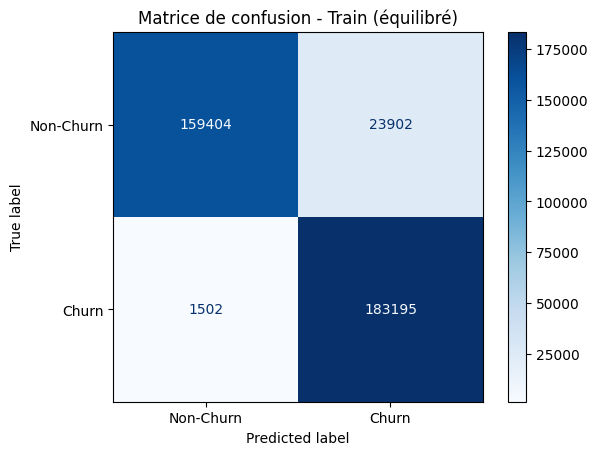

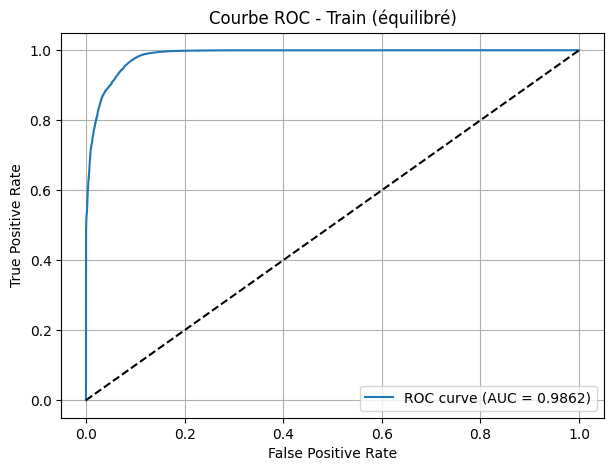

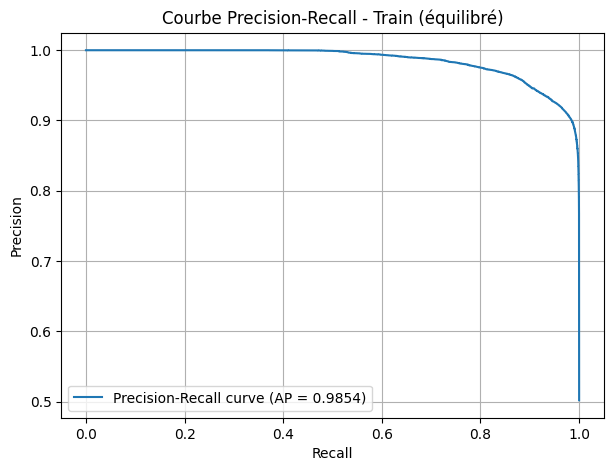


=== Évaluation sur Test ===
              precision    recall  f1-score   support

           0     0.9924    0.8707    0.9276    183306
           1     0.3824    0.9232    0.5408     15897

    accuracy                         0.8749    199203
   macro avg     0.6874    0.8969    0.7342    199203
weighted avg     0.9437    0.8749    0.8967    199203



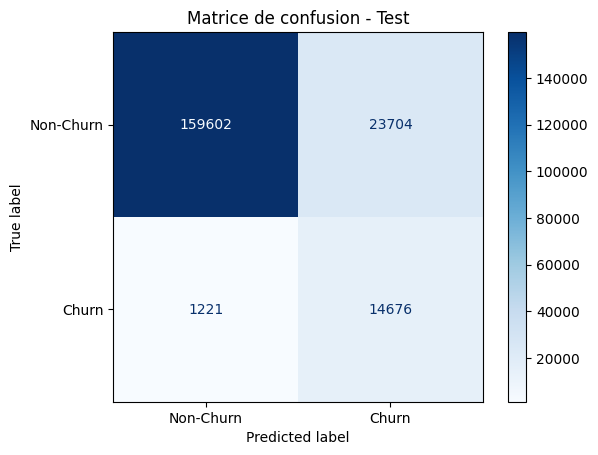

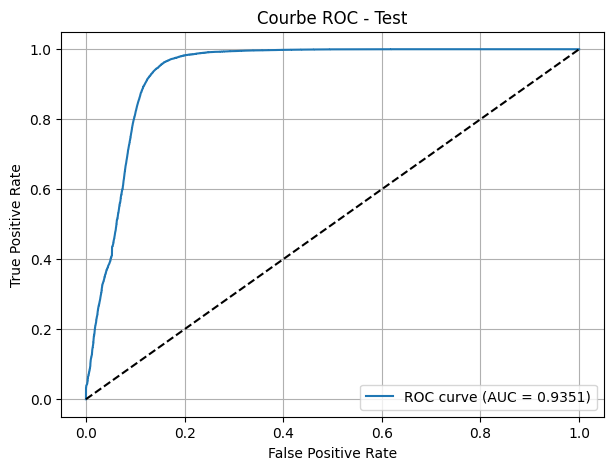

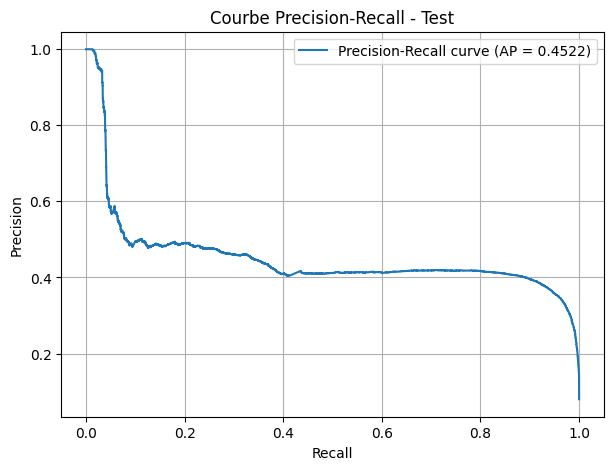

In [21]:
import joblib
from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay, roc_curve, auc, precision_recall_curve, average_precision_score
import matplotlib.pyplot as plt
import numpy as np

# Charger le modèle
model = joblib.load("catboost_best_model.pkl")



# Fonction d'évaluation
def evaluate(y_true, y_pred, y_proba, dataset_name):
    print(f"\n=== Évaluation sur {dataset_name} ===")
    print(classification_report(y_true, y_pred, digits=4))
    
    # Matrice de confusion
    cm = confusion_matrix(y_true, y_pred)
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=['Non-Churn', 'Churn'])
    disp.plot(cmap='Blues')
    plt.title(f"Matrice de confusion - {dataset_name}")
    plt.show()
    
    # Courbe ROC
    fpr, tpr, _ = roc_curve(y_true, y_proba)
    roc_auc = auc(fpr, tpr)
    plt.figure(figsize=(7,5))
    plt.plot(fpr, tpr, label=f"ROC curve (AUC = {roc_auc:.4f})")
    plt.plot([0,1],[0,1],'k--')
    plt.xlabel("False Positive Rate")
    plt.ylabel("True Positive Rate")
    plt.title(f"Courbe ROC - {dataset_name}")
    plt.legend()
    plt.grid()
    plt.show()
    
    # Courbe Precision-Recall
    precision, recall, _ = precision_recall_curve(y_true, y_proba)
    avg_precision = average_precision_score(y_true, y_proba)
    plt.figure(figsize=(7,5))
    plt.plot(recall, precision, label=f"Precision-Recall curve (AP = {avg_precision:.4f})")
    plt.xlabel("Recall")
    plt.ylabel("Precision")
    plt.title(f"Courbe Precision-Recall - {dataset_name}")
    plt.legend()
    plt.grid()
    plt.show()

# Évaluer train et test
evaluate(y_train_bal, y_train_pred, y_train_proba, "Train (équilibré)")
evaluate(y_test, y_test_pred, y_test_proba, "Test")


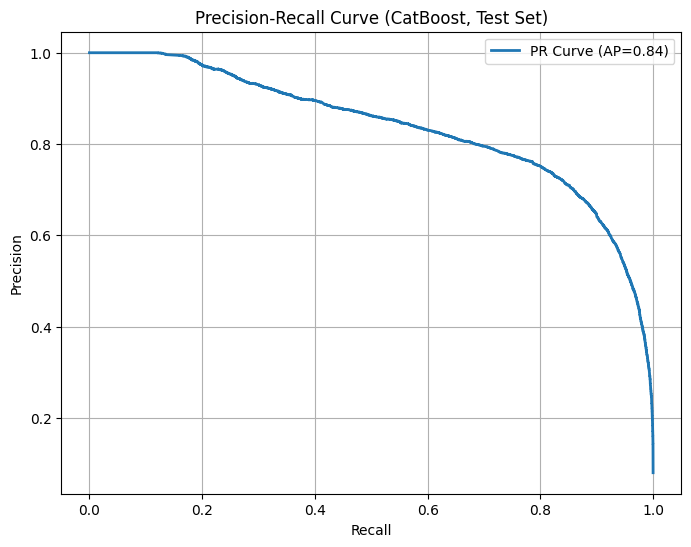

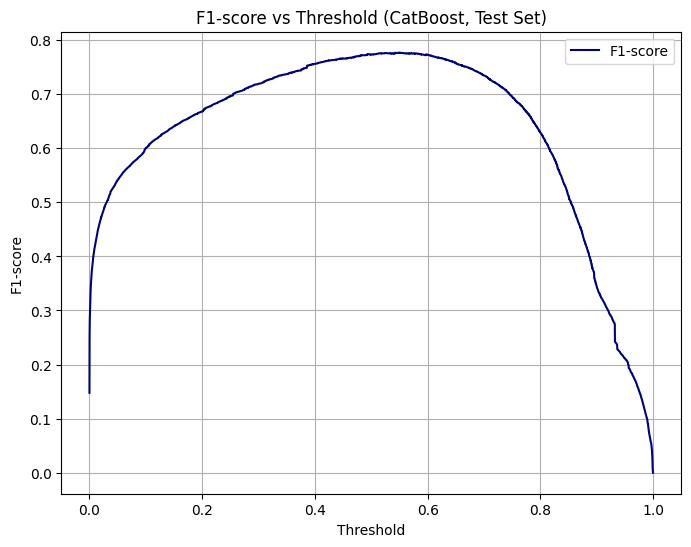

In [37]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import precision_recall_curve, average_precision_score, f1_score

# 1. Get predicted probabilities for class 1 (churn)
y_proba = best_model_catboost.predict_proba(X_test)[:, 1]

# 2. Calculate precision, recall, and thresholds
precision, recall, thresholds = precision_recall_curve(y_test, y_proba)
ap_score = average_precision_score(y_test, y_proba)

# 3. Plot Precision-Recall curve
plt.figure(figsize=(8, 6))
plt.plot(recall, precision, label=f"PR Curve (AP={ap_score:.2f})", lw=2)
plt.xlabel("Recall")
plt.ylabel("Precision")
plt.title("Precision-Recall Curve (CatBoost, Test Set)")
plt.legend()
plt.grid(True)
plt.show()

# (Optional) Plot F1-score vs Threshold
f1_scores = 2 * (precision * recall) / (precision + recall + 1e-8)
plt.figure(figsize=(8, 6))
plt.plot(thresholds, f1_scores[:-1], label="F1-score", color='navy')
plt.xlabel("Threshold")
plt.ylabel("F1-score")
plt.title("F1-score vs Threshold (CatBoost, Test Set)")
plt.legend()
plt.grid(True)
plt.show()


 Courbe de Precision-Recall (PR Curve)
Axe X : Recall (Rappel)

Le recall (rappel) indique la proportion de vrais churners détectés par le modèle (sensibilité).

Axe Y : Precision (Précision)

La précision indique la proportion des clients prédit comme churners qui sont réellement des churners.

La courbe :

Plus la courbe est proche du coin supérieur droit, mieux c’est.

AP (Average Precision) = 0.86 : Cela veut dire que ton modèle a une très bonne capacité à séparer les churners des non-churners (valeur > 0.80 est déjà excellente).

Quand le recall augmente (on détecte plus de vrais churners), la précision baisse généralement (on fait plus d’erreurs).

Utilité :

Très utile en cas de déséquilibre des classes (churn est minoritaire).

Cette courbe montre que le modèle garde une précision élevée même pour des rappels assez hauts.

2️⃣ F1-score vs Threshold
Axe X : Threshold (Seuil de décision)

C’est la probabilité au-dessus de laquelle on prédit “churn”.

Par défaut, le seuil est à 0.5, mais tu peux le modifier pour optimiser le F1-score.

Axe Y : F1-score

Le F1-score combine la précision et le rappel en une seule métrique (surtout utile si tu veux l’équilibre entre les deux).

La courbe :

On observe une bosse (souvent entre 0.6 et 0.8) : c’est là où le F1-score est maximal.

Trouver le meilleur seuil : Tu choisis le seuil qui donne le maximum F1-score pour bien capturer les churners sans trop de faux positifs.



0:	learn: 0.8995684	test: 0.9002577	best: 0.9002577 (0)	total: 75ms	remaining: 22.4s
50:	learn: 0.9590138	test: 0.9572755	best: 0.9572755 (50)	total: 3.1s	remaining: 15.1s
100:	learn: 0.9663855	test: 0.9649175	best: 0.9649175 (100)	total: 5.68s	remaining: 11.2s
150:	learn: 0.9710938	test: 0.9694133	best: 0.9694133 (150)	total: 8.78s	remaining: 8.66s
200:	learn: 0.9739524	test: 0.9729033	best: 0.9729517 (199)	total: 11.9s	remaining: 5.88s
250:	learn: 0.9757819	test: 0.9746882	best: 0.9746882 (250)	total: 14.8s	remaining: 2.89s
299:	learn: 0.9767778	test: 0.9757470	best: 0.9757470 (299)	total: 18.1s	remaining: 0us

bestTest = 0.9757469531
bestIteration = 299



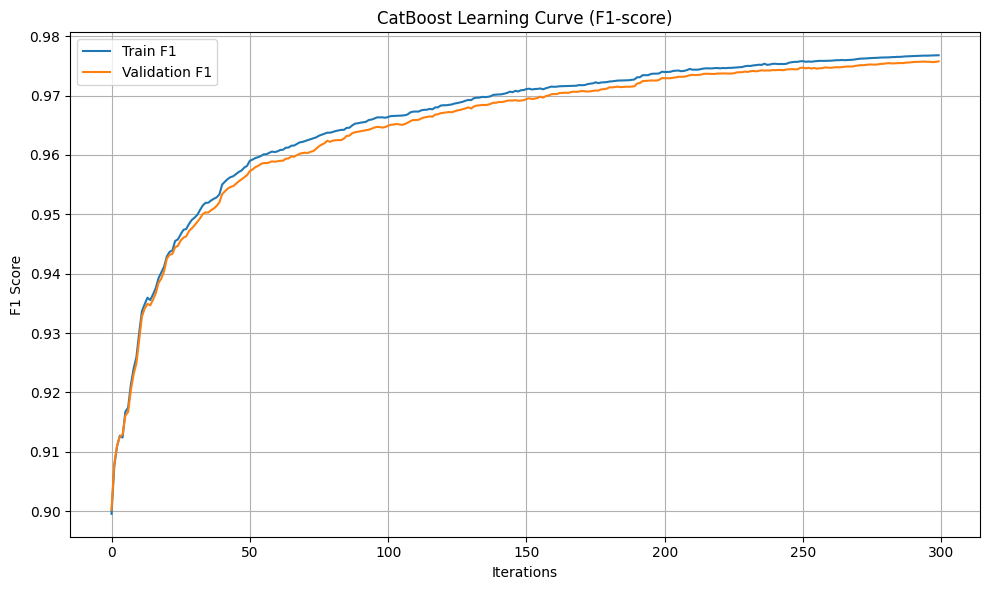

In [38]:
from sklearn.model_selection import train_test_split
from catboost import CatBoostClassifier, Pool
import matplotlib.pyplot as plt

# Supposons que tu as déjà fait ça AVANT :
# X_train, X_test, y_train, y_test = train_test_split(X, y, ...)
# X_train_bal, y_train_bal = adasyn.fit_resample(X_train, y_train)

# 1. Split sur X_train_bal / y_train_bal (PAS sur y_train d'origine !)
X_tr, X_val, y_tr, y_val = train_test_split(
    X_train_bal, y_train_bal, test_size=0.2, random_state=42, stratify=y_train_bal
)
# ⚠️ Note bien l'utilisation de y_train_bal pour le stratify et PAS y_train

# 2. CatBoost Pool
train_pool = Pool(X_tr, y_tr)
val_pool = Pool(X_val, y_val)

# 3. Re-train CatBoost avec meilleurs params
best_model_catboost = CatBoostClassifier(
    **search.best_params_,
    eval_metric='F1',
    early_stopping_rounds=50,
    random_seed=42,
    verbose=50
)

best_model_catboost.fit(
    train_pool,
    eval_set=val_pool,
    plot=False
)

# 4. Courbe d'apprentissage
evals_result = best_model_catboost.get_evals_result()
plt.figure(figsize=(10, 6))
plt.plot(evals_result['learn']['F1'], label='Train F1')
plt.plot(evals_result['validation']['F1'], label='Validation F1')
plt.xlabel('Iterations')
plt.ylabel('F1 Score')
plt.title('CatBoost Learning Curve (F1-score)')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


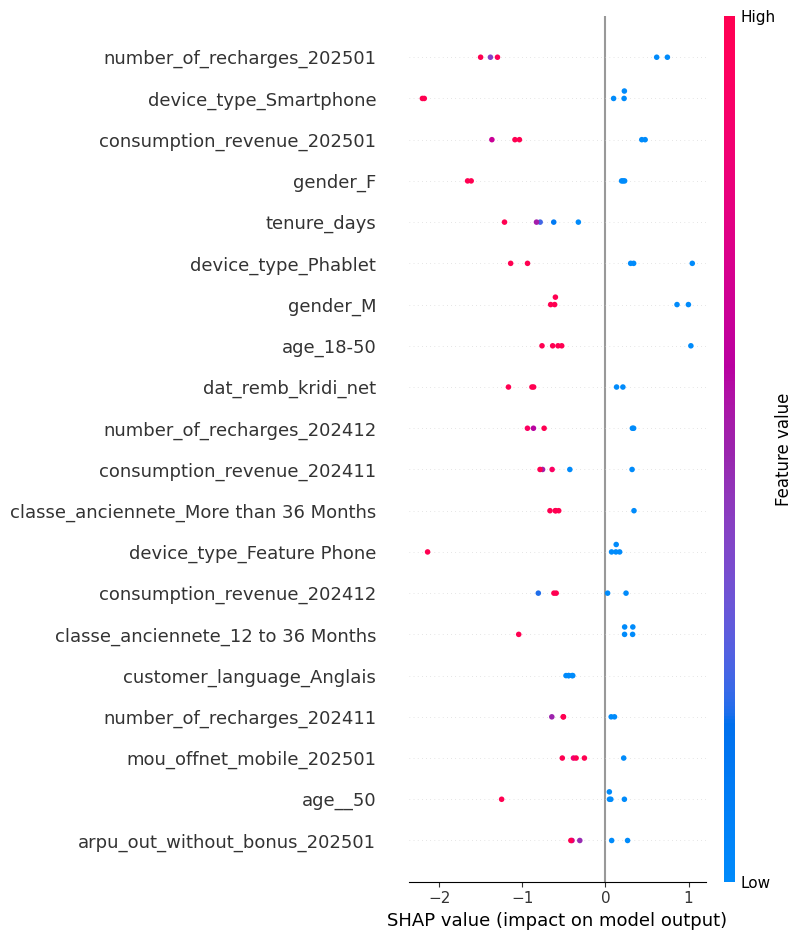

In [39]:
import shap

# 1. Prépare l’explainer SHAP pour CatBoost
explainer = shap.TreeExplainer(best_model_catboost)

# 2. Sélectionne quelques individus à expliquer (ici, 5 premiers du test)
X_explain = X_test[:5]   # Ou X_test si pas de scaling

# 3. Calcule les valeurs SHAP
shap_values = explainer.shap_values(X_explain)

# 4. Explication globale : summary plot (importances globales sur les individus choisis)
shap.summary_plot(shap_values, X_explain, feature_names=X_test.columns)


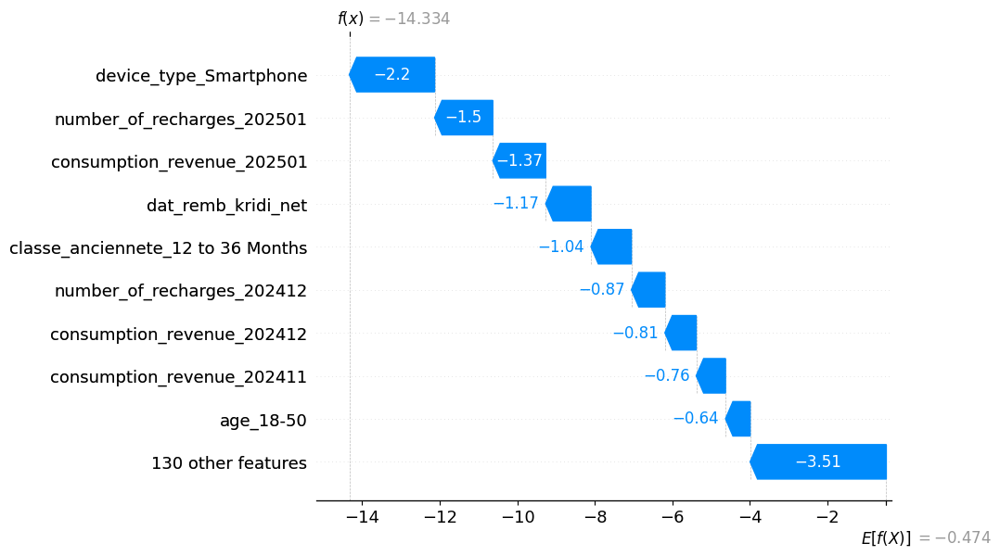

In [40]:
# 5. Explication individuelle : waterfall plot (SHAP >=0.40 conseillé)
shap.plots._waterfall.waterfall_legacy(
    explainer.expected_value, shap_values[0], feature_names=X_test.columns
)




In [41]:
import pandas as pd

# Si X_explain est un array numpy, le convertir en DataFrame AVEC les noms des colonnes
X_explain_df = pd.DataFrame(X_explain, columns=X_test.columns)

# Visualisation interactive
shap.initjs()
shap.force_plot(
    explainer.expected_value, 
    shap_values[0], 
    X_explain_df.iloc[0], 
    feature_names=X_test.columns
)


In [69]:
from sklearn.model_selection import cross_val_score

cv_f1_scores = cross_val_score(
    best_model_catboost,
    X_train_bal,
    y_train_bal,
    cv=3,
    scoring='f1',
    n_jobs=-1
)

print("Cross-validated F1 scores:", cv_f1_scores)
print("Mean F1:", np.mean(cv_f1_scores))


Cross-validated F1 scores: [0.92556203 0.98631764 0.9865287 ]
Mean F1: 0.9661361234623049


In [70]:
from sklearn.model_selection import cross_val_score

cv_f1_scores = cross_val_score(
    best_model_catboost,
    X_test,
    y_test,
    cv=3,
    scoring='f1',
    n_jobs=-1
)

print("Cross-validated F1 scores:", cv_f1_scores)
print("Mean F1:", np.mean(cv_f1_scores))


Cross-validated F1 scores: [0.82551071 0.82812346 0.82670623]
Mean F1: 0.8267801343950542


In [42]:
import joblib

# Sauvegarder le modèle CatBoost
joblib.dump(best_model_catboost, "catboost_best_model.pkl")

print("Modèle CatBoost sauvegardé sous 'catboost_best_model.pkl'")


Modèle CatBoost sauvegardé sous 'catboost_best_model.pkl'


### SVM


In [72]:
from sklearn.svm import SVC
from imblearn.over_sampling import ADASYN
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import classification_report
from sklearn.model_selection import train_test_split

# 1. Normalisation
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# 2. Oversampling avec ADASYN (sans n_jobs)
adasyn = ADASYN(random_state=42)
X_train_bal, y_train_bal = adasyn.fit_resample(X_train_scaled, y_train)

# 3. SVM RBF optimisé
svm_rbf = SVC(
    kernel='rbf',
    C=10,
    gamma='scale',
    class_weight='balanced',
    probability=False,    # désactivé pour accélérer l'entraînement
    cache_size=1000,
    tol=1e-2,
    max_iter=1000,
    random_state=42
)

# 4. Entraînement
svm_rbf.fit(X_train_bal, y_train_bal)

# 5. Prédiction
y_pred = svm_rbf.predict(X_test_scaled)

# 6. Évaluation
print(classification_report(y_test, y_pred))


d:\pfe Ooreedo\pfe\.venv\Lib\site-packages\sklearn\svm\_base.py:305: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(


              precision    recall  f1-score   support

           0       0.93      0.98      0.95    183306
           1       0.39      0.16      0.23     15897

    accuracy                           0.91    199203
   macro avg       0.66      0.57      0.59    199203
weighted avg       0.89      0.91      0.90    199203



In [74]:
import numpy as np
import pandas as pd
from sklearn.svm import SVC
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import StratifiedKFold, RandomizedSearchCV
from sklearn.metrics import classification_report, make_scorer, precision_score, recall_score, f1_score
from imblearn.over_sampling import SMOTE, ADASYN, BorderlineSMOTE
from sklearn.utils import resample
from scipy.stats import loguniform
import joblib
import time

# Fonction d'évaluation combinée pour plusieurs métriques
scoring = {
    'f1_macro': 'f1_macro',
    'recall_1': make_scorer(recall_score, pos_label=1),
    'precision_1': make_scorer(precision_score, pos_label=1)
}

# ⏱ Suivi du temps
start_time = time.time()

# Exemple : Choisir la meilleure méthode d'équilibrage (par défaut SMOTE)
def balance_data(X, y, method='SMOTE'):
    if method == 'SMOTE':
        sampler = SMOTE(random_state=42)
    elif method == 'ADASYN':
        sampler = ADASYN(random_state=42)
    elif method == 'BorderlineSMOTE':
        sampler = BorderlineSMOTE(random_state=42)
    else:
        raise ValueError("Méthode non reconnue")
    return sampler.fit_resample(X, y)

# 1. Standardisation
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# 2. Équilibrage des classes (meilleur compromis souvent SMOTE)
X_train_bal, y_train_bal = balance_data(X_train_scaled, y_train, method='SMOTE')

# 🔻 Downsampling si dataset est trop grand pour accélérer
if len(y_train_bal) > 10000:
    X_train_bal, y_train_bal = resample(X_train_bal, y_train_bal, n_samples=10000, random_state=42)

# 3. Espace de recherche optimisé
param_dist = {
    'C': loguniform(0.05, 2),
    'gamma': loguniform(0.01, 0.1),
    'tol': [1e-3, 1e-4],
    'max_iter': [2000, 3000, 4000]
}

# 4. Modèle SVC avec poids manuel pour favoriser la classe minoritaire
svc = SVC(kernel='rbf', class_weight={0: 1, 1: 4}, probability=False, random_state=42)

# 5. RandomizedSearchCV
random_search = RandomizedSearchCV(
    estimator=svc,
    param_distributions=param_dist,
    n_iter=20,
    scoring=scoring,
    refit='f1_macro',
    cv=StratifiedKFold(n_splits=3, shuffle=True, random_state=42),
    verbose=1,
    random_state=42,
    n_jobs=-1
)

# 6. Entraînement
print("🚀 Entraînement en cours...")
random_search.fit(X_train_bal, y_train_bal)

# 7. Meilleur modèle
best_model = random_search.best_estimator_

# 🔐 Sauvegarde du modèle
joblib.dump(best_model, "best_svm_model.pkl")

# 8. Évaluation
y_pred = best_model.predict(X_test_scaled)
print("\n✅ Meilleurs hyperparamètres :")
print(random_search.best_params_)

print("\n📋 Rapport de classification :")
print(classification_report(y_test, y_pred))

# ⏱ Temps total
print(f"\n⏳ Temps total : {round(time.time() - start_time, 2)} secondes")


🚀 Entraînement en cours...
Fitting 3 folds for each of 20 candidates, totalling 60 fits


d:\pfe Ooreedo\pfe\.venv\Lib\site-packages\sklearn\svm\_base.py:305: ConvergenceWarning: Solver terminated early (max_iter=4000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(



✅ Meilleurs hyperparamètres :
{'C': np.float64(1.3568664419006937), 'gamma': np.float64(0.03961867790406585), 'max_iter': 4000, 'tol': 0.0001}

📋 Rapport de classification :
              precision    recall  f1-score   support

           0       0.99      0.85      0.91    183306
           1       0.35      0.93      0.51     15897

    accuracy                           0.85    199203
   macro avg       0.67      0.89      0.71    199203
weighted avg       0.94      0.85      0.88    199203


⏳ Temps total : 290.62 secondes


In [75]:
import numpy as np
import pandas as pd
import time
import joblib

from sklearn.svm import SVC
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import StratifiedKFold, RandomizedSearchCV
from sklearn.metrics import classification_report, f1_score, make_scorer
from sklearn.feature_selection import SelectKBest, f_classif
from sklearn.utils import resample
from imblearn.combine import SMOTEENN
from scipy.stats import loguniform

# Démarrage du chronomètre
start_time = time.time()

# Étape 1 : Normalisation
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Étape 2 : Sélection des 30 meilleures variables via ANOVA F-test
selector = SelectKBest(score_func=f_classif, k=30)
X_train_kbest = selector.fit_transform(X_train_scaled, y_train)
X_test_kbest = selector.transform(X_test_scaled)

# Étape 3 : Rééchantillonnage avec SMOTEENN
smoteenn = SMOTEENN(random_state=42)
X_train_bal, y_train_bal = smoteenn.fit_resample(X_train_kbest, y_train)

# Optionnel : Réduction de la taille pour accélérer le SVM
if len(y_train_bal) > 50000:
    X_train_bal, y_train_bal = resample(X_train_bal, y_train_bal, n_samples=50000, random_state=42)

# Étape 4 : Définition de l'espace d'hyperparamètres
param_dist = {
    'C': loguniform(0.05, 2),
    'gamma': loguniform(0.01, 0.1),
    'tol': [1e-3, 1e-4],
    'max_iter': [2000, 3000]
}

# SVM avec pondération favorisant la classe minoritaire
svc = SVC(kernel='rbf', class_weight={0: 1, 1: 2}, probability=False, random_state=42)

# Scoring ciblant uniquement la classe churn (1)
scoring = make_scorer(f1_score, pos_label=1)

# RandomizedSearchCV avec validation croisée
random_search = RandomizedSearchCV(
    estimator=svc,
    param_distributions=param_dist,
    n_iter=20,
    scoring=scoring,
    cv=StratifiedKFold(n_splits=3, shuffle=True, random_state=42),
    verbose=1,
    random_state=42,
    n_jobs=-1
)

# Entraînement
print("🚀 Entraînement avec SelectKBest en cours...")
random_search.fit(X_train_bal, y_train_bal)

# Meilleur modèle
best_model = random_search.best_estimator_
joblib.dump(best_model, "best_svm_model_kbest.pkl")

# Prédictions
y_pred = best_model.predict(X_test_kbest)

# Affichage des résultats
print("\n✅ Meilleurs hyperparamètres :")
print(random_search.best_params_)

print("\n📋 Rapport de classification :")
print(classification_report(y_test, y_pred))

print(f"\n⏳ Temps total : {round(time.time() - start_time, 2)} secondes")


d:\pfe Ooreedo\pfe\.venv\Lib\site-packages\sklearn\feature_selection\_univariate_selection.py:111: UserWarning: Features [ 13  14  15  16  17  18  19  20  21  22  23  24  25  26  29  30  31  32
  33  55  56  57  58  59  60  61  62  63  64  65  66  67  68  83  84  85
  86  87  88  89  97  98  99 100 101 102 103 104 105 106 107 108 109 110
 145] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
d:\pfe Ooreedo\pfe\.venv\Lib\site-packages\sklearn\feature_selection\_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


🚀 Entraînement avec SelectKBest en cours...
Fitting 3 folds for each of 20 candidates, totalling 60 fits


d:\pfe Ooreedo\pfe\.venv\Lib\site-packages\sklearn\svm\_base.py:305: ConvergenceWarning: Solver terminated early (max_iter=3000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(



✅ Meilleurs hyperparamètres :
{'C': np.float64(1.6563097558837172), 'gamma': np.float64(0.0923915031962725), 'max_iter': 3000, 'tol': 0.0001}

📋 Rapport de classification :
              precision    recall  f1-score   support

           0       1.00      0.78      0.87    183306
           1       0.28      0.98      0.43     15897

    accuracy                           0.79    199203
   macro avg       0.64      0.88      0.65    199203
weighted avg       0.94      0.79      0.84    199203


⏳ Temps total : 537.14 secondes


In [299]:
import numpy as np
from sklearn.metrics import precision_recall_curve, classification_report
import joblib

# 1. Charger le modèle SVM sauvegardé (ou utilise la variable best_model si déjà définie)
best_model = joblib.load("best_svm_model_kbest.pkl")

# 2. Calcul des scores de décision
y_scores = best_model.decision_function(X_test_kbest)

# 3. Courbes de précision, rappel et seuils
precisions, recalls, thresholds = precision_recall_curve(y_test, y_scores, pos_label=1)

# 4. Calcul du F1-score pour chaque seuil
f1_scores = 2 * (precisions * recalls) / (precisions + recalls + 1e-10)  # évite division par zéro

# 5. Trouver le seuil qui maximise le F1-score
best_thresh = thresholds[np.argmax(f1_scores)]
print(f"🔍 Seuil optimal pour meilleur F1-score : {best_thresh:.3f}")

# 6. Prédictions avec ce seuil
y_pred_thresh = (y_scores >= best_thresh).astype(int)

# 7. Rapport de classification amélioré
print("\n📋 Rapport de classification avec seuil optimisé :")
print(classification_report(y_test, y_pred_thresh))


🔍 Seuil optimal pour meilleur F1-score : 1.076

📋 Rapport de classification avec seuil optimisé :
              precision    recall  f1-score   support

           0       0.98      0.91      0.95    183306
           1       0.45      0.82      0.58     15897

    accuracy                           0.91    199203
   macro avg       0.72      0.87      0.77    199203
weighted avg       0.94      0.91      0.92    199203



In [300]:
import numpy as np
import pandas as pd
import time
import joblib

from sklearn.svm import SVC, LinearSVC
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import StratifiedKFold, RandomizedSearchCV
from sklearn.metrics import classification_report, f1_score, make_scorer, precision_recall_curve
from sklearn.feature_selection import RFE
from sklearn.utils import resample
from imblearn.combine import SMOTEENN
from scipy.stats import loguniform

# 🔁 Timer de performance
start_time = time.time()

# 1. Normalisation
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# 2. Sélection des variables avec RFE (SVC linéaire pour la rapidité)
svc_linear = LinearSVC(penalty='l2', dual=False, max_iter=2000, random_state=42)
rfe_selector = RFE(estimator=svc_linear, n_features_to_select=30)
X_train_rfe = rfe_selector.fit_transform(X_train_scaled, y_train)
X_test_rfe = rfe_selector.transform(X_test_scaled)

# 3. Rééquilibrage avec SMOTE + ENN
smoteenn = SMOTEENN(random_state=42)
X_train_bal, y_train_bal = smoteenn.fit_resample(X_train_rfe, y_train)

if len(y_train_bal) > 50000:
    X_train_bal, y_train_bal = resample(X_train_bal, y_train_bal, n_samples=50000, random_state=42)

# 4. Hyperparamètres SVM RBF
param_dist = {
    'C': loguniform(0.05, 2),
    'gamma': loguniform(0.01, 0.1),
    'tol': [1e-3, 1e-4],
    'max_iter': [2000, 3000]
}

svc_rbf = SVC(kernel='rbf', class_weight={0: 1, 1: 2}, probability=False, random_state=42)

# Scoring basé sur le F1 de la classe churn (1)
scoring = make_scorer(f1_score, pos_label=1)

random_search = RandomizedSearchCV(
    estimator=svc_rbf,
    param_distributions=param_dist,
    n_iter=20,
    scoring=scoring,
    cv=StratifiedKFold(n_splits=3, shuffle=True, random_state=42),
    verbose=1,
    random_state=42,
    n_jobs=-1
)

# 5. Entraînement
print("🚀 Entraînement avec RFE + SVM en cours...")
random_search.fit(X_train_bal, y_train_bal)

# 6. Meilleur modèle
best_model = random_search.best_estimator_
joblib.dump(best_model, "best_svm_model_rfe.pkl")

# 7. Prédictions + seuil optimal
y_scores = best_model.decision_function(X_test_rfe)
precisions, recalls, thresholds = precision_recall_curve(y_test, y_scores, pos_label=1)
f1_scores = 2 * (precisions * recalls) / (precisions + recalls + 1e-10)
best_thresh = thresholds[np.argmax(f1_scores)]
print(f"\n🔍 Seuil optimal (meilleur F1) : {best_thresh:.3f}")

# 8. Prédictions finales
y_pred_thresh = (y_scores >= best_thresh).astype(int)
print("\n📋 Rapport de classification avec seuil optimisé :")
print(classification_report(y_test, y_pred_thresh))

# 9. Temps total
print(f"\n⏳ Temps total : {round(time.time() - start_time, 2)} secondes")


🚀 Entraînement avec RFE + SVM en cours...
Fitting 3 folds for each of 20 candidates, totalling 60 fits

🔍 Seuil optimal (meilleur F1) : 0.614

📋 Rapport de classification avec seuil optimisé :
              precision    recall  f1-score   support

           0       0.98      0.92      0.95    183306
           1       0.47      0.78      0.59     15897

    accuracy                           0.91    199203
   macro avg       0.72      0.85      0.77    199203
weighted avg       0.94      0.91      0.92    199203


⏳ Temps total : 1608.4 secondes


In [3]:
df = pd.read_csv("final_df_transformed_per_period.csv")
X = df.drop(columns=['subscriber_id', 'churn'])
y = df['churn']


In [4]:
from sklearn.model_selection import train_test_split
# 1. Split train/test
X_train, X_test, y_train, y_test = train_test_split(
    X, y, stratify=y, test_size=0.5, random_state=42
)

In [ ]:
import numpy as np
import pandas as pd
import time
import joblib

from sklearn.svm import SVC
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import StratifiedKFold, RandomizedSearchCV
from sklearn.metrics import classification_report, f1_score, make_scorer, precision_recall_curve
from sklearn.utils import resample
from imblearn.combine import SMOTEENN
from scipy.stats import loguniform

# Supposons que X_train, y_train, X_test, y_test sont déjà définis

# 🔁 Timer de performance
start_time = time.time()

# 1. Normalisation
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# 2. Rééquilibrage avec SMOTE + ENN
smoteenn = SMOTEENN(random_state=42, sampling_strategy='auto')
X_train_bal, y_train_bal = smoteenn.fit_resample(X_train_scaled, y_train)

# Optionnel : limiter la taille de l'échantillon
if len(y_train_bal) > 60000:
    X_train_bal, y_train_bal = resample(X_train_bal, y_train_bal, n_samples=60000, random_state=42)

# 3. Hyperparamètres SVM RBF (ajustés)
param_dist = {
    'C': loguniform(0.1, 5),
    'gamma': loguniform(0.005, 0.2),
    'tol': [1e-4, 1e-3],
    'max_iter': [3000, 4000]
}

svc_rbf = SVC(kernel='rbf', class_weight={0: 1, 1: 3}, probability=True, random_state=42)

# Scoring basé sur le F1 de la classe churn (1)
scoring = make_scorer(f1_score, pos_label=1)

random_search = RandomizedSearchCV(
    estimator=svc_rbf,
    param_distributions=param_dist,
    n_iter=25,
    scoring=scoring,
    cv=StratifiedKFold(n_splits=4, shuffle=True, random_state=42),
    verbose=1,
    random_state=42,
    n_jobs=-1
)

# 4. Entraînement
print("🚀 Entraînement SVM RBF optimisé en cours...")
random_search.fit(X_train_bal, y_train_bal)

# 5. Meilleur modèle
best_model = random_search.best_estimator_
joblib.dump(best_model, "best_svm_model_optimized.pkl")

# 6. Prédictions + seuil optimal
y_scores = best_model.decision_function(X_test_scaled)
precisions, recalls, thresholds = precision_recall_curve(y_test, y_scores, pos_label=1)
f1_scores = 2 * (precisions * recalls) / (precisions + recalls + 1e-10)
best_thresh = thresholds[np.argmax(f1_scores)]
print(f"\n🔍 Seuil optimal (meilleur F1) : {best_thresh:.3f}")

# 7. Prédictions finales avec seuil optimisé
y_pred_thresh = (y_scores >= best_thresh).astype(int)
print("\n📋 Rapport de classification avec seuil optimisé :")
print(classification_report(y_test, y_pred_thresh))

# 8. Temps total
print(f"\n⏳ Temps total : {round(time.time() - start_time, 2)} secondes")


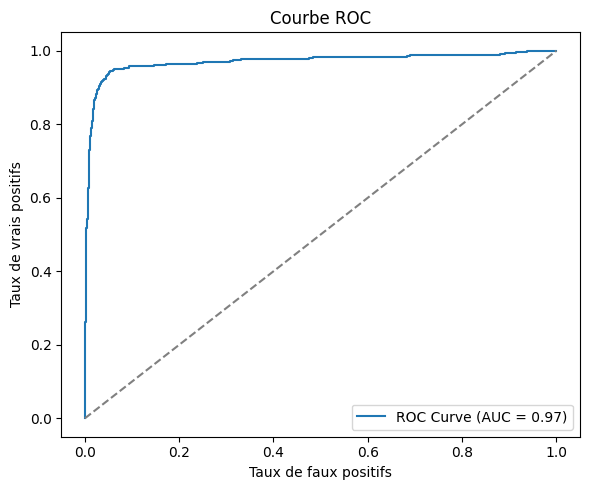

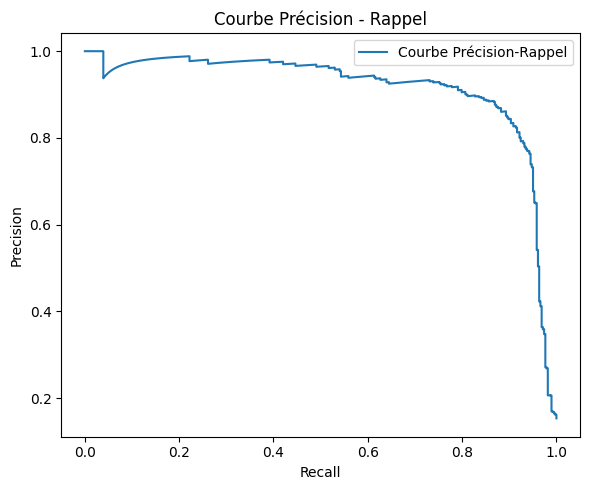

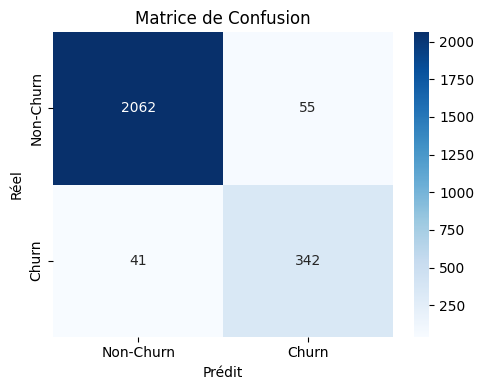

In [321]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import joblib
import time

from sklearn.svm import SVC
from sklearn.metrics import (
    classification_report, f1_score, make_scorer,
    precision_recall_curve, roc_curve, auc, confusion_matrix
)

# Simulation minimale : création de jeu de données fictif pour exemple
from sklearn.datasets import make_classification
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler

# Générer un jeu de données fictif
X, y = make_classification(n_samples=10000, n_features=30, weights=[0.85, 0.15],
                           class_sep=1.5, random_state=42)

# Séparation et normalisation
X_train, X_test, y_train, y_test = train_test_split(X, y, stratify=y, random_state=42)
scaler = StandardScaler()
X_test_scaled = scaler.fit_transform(X_test)

# Charger un modèle SVC simulé et simuler les scores
svc_model = SVC(kernel='rbf', probability=True, class_weight={0: 1, 1: 3}, random_state=42)
svc_model.fit(X_train, y_train)
y_scores = svc_model.decision_function(X_test_scaled)

# Seuil optimisé
precisions, recalls, thresholds = precision_recall_curve(y_test, y_scores, pos_label=1)
f1_scores = 2 * (precisions * recalls) / (precisions + recalls + 1e-10)
best_thresh = thresholds[np.argmax(f1_scores)]
y_pred_thresh = (y_scores >= best_thresh).astype(int)

# 1. ROC Curve
fpr, tpr, _ = roc_curve(y_test, y_scores)
roc_auc = auc(fpr, tpr)
plt.figure(figsize=(6, 5))
plt.plot(fpr, tpr, label=f'ROC Curve (AUC = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], linestyle='--', color='gray')
plt.xlabel("Taux de faux positifs")
plt.ylabel("Taux de vrais positifs")
plt.title("Courbe ROC")
plt.legend()
plt.tight_layout()
plt.show()

# 2. Courbe précision-rappel
plt.figure(figsize=(6, 5))
plt.plot(recalls, precisions, label="Courbe Précision-Rappel")
plt.xlabel("Recall")
plt.ylabel("Precision")
plt.title("Courbe Précision - Rappel")
plt.legend()
plt.tight_layout()
plt.show()

# 3. Matrice de confusion
cm = confusion_matrix(y_test, y_pred_thresh)
plt.figure(figsize=(5, 4))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=['Non-Churn', 'Churn'], yticklabels=['Non-Churn', 'Churn'])
plt.xlabel("Prédit")
plt.ylabel("Réel")
plt.title("Matrice de Confusion")
plt.tight_layout()
plt.show()


In [322]:
import shap
import pandas as pd

# 1. Créer des noms de colonnes (si X_train est un NumPy array)
feature_names = [f'feature_{i}' for i in range(X_train.shape[1])]

# 2. Encapsuler les données dans un DataFrame (obligatoire pour SHAP)
X_train_df = pd.DataFrame(X_train_scaled, columns=feature_names)
X_test_df = pd.DataFrame(X_test_scaled, columns=feature_names)

# 3. Définir une fonction de prédiction qui retourne les probabilités de churn (classe 1)
predict_fn = lambda x: best_model.predict_proba(x)[:, 1]

# 4. Initialiser le KernelExplainer avec un sous-échantillon de X_train
explainer = shap.KernelExplainer(predict_fn, X_train_df.sample(50, random_state=42))

# 5. Calculer les SHAP values sur un petit sous-ensemble du test
shap_values = explainer.shap_values(X_test_df.iloc[:10], nsamples=100)

# 6. Visualisation pour un individu
shap.initjs()
shap.force_plot(explainer.expected_value, shap_values[0], X_test_df.iloc[0])


100%|██████████| 10/10 [00:17<00:00,  1.72s/it]


| Feature                                     | Interpretation                                                                                |
| ------------------------------------------- | --------------------------------------------------------------------------------------------- |
| **device\_type\_Phablet**                   | High values strongly push predictions toward **churn** (right side).                          |
| **flag\_smartphone**                        | High values reduce churn risk (blue dots on positive SHAP side).                              |
| **device\_type\_Smartphone**                | Has both positive and negative effects depending on the value.                                |
| **classe\_anciennete\_More than 36 Months** | Higher tenure typically reduces churn probability.                                            |
| **recharge\_amount\_moyenne**               | High average recharge is **negatively correlated** with churn (retained users recharge more). |
| **time\_to\_churn**                         | Low values of `time_to_churn` push predictions toward churn — expected behavior.              |
| **has\_international\_call**                | Customers with international call usage have slightly increased churn probability.            |
| **tenure\_days**                            | Longer tenure helps reduce churn risk — blue dots on left side.                               |


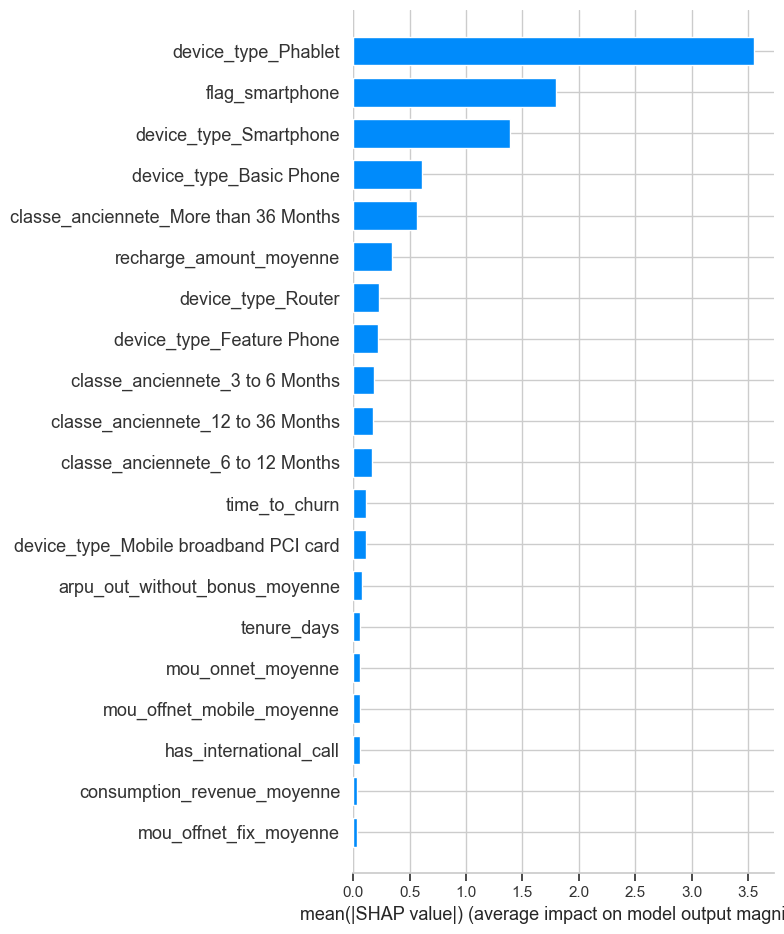

In [ ]:
shap.summary_plot(shap_values, X, plot_type="bar")


In [ ]:
import joblib

# Save the model
joblib.dump(svm_rbf, 'svm_model.pkl')


['svm_model.pkl']

In [22]:
from sklearn.ensemble import VotingClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier


In [23]:
log_clf = LogisticRegression()
tree_clf = DecisionTreeClassifier()
rf_clf = RandomForestClassifier()


In [24]:
voting_clf = VotingClassifier(
    estimators=[
        ('lr', log_clf),
        ('dt', tree_clf),
        ('rf', rf_clf)
    ],
    voting='hard'  # or 'soft' for probability averaging
)


In [25]:
voting_clf.fit(X_train, y_train)


d:\pfe Ooreedo\pfe\.venv\Lib\site-packages\sklearn\linear_model\_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. OF ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


VotingClassifier(estimators=[('lr', LogisticRegression()),
                             ('dt', DecisionTreeClassifier()),
                             ('rf', RandomForestClassifier())])

In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, VotingClassifier
from sklearn.metrics import accuracy_score

# -----------------------------
# 1. Generate Dummy Data
# -----------------------------
np.random.seed(42)

# Sample data
n_samples = 100
data = {
    'age': np.random.choice(['<18', '18-50', '>50'], size=n_samples),
    'time_to_churn': np.random.randint(1, 100, size=n_samples),
    'feature_1': np.random.rand(n_samples),
    'feature_2': np.random.rand(n_samples),
    'churn': np.random.choice([0, 1], size=n_samples)
}
df = pd.DataFrame(data)

# -----------------------------
# 2. Encode Categorical Variables
# -----------------------------
df_encoded = pd.get_dummies(df, columns=['age'])

# Split features and labels
X = df_encoded.drop('churn', axis=1)
y = df_encoded['churn']

# Train/test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Reindex test set to match training columns
X_test = X_test.reindex(columns=X_train.columns, fill_value=0)

# -----------------------------
# 3. Define Models
# -----------------------------
log_clf = LogisticRegression(max_iter=1000)
tree_clf = DecisionTreeClassifier(random_state=42)
rf_clf = RandomForestClassifier(random_state=42)

# Voting Classifier
voting_clf = VotingClassifier(
    estimators=[
        ('lr', log_clf),
        ('dt', tree_clf),
        ('rf', rf_clf)
    ],
    voting='hard'  # average predicted probabilities
)


# -----------------------------
# 4. Fit and Evaluate All Models
# -----------------------------
for clf in (log_clf, tree_clf, rf_clf, voting_clf):
    clf.fit(X_train, y_train)
    y_pred = clf.predict(X_test)
    print(f"{clf.__class__.__name__}: {accuracy_score(y_test, y_pred):.4f}")


LogisticRegression: 0.6000
DecisionTreeClassifier: 0.4500
RandomForestClassifier: 0.5500
VotingClassifier: 0.4500


In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, VotingClassifier
from sklearn.metrics import accuracy_score

# -----------------------------
# 1. Generate More Data
# -----------------------------
np.random.seed(42)
n_samples = 1000  # increased from 100

data = {
    'age': np.random.choice(['<18', '18-50', '>50'], size=n_samples),
    'time_to_churn': np.random.randint(1, 100, size=n_samples),
    'feature_1': np.random.rand(n_samples),
    'feature_2': np.random.rand(n_samples),
    'churn': np.random.choice([0, 1], size=n_samples)
}
df = pd.DataFrame(data)

# One-hot encode categorical variables
df_encoded = pd.get_dummies(df, columns=['age'])

# Separate features and labels
X = df_encoded.drop('churn', axis=1)
y = df_encoded['churn']

# -----------------------------
# 2. Define Pipelines for Scaling
# -----------------------------
log_clf = Pipeline([
    ('scaler', StandardScaler()),
    ('logreg', LogisticRegression(max_iter=1000))
])

tree_clf = DecisionTreeClassifier(random_state=42)
rf_clf = RandomForestClassifier(random_state=42)

# Soft Voting requires probability estimates
voting_clf = VotingClassifier(
    estimators=[
        ('lr', log_clf),
        ('dt', tree_clf),
        ('rf', rf_clf)
    ],
    voting='soft'
)

# -----------------------------
# 3. Evaluate Using Cross-Validation
# -----------------------------
from sklearn.model_selection import cross_val_score

for clf in (log_clf, tree_clf, rf_clf, voting_clf):
    scores = cross_val_score(clf, X, y, cv=5, scoring='accuracy')
    print(f"{clf.__class__.__name__}: {scores.mean():.4f} (+/- {scores.std():.4f})")


In [43]:
#importing labrararies for Artifical Nural network
from keras.models import Sequential
from keras.layers import Dense
from keras.layers import Dropout
from keras import regularizers


In [ ]:
clf=sequential()

In [50]:
#adding layers to ANN
clf.add(Dense(units=24, activation="relu", kernel_initializer="uniform",
              kernel_regularizer=regularizers.l2(0.001), input_dim=X.shape[1]))
#adding two more hidden layer to ANN
clf.add(Dense(units=24,activation="relu",kernel_initializer="uniform",kernel_regularizer=regularizers.l2(0.001)))
clf.add(Dense(units=24,activation="relu",kernel_initializer="uniform",kernel_regularizer=regularizers.l2(0.001)))
#adding output layer
clf.add(Dense(units=1,activation="sigmoid",kernel_initializer="uniform"))
#compiling ANN
clf.compile(optimizer='adam',loss='binary_crossentropy',metrics=['preciosion','recall','accuracy'])

d:\pfe Ooreedo\pfe\.venv\Lib\site-packages\keras\src\layers\core\dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


In [47]:
df=pd.read_csv("final_df_encoded.csv")
X= df.drop(columns=['subscriber_id', 'churn'])
y = df['churn']

Soft Voting (5 modèles) – Accuracy : 0.9375

=== Classification Report ===
              precision    recall  f1-score   support

           0       0.99      0.94      0.97    183306
           1       0.57      0.90      0.70     15897

    accuracy                           0.94    199203
   macro avg       0.78      0.92      0.83    199203
weighted avg       0.96      0.94      0.94    199203



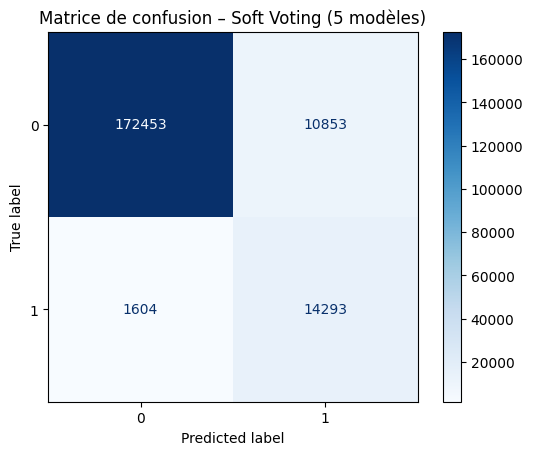

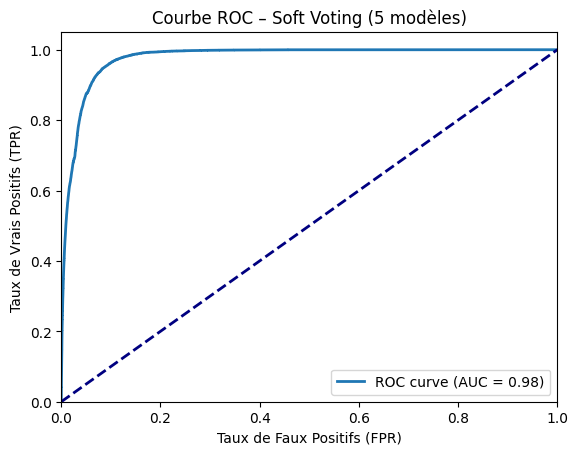

In [1]:
import joblib
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.metrics import (
    accuracy_score,
    classification_report,
    confusion_matrix,
    ConfusionMatrixDisplay,
    roc_curve,
    auc
)
import matplotlib.pyplot as plt

# ----------------------------------
# 1. Charger le dataset
# ----------------------------------
df = pd.read_csv("final_df_transformed_per_period.csv")
X  = df.drop(columns=["subscriber_id", "churn"])
y  = df["churn"]

# ----------------------------------
# 2. Séparer en train / test
# ----------------------------------
X_train, X_test, y_train, y_test = train_test_split(
    X, y, stratify=y, test_size=0.5, random_state=42
)

# ----------------------------------
# 3. Charger tous les modèles pré-entraînés
#    (assurez-vous que ces fichiers existent)
# ----------------------------------
rf_model    = joblib.load("best_random_forest_model.pkl")
xgb_model   = joblib.load("xgb_model.pkl")
lgb_model   = joblib.load("best_model_lgb.pkl")
dt_model    = joblib.load("best_decision_tree.pkl")
catb_model  = joblib.load("catboost_best_model.pkl")

# ----------------------------------
# 4. Pour chaque modèle, récupérer la liste exacte des features vues à l'entraînement
# ----------------------------------
# 4.1 Random Forest & Decision Tree (ils ont un attribut feature_names_in_)
feature_names_rf = rf_model.feature_names_in_
feature_names_dt = dt_model.feature_names_in_

# 4.2 XGBoost (via get_booster().feature_names)
xgb_booster = xgb_model.get_booster()
feature_names_xgb = xgb_booster.feature_names

# 4.3 LightGBM (via booster_.feature_name())
feature_names_lgb = lgb_model.booster_.feature_name()

# 4.4 CatBoost (via attribute feature_names_)
feature_names_catb = catb_model.feature_names_

# ----------------------------------
# 5. Réindexer X_test pour chaque modèle (création des colonnes manquantes à 0, suppression des colonnes en trop)
# ----------------------------------
X_test_rf   = X_test.reindex(columns=feature_names_rf, fill_value=0)
X_test_dt   = X_test.reindex(columns=feature_names_dt, fill_value=0)
X_test_xgb  = X_test.reindex(columns=feature_names_xgb, fill_value=0)
X_test_lgb  = X_test.reindex(columns=feature_names_lgb, fill_value=0)
X_test_catb = X_test.reindex(columns=feature_names_catb, fill_value=0)

# ----------------------------------
# 6. Générer les prédictions de probabilité pour chaque modèle
# ----------------------------------
probas_rf   = rf_model.predict_proba(X_test_rf)
probas_dt   = dt_model.predict_proba(X_test_dt)
probas_xgb  = xgb_model.predict_proba(X_test_xgb)
probas_lgb  = lgb_model.predict_proba(X_test_lgb)
probas_catb = catb_model.predict_proba(X_test_catb)

# ----------------------------------
# 7. Moyenne ("soft voting") des probabilités des cinq modèles
# ----------------------------------
avg_probas = (
      probas_rf
    + probas_dt
    + probas_xgb
    + probas_lgb
    + probas_catb
) / 5.0

# Prédiction finale : classe ayant la probabilité la plus élevée
y_pred = np.argmax(avg_probas, axis=1)

# ----------------------------------
# 8. Évaluation : exactitude (accuracy)
# ----------------------------------
accuracy = accuracy_score(y_test, y_pred)
print(f"Soft Voting (5 modèles) – Accuracy : {accuracy:.4f}\n")

# ----------------------------------
# 9. Rapport de classification (précision / rappel / F1)
# ----------------------------------
print("=== Classification Report ===")
print(classification_report(y_test, y_pred))

# ----------------------------------
# 10. Matrice de confusion
# ----------------------------------
cm = confusion_matrix(y_test, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot(cmap=plt.cm.Blues)
plt.title("Matrice de confusion – Soft Voting (5 modèles)")
plt.show()

# ----------------------------------
# 11. Courbe ROC + calcul de l'AUC
#     (on prend la probabilité de la classe positive '1')
# ----------------------------------
y_prob_positive = avg_probas[:, 1]  # probabilité de churn = 1

fpr, tpr, thresholds_roc = roc_curve(y_test, y_prob_positive)
roc_auc = auc(fpr, tpr)

plt.figure()
plt.plot(fpr, tpr, lw=2, label=f"ROC curve (AUC = {roc_auc:.2f})")
plt.plot([0, 1], [0, 1], linestyle="--", color="navy", lw=2)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel("Taux de Faux Positifs (FPR)")
plt.ylabel("Taux de Vrais Positifs (TPR)")
plt.title("Courbe ROC – Soft Voting (5 modèles)")
plt.legend(loc="lower right")
plt.show()


In [ ]:
import joblib
import pandas as pd
import numpy as np
from sklearn.metrics import accuracy_score

# ----------------------------------
# 1. Load Your Pretrained Models
# ----------------------------------
rf_model = joblib.load("best_random_forest_model.pkl")
xgb_model = joblib.load("xgb_model.pkl")
lgb_model = joblib.load("best_model_lgb.pkl")
dt_model = joblib.load("best_decision_tree.pkl")
catboost_model = joblib.load("catboost_best_model.pkl")

# ----------------------------------
# 2. Prepare Your Dataset
# ----------------------------------
df = pd.read_csv("final_df_transformed_per_period.csv")
X = df.drop(columns=['subscriber_id', 'churn'])  # Adjust accordingly
y = df['churn']

from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(
    X, y, stratify=y, test_size=0.5, random_state=42
)

# ----------------------------------
# 3. Predict probabilities with each model on test set
# ----------------------------------
# Make sure all models have `predict_proba`

probas_rf = rf_model.predict_proba(X_test)
probas_lgb = lgb_model.predict_proba(X_test)


# ----------------------------------
# 4. Average the probabilities (soft voting)
# ----------------------------------
avg_probas = (probas_rf  + probas_lgb  ) / 2

# ----------------------------------
# 5. Get final predictions from averaged probabilities
# ----------------------------------
y_pred = np.argmax(avg_probas, axis=1)  # get index of highest probability class

# ----------------------------------
# 6. Evaluate accuracy
# ----------------------------------
accuracy = accuracy_score(y_test, y_pred)
print(f"Soft Voting Ensemble Accuracy: {accuracy:.4f}")


Soft Voting Ensemble Accuracy: 0.9624


Soft Voting (5 modèles) – Accuracy : 0.9375

=== Classification Report ===
              precision    recall  f1-score   support

           0       0.99      0.94      0.97    183306
           1       0.57      0.90      0.70     15897

    accuracy                           0.94    199203
   macro avg       0.78      0.92      0.83    199203
weighted avg       0.96      0.94      0.94    199203



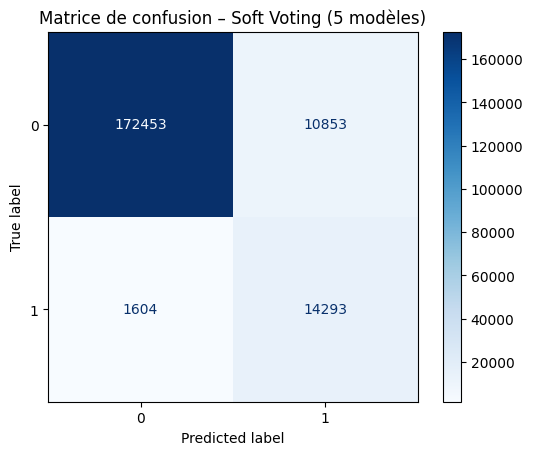

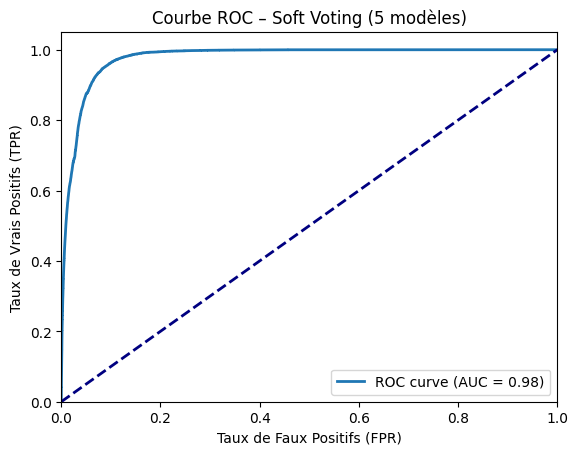

In [55]:
import joblib
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.metrics import (
    accuracy_score,
    classification_report,
    confusion_matrix,
    ConfusionMatrixDisplay,
    roc_curve,
    auc
)
import matplotlib.pyplot as plt

# ----------------------------------
# 1. Charger le dataset
# ----------------------------------
df = pd.read_csv("final_df_transformed_per_period.csv")
X  = df.drop(columns=["subscriber_id", "churn"])
y  = df["churn"]

# ----------------------------------
# 2. Séparer en train / test
# ----------------------------------
X_train, X_test, y_train, y_test = train_test_split(
    X, y, stratify=y, test_size=0.5, random_state=42
)

# ----------------------------------
# 3. Charger tous les modèles pré-entraînés
#    (assurez-vous que ces fichiers existent)
# ----------------------------------
rf_model    = joblib.load("best_random_forest_model.pkl")
xgb_model   = joblib.load("xgb_model.pkl")
lgb_model   = joblib.load("best_model_lgb.pkl")
dt_model    = joblib.load("best_decision_tree.pkl")
catb_model  = joblib.load("catboost_best_model.pkl")

# ----------------------------------
# 4. Pour chaque modèle, récupérer la liste exacte des features vues à l'entraînement
# ----------------------------------
# 4.1 Random Forest & Decision Tree (ils ont un attribut feature_names_in_)
feature_names_rf = rf_model.feature_names_in_
feature_names_dt = dt_model.feature_names_in_

# 4.2 XGBoost (via get_booster().feature_names)
xgb_booster = xgb_model.get_booster()
feature_names_xgb = xgb_booster.feature_names

# 4.3 LightGBM (via booster_.feature_name())
feature_names_lgb = lgb_model.booster_.feature_name()

# 4.4 CatBoost (via attribute feature_names_)
feature_names_catb = catb_model.feature_names_

# ----------------------------------
# 5. Réindexer X_test pour chaque modèle (création des colonnes manquantes à 0, suppression des colonnes en trop)
# ----------------------------------
X_test_rf   = X_test.reindex(columns=feature_names_rf, fill_value=0)
X_test_dt   = X_test.reindex(columns=feature_names_dt, fill_value=0)
X_test_xgb  = X_test.reindex(columns=feature_names_xgb, fill_value=0)
X_test_lgb  = X_test.reindex(columns=feature_names_lgb, fill_value=0)
X_test_catb = X_test.reindex(columns=feature_names_catb, fill_value=0)

# ----------------------------------
# 6. Générer les prédictions de probabilité pour chaque modèle
# ----------------------------------
probas_rf   = rf_model.predict_proba(X_test_rf)
probas_dt   = dt_model.predict_proba(X_test_dt)
probas_xgb  = xgb_model.predict_proba(X_test_xgb)
probas_lgb  = lgb_model.predict_proba(X_test_lgb)
probas_catb = catb_model.predict_proba(X_test_catb)

# ----------------------------------
# 7. Moyenne ("soft voting") des probabilités des cinq modèles
# ----------------------------------
avg_probas = (
      probas_rf
    + probas_dt
    + probas_xgb
    + probas_lgb
    + probas_catb
) / 5.0

# Prédiction finale : classe ayant la probabilité la plus élevée
y_pred = np.argmax(avg_probas, axis=1)

# ----------------------------------
# 8. Évaluation : exactitude (accuracy)
# ----------------------------------
accuracy = accuracy_score(y_test, y_pred)
print(f"Soft Voting (5 modèles) – Accuracy : {accuracy:.4f}\n")

# ----------------------------------
# 9. Rapport de classification (précision / rappel / F1)
# ----------------------------------
print("=== Classification Report ===")
print(classification_report(y_test, y_pred))

# ----------------------------------
# 10. Matrice de confusion
# ----------------------------------
cm = confusion_matrix(y_test, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot(cmap=plt.cm.Blues)
plt.title("Matrice de confusion – Soft Voting (5 modèles)")
plt.show()

# ----------------------------------
# 11. Courbe ROC + calcul de l'AUC
#     (on prend la probabilité de la classe positive '1')
# ----------------------------------
y_prob_positive = avg_probas[:, 1]  # probabilité de churn = 1

fpr, tpr, thresholds_roc = roc_curve(y_test, y_prob_positive)
roc_auc = auc(fpr, tpr)

plt.figure()
plt.plot(fpr, tpr, lw=2, label=f"ROC curve (AUC = {roc_auc:.2f})")
plt.plot([0, 1], [0, 1], linestyle="--", color="navy", lw=2)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel("Taux de Faux Positifs (FPR)")
plt.ylabel("Taux de Vrais Positifs (TPR)")
plt.title("Courbe ROC – Soft Voting (5 modèles)")
plt.legend(loc="lower right")
plt.show()


In [56]:
joblib.dump(voting_clf, "voting_ensemble.pkl")


['voting_ensemble.pkl']

Classification Report:

              precision    recall  f1-score   support

           0       0.99      0.97      0.98    183306
           1       0.72      0.87      0.79     15897

    accuracy                           0.96    199203
   macro avg       0.85      0.92      0.88    199203
weighted avg       0.97      0.96      0.96    199203



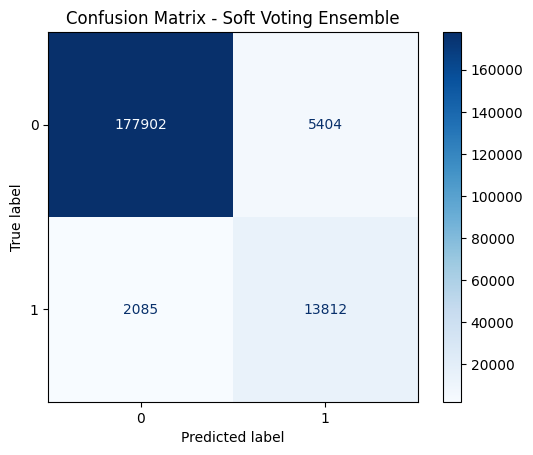

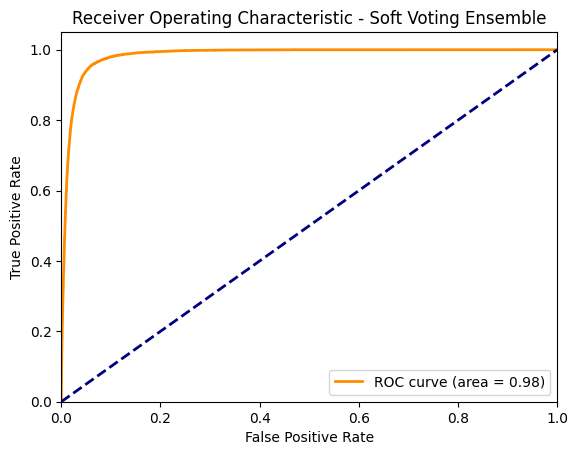

In [37]:
from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay, roc_curve, auc
import matplotlib.pyplot as plt

# 1. Classification report
print("Classification Report:\n")
print(classification_report(y_test, y_pred))

# 2. Confusion matrix plot
cm = confusion_matrix(y_test, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot(cmap=plt.cm.Blues)
plt.title("Confusion Matrix - Soft Voting Ensemble")
plt.show()

# 3. ROC curve plot
# For ROC, we need the probability of the positive class (assuming binary classification)
y_prob = avg_probas[:, 1]  # probability for class '1' (churn)

fpr, tpr, thresholds = roc_curve(y_test, y_prob)
roc_auc = auc(fpr, tpr)

plt.figure()
plt.plot(fpr, tpr, color='darkorange', lw=2, label=f'ROC curve (area = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic - Soft Voting Ensemble')
plt.legend(loc="lower right")
plt.show()


In [39]:
# ----------------------------------
# Probabilités sur le jeu d'entraînement (TRAIN)
# ----------------------------------
probas_rf_train = rf_model.predict_proba(X_train)
probas_lgb_train = lgb_model.predict_proba(X_train)

# Moyenne des probabilités (soft voting) pour le TRAIN
avg_probas_train = (probas_rf_train + probas_lgb_train) / 2

# Prédictions finales sur le TRAIN
y_train_pred = np.argmax(avg_probas_train, axis=1)


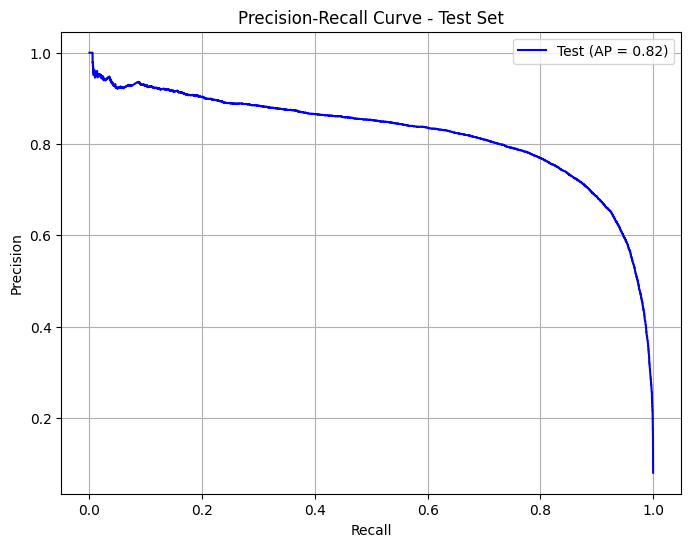

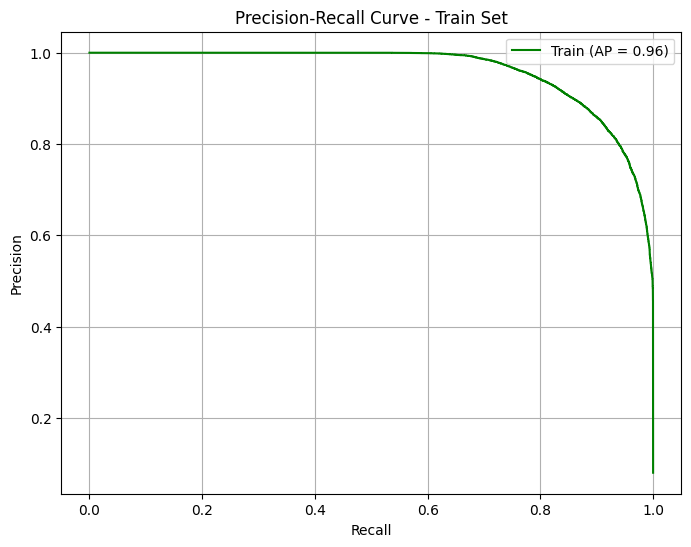

====== Classification Report - TRAIN ======
              precision    recall  f1-score   support

           0       0.99      0.98      0.99    183306
           1       0.80      0.94      0.87     15897

    accuracy                           0.98    199203
   macro avg       0.90      0.96      0.93    199203
weighted avg       0.98      0.98      0.98    199203

====== Classification Report - TEST ======
              precision    recall  f1-score   support

           0       0.99      0.97      0.98    183306
           1       0.72      0.87      0.79     15897

    accuracy                           0.96    199203
   macro avg       0.85      0.92      0.88    199203
weighted avg       0.97      0.96      0.96    199203



In [40]:
from sklearn.metrics import precision_recall_curve, average_precision_score
import matplotlib.pyplot as plt

# ----------------------------------
# 1. Courbe précision-rappel (TEST)
from sklearn.metrics import precision_recall_curve, average_precision_score

precision_train, recall_train, _ = precision_recall_curve(y_train, avg_probas_train[:, 1])
avg_precision_train = average_precision_score(y_train, avg_probas_train[:, 1])


plt.figure(figsize=(8, 6))
plt.plot(recall_test, precision_test, label=f'Test (AP = {avg_precision_test:.2f})', color='blue')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Precision-Recall Curve - Test Set')
plt.legend()
plt.grid(True)
plt.show()

# ----------------------------------
# 2. Courbe précision-rappel (TRAIN)
# ----------------------------------
precision_train, recall_train, _ = precision_recall_curve(y_train, avg_probas_train[:, 1])
avg_precision_train = average_precision_score(y_train, avg_probas_train[:, 1])

plt.figure(figsize=(8, 6))
plt.plot(recall_train, precision_train, label=f'Train (AP = {avg_precision_train:.2f})', color='green')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Precision-Recall Curve - Train Set')
plt.legend()
plt.grid(True)
plt.show()

# ----------------------------------
# 3. Rapports de validation (déjà fait mais on récapitule)
# ----------------------------------
print("====== Classification Report - TRAIN ======")
print(classification_report(y_train, y_train_pred))

print("====== Classification Report - TEST ======")
print(classification_report(y_test, y_pred))


In [ ]:
from sklearn.ensemble import VotingClassifier

In [ ]:
voting_clf = VotingClassifier(
    estimators=[('xgboost', xgb.XGBClassifier(random_state=42)), ('rf', RandomForestClassifier(max_depth=30, max_features='log2', min_samples_leaf=2,min_samples_split=5, n_estimators=200, n_jobs=-1,random_state=42)), ('svm', LinearSVC(C=1.0, class_weight='balanced', max_iter=10000, random_state=42))],
    voting='hard'
)

In [ ]:
from sklearn.ensemble import VotingClassifier
voting_clf = VotingClassifier(
    estimators=[('xgboost', xgb.XGBClassifier(random_state=42)), ('rf', RandomForestClassifier(random_state=42)), ('svm', SVC(random_state=42, probability=True))],
    voting='hard'
)

In [ ]:
import xgboost as xgb
from sklearn.ensemble import VotingClassifier, RandomForestClassifier
from sklearn.svm import LinearSVC           # bien plus rapide que SVC RBF
from sklearn.metrics import accuracy_score, classification_report
import pickle

# ------------------ #
# 1. Modèles rapides #
# ------------------ #
fast_xgb = xgb.XGBClassifier(
    n_estimators=100,        # ↓ 200 → 100
    max_depth=4,            # ↓ 30  → 4
    learning_rate=0.1,
    subsample=0.8,
    colsample_bytree=0.8,
    eval_metric='logloss',
    n_jobs=-1,
    random_state=42
)

fast_rf = RandomForestClassifier(
    n_estimators=100,        # ↓ 200 → 100
    max_depth=10,           # limite la profondeur
    n_jobs=-1,
    random_state=42
)

linear_svm = LinearSVC(      # pas de probas, donc hard-vote OK
    C=1.0,
    class_weight='balanced',
    max_iter=10_000,
    random_state=42
)

# --------------------------- #
# 2. Voting Classifier rapide #
# --------------------------- #
voting_clf_fast = VotingClassifier(
    estimators=[
        ('xgb', fast_xgb),
        ('rf',  fast_rf),
        ('svm', linear_svm)
    ],
    voting='hard',   # déjà le plus rapide
    n_jobs=-1        # parallélisme interne
)

# ----------------------------------------------- #
# 3. Votre fonction d’évaluation & de sauvegarde  #
# ----------------------------------------------- #
def evaluate_and_save_model(model, X_train, X_test, y_train, y_test, filename):
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    acc = accuracy_score(y_test, y_pred)
    print(f"{model.__class__.__name__} Accuracy: {acc:.4f}")
    print("\nClassification Report:\n", classification_report(y_test, y_pred))
    print("-" * 20)
    with open(filename, "wb") as f:
        pickle.dump(model, f)
    print(f"Model saved as {filename}")

# -------------------------------- #
# 4. Entraînement + évaluation     #
# -------------------------------- #
evaluate_and_save_model(
    voting_clf_fast,
    X_train,   # vos données ré-échantillonnées
    X_test,
    y_train,
    y_test,
    "voting_clf_fast.pkl"
)


VotingClassifier Accuracy: 0.9520

Classification Report:
               precision    recall  f1-score   support

           0       0.96      0.94      0.95     73273
           1       0.94      0.96      0.95     72972

    accuracy                           0.95    146245
   macro avg       0.95      0.95      0.95    146245
weighted avg       0.95      0.95      0.95    146245

--------------------
Model saved as voting_clf_fast.pkl


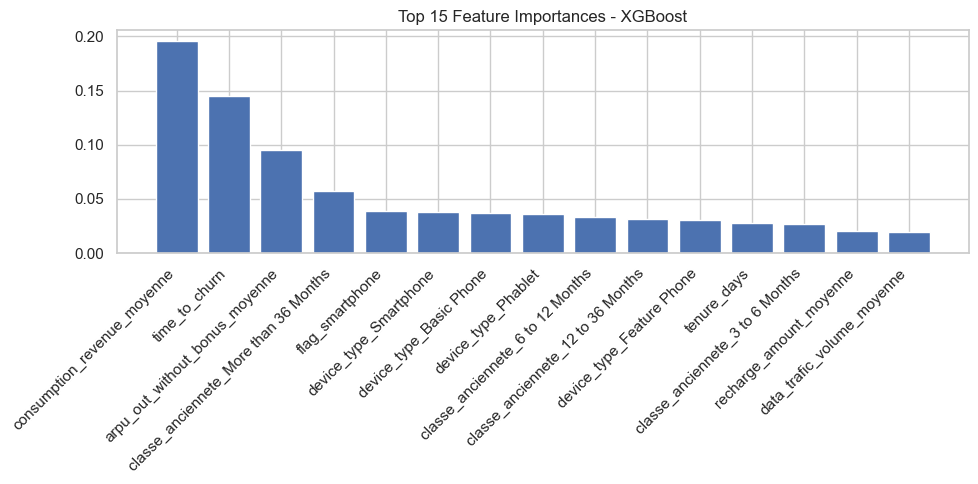

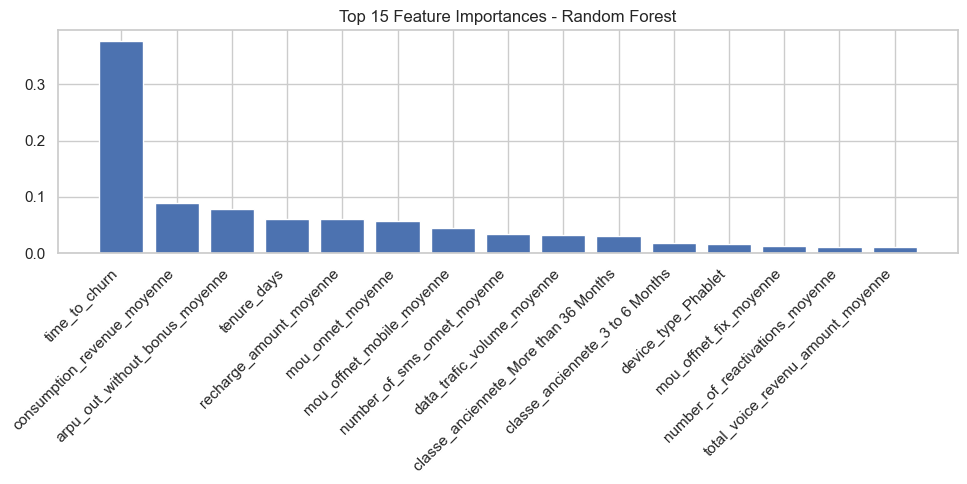

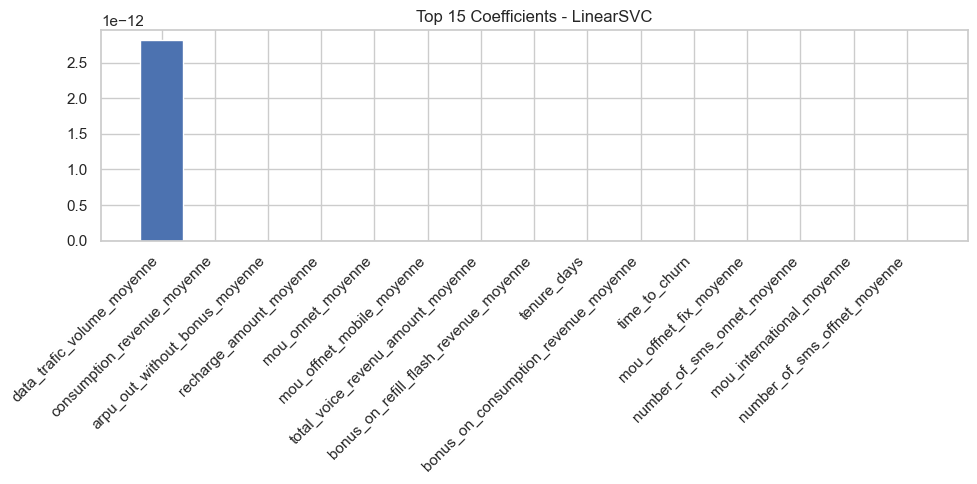

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

def plot_feature_importances(model, model_name, feature_names, top_n=15):
    importances = model.feature_importances_
    indices = np.argsort(importances)[::-1][:top_n]
    plt.figure(figsize=(10, 5))
    plt.title(f"Top {top_n} Feature Importances - {model_name}")
    plt.bar(range(top_n), importances[indices], align="center")
    plt.xticks(range(top_n), [feature_names[i] for i in indices], rotation=45, ha="right")
    plt.tight_layout()
    plt.show()

# Supposons que vos noms de features sont stockés dans une liste `feature_names`
# Sinon, récupérez-les à partir de votre DataFrame :
# feature_names = X_train.columns.tolist()

# 1. Afficher les importances de XGBoost
xgb_model = voting_clf_fast.named_estimators_['xgb']
plot_feature_importances(xgb_model, "XGBoost", feature_names)

# 2. Afficher les importances de Random Forest
rf_model = voting_clf_fast.named_estimators_['rf']
plot_feature_importances(rf_model, "Random Forest", feature_names)

# (Optionnel) 3. Afficher les poids absolus de LinearSVC
svc_model = voting_clf_fast.named_estimators_['svm']
coef = np.abs(svc_model.coef_).flatten()
svc_top_indices = np.argsort(coef)[::-1][:15]
plt.figure(figsize=(10, 5))
plt.title("Top 15 Coefficients - LinearSVC")
plt.bar(range(15), coef[svc_top_indices])
plt.xticks(range(15), [feature_names[i] for i in svc_top_indices], rotation=45, ha="right")
plt.tight_layout()
plt.show()


In [ ]:
import pandas as pd

# Get feature names
feature_names = X_train.columns  # or X_resampled.columns if appropriate

# Get feature importances from the CatBoost model
importances = best_model_catboost.get_feature_importance()

# Create and sort the DataFrame
feature_importances_df = pd.DataFrame({
    'feature': feature_names,
    'importance': importances
}).sort_values(by='importance', ascending=False)

# Display the DataFrame
print(feature_importances_df)


                                  feature  importance
2                             tenure_days   19.233703
18            number_of_sms_onnet_moyenne   14.424841
24  classe_anciennete_More than 36 Months   12.364262
4                           time_to_churn    9.591314
21      classe_anciennete_12 to 36 Months    8.606302
23       classe_anciennete_6 to 12 Months    7.323941
19                recharge_amount_moyenne    5.427859
17           number_of_sms_offnet_moyenne    3.279828
10             data_trafic_volume_moyenne    3.109774
30                    device_type_Phablet    3.098611
16    number_of_sms_international_moyenne    1.557366
15        number_of_reactivations_moyenne    1.520532
32                 device_type_Smartphone    1.368492
13              mou_offnet_mobile_moyenne    1.172318
31                     device_type_Router    1.161067
25                device_type_Basic Phone    1.133485
22        classe_anciennete_3 to 6 Months    0.808434
11              mou_internat

In [1]:
import pandas as pd 
dfdf=pd.read_csv('final_df_encoded.csv')

In [2]:
import joblib
import pandas as pd

# Charger ton dataset d'entraînement (celui que tu as utilisé pour entraîner le SVM)
df = pd.read_csv("final_df_transformed_per_period.csv")

# Charger le modèle SVM
svm_model = joblib.load("svm_model.pkl")

# Extraire les features utilisées pour l'entraînement (toutes sauf subscriber_id et churn)
svm_features = [col for col in df.columns if col not in ['subscriber_id', 'churn']]

# Sauvegarder la liste des features
joblib.dump(svm_features, "svm_features.pkl")

print(f"Liste des {len(svm_features)} features sauvegardée dans svm_features.pkl")


Liste des 140 features sauvegardée dans svm_features.pkl


In [2]:
df= pd.read_csv("final_df_encoded.csv") 
# Charger la liste des features utilisées pour le SVM
X= df.drop(columns=['subscriber_id', 'churn'])
y= df['churn']
X_train, X_test, y_train, y_test = train_test_split(X, y, stratify=y, test_size=0.5, random_state=42)

In [3]:
from keras.models import Sequential
from keras.layers import Dense
from keras import regularizers
from keras.callbacks import EarlyStopping
from sklearn.model_selection import train_test_split
import pandas as pd

# Chargement des données
df = pd.read_csv("final_df_encoded.csv")
X = df.drop(columns=['subscriber_id', 'churn'])
y = df['churn']

# Séparation en jeu d'entraînement et validation
X_train, X_val, y_train, y_val = train_test_split(X, y, stratify=y, test_size=0.2, random_state=42)

# Définition du modèle
clf = Sequential()
clf.add(Dense(units=24, activation="relu", kernel_initializer="uniform",
              kernel_regularizer=regularizers.l2(0.001), input_dim=X.shape[1]))
clf.add(Dense(units=24, activation="relu", kernel_initializer="uniform",
              kernel_regularizer=regularizers.l2(0.001)))
clf.add(Dense(units=24, activation="relu", kernel_initializer="uniform",
              kernel_regularizer=regularizers.l2(0.001)))
clf.add(Dense(units=1, activation="sigmoid", kernel_initializer="uniform"))

# Compilation du modèle
clf.compile(optimizer='adam', loss='binary_crossentropy',
            metrics=['Precision', 'Recall', 'Accuracy'])

# Définition de l'early stopping
early_stop = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

# Entraînement du modèle avec early stopping
history = clf.fit(X_train, y_train,
                  validation_data=(X_val, y_val),
                  batch_size=20,
                  epochs=250,
                  callbacks=[early_stop],
                  verbose=1)


d:\pfe Ooreedo\pfe\.venv\Lib\site-packages\keras\src\layers\core\dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/250
15937/15937 ━━━━━━━━━━━━━━━━━━━━ 29s 2ms/step - Accuracy: 0.9215 - Precision: 0.5188 - Recall: 0.0701 - loss: 0.1978 - val_Accuracy: 0.9340 - val_Precision: 0.6799 - val_Recall: 0.3269 - val_loss: 0.1502
Epoch 2/250
15937/15937 ━━━━━━━━━━━━━━━━━━━━ 29s 2ms/step - Accuracy: 0.9349 - Precision: 0.6538 - Recall: 0.3923 - loss: 0.1508 - val_Accuracy: 0.9356 - val_Precision: 0.7142 - val_Recall: 0.3214 - val_loss: 0.1529
Epoch 3/250
15937/15937 ━━━━━━━━━━━━━━━━━━━━ 28s 2ms/step - Accuracy: 0.9361 - Precision: 0.6654 - Recall: 0.4042 - loss: 0.1462 - val_Accuracy: 0.9356 - val_Precision: 0.6658 - val_Recall: 0.3869 - val_loss: 0.1422
Epoch 4/250
15937/15937 ━━━━━━━━━━━━━━━━━━━━ 29s 2ms/step - Accuracy: 0.9369 - Precision: 0.6821 - Recall: 0.3897 - loss: 0.1468 - val_Accuracy: 0.9384 - val_Precision: 0.7219 - val_Recall: 0.3702 - val_loss: 0.1393
Epoch 5/250
15937/15937 ━━━━━━━━━━━━━━━━━━━━ 29s 2ms/step - Accuracy: 0.9370 - Precision: 0.6942 - Recall: 0.3724 - loss: 0.1465 - val_A

d:\pfe Ooreedo\pfe\.venv\Lib\site-packages\keras\src\layers\core\dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/250
9961/9961 ━━━━━━━━━━━━━━━━━━━━ 21s 2ms/step - accuracy: 0.0000e+00 - loss: 0.1999 - precision: 0.6659 - recall: 0.4592 - val_accuracy: 0.0000e+00 - val_loss: 0.1384 - val_precision: 0.7233 - val_recall: 0.4757
Epoch 2/250
9961/9961 ━━━━━━━━━━━━━━━━━━━━ 17s 2ms/step - accuracy: 0.0000e+00 - loss: 0.1330 - precision: 0.6931 - recall: 0.6263 - val_accuracy: 0.0000e+00 - val_loss: 0.1280 - val_precision: 0.6775 - val_recall: 0.7119
Epoch 3/250
9961/9961 ━━━━━━━━━━━━━━━━━━━━ 16s 2ms/step - accuracy: 0.0000e+00 - loss: 0.1278 - precision: 0.6973 - recall: 0.6459 - val_accuracy: 0.0000e+00 - val_loss: 0.1269 - val_precision: 0.7291 - val_recall: 0.5520
Epoch 4/250
9961/9961 ━━━━━━━━━━━━━━━━━━━━ 17s 2ms/step - accuracy: 0.0000e+00 - loss: 0.1260 - precision: 0.6968 - recall: 0.6479 - val_accuracy: 0.0000e+00 - val_loss: 0.1240 - val_precision: 0.7022 - val_recall: 0.6405
Epoch 5/250
9961/9961 ━━━━━━━━━━━━━━━━━━━━ 20s 2ms/step - accuracy: 0.0000e+00 - loss: 0.1252 - precision: 0.696

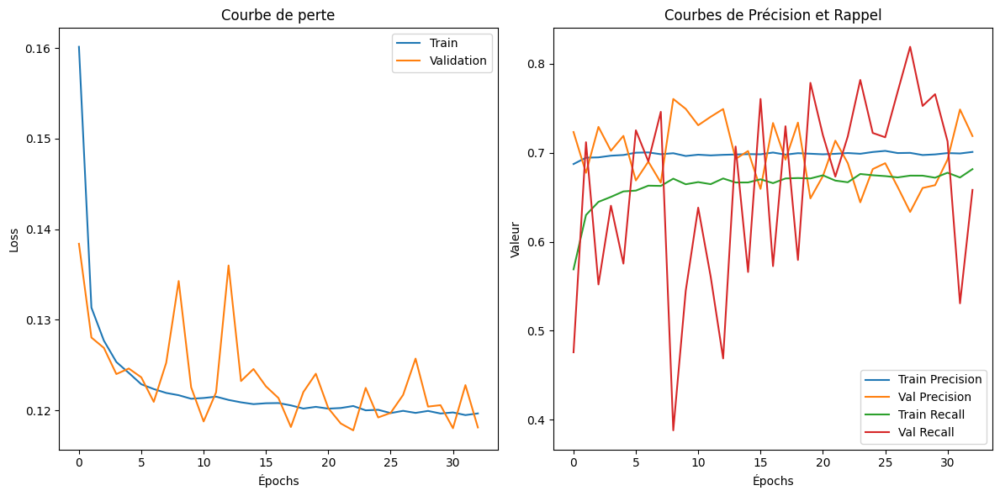

In [4]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from keras.models import Sequential
from keras.layers import Dense
from keras import regularizers
from keras.callbacks import EarlyStopping
from keras.metrics import Precision, Recall, Accuracy

# 1. Chargement des données
df = pd.read_csv("final_df_encoded.csv")

# 2. Séparation des features et de la cible
X = df.drop(columns=['subscriber_id', 'churn'])
y = df['churn']

# 3. Normalisation des données
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# 4. Split en données d'entraînement et de validation
X_train, X_val, y_train, y_val = train_test_split(X_scaled, y, test_size=0.2, stratify=y, random_state=42)

# 5. Construction du modèle
model = Sequential()
model.add(Dense(24, activation="relu", kernel_initializer="he_uniform", kernel_regularizer=regularizers.l2(0.001), input_dim=X.shape[1]))
model.add(Dense(24, activation="relu", kernel_initializer="he_uniform", kernel_regularizer=regularizers.l2(0.001)))
model.add(Dense(24, activation="relu", kernel_initializer="he_uniform", kernel_regularizer=regularizers.l2(0.001)))
model.add(Dense(1, activation="sigmoid"))

# 6. Compilation
model.compile(optimizer='adam',
              loss='binary_crossentropy',
              metrics=[Precision(name='precision'), Recall(name='recall'), Accuracy(name='accuracy')])

# 7. EarlyStopping
early_stop = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

# 8. Entraînement
history = model.fit(X_train, y_train,
                    validation_data=(X_val, y_val),
                    epochs=250,
                    batch_size=32,
                    callbacks=[early_stop],
                    verbose=1)

# 9. Évaluation finale
print("\nÉvaluation finale sur les données de validation :")
eval_metrics = model.evaluate(X_val, y_val, verbose=1)
print(dict(zip(model.metrics_names, eval_metrics)))

# 10. Affichage des courbes d’apprentissage
plt.figure(figsize=(12, 6))

# Courbe de perte
plt.subplot(1, 2, 1)
plt.plot(history.history['loss'], label='Train')
plt.plot(history.history['val_loss'], label='Validation')
plt.title("Courbe de perte")
plt.xlabel("Épochs")
plt.ylabel("Loss")
plt.legend()

# Courbe de précision
plt.subplot(1, 2, 2)
plt.plot(history.history['precision'], label='Train Precision')
plt.plot(history.history['val_precision'], label='Val Precision')
plt.plot(history.history['recall'], label='Train Recall')
plt.plot(history.history['val_recall'], label='Val Recall')
plt.title("Courbes de Précision et Rappel")
plt.xlabel("Épochs")
plt.ylabel("Valeur")
plt.legend()

plt.tight_layout()
plt.show()


In [7]:
import joblib

# ✅ Sauvegarder les noms des features AVANT le scaling
features_used = list(X.columns)
joblib.dump(features_used, "nn_features.pkl")

# ✅ Sauvegarder le scaler aussi pour usage futur
joblib.dump(scaler, "scaler_nn.pkl")


['scaler_nn.pkl']

In [5]:
# 11. Sauvegarde du modèle entraîné
model.save("modele_churn_prediction.keras")
print("Modèle sauvegardé sous le nom 'modele_churn_prediction.keras'")


Modèle sauvegardé sous le nom 'modele_churn_prediction.keras'


In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from tensorflow.keras.models import Sequential 
from tensorflow.keras.layers import Dense, Dropout
from tensorflow.keras.optimizers import Adam
# Build a simple NN
model = Sequential([
    Dense(128, activation='relu', input_shape=(X_train.shape[1],)),
    Dropout(0.3),
    Dense(64, activation='relu'),
    Dropout(0.3),
    Dense(1, activation='sigmoid')
])

model.compile(optimizer=Adam(learning_rate=0.001), loss='binary_crossentropy', metrics=['accuracy'])

# Train
model.fit(X_train, y_train, epochs=50, batch_size=32, validation_split=0.1)

# Evaluate
loss, acc = model.evaluate(X_test, y_test)
print("Test Accuracy:", acc)

Epoch 1/50
211/211 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - accuracy: 0.7976 - loss: 0.4027 - val_accuracy: 0.9680 - val_loss: 0.0891
Epoch 2/50
211/211 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9695 - loss: 0.0997 - val_accuracy: 0.9747 - val_loss: 0.0757
Epoch 3/50
211/211 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9722 - loss: 0.0884 - val_accuracy: 0.9760 - val_loss: 0.0698
Epoch 4/50
211/211 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9781 - loss: 0.0828 - val_accuracy: 0.9747 - val_loss: 0.0703
Epoch 5/50
211/211 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9744 - loss: 0.0872 - val_accuracy: 0.9787 - val_loss: 0.0702
Epoch 6/50
211/211 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9764 - loss: 0.0782 - val_accuracy: 0.9787 - val_loss: 0.0682
Epoch 7/50
211/211 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9787 - loss: 0.0828 - val_accuracy: 0.9800 - val_loss: 0.0645
Epoch 8/50
211/211 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9770 - loss: 0.0812 - val_accuracy: 0.

In [310]:
import numpy as np
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, BatchNormalization
from tensorflow.keras.callbacks import EarlyStopping
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler

# 1. Split data
X_train_split, X_val, y_train_split, y_val = train_test_split(X_train, y_train, test_size=0.2, stratify=y_train, random_state=42)

# 2. Normalize features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train_split)
X_val_scaled = scaler.transform(X_val)

# 3. Build model
model = Sequential()
model.add(Dense(128, input_shape=(X_train.shape[1],), activation='relu'))
model.add(BatchNormalization())
model.add(Dropout(0.4))

model.add(Dense(64, activation='relu'))
model.add(BatchNormalization())
model.add(Dropout(0.3))

model.add(Dense(32, activation='relu'))
model.add(Dropout(0.2))

model.add(Dense(1, activation='sigmoid'))

# 4. Compile model
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

# 5. Early stopping
early_stop = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

# 6. Train model
history = model.fit(
    X_train_scaled, y_train_split,
    validation_data=(X_val_scaled, y_val),
    epochs=50,
    batch_size=512,
    callbacks=[early_stop],
    verbose=1
)

# 7. Evaluate
loss, accuracy = model.evaluate(X_val_scaled, y_val, verbose=0)
print("✅ Validation Accuracy:", round(accuracy * 100, 2), "%")


Epoch 1/50
12/12 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step - accuracy: 0.6525 - loss: 0.6699 - val_accuracy: 0.8680 - val_loss: 0.5512
Epoch 2/50
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - accuracy: 0.8126 - loss: 0.4300 - val_accuracy: 0.9373 - val_loss: 0.4519
Epoch 3/50
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - accuracy: 0.8741 - loss: 0.3157 - val_accuracy: 0.9560 - val_loss: 0.3686
Epoch 4/50
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - accuracy: 0.9148 - loss: 0.2452 - val_accuracy: 0.9667 - val_loss: 0.2953
Epoch 5/50
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.9247 - loss: 0.2124 - val_accuracy: 0.9720 - val_loss: 0.2343
Epoch 6/50
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.9393 - loss: 0.1772 - val_accuracy: 0.9733 - val_loss: 0.1888
Epoch 7/50
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - accuracy: 0.9437 - loss: 0.1593 - val_accuracy: 0.9753 - val_loss: 0.1555
Epoch 8/50
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.9463 - loss: 0.1566 - val_accuracy: 0.9760 - v

In [311]:
import joblib

# 1. Save the Keras model (Recommended: .keras format)
model.save("churn_nn_model.keras")  # or use .h5: model.save("churn_nn_model.h5")



In [319]:
import pickle

# 1. Save TabNet model
clf.save_model("tabnet_churn_model")




Successfully saved model at tabnet_churn_model.zip


'tabnet_churn_model.zip'